## Import Modules

In [ ]:
from sklearn.preprocessing import OrdinalEncoder
from concurrent.futures import ProcessPoolExecutor
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from utils import ModelTrainer

## Variables

In [ ]:
# Specify experiment number
experiment_number = 155
TARGET = "N"   # use "OC" when you’re training the SOC model
MODEL_TYPES = [
    # 'xgboost', 
    'lightgbm', 
    # 'catboost', 
    # 'random_forest', 
    # 'svr'
               ]
STRATIFY_BY = "LC0_Desc" # 'N_binned' #  'stratify_bin' # 
RUN_TUNING = False
TRAIN_X_TOP_FEATURES = False
N_FEATURES = 60

OC_TEST = False

CROPLAND_ONLY_MODEL = False
EXCLUDE_SAT = False

In [ ]:
filenames = {
    101: "data/modelling/model_csvs/250810_0951_ex10q_closestimage_allfeatures.csv",
    102: "data/modelling/model_csvs/250810_0951_ex10q_closestimage_allfeatures.csv",
    103: "data/modelling/model_csvs/250809_1010_31days_ndvisavilandsat_lowestcloud_minmaxscaler_allfeatures.csv",
    104: "data/modelling/model_csvs/250809_1010_31days_ndvisavilandsat_lowestcloud_minmaxscaler_allfeatures.csv",
    105: "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv",
    106: "data/modelling/model_csvs/250810_1000_leastcloudy_93days_allfeatures.csv",
    107: "data/modelling/model_csvs/250810_1004_leastcloudy_182days_allfeatures.csv",
    108: "data/modelling/model_csvs/250810_1006_leastcloudy_365days_allfeatures.csv",
    109: "data/modelling/model_csvs/250810_1122_closest_underthresh_31days_allfeatures.csv",
    110: "data/modelling/model_csvs/250810_1127_closest_under12_62days_allfeatures.csv",
    111: "data/modelling/model_csvs/250810_1141_closest_under5_93days_allfeatures.csv",
    112: "data/modelling/model_csvs/250810_1308_closest_under3_182days_allfeatures.csv",
    113: "data/modelling/model_csvs/250810_1313_closest_under2_365days_allfeatures.csv",
    114: "data/modelling/model_csvs/250810_0951_ex10q_closestimage_allfeatures.csv", # Needs removal of satellite imagery
    115: "data/modelling/model_csvs/250810_1335_median_under20_31to62days_allfeatures.csv",
    116: "data/modelling/model_csvs/250810_1355_median_under20_62days_allfeatures.csv",
    117: "data/modelling/model_csvs/250810_1358_median_under20_93days_allfeatures.csv",
    118: "data/modelling/model_csvs/250810_1402_median_under20_182days_allfeatures.csv",
    119: "data/modelling/model_csvs/250810_1406_median_under20_365days_allfeatures.csv",
    120: "data/modelling/model_csvs/250810_1434_mean_under20_31to62days_allfeatures.csv",
    121: "data/modelling/model_csvs/250810_1437_mean_under20_62days_allfeatures.csv",
    122: "data/modelling/model_csvs/250810_1439_mean_under20_93days_allfeatures.csv",
    123: "data/modelling/model_csvs/250810_1442_mean_under20_182days_allfeatures.csv",
    124: "data/modelling/model_csvs/250810_1445_mean_under20_365days_allfeatures.csv",
    125: "data/modelling/model_csvs/250811_0739_5x5window_lowestcloud_31days_allfeatures.csv",
    126: "data/modelling/model_csvs/250811_0748_7x7window_lowestcloud_31days_allfeatures.csv",
    127: "data/modelling/model_csvs/250811_0802_9x9window_lowestcloud_31days_allfeatures.csv",
    128: "data/modelling/model_csvs/250811_0804_11x11window_lowestcloud_31days_allfeatures.csv",
    129: "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv",
    130: "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv",
    131: "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv",
    132: "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv",
    133: "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv",
    134: "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv",
    135: "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv",
    136: "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv",
    142: "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv",
    143: "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv",
    144: "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv",
    145: "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv",
    147: "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv",
    149: "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv",
    150: "data/modelling/model_csvs/250814_1647_OC_aggregated_weather.csv",
    151: "data/modelling/model_csvs/250814_1647_OC_aggregated_weather.csv",
    152: "data/modelling/model_csvs/250814_1647_OC_aggregated_weather.csv",
    153: "data/modelling/model_csvs/250814_1647_OC_aggregated_weather.csv",
    155: "data/modelling/model_csvs/250826_1248_62day_lowestcloud.csv",
    156: "data/modelling/prediction_csvs/20250814_1603_OC_lightgbm_ex149_test.csv",
}

notes = {
    101: "baseline",
    102: "baseline",
    103: "Experiment 103: Least cloudy image last 31 days, stratify by LC0_Desc",
    104: "Experiment 103: Least cloudy image last 31 days, stratify by LC0_Desc",
    105: "Experiment 105: least cloudy 62 days, stratified by LC0_Desc and OC in 10 bins.",
    106: "Experiment 106: least cloudy 93 days stratified by LC0_Desc and OC in 10 bins.",
    107: "Experiment 107: least cloudy 182 days stratified by LC0_Desc and OC in 10 bins.",
    108: "Experiment 108: least cloudy 365 days stratified by LC0_Desc and OC in 10 bins.",
    109: "Experiment 109: Closest image under 20 cloud_mean s2 and clear LS stratified by LC0_Desc and OC in 10 bins.",
    110: "Experiment 110: Closest image under 12 within 62 day window cloud_mean s2 and clear LS stratified by LC0_Desc and OC in 10 bins.",
    111: "Experiment 111: Closest image under 5 within 93 day window cloud_mean s2 and clear LS stratified by LC0_Desc and OC in 10 bins.",
    112: "Experiment 112: closest image under cloud_mean 3 within 182 days of survey date. All features.",
    113: "Experiment 113: closest image under cloud_mean 2 within 365 days of survey date. All features.",
    114: "Experiment 114: No satellite imagery", # Needs removal of satellite imagery
    115: "Experiment 115: REDO (error before - ignore it) Median of low cloud images (<20 or clear==True) in 31 and 62 days",
    116: "Experiment 116: Median of low cloud images (<20 or clear==True) in 62 days",
    117: "Experiment 117: Median of low cloud images (<20 or clear==True) in 93 days",
    118: "Experiment 118: Median of low cloud images (<20 or clear==True) in 182 days",
    119: "Experiment 119: Median of low cloud images (<20 or clear==True) in 365 days",
    120: "Experiment 120: Mean of low cloud images (<20 or clear==True) in 31 days for sentinel, 62 for landsat",
    121: "Experiment 121: Mean of low cloud images (<20 or clear==True) in last 62 days",
    122: "Experiment 122: Mean of low cloud images (<20 or clear==True) in last 93 days",
    123: "Experiment 123: Mean of low cloud images (<20 or clear==True) in last 182 days",
    124: "Experiment 124: Mean of low cloud images (<20 or clear==True) in last 365 days",
    125: "Experiment 235: 5x5 window, lowest cloud last 31 days, stratified by LC0_Desc only/AND N",
    126: "Experiment 126: 7x7 window, lowest cloud last 31 days, stratified by LC0_Desc only/and N",
    127: "Experiment 127: 9x9 window, lowest cloud last 31 days, stratified by LC0_Desc only/and N",
    128: "Experiment 128: 11x11 window, lowest cloud last 31 days, stratified by LC0_Desc only/and N",
    129: "Experiment 129: Repeat 105 for feature selection - least cloudy 62 days, stratified by LC0_Desc only.",
    130: "Experiment 130: Repeat top 10 features - least cloudy 62 days, stratified by LC0_Desc only",
    131: "Experiment 131: Repeat top 20 features - least cloudy 62 days, stratified by LC0_Desc only",
    132: "Experiment 132: Repeat top 30 features - least cloudy 62 days, stratified by LC0_Desc only",
    133: "Experiment 133: Repeat top 40 features - least cloudy 62 days, stratified by LC0_Desc only",
    134: "Experiment 134: Repeat top 50 features - least cloudy 62 days, stratified by LC0_Desc only",
    135: "Experiment 135: Repeat top 45 features - least cloudy 62 days, stratified by LC0_Desc only",
    136: "Experiment 135: Repeat top 60 features - least cloudy 62 days, stratified by LC0_Desc only",
    142: "Experiment 142: top 45 features least cloudy 62 days, cropland only, stratify by OC binned",
    143: "Experiment 143: least cloudy 62 days, woodland only, stratify by OC binned",
    144: "Experiment 144: all features, least cloudy 62 days, cropland only, stratify by N binned",
    145: "Experiment 145: all features, least cloudy 62 days, woodland only, stratify by N binned",
    147: "Experiment 147: all features least cloudy 62 days, cropland only, stratify by N binned in 15 bins",
    149: "Experiment 149: train with all features including OC",
    150: "Experiment 150: Adding weather aggregations, least cloudy 62 days, stratified by LC0_Desc only",
    151: "Experiment 151: Train on Cropland only. Adding weather aggregations, least cloudy 62 days, stratified by LC0_Desc only",
    152: "Experiment 152: Train with all, test cropland only",
    153: "Experiment 153: Train without outliers, all features",
    155: "Experiment 155: Redo least cloudy 62 days image - including rainfall, cloud and dropping LS variables",
}


In [ ]:
df = pd.read_csv(filenames[experiment_number])

In [ ]:
if TRAIN_X_TOP_FEATURES:

    TOP_FEATURES_FILE = "experiment_tracking/feature_importance/top_features.csv"
    top_features = pd.read_csv(TOP_FEATURES_FILE)
    top_features = top_features.sort_values(by='N Ranking', ascending=True)
    features_in_order = top_features['Feature'].tolist()

    features_to_model = ['N', 'point_id'] + features_in_order[:N_FEATURES]

    df = df[features_to_model]

In [ ]:
# SELECT CROPLAND LAND ONLY 
if CROPLAND_ONLY_MODEL:
    df = df[df['LC0_Desc'] == 'Cropland']
    df = df.drop(columns=['LC0_Desc', 'LU1_Desc'])

In [ ]:
# Run ordinal encoding on categorical features
def run_encoding(df):
    cat_cols = [
        'LC0_Desc', 
        'LU1_Desc', 
        'LC1_Grouped'
        ]

    # In case categorical columns aren't in top N features when running subset training
    cat_cols = [cat for cat in cat_cols if cat in df.columns.tolist()]

    # Ordinal encoding of categorical features
    encoder = OrdinalEncoder()
    enc_df = df.copy()
    enc_df[cat_cols] = encoder.fit_transform(enc_df[cat_cols])

    # Replace land area and boolean values with numerical categories
    enc_df = enc_df.replace({True: 1,
                    False: 0,
                    '< 0.5 ha': 0,
                    '0.5 - 1 ha': 1,
                    '1 - 10 ha': 2,
                    '> 10 ha': 3})

    # Code to stratify by OC or N level - bucket into categories
    enc_df[f'{TARGET}_binned'] = pd.qcut(enc_df[f"{TARGET}"], q=15, labels=False)
    return enc_df

enc_df = run_encoding(df)

In [ ]:
if EXCLUDE_SAT:
    # Train without satellite imagery
    cols = enc_df.columns.values
    cols = [col for col in cols if not col.startswith("sr_")]
    cols = [col for col in cols if not col.startswith("ls_")]
    cols = [col for col in cols if not col.startswith("s1_")]

    enc_df = enc_df[cols]

In [ ]:
# When N is the target, keep OC as a feature while predicting N:
target = TARGET
not_modelling_dict = {"OC": "N",
                      "N": "OC"}
not_modelling = not_modelling_dict[target]

## SOC-First Approach

In [ ]:
if OC_TEST:
    OCPRED_FILENAME = "data/modelling/prediction_csvs/20250814_1603_OC_lightgbm_ex149_test.csv"
    oc_test = pd.read_csv(OCPRED_FILENAME)

    # Get train and test point IDs
    test_points = oc_test['point_id'].unique().tolist()
    train_points = df[~df['point_id'].isin(test_points)]['point_id'].unique().tolist()

    # Get train and test dataframe
    train_df = df[df['point_id'].isin(train_points)]
    true_test_df = df[df['point_id'].isin(test_points)]

    # Create the dataframes 
    # True values
    true_full_df = pd.concat([train_df, true_test_df])

    # With predicted test values - join the predictions
    pred_test_df = true_test_df.merge(oc_test[['point_id', 'y_pred']], on='point_id', how='inner')
    pred_test_df = pred_test_df.drop(columns='OC')
    pred_test_df['OC'] = pred_test_df['y_pred']
    pred_test_df = pred_test_df.drop(columns='y_pred')
    pred_full_df = pd.concat([train_df, pred_test_df])

    df = pred_full_df.copy()
    enc_df = run_encoding(df)

In [ ]:
trainer = ModelTrainer(
    df=enc_df,
    target_col=target,
    id_cols=["point_id"],         # whatever your ID columns are
    drop_cols=[],                 # DO NOT put "OC" here if you want OC as a feature
    model_type="lightgbm",
    notes=f"{target} model with {not_modelling} as feature; manual split by point_id"
)

# 1) Manual split by ID (define these lists/sets yourself)
trainer.set_manual_split(
    train_ids=train_points,    # list/set of IDs for training
    test_ids=test_points,      # list/set of IDs for testing
    id_col="point_id"
)

# 2) Prepare data (optionally stratify by a category like land cover)
trainer.prepare_data(stratifyby="LC0_Desc")

# 3) Tune (optional) and train
trainer.tune_hyperparams(n_trials=50, timeout=600)
trainer.train_final_model(use_log_target=False, save_model=True)

# 4) Evaluate on the internal test split
trainer.evaluate()
print(trainer.metrics)

# 5) Compute importances and save logs (optional)
# trainer.compute_feature_importances()
trainer.save_results(
    model_log_path="experiment_tracking/raw_experiment_log_N.xlsx",
    # importance_log_path="feature_importances.xlsx"
)

[I 2025-08-14 16:44:57,761] A new study created in memory with name: no-name-d809185f-534d-49fa-8f0f-0154bb464bed


[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.674095073635771, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.674095073635771
[LightGBM] [Warning] bagging_fraction is set=0.7342633832783866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7342633832783866
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.674095073635771, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.674095073635771
[LightGBM] [Warning] bagging_fraction is set=0.7342633832783866, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7342633832783866
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001521 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total 

[I 2025-08-14 16:44:58,511] Trial 0 finished with value: 1.473961678801689 and parameters: {'n_estimators': 1089, 'max_depth': 4, 'learning_rate': 0.2959055823848119, 'num_leaves': 129, 'min_child_samples': 55, 'feature_fraction': 0.674095073635771, 'bagging_fraction': 0.7342633832783866, 'bagging_freq': 5, 'reg_alpha': 6.3518136101335415e-06, 'reg_lambda': 5.943338941364379e-06}. Best is trial 0 with value: 1.473961678801689.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:44:59,251] Trial 1 finished with value: 3.7221081399671125 and parameters: {'n_estimators': 290, 'max_depth': 8, 'learning_rate': 0.004871988661499517, 'num_leaves': 196, 'min_child_samples': 87, 'feature_fraction': 0.617110895396021, 'bagging_fraction': 0.9954881345275499, 'bagging_freq': 3, 'reg_alpha': 0.00010677237802709217, 'reg_lambda': 3.838040601421458e-06}. Best is trial 0 with value: 1.473961678801689.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:44:59,494] Trial 2 finished with value: 2.1152588541445034 and parameters: {'n_estimators': 422, 'max_depth': 3, 'learning_rate': 0.004516462066820599, 'num_leaves': 81, 'min_child_samples': 11, 'feature_fraction': 0.9070075663481983, 'bagging_fraction': 0.9308101276952613, 'bagging_freq': 5, 'reg_alpha': 6.798015216632752e-06, 'reg_lambda': 7.733740899852177e-08}. Best is trial 0 with value: 1.473961678801689.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:44:59,795] Trial 3 finished with value: 5.565804561165729 and parameters: {'n_estimators': 220, 'max_depth': 5, 'learning_rate': 0.003797426742242004, 'num_leaves': 240, 'min_child_samples': 83, 'feature_fraction': 0.7093518455604271, 'bagging_fraction': 0.7116556023379633, 'bagging_freq': 4, 'reg_alpha': 0.3061946903200507, 'reg_lambda': 3.377855850790068e-08}. Best is trial 0 with value: 1.473961678801689.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:44:59,972] Trial 4 finished with value: 7.3477490436273465 and parameters: {'n_estimators': 286, 'max_depth': 3, 'learning_rate': 0.001516313527601365, 'num_leaves': 216, 'min_child_samples': 91, 'feature_fraction': 0.9972531668013854, 'bagging_fraction': 0.7912057219335767, 'bagging_freq': 5, 'reg_alpha': 0.004927358754364873, 'reg_lambda': 0.11757523809669981}. Best is trial 0 with value: 1.473961678801689.


[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.9972531668013854, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9972531668013854
[LightGBM] [Warning] bagging_fraction is set=0.7912057219335767, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7912057219335767
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.9972531668013854, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9972531668013854
[LightGBM] [Warning] bagging_fraction is set=0.7912057219335767, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7912057219335767
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001292 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] To

[I 2025-08-14 16:45:04,771] Trial 5 finished with value: 1.6982182924546896 and parameters: {'n_estimators': 1149, 'max_depth': 8, 'learning_rate': 0.002251711788475797, 'num_leaves': 78, 'min_child_samples': 29, 'feature_fraction': 0.7465248548450177, 'bagging_fraction': 0.6177674978407339, 'bagging_freq': 1, 'reg_alpha': 1.3382556641350267e-05, 'reg_lambda': 0.002282687927772437}. Best is trial 0 with value: 1.473961678801689.


[LightGBM] [Warning] bagging_freq is set=0, subsample_freq=0 will be ignored. Current value: bagging_freq=0
[LightGBM] [Warning] feature_fraction is set=0.6804920185567955, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6804920185567955
[LightGBM] [Warning] bagging_fraction is set=0.8726898162216498, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8726898162216498
[LightGBM] [Warning] bagging_freq is set=0, subsample_freq=0 will be ignored. Current value: bagging_freq=0
[LightGBM] [Warning] feature_fraction is set=0.6804920185567955, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6804920185567955
[LightGBM] [Warning] bagging_fraction is set=0.8726898162216498, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8726898162216498
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001367 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] To

[I 2025-08-14 16:45:07,919] Trial 6 finished with value: 1.3522090807333933 and parameters: {'n_estimators': 1009, 'max_depth': 0, 'learning_rate': 0.031330689136566794, 'num_leaves': 150, 'min_child_samples': 93, 'feature_fraction': 0.6804920185567955, 'bagging_fraction': 0.8726898162216498, 'bagging_freq': 0, 'reg_alpha': 0.6248789001063336, 'reg_lambda': 6.283676758035666e-06}. Best is trial 6 with value: 1.3522090807333933.


[LightGBM] [Warning] bagging_freq is set=0, subsample_freq=0 will be ignored. Current value: bagging_freq=0
[LightGBM] [Warning] feature_fraction is set=0.6804920185567955, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6804920185567955
[LightGBM] [Warning] bagging_fraction is set=0.8726898162216498, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8726898162216498
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8254590707111247, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8254590707111247
[LightGBM] [Warning] bagging_fraction is set=0.7365216069502851, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7365216069502851
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8254590707111247, colsample

[I 2025-08-14 16:45:09,717] Trial 7 finished with value: 3.6188430210855023 and parameters: {'n_estimators': 1044, 'max_depth': 12, 'learning_rate': 0.0011495714556353097, 'num_leaves': 41, 'min_child_samples': 65, 'feature_fraction': 0.8254590707111247, 'bagging_fraction': 0.7365216069502851, 'bagging_freq': 1, 'reg_alpha': 0.00027664081341609173, 'reg_lambda': 7.831928112658122}. Best is trial 6 with value: 1.3522090807333933.


[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8254590707111247, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8254590707111247
[LightGBM] [Warning] bagging_fraction is set=0.7365216069502851, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7365216069502851
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.9701637368888228, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9701637368888228
[LightGBM] [Warning] bagging_fraction is set=0.8253710931737863, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8253710931737863
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.9701637368888228, colsample

[I 2025-08-14 16:45:10,683] Trial 8 finished with value: 3.1166099831291065 and parameters: {'n_estimators': 757, 'max_depth': 6, 'learning_rate': 0.001479492636184371, 'num_leaves': 117, 'min_child_samples': 40, 'feature_fraction': 0.9701637368888228, 'bagging_fraction': 0.8253710931737863, 'bagging_freq': 4, 'reg_alpha': 5.901860733551276, 'reg_lambda': 3.815115706971167e-06}. Best is trial 6 with value: 1.3522090807333933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:11,783] Trial 9 finished with value: 1.434835054794593 and parameters: {'n_estimators': 617, 'max_depth': 11, 'learning_rate': 0.11468397569022054, 'num_leaves': 221, 'min_child_samples': 62, 'feature_fraction': 0.9127494064557744, 'bagging_fraction': 0.8811609277615249, 'bagging_freq': 5, 'reg_alpha': 0.0038120512114021596, 'reg_lambda': 3.61185345624575e-08}. Best is trial 6 with value: 1.3522090807333933.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] bagg

[I 2025-08-14 16:45:14,091] Trial 10 finished with value: 1.3448452998108054 and parameters: {'n_estimators': 825, 'max_depth': 0, 'learning_rate': 0.021839043383712488, 'num_leaves': 171, 'min_child_samples': 99, 'feature_fraction': 0.6050116034492545, 'bagging_fraction': 0.9032380468976445, 'bagging_freq': 0, 'reg_alpha': 8.90892579611861e-08, 'reg_lambda': 0.0009088159629685027}. Best is trial 10 with value: 1.3448452998108054.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:16,496] Trial 11 finished with value: 1.3701763299772303 and parameters: {'n_estimators': 854, 'max_depth': -1, 'learning_rate': 0.02603559252351928, 'num_leaves': 170, 'min_child_samples': 95, 'feature_fraction': 0.6062848578386114, 'bagging_fraction': 0.8996540808491725, 'bagging_freq': 0, 'reg_alpha': 1.0191457717780107e-07, 'reg_lambda': 0.00042081567738154604}. Best is trial 10 with value: 1.3448452998108054.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] bagging_freq is set=0, subsample_freq=0 will be ignored. Current value: bagging_freq=0
[LightGBM] [Warning] feature_fraction is set=0.6062848578386114, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6062848578386114
[LightGBM] [Warning] bagging_fraction is set=0.8996540808491725, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8996540808491725
[LightGBM] [Warning] bagging_freq is set=0, subsample_freq=0 will be ignored. Current value: bagging_freq=0
[LightGBM] [Warning] feature_frac

[I 2025-08-14 16:45:19,458] Trial 12 finished with value: 1.3846944524329297 and parameters: {'n_estimators': 918, 'max_depth': -1, 'learning_rate': 0.024914420985201594, 'num_leaves': 167, 'min_child_samples': 78, 'feature_fraction': 0.6627408365495037, 'bagging_fraction': 0.9751678919821175, 'bagging_freq': 0, 'reg_alpha': 1.4736041092722326e-08, 'reg_lambda': 0.010933562758176835}. Best is trial 10 with value: 1.3448452998108054.


[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7742350553211694, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7742350553211694
[LightGBM] [Warning] bagging_fraction is set=0.8451430031987457, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8451430031987457
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7742350553211694, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7742350553211694
[LightGBM] [Warning] bagging_fraction is set=0.8451430031987457, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8451430031987457
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001127 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] To

[I 2025-08-14 16:45:19,702] Trial 13 finished with value: 1.720045468817404 and parameters: {'n_estimators': 656, 'max_depth': 1, 'learning_rate': 0.05782486056716429, 'num_leaves': 159, 'min_child_samples': 97, 'feature_fraction': 0.7742350553211694, 'bagging_fraction': 0.8451430031987457, 'bagging_freq': 1, 'reg_alpha': 0.09777389760523052, 'reg_lambda': 2.848192714337877e-05}. Best is trial 10 with value: 1.3448452998108054.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:19,953] Trial 14 finished with value: 1.8668958359982852 and parameters: {'n_estimators': 936, 'max_depth': 1, 'learning_rate': 0.012687279055934524, 'num_leaves': 111, 'min_child_samples': 71, 'feature_fraction': 0.6599063473010915, 'bagging_fraction': 0.9051350615510697, 'bagging_freq': 2, 'reg_alpha': 6.455031422971852e-07, 'reg_lambda': 0.06997250359640744}. Best is trial 10 with value: 1.3448452998108054.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:20,089] Trial 15 finished with value: 2.2038418484048194 and parameters: {'n_estimators': 533, 'max_depth': 1, 'learning_rate': 0.010673992907816211, 'num_leaves': 181, 'min_child_samples': 100, 'feature_fraction': 0.7248211293975149, 'bagging_fraction': 0.9553229177483009, 'bagging_freq': 0, 'reg_alpha': 2.152940776691896, 'reg_lambda': 8.679738237725287e-05}. Best is trial 10 with value: 1.3448452998108054.


[LightGBM] [Warning] bagging_freq is set=0, subsample_freq=0 will be ignored. Current value: bagging_freq=0
[LightGBM] [Warning] feature_fraction is set=0.7248211293975149, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7248211293975149
[LightGBM] [Warning] bagging_fraction is set=0.9553229177483009, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9553229177483009
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8256119182981557, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8256119182981557
[LightGBM] [Warning] bagging_fraction is set=0.8609027971990256, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8609027971990256
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8256119182981557, colsample

[I 2025-08-14 16:45:23,952] Trial 16 finished with value: 1.4321510942148823 and parameters: {'n_estimators': 782, 'max_depth': -1, 'learning_rate': 0.05985219413571446, 'num_leaves': 142, 'min_child_samples': 50, 'feature_fraction': 0.8256119182981557, 'bagging_fraction': 0.8609027971990256, 'bagging_freq': 2, 'reg_alpha': 0.01172238003501048, 'reg_lambda': 2.6722541992295044e-07}. Best is trial 10 with value: 1.3448452998108054.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging

[I 2025-08-14 16:45:24,266] Trial 17 finished with value: 1.2966662554883581 and parameters: {'n_estimators': 1011, 'max_depth': 2, 'learning_rate': 0.05092516053496099, 'num_leaves': 200, 'min_child_samples': 77, 'feature_fraction': 0.606524258582979, 'bagging_fraction': 0.7977093823791442, 'bagging_freq': 1, 'reg_alpha': 0.16006541041416522, 'reg_lambda': 0.0007805700460751379}. Best is trial 17 with value: 1.2966662554883581.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:24,488] Trial 18 finished with value: 1.301315427119342 and parameters: {'n_estimators': 760, 'max_depth': 2, 'learning_rate': 0.1192299670371435, 'num_leaves': 199, 'min_child_samples': 76, 'feature_fraction': 0.6097848915721362, 'bagging_fraction': 0.7747929922052575, 'bagging_freq': 1, 'reg_alpha': 0.03704588021033849, 'reg_lambda': 0.0010790610111586047}. Best is trial 17 with value: 1.2966662554883581.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:24,782] Trial 19 finished with value: 1.440105522105972 and parameters: {'n_estimators': 707, 'max_depth': 3, 'learning_rate': 0.21626686888394064, 'num_leaves': 255, 'min_child_samples': 75, 'feature_fraction': 0.6414730551004253, 'bagging_fraction': 0.7779301789277794, 'bagging_freq': 2, 'reg_alpha': 0.037928398403402085, 'reg_lambda': 0.7335254761226226}. Best is trial 17 with value: 1.2966662554883581.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:25,275] Trial 20 finished with value: 1.3884555387531106 and parameters: {'n_estimators': 564, 'max_depth': 7, 'learning_rate': 0.10769149044323095, 'num_leaves': 198, 'min_child_samples': 67, 'feature_fraction': 0.7908087301397784, 'bagging_fraction': 0.6474975180360558, 'bagging_freq': 1, 'reg_alpha': 0.0009155272725137901, 'reg_lambda': 0.006299399717865487}. Best is trial 17 with value: 1.2966662554883581.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:25,536] Trial 21 finished with value: 1.2911012352878093 and parameters: {'n_estimators': 864, 'max_depth': 2, 'learning_rate': 0.052157809425900155, 'num_leaves': 199, 'min_child_samples': 83, 'feature_fraction': 0.6004019819208022, 'bagging_fraction': 0.8070262370660584, 'bagging_freq': 1, 'reg_alpha': 0.07390125177910033, 'reg_lambda': 0.0007200857682080375}. Best is trial 21 with value: 1.2911012352878093.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:25,882] Trial 22 finished with value: 1.2906053058009985 and parameters: {'n_estimators': 1198, 'max_depth': 2, 'learning_rate': 0.05363177733920378, 'num_leaves': 217, 'min_child_samples': 81, 'feature_fraction': 0.6235806442113306, 'bagging_fraction': 0.7666329715607078, 'bagging_freq': 1, 'reg_alpha': 0.07049990435841254, 'reg_lambda': 0.00011383107636468778}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:26,450] Trial 23 finished with value: 1.344532045971122 and parameters: {'n_estimators': 1175, 'max_depth': 4, 'learning_rate': 0.04398068362998988, 'num_leaves': 227, 'min_child_samples': 82, 'feature_fraction': 0.641808512895869, 'bagging_fraction': 0.6959492740774904, 'bagging_freq': 2, 'reg_alpha': 0.4994209329790385, 'reg_lambda': 8.142865068870533e-05}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.641808512895869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.641808512895869
[LightGBM] [Warning] bagging_fraction is set=0.6959492740774904, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6959492740774904
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7053756932188913, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7053756932188913
[LightGBM] [Warning] bagging_fraction is set=0.8139625650974718, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8139625650974718
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7053756932188913, colsample_b

[I 2025-08-14 16:45:26,775] Trial 24 finished with value: 1.310696145805576 and parameters: {'n_estimators': 957, 'max_depth': 2, 'learning_rate': 0.07348723210868421, 'num_leaves': 209, 'min_child_samples': 58, 'feature_fraction': 0.7053756932188913, 'bagging_fraction': 0.8139625650974718, 'bagging_freq': 3, 'reg_alpha': 9.164385633496089, 'reg_lambda': 0.0240150128461116}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:27,521] Trial 25 finished with value: 1.3707875917694798 and parameters: {'n_estimators': 1104, 'max_depth': 5, 'learning_rate': 0.03781672899371548, 'num_leaves': 240, 'min_child_samples': 47, 'feature_fraction': 0.6290315274568087, 'bagging_fraction': 0.6774625453832808, 'bagging_freq': 1, 'reg_alpha': 0.1859374772434374, 'reg_lambda': 9.60841246940788e-05}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:27,849] Trial 26 finished with value: 1.352417412117366 and parameters: {'n_estimators': 1028, 'max_depth': 2, 'learning_rate': 0.015692602368719315, 'num_leaves': 182, 'min_child_samples': 85, 'feature_fraction': 0.6919297174882315, 'bagging_fraction': 0.7762806866516988, 'bagging_freq': 2, 'reg_alpha': 0.0009015735182487442, 'reg_lambda': 0.002873973754707168}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:30,993] Trial 27 finished with value: 1.324932239603603 and parameters: {'n_estimators': 1185, 'max_depth': 0, 'learning_rate': 0.00871430527770691, 'num_leaves': 254, 'min_child_samples': 74, 'feature_fraction': 0.6444618701364634, 'bagging_fraction': 0.7479959594263278, 'bagging_freq': 1, 'reg_alpha': 1.750381879475861, 'reg_lambda': 2.397027020652471e-05}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6444618701364634, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6444618701364634
[LightGBM] [Warning] bagging_fraction is set=0.7479959594263278, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7479959594263278
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7669352852419911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7669352852419911
[LightGBM] [Warning] bagging_fraction is set=0.835146219621032, subsample=1.0 will be ignored. Current value: bagging_fraction=0.835146219621032
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7669352852419911, colsample_b

[I 2025-08-14 16:45:31,512] Trial 28 finished with value: 1.3737437371704349 and parameters: {'n_estimators': 878, 'max_depth': 4, 'learning_rate': 0.07751941939850983, 'num_leaves': 189, 'min_child_samples': 88, 'feature_fraction': 0.7669352852419911, 'bagging_fraction': 0.835146219621032, 'bagging_freq': 3, 'reg_alpha': 0.02320107648153004, 'reg_lambda': 0.000251205163705352}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:32,150] Trial 29 finished with value: 1.6074706496163864 and parameters: {'n_estimators': 1094, 'max_depth': 4, 'learning_rate': 0.24473819784160183, 'num_leaves': 233, 'min_child_samples': 68, 'feature_fraction': 0.6738617134116176, 'bagging_fraction': 0.758282299755571, 'bagging_freq': 1, 'reg_alpha': 0.0030530950252284543, 'reg_lambda': 8.752462452901235e-07}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:32,483] Trial 30 finished with value: 1.3312998717448992 and parameters: {'n_estimators': 995, 'max_depth': 2, 'learning_rate': 0.13793487081928554, 'num_leaves': 209, 'min_child_samples': 80, 'feature_fraction': 0.7384560707875714, 'bagging_fraction': 0.8059866194043159, 'bagging_freq': 2, 'reg_alpha': 3.172886820884334e-05, 'reg_lambda': 0.0003155946152018835}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:32,770] Trial 31 finished with value: 1.3504136061646068 and parameters: {'n_estimators': 798, 'max_depth': 2, 'learning_rate': 0.16507961953679237, 'num_leaves': 201, 'min_child_samples': 75, 'feature_fraction': 0.604144477017386, 'bagging_fraction': 0.7174091480453773, 'bagging_freq': 1, 'reg_alpha': 0.05463319213844683, 'reg_lambda': 0.0013548353317769494}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:33,242] Trial 32 finished with value: 1.3471759219131967 and parameters: {'n_estimators': 1091, 'max_depth': 3, 'learning_rate': 0.08651318648290775, 'num_leaves': 197, 'min_child_samples': 58, 'feature_fraction': 0.6295877973883796, 'bagging_fraction': 0.7642411688610027, 'bagging_freq': 0, 'reg_alpha': 0.09441409299450139, 'reg_lambda': 0.017774978819280366}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:33,504] Trial 33 finished with value: 1.7145198396422687 and parameters: {'n_estimators': 731, 'max_depth': 1, 'learning_rate': 0.056511790334977476, 'num_leaves': 217, 'min_child_samples': 90, 'feature_fraction': 0.6001478315416798, 'bagging_fraction': 0.7901740180860738, 'bagging_freq': 1, 'reg_alpha': 0.017074829039790435, 'reg_lambda': 1.9569865839221607e-05}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:33,964] Trial 34 finished with value: 1.3356858459596335 and parameters: {'n_estimators': 436, 'max_depth': 6, 'learning_rate': 0.03896619674430895, 'num_leaves': 183, 'min_child_samples': 78, 'feature_fraction': 0.627111437151616, 'bagging_fraction': 0.7288258664813482, 'bagging_freq': 1, 'reg_alpha': 1.4514937224249096, 'reg_lambda': 0.00048531474981045687}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:34,058] Trial 35 finished with value: 1.3374962692365298 and parameters: {'n_estimators': 130, 'max_depth': 3, 'learning_rate': 0.18502348592162637, 'num_leaves': 138, 'min_child_samples': 85, 'feature_fraction': 0.656070146238765, 'bagging_fraction': 0.7931752155253583, 'bagging_freq': 3, 'reg_alpha': 0.19460245628614709, 'reg_lambda': 0.002719588625772414}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:34,686] Trial 36 finished with value: 1.3401237725890462 and parameters: {'n_estimators': 897, 'max_depth': 4, 'learning_rate': 0.1046762160536538, 'num_leaves': 236, 'min_child_samples': 12, 'feature_fraction': 0.6927110830370274, 'bagging_fraction': 0.6857888456401622, 'bagging_freq': 2, 'reg_alpha': 0.008828266853283619, 'reg_lambda': 0.1079441419288981}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:38,816] Trial 37 finished with value: 1.4008847757984637 and parameters: {'n_estimators': 972, 'max_depth': 0, 'learning_rate': 0.006773211551629286, 'num_leaves': 207, 'min_child_samples': 70, 'feature_fraction': 0.6236725655549824, 'bagging_fraction': 0.8417798112875957, 'bagging_freq': 0, 'reg_alpha': 0.0008343627146720498, 'reg_lambda': 7.757000745139328e-06}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] bagging_freq is set=0, subsample_freq=0 will be ignored. Current value: bagging_freq=0
[LightGBM] [Warning] feature_fraction is set=0.6236725655549824, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6236725655549824
[LightGBM] [Warning] bagging_fraction is set=0.8417798112875957

[I 2025-08-14 16:45:39,076] Trial 38 finished with value: 1.2973856732896225 and parameters: {'n_estimators': 670, 'max_depth': 2, 'learning_rate': 0.04689128437432939, 'num_leaves': 225, 'min_child_samples': 62, 'feature_fraction': 0.675738813395056, 'bagging_fraction': 0.8100005692797054, 'bagging_freq': 1, 'reg_alpha': 0.00011445617339615288, 'reg_lambda': 0.004423336003931713}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:39,540] Trial 39 finished with value: 1.3422845742946667 and parameters: {'n_estimators': 382, 'max_depth': 5, 'learning_rate': 0.01863118744214263, 'num_leaves': 243, 'min_child_samples': 63, 'feature_fraction': 0.8595915181996759, 'bagging_fraction': 0.8113534663236316, 'bagging_freq': 0, 'reg_alpha': 7.698643491383411e-05, 'reg_lambda': 0.7628359333568359}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] bagging_freq is set=0, subsample_freq=0 will be ignored. Current value: bagging_freq=0
[LightGBM] [Warning] feature_fraction is set=0.8595915181996759, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.85959

[I 2025-08-14 16:45:41,414] Trial 40 finished with value: 1.4203951917835278 and parameters: {'n_estimators': 1128, 'max_depth': 9, 'learning_rate': 0.03239341547355549, 'num_leaves': 225, 'min_child_samples': 52, 'feature_fraction': 0.676919999019242, 'bagging_fraction': 0.85763298806802, 'bagging_freq': 1, 'reg_alpha': 3.0670377030565273e-06, 'reg_lambda': 0.005727019077442785}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:41,654] Trial 41 finished with value: 1.3248260221645718 and parameters: {'n_estimators': 618, 'max_depth': 2, 'learning_rate': 0.04684404880245334, 'num_leaves': 216, 'min_child_samples': 82, 'feature_fraction': 0.6234930742719235, 'bagging_fraction': 0.7531810663338863, 'bagging_freq': 1, 'reg_alpha': 0.00012921626386674527, 'reg_lambda': 0.00017128340629066904}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:42,002] Trial 42 finished with value: 1.3110533366936927 and parameters: {'n_estimators': 690, 'max_depth': 3, 'learning_rate': 0.07368286514933486, 'num_leaves': 190, 'min_child_samples': 72, 'feature_fraction': 0.6486190657536515, 'bagging_fraction': 0.8245729544362601, 'bagging_freq': 1, 'reg_alpha': 0.0022231098112396545, 'reg_lambda': 0.0009722564024958836}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:42,319] Trial 43 finished with value: 1.711872489053009 and parameters: {'n_estimators': 827, 'max_depth': 1, 'learning_rate': 0.12469698801579673, 'num_leaves': 41, 'min_child_samples': 90, 'feature_fraction': 0.6164621723757444, 'bagging_fraction': 0.7766079381182407, 'bagging_freq': 1, 'reg_alpha': 0.4462436093363024, 'reg_lambda': 0.03871266184274935}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:45,530] Trial 44 finished with value: 1.674101946540501 and parameters: {'n_estimators': 1042, 'max_depth': 0, 'learning_rate': 0.2843401247720344, 'num_leaves': 71, 'min_child_samples': 59, 'feature_fraction': 0.6661800313933688, 'bagging_fraction': 0.8038695679377288, 'bagging_freq': 2, 'reg_alpha': 0.0002638073543024281, 'reg_lambda': 0.000672284229857553}. Best is trial 22 with value: 1.2906053058009985.


[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6661800313933688, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6661800313933688
[LightGBM] [Warning] bagging_fraction is set=0.8038695679377288, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8038695679377288
[LightGBM] [Warning] bagging_freq is set=0, subsample_freq=0 will be ignored. Current value: bagging_freq=0
[LightGBM] [Warning] feature_fraction is set=0.600864527847503, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.600864527847503
[LightGBM] [Warning] bagging_fraction is set=0.7295455862196594, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7295455862196594
[LightGBM] [Warning] bagging_freq is set=0, subsample_freq=0 will be ignored. Current value: bagging_freq=0
[LightGBM] [Warning] feature_fraction is set=0.600864527847503, colsample_by

[I 2025-08-14 16:45:45,844] Trial 45 finished with value: 1.279383774186221 and parameters: {'n_estimators': 749, 'max_depth': 3, 'learning_rate': 0.03042442491804303, 'num_leaves': 164, 'min_child_samples': 39, 'feature_fraction': 0.600864527847503, 'bagging_fraction': 0.7295455862196594, 'bagging_freq': 0, 'reg_alpha': 0.08344874864535522, 'reg_lambda': 0.003946733401127509}. Best is trial 45 with value: 1.279383774186221.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:46,208] Trial 46 finished with value: 1.3446690401524388 and parameters: {'n_estimators': 497, 'max_depth': 4, 'learning_rate': 0.023854960321135345, 'num_leaves': 157, 'min_child_samples': 29, 'feature_fraction': 0.60087948971382, 'bagging_fraction': 0.7353415610894289, 'bagging_freq': 0, 'reg_alpha': 0.8526650108922688, 'reg_lambda': 0.26195620438864714}. Best is trial 45 with value: 1.279383774186221.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:46,478] Trial 47 finished with value: 1.7538929802387988 and parameters: {'n_estimators': 849, 'max_depth': 1, 'learning_rate': 0.028461132636327928, 'num_leaves': 174, 'min_child_samples': 39, 'feature_fraction': 0.6396584361371777, 'bagging_fraction': 0.7068059177344255, 'bagging_freq': 0, 'reg_alpha': 0.11010872193233291, 'reg_lambda': 0.004308971443400484}. Best is trial 45 with value: 1.279383774186221.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:46,804] Trial 48 finished with value: 1.3443794423305981 and parameters: {'n_estimators': 658, 'max_depth': 3, 'learning_rate': 0.05254347057498989, 'num_leaves': 111, 'min_child_samples': 32, 'feature_fraction': 0.7207929585904975, 'bagging_fraction': 0.8770680631469878, 'bagging_freq': 0, 'reg_alpha': 4.267101020785948, 'reg_lambda': 0.00977587863816826}. Best is trial 45 with value: 1.279383774186221.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-14 16:45:47,352] Trial 49 finished with value: 1.315474880297862 and parameters: {'n_estimators': 589, 'max_depth': 5, 'learning_rate': 0.016378826806167895, 'num_leaves': 126, 'min_child_samples': 42, 'feature_fraction': 0.9177965824394467, 'bagging_fraction': 0.6460716349159934, 'bagging_freq': 4, 'reg_alpha': 4.731588920789265e-06, 'reg_lambda': 4.685446437633369e-05}. Best is trial 45 with value: 1.279383774186221.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

In [ ]:
model_types = MODEL_TYPES

# Shared configuration
TARGET_COL = target                     # Target to predict
ID_COLS = ['point_id', 
           not_modelling
           ]                    # Unique identifiers
DROP_COLS = ['survey_date', 'stratify_bin', f'{target}_binned', 'date']               # Columns to drop from input
TEST_SIZE = 0.2                           # Train-test split size
USE_LOG_TARGET = False                     # Whether to log-transform the target
TUNE = True                               # Whether to run Optuna tuning
CUSTOM_PARAMS = {}                        # Provide your own params if TUNE = False
N_TRIALS = 30                             # Optuna trials
TIMEOUT = 300                             # Optuna timeout in seconds
stratifyby = STRATIFY_BY
results_file = f"experiment_tracking/raw_experiment_log_{TARGET_COL}.xlsx"
params_file = f"experiment_tracking/best_params_{TARGET_COL}.xlsx"
importance_file = ""
if RUN_TUNING:
    importance_file = f"experiment_tracking/raw_feature_analysis_{TARGET_COL}.xlsx"

SAVE_MODEL = True

# Loop over models
for model_type in model_types:
    print(f"\nTraining model: {model_type.upper()}")
    trainer = ModelTrainer(df=enc_df, target_col=TARGET_COL, id_cols=ID_COLS, drop_cols=DROP_COLS, model_type=model_type, notes=NOTES)
    trainer.prepare_data(test_size=TEST_SIZE, stratifyby=stratifyby)

    if TUNE:
        trainer.tune_hyperparams(n_trials=N_TRIALS, timeout=TIMEOUT)
        trainer.train_final_model(use_log_target=USE_LOG_TARGET)
    else:
        trainer.train_final_model(use_log_target=USE_LOG_TARGET, custom_params=CUSTOM_PARAMS)

    trainer.evaluate()
    if RUN_TUNING:
        trainer.compute_feature_importances()
    trainer.save_results(model_log_path=results_file, importance_log_path=importance_file)

[I 2025-08-27 08:42:21,224] A new study created in memory with name: no-name-8dba2406-a6be-498a-992e-43865562dfbb



Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7241151797482167, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7241151797482167
[LightGBM] [Warning] bagging_fraction is set=0.725618588019567, subsample=0.9411204983607742 will be ignored. Current value: bagging_fraction=0.725618588019567
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=79 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7241151797482167, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7241151797482167
[LightGBM] [Warning] bagging_fraction is set=0.72561

[I 2025-08-27 08:42:21,549] Trial 0 finished with value: 10.545500381962919 and parameters: {'n_estimators': 309, 'max_depth': 5, 'learning_rate': 0.24104332815134458, 'num_leaves': 110, 'min_data_in_leaf': 46, 'feature_fraction': 0.7241151797482167, 'bagging_fraction': 0.725618588019567, 'bagging_freq': 3, 'min_child_samples': 79, 'subsample': 0.9411204983607742, 'colsample_by_tree': 0.6740855850233568, 'reg_alpha': 0.0016336071384228945, 'reg_lambda': 6.917896306720573}. Best is trial 0 with value: 10.545500381962919.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-27 08:42:22,285] Trial 1 finished with value: 9.508556694452308 and parameters: {'n_estimators': 772, 'max_depth': 5, 'learning_rate': 0.05372149147407942, 'num_leaves': 126, 'min_data_in_leaf': 28, 'feature_fraction': 0.9536796105397957, 'bagging_fraction': 0.9318349137910364, 'bagging_freq': 1, 'min_child_samples': 46, 'subsample': 0.829146657177718, 'colsample_by_tree': 0.7116441081841903, 'reg_alpha': 0.0007148346080374787, 'reg_lambda': 4.710598136960235e-08}. Best is trial 1 with value: 9.508556694452308.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-27 08:42:26,693] Trial 2 finished with value: 10.115607151072387 and parameters: {'n_estimators': 753, 'max_depth': 10, 'learning_rate': 0.0006322780878166065, 'num_leaves': 130, 'min_data_in_leaf': 32, 'feature_fraction': 0.9185000705164958, 'bagging_fraction': 0.7235730917467306, 'bagging_freq': 2, 'min_child_samples': 75, 'subsample': 0.7354830386847978, 'colsample_by_tree': 0.6704088502436893, 'reg_alpha': 0.04376891467299389, 'reg_lambda': 0.010555632363748811}. Best is trial 1 with value: 9.508556694452308.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9185000705164958, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9185000705164958
[LightGBM] [Warning] bagging_fraction is set=0.7235730917467306, subsample=0.7354830386847978 will be ignored. Current value: bagging_fraction=0.7235730917467306
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=75 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.855832729116054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.855832729116054
[Li

[I 2025-08-27 08:42:29,130] Trial 3 finished with value: 8.946512471285342 and parameters: {'n_estimators': 617, 'max_depth': 9, 'learning_rate': 0.00575854267166947, 'num_leaves': 113, 'min_data_in_leaf': 24, 'feature_fraction': 0.855832729116054, 'bagging_fraction': 0.9400521434204266, 'bagging_freq': 1, 'min_child_samples': 81, 'subsample': 0.9426903334221975, 'colsample_by_tree': 0.6572616698044677, 'reg_alpha': 2.9852518166975467e-07, 'reg_lambda': 1.9708969585372555e-06}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-27 08:42:32,712] Trial 4 finished with value: 10.768796264936618 and parameters: {'n_estimators': 616, 'max_depth': 14, 'learning_rate': 0.00037852904089845347, 'num_leaves': 83, 'min_data_in_leaf': 47, 'feature_fraction': 0.7172245634192208, 'bagging_fraction': 0.7508057401768135, 'bagging_freq': 1, 'min_child_samples': 27, 'subsample': 0.6540709558205666, 'colsample_by_tree': 0.7853392440956141, 'reg_alpha': 1.4454902871765544e-07, 'reg_lambda': 1.879233489081406}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7172245634192208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7172245634192208
[LightGBM] [Warning] bagging_fraction is set=0.7508057401768135, subsample=0.6540709558205666 will be ignored. Current value: bagging_fraction=0.7508057401768135
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8986630173163545, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8986630173163545
[LightGBM] [Warning] bagging_fraction is set=0.910745052572142, subsample=0.

[I 2025-08-27 08:42:34,749] Trial 5 finished with value: 9.158810302935903 and parameters: {'n_estimators': 904, 'max_depth': 6, 'learning_rate': 0.016392014869666297, 'num_leaves': 137, 'min_data_in_leaf': 42, 'feature_fraction': 0.8986630173163545, 'bagging_fraction': 0.910745052572142, 'bagging_freq': 2, 'min_child_samples': 56, 'subsample': 0.7771995331888779, 'colsample_by_tree': 0.835429654598531, 'reg_alpha': 0.0012602876711976724, 'reg_lambda': 3.538607712961302e-07}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8986630173163545, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8986630173163545
[LightGBM] [Warning] bagging_fraction is set=0.910745052572142, subsample=0.7771995331888779 will be ignored. Current value: bagging_fraction=0.910745052572142
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=56 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightG

[I 2025-08-27 08:42:35,349] Trial 6 finished with value: 9.669900622464567 and parameters: {'n_estimators': 288, 'max_depth': 10, 'learning_rate': 0.10144038667089009, 'num_leaves': 107, 'min_data_in_leaf': 55, 'feature_fraction': 0.8909576239556034, 'bagging_fraction': 0.8150331779692898, 'bagging_freq': 3, 'min_child_samples': 71, 'subsample': 0.6048824895939032, 'colsample_by_tree': 0.7805147760003335, 'reg_alpha': 2.4204284160896143e-06, 'reg_lambda': 0.11844423457324042}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8909576239556034, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8909576239556034
[Ligh

[I 2025-08-27 08:42:37,490] Trial 7 finished with value: 9.844965716738214 and parameters: {'n_estimators': 668, 'max_depth': 14, 'learning_rate': 0.13927910782448663, 'num_leaves': 43, 'min_data_in_leaf': 34, 'feature_fraction': 0.8269474593010339, 'bagging_fraction': 0.9189547237781397, 'bagging_freq': 1, 'min_child_samples': 62, 'subsample': 0.9032105783455044, 'colsample_by_tree': 0.9422178892855745, 'reg_alpha': 6.837518446988074e-07, 'reg_lambda': 5.129076377505371}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8269474593010339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8269474593010339
[LightGBM] [Warning] bagging_fraction is set=0.9189547237781397, subsample=0.9032105783455044 will be ignored. Current value: bagging_fraction=0.9189547237781397
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=62 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8363758869248747, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8363758869248747
[

[I 2025-08-27 08:42:40,204] Trial 8 finished with value: 11.007374124734115 and parameters: {'n_estimators': 561, 'max_depth': 9, 'learning_rate': 0.0002675492864614797, 'num_leaves': 96, 'min_data_in_leaf': 38, 'feature_fraction': 0.8363758869248747, 'bagging_fraction': 0.8550988107818662, 'bagging_freq': 3, 'min_child_samples': 63, 'subsample': 0.9155149208234868, 'colsample_by_tree': 0.9603182781645795, 'reg_alpha': 0.0026491642480745508, 'reg_lambda': 1.1473786742934744e-06}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8363758869248747, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8363758869248747
[LightGBM] [Warning] bagging_fraction is set=0.8550988107818662, subsample=0.9155149208234868 will be ignored. Current value: bagging_fraction=0.8550988107818662
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=63 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9017246562822161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9017246562822161
[LightGBM] [Warning] bagging_fraction is set=0.8237823142035515, subsample=0

[I 2025-08-27 08:42:41,353] Trial 9 finished with value: 11.621909912016264 and parameters: {'n_estimators': 502, 'max_depth': 7, 'learning_rate': 0.2741823055042538, 'num_leaves': 140, 'min_data_in_leaf': 26, 'feature_fraction': 0.9017246562822161, 'bagging_fraction': 0.8237823142035515, 'bagging_freq': 3, 'min_child_samples': 97, 'subsample': 0.715176024973179, 'colsample_by_tree': 0.9841642360696885, 'reg_alpha': 0.4995098307506195, 'reg_lambda': 5.6140313261303254e-08}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-27 08:42:42,094] Trial 10 finished with value: 10.212046519116035 and parameters: {'n_estimators': 148, 'max_depth': 12, 'learning_rate': 0.002987264849613915, 'num_leaves': 68, 'min_data_in_leaf': 20, 'feature_fraction': 0.7882778572411159, 'bagging_fraction': 0.9875752118825721, 'bagging_freq': 1, 'min_child_samples': 98, 'subsample': 0.981914505098407, 'colsample_by_tree': 0.6195338774374193, 'reg_alpha': 1.8575310842580117e-08, 'reg_lambda': 2.40209913993837e-05}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7882778572411159, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7882778572411159
[LightGBM] [Warning] bagging_fraction is set=0.9875752118825721, subsample=0.981914505098407 will be ignored. Current value: bagging_fraction=0.9875752118825721
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=98 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9882395468911711, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9882395468911711
[LightGBM] [Warning] bagging_fraction is set=0.9175056023580641, subsample=0.

[I 2025-08-27 08:42:42,649] Trial 11 finished with value: 9.296841940971664 and parameters: {'n_estimators': 969, 'max_depth': 3, 'learning_rate': 0.014213886785995604, 'num_leaves': 149, 'min_data_in_leaf': 44, 'feature_fraction': 0.9882395468911711, 'bagging_fraction': 0.9175056023580641, 'bagging_freq': 2, 'min_child_samples': 47, 'subsample': 0.8264924910024364, 'colsample_by_tree': 0.8540138117977585, 'reg_alpha': 1.7699299114079677e-05, 'reg_lambda': 3.7898889672705e-05}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-27 08:42:44,304] Trial 12 finished with value: 9.146808459655501 and parameters: {'n_estimators': 969, 'max_depth': 7, 'learning_rate': 0.006745653788274665, 'num_leaves': 118, 'min_data_in_leaf': 55, 'feature_fraction': 0.866323459971331, 'bagging_fraction': 0.9897867570618859, 'bagging_freq': 2, 'min_child_samples': 26, 'subsample': 0.770952871642318, 'colsample_by_tree': 0.8535625344606252, 'reg_alpha': 3.946009632892044e-05, 'reg_lambda': 1.9955356777207945e-06}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-27 08:42:46,493] Trial 13 finished with value: 9.414772251374414 and parameters: {'n_estimators': 452, 'max_depth': 8, 'learning_rate': 0.0024560164388586206, 'num_leaves': 74, 'min_data_in_leaf': 57, 'feature_fraction': 0.7752171528441034, 'bagging_fraction': 0.9831238684400796, 'bagging_freq': 2, 'min_child_samples': 5, 'subsample': 0.8763494902083065, 'colsample_by_tree': 0.8750063339311103, 'reg_alpha': 2.872171296785888e-05, 'reg_lambda': 6.431515902587813e-06}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8603197172043675, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8603197172043675
[LightGBM] [Warning] bagging_fraction is set=0.9607209726606888, subsample=0.7741363622082913 will be ignored. Current value: bagging_fraction=0.9607209726606888
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=29 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8603197172043675, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8603197172043675
[LightGBM] [Warning] bagging_fraction is set=0.9607209726606888, subsample=0

[I 2025-08-27 08:42:50,270] Trial 14 finished with value: 9.261344791024333 and parameters: {'n_estimators': 849, 'max_depth': 12, 'learning_rate': 0.017571292588658086, 'num_leaves': 116, 'min_data_in_leaf': 51, 'feature_fraction': 0.8603197172043675, 'bagging_fraction': 0.9607209726606888, 'bagging_freq': 1, 'min_child_samples': 29, 'subsample': 0.7741363622082913, 'colsample_by_tree': 0.7434413346341022, 'reg_alpha': 1.2700017572333578e-05, 'reg_lambda': 0.0007565629005714581}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-27 08:42:50,638] Trial 15 finished with value: 10.420777004211859 and parameters: {'n_estimators': 412, 'max_depth': 3, 'learning_rate': 0.0012594173966628864, 'num_leaves': 97, 'min_data_in_leaf': 60, 'feature_fraction': 0.7892729012021897, 'bagging_fraction': 0.8611486878155425, 'bagging_freq': 2, 'min_child_samples': 28, 'subsample': 0.9857841284032157, 'colsample_by_tree': 0.601882739645062, 'reg_alpha': 2.2156742543829005e-08, 'reg_lambda': 0.0003298336471280317}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-27 08:42:53,187] Trial 16 finished with value: 9.087678162781048 and parameters: {'n_estimators': 979, 'max_depth': 8, 'learning_rate': 0.008240794725620676, 'num_leaves': 54, 'min_data_in_leaf': 21, 'feature_fraction': 0.8710141105632727, 'bagging_fraction': 0.9979054556582079, 'bagging_freq': 1, 'min_child_samples': 12, 'subsample': 0.7002531764124026, 'colsample_by_tree': 0.9280151224492275, 'reg_alpha': 9.122562525168313e-05, 'reg_lambda': 1.2627167620134975e-06}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-27 08:42:54,923] Trial 17 finished with value: 11.218432058392759 and parameters: {'n_estimators': 751, 'max_depth': 11, 'learning_rate': 0.00013653442518219675, 'num_leaves': 31, 'min_data_in_leaf': 20, 'feature_fraction': 0.9400996113320299, 'bagging_fraction': 0.9506174134578145, 'bagging_freq': 1, 'min_child_samples': 6, 'subsample': 0.6751746357819567, 'colsample_by_tree': 0.9323428879280015, 'reg_alpha': 4.007404009389339, 'reg_lambda': 3.8794360002653357e-07}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9400996113320299, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9400996113320299
[LightGBM] [Warning] bagging_fraction is set=0.9506174134578145, subsample=0.6751746357819567 will be ignored. Current value: bagging_fraction=0.9506174134578145
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8176138688541292, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8176138688541292
[LightGBM] [Warning] bagging_fraction is set=0.8866390698384584, subsample=0.

[I 2025-08-27 08:42:55,277] Trial 18 finished with value: 9.120601255506172 and parameters: {'n_estimators': 140, 'max_depth': 9, 'learning_rate': 0.03844265968852927, 'num_leaves': 61, 'min_data_in_leaf': 26, 'feature_fraction': 0.8176138688541292, 'bagging_fraction': 0.8866390698384584, 'bagging_freq': 1, 'min_child_samples': 84, 'subsample': 0.8480456554751783, 'colsample_by_tree': 0.9107501131924962, 'reg_alpha': 0.035696890764385085, 'reg_lambda': 1.2251856890117862e-08}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-27 08:42:57,140] Trial 19 finished with value: 8.960982284075957 and parameters: {'n_estimators': 674, 'max_depth': 8, 'learning_rate': 0.005900620623760489, 'num_leaves': 54, 'min_data_in_leaf': 22, 'feature_fraction': 0.8676303690885777, 'bagging_fraction': 0.9550771555745259, 'bagging_freq': 1, 'min_child_samples': 39, 'subsample': 0.6883607190304148, 'colsample_by_tree': 0.9970103104063633, 'reg_alpha': 6.769416912519897e-07, 'reg_lambda': 3.447575090659455e-05}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8676303690885777, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8676303690885777
[LightGBM] [Warning] bagging_fraction is set=0.9550771555745259, subsample=0.6883607190304148 will be ignored. Current value: bagging_fraction=0.9550771555745259
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=39 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7506724635396863, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7506724635396863
[LightGBM] [Warning] bagging_fraction is set=0.8876737226743888, subsample=0

[I 2025-08-27 08:42:57,936] Trial 20 finished with value: 9.497375681264153 and parameters: {'n_estimators': 642, 'max_depth': 15, 'learning_rate': 0.0022327516858898578, 'num_leaves': 20, 'min_data_in_leaf': 31, 'feature_fraction': 0.7506724635396863, 'bagging_fraction': 0.8876737226743888, 'bagging_freq': 1, 'min_child_samples': 41, 'subsample': 0.6193487482060008, 'colsample_by_tree': 0.7491049763177424, 'reg_alpha': 3.257343574665775e-07, 'reg_lambda': 0.0029641855188650146}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7506724635396863, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7506724635396863
[LightGBM] [Warning] bagging_fraction is set=0.8876737226743888, subsample=0.6193487482060008 will be ignored. Current value: bagging_fraction=0.8876737226743888
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=41 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.86720479950409, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.86720479950409
[LightGBM] [Warning] bagging_fraction is set=0.9607840025173155, subsample=0.702

[I 2025-08-27 08:42:59,653] Trial 21 finished with value: 9.016478889775241 and parameters: {'n_estimators': 869, 'max_depth': 8, 'learning_rate': 0.006807584468878912, 'num_leaves': 51, 'min_data_in_leaf': 23, 'feature_fraction': 0.86720479950409, 'bagging_fraction': 0.9607840025173155, 'bagging_freq': 1, 'min_child_samples': 14, 'subsample': 0.7027846556184075, 'colsample_by_tree': 0.9964255528131479, 'reg_alpha': 2.779391386121466e-06, 'reg_lambda': 5.459844936647133e-05}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-27 08:43:01,495] Trial 22 finished with value: 9.014031605226455 and parameters: {'n_estimators': 834, 'max_depth': 8, 'learning_rate': 0.004693787991749205, 'num_leaves': 49, 'min_data_in_leaf': 24, 'feature_fraction': 0.8141964640585697, 'bagging_fraction': 0.9551985240625339, 'bagging_freq': 1, 'min_child_samples': 18, 'subsample': 0.6384780499550856, 'colsample_by_tree': 0.9995833560270379, 'reg_alpha': 4.0833175788118e-06, 'reg_lambda': 5.1899333720701544e-05}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-27 08:43:04,008] Trial 23 finished with value: 9.897497449195605 and parameters: {'n_estimators': 686, 'max_depth': 6, 'learning_rate': 0.0010245122431170601, 'num_leaves': 38, 'min_data_in_leaf': 37, 'feature_fraction': 0.8112261305514391, 'bagging_fraction': 0.9452207732532314, 'bagging_freq': 1, 'min_child_samples': 35, 'subsample': 0.6453419513359265, 'colsample_by_tree': 0.8947722979289179, 'reg_alpha': 1.986750617686513e-07, 'reg_lambda': 9.366387769259678e-05}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-27 08:43:06,340] Trial 24 finished with value: 8.974448062587674 and parameters: {'n_estimators': 552, 'max_depth': 9, 'learning_rate': 0.004268648858796819, 'num_leaves': 78, 'min_data_in_leaf': 25, 'feature_fraction': 0.7620594487051272, 'bagging_fraction': 0.89278359515755, 'bagging_freq': 1, 'min_child_samples': 18, 'subsample': 0.7431334756579653, 'colsample_by_tree': 0.9747159561346553, 'reg_alpha': 2.312090824551977e-06, 'reg_lambda': 9.726169821599936e-06}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7620594487051272, colsample_bytree=1.

[I 2025-08-27 08:43:09,146] Trial 25 finished with value: 9.700886544622234 and parameters: {'n_estimators': 568, 'max_depth': 10, 'learning_rate': 0.001319410521166698, 'num_leaves': 82, 'min_data_in_leaf': 29, 'feature_fraction': 0.754977934810517, 'bagging_fraction': 0.8939661072992903, 'bagging_freq': 2, 'min_child_samples': 88, 'subsample': 0.7449159881812824, 'colsample_by_tree': 0.8166361198345036, 'reg_alpha': 4.448591585460798e-08, 'reg_lambda': 6.075801819598196e-06}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.754977934810517, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.754977934810517
[LightGBM] [Warning] bagging_fraction is set=0.8939661072992903, subsample=0.7449159881812824 will be ignored. Current value: bagging_fraction=0.8939661072992903
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=88 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8431572902334902, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8431572902334902
[LightGBM] [Warning] bagging_fraction is set=0.8168340437424763, subsample=0.6

[I 2025-08-27 08:43:10,202] Trial 26 finished with value: 9.113517186208702 and parameters: {'n_estimators': 373, 'max_depth': 11, 'learning_rate': 0.029479788121930924, 'num_leaves': 97, 'min_data_in_leaf': 35, 'feature_fraction': 0.8431572902334902, 'bagging_fraction': 0.8168340437424763, 'bagging_freq': 1, 'min_child_samples': 37, 'subsample': 0.6757593710495037, 'colsample_by_tree': 0.6602335733029668, 'reg_alpha': 9.079716206199025e-07, 'reg_lambda': 8.700706008485023e-06}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8431572902334902, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8431572902334902
[LightGBM] [Warning] bagging_fraction is set=0.8168340437424763, subsample=0.6757593710495037 will be ignored. Current value: bagging_fraction=0.8168340437424763
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=37 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7432486580244694, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7432486580244694
[LightGBM] [Warning] bagging_fraction is set=0.8735964803352788, subsample=0

[I 2025-08-27 08:43:11,811] Trial 27 finished with value: 9.029421932393538 and parameters: {'n_estimators': 502, 'max_depth': 12, 'learning_rate': 0.004269360197860674, 'num_leaves': 70, 'min_data_in_leaf': 25, 'feature_fraction': 0.7432486580244694, 'bagging_fraction': 0.8735964803352788, 'bagging_freq': 1, 'min_child_samples': 54, 'subsample': 0.8106806184939361, 'colsample_by_tree': 0.9779543515205696, 'reg_alpha': 0.00015212041577192598, 'reg_lambda': 0.0011051587267445848}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7432486580244694, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7432486580244694
[LightGBM] [Warning] bagging_fraction is set=0.8735964803352788, subsample=0.8106806184939361 will be ignored. Current value: bagging_fraction=0.8735964803352788
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9196600988433568, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9196600988433568
[LightGBM] [Warning] bagging_fraction is set=0.7728987103181089, subsample=0

[I 2025-08-27 08:43:12,867] Trial 28 finished with value: 9.080803050457497 and parameters: {'n_estimators': 594, 'max_depth': 7, 'learning_rate': 0.011632750791170977, 'num_leaves': 86, 'min_data_in_leaf': 30, 'feature_fraction': 0.9196600988433568, 'bagging_fraction': 0.7728987103181089, 'bagging_freq': 2, 'min_child_samples': 19, 'subsample': 0.7343621668012764, 'colsample_by_tree': 0.9594124526266011, 'reg_alpha': 7.186744835808088e-08, 'reg_lambda': 0.008753839057272844}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-27 08:43:14,250] Trial 29 finished with value: 9.460569884020336 and parameters: {'n_estimators': 270, 'max_depth': 9, 'learning_rate': 0.003527007885178381, 'num_leaves': 106, 'min_data_in_leaf': 23, 'feature_fraction': 0.7929248447174853, 'bagging_fraction': 0.9006834323184688, 'bagging_freq': 1, 'min_child_samples': 66, 'subsample': 0.9464327852121054, 'colsample_by_tree': 0.7018559813368127, 'reg_alpha': 1.0272491165895955e-06, 'reg_lambda': 0.00019466507527391593}. Best is trial 3 with value: 8.946512471285342.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7929248447174853, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929248447174853
[LightGBM] [Warning] bagging_fraction is set=0.9006834323184688, subsample=0.9464327852121054 will be ignored. Current value: bagging_fraction=0.9006834323184688
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=66 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.855832729116054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.855832729116054
[LightGBM] [Warning] bagging_fraction is set=0.9400521434204266, subsample=0.9

100%|===================| 3073/3084 [01:51<00:00]        

[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.855832729116054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.855832729116054
[LightGBM] [Warning] bagging_fraction is set=0.9400521434204266, subsample=0.9426903334221975 will be ignored. Current value: bagging_fraction=0.9400521434204266
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=81 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.855832729116054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.855832729116054
[LightGBM] [Warning] bagging_fraction is set=0.9400521434204266, subsample=0.942

## Calculate Metrics for Cropland Only Modelling

In [121]:
experiment_number = 155
model_type = 'lightgbm'

In [122]:
model = trainer.model
X_test = trainer.X_test
y_test = trainer.y_test
X_train = trainer.X_train
y_train = trainer.y_train
y_pred = trainer.y_pred_test
y_pred_train = trainer.y_pred_train
train_ids = trainer.train_ids
test_ids = trainer.test_ids

In [103]:
X_train = pd.concat([train_ids, X_train], axis=1)
X_test = pd.concat([test_ids, X_test], axis=1)
y_train = pd.concat([train_ids, y_train], axis=1)
y_test = pd.concat([test_ids, y_test], axis=1)
y_test['y_pred'] = y_pred
y_train['y_pred'] = y_pred_train

In [105]:
X_test = X_test.merge(df[['point_id', 'LC0_Desc']].rename(columns={'LC0_Desc': 'landcover'}), on='point_id', how='inner')
X_train = X_train.merge(df[['point_id', 'LC0_Desc']].rename(columns={'LC0_Desc': 'landcover'}), on='point_id', how='inner')

In [107]:
X_test = X_test[X_test['landcover'] == 'Cropland'].drop(columns='landcover')
X_train = X_train[X_train['landcover'] == 'Cropland'].drop(columns='landcover')

X_test = X_test.merge(y_test, on='point_id')
X_train = X_train.merge(y_train, on='point_id')

In [109]:
print(f"Test RMSE: {np.sqrt(mean_squared_error(X_test['N'], X_test['y_pred']))}")
print(f"Test MAE: {mean_absolute_error(X_test['N'], X_test['y_pred'])}")
print(f"Test R2: {r2_score(X_test['N'], X_test['y_pred'])}")
print(f"Test MAPE: {mean_absolute_percentage_error(X_test['N'], X_test['y_pred'])}")

Test RMSE: 1.076258560516109
Test MAE: 0.620382315307854
Test R2: 0.16237711286754408
Test MAPE: 0.4035125110789492


In [110]:
print(f"Train RMSE: {np.sqrt(mean_squared_error(X_train['N'], X_train['y_pred']))}")
print(f"Train MAE: {mean_absolute_error(X_train['N'], X_train['y_pred'])}")
print(f"Train R2: {r2_score(X_train['N'], X_train['y_pred'])}")
print(f"Train MAPE: {mean_absolute_percentage_error(X_train['N'], X_train['y_pred'])}")

Train RMSE: 1.091990506187153
Train MAE: 0.5693137753907119
Train R2: 0.3662352604443061
Train MAPE: 0.35457668849874296


## Calculate SHAP Importance - One Model Only

This can be run after the modelling, to calculate SHAP values and save them to a CSV.

In [ ]:
model = trainer.model
X_test = trainer.X_test
y_test = trainer.y_test
X_train = trainer.X_train
y_train = trainer.y_train
y_pred = trainer.y_pred_test
y_pred_train = trainer.y_pred_train
train_ids = trainer.train_ids
test_ids = trainer.test_ids

In [124]:
# Save test dataset
train_pred_df = X_train.copy()
train_pred_df['y_true'] = y_train
train_pred_df['y_pred'] = y_pred_train

test_pred_df = X_test.copy()
test_pred_df['y_true'] = y_test
test_pred_df['y_pred'] = y_pred

In [125]:
now = datetime.now().strftime(format="%Y%m%d_%H%M")

# Save model
model_name = f"data/modelling/models/{now}_{TARGET_COL}_{model_type}_ex{experiment_number}.pkl"
pickle.dump(model, open(model_name, 'wb'))

train_df_filename = f"data/modelling/prediction_csvs/{now}_{TARGET_COL}_{model_type}_ex{experiment_number}_train.csv"
test_df_filename = f"data/modelling/prediction_csvs/{now}_{TARGET_COL}_{model_type}_ex{experiment_number}_test.csv"

train_pred_df.to_csv(train_df_filename, index=False)
test_pred_df.to_csv(test_df_filename, index=False)

### Load Data Back Again

In [ ]:
# now = "20250811_1332"
TARGET_COL = 'N'
model_type = 'lightgbm'
experiment_number = 129

In [126]:
train_filename = f"data/modelling/prediction_csvs/{now}_{TARGET_COL}_{model_type}_ex{experiment_number}_train.csv"
test_filename = f"data/modelling/prediction_csvs/{now}_{TARGET_COL}_{model_type}_ex{experiment_number}_test.csv"

train_df = pd.read_csv(train_filename)
test_df = pd.read_csv(test_filename)

X_train = test_df.drop(columns=['y_pred', 'y_true'])
y_train = test_df['y_true']
y_pred_train = test_df['y_pred']

X_test = train_df.drop(columns=['y_pred', 'y_true'])
y_test = train_df['y_true']
y_pred_test = train_df['y_pred']

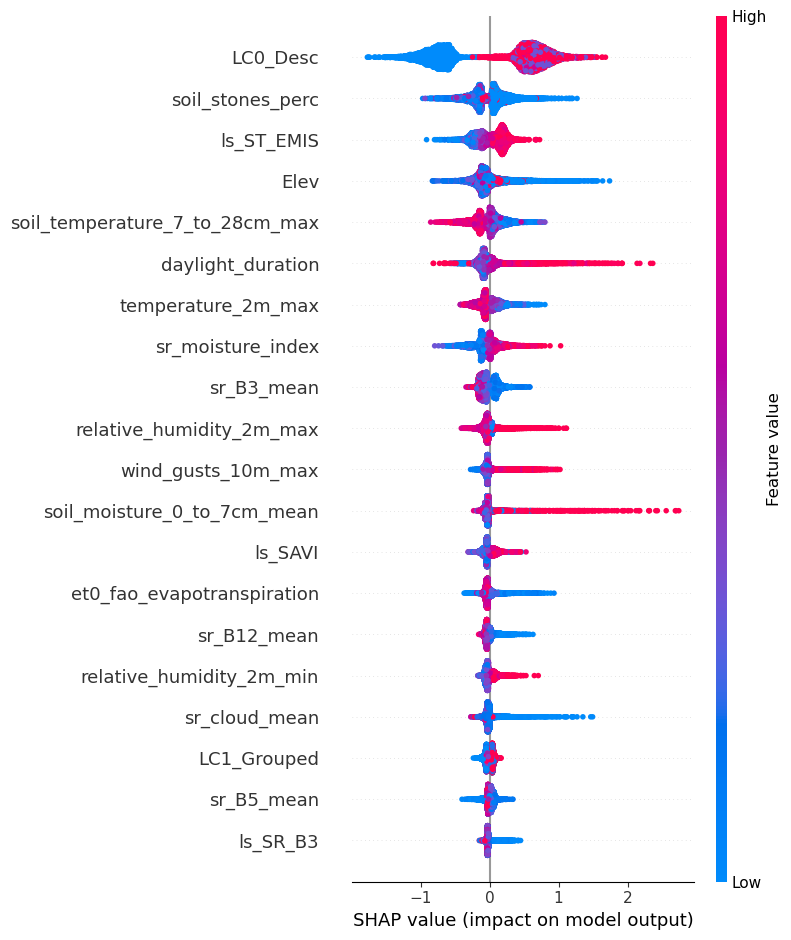

In [127]:
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)

# Visualise for one prediction
shap.force_plot(explainer.expected_value, shap_values[0, :], X_test.iloc[0, :])

# Summary plot for all predictions
shap.summary_plot(shap_values, X_test)

In [128]:
shap_importances = np.abs(shap_values).mean(axis=0)
importance_df = pd.DataFrame({
    "feature": X_test.columns,
    "importance": shap_importances
}) .sort_values("importance", ascending=False)

importance_df

,feature,importance
1,LC0_Desc,0.706595
8,soil_stones_perc,0.200366
41,ls_ST_EMIS,0.172757
0,Elev,0.162325
63,soil_temperature_7_to_28cm_max,0.149731
...,...,...
52,s1_days_diff,0.007665
36,ls_SR_QA_AEROSOL,0.007515
3,parcel_area_ha,0.006393
4,crop_residues,0.005316


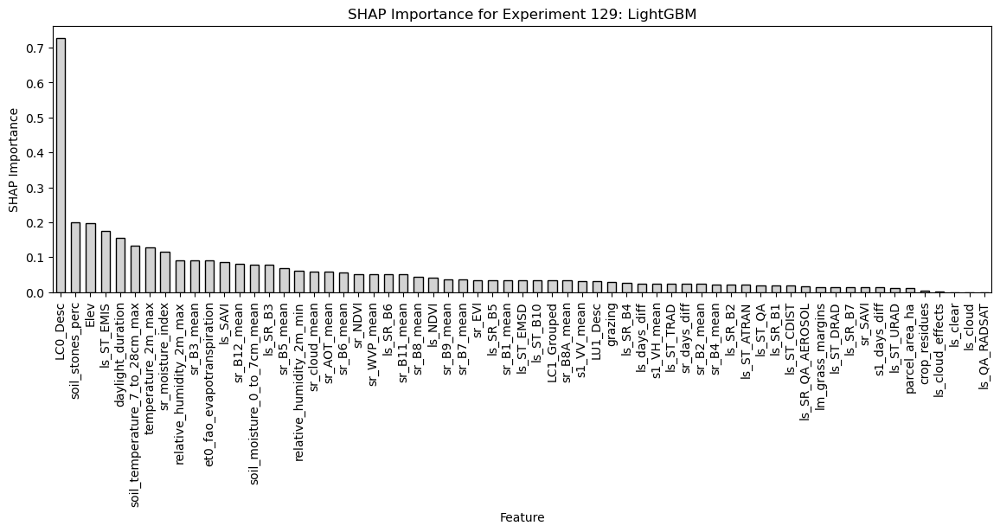

In [49]:
plt.figure(figsize=(14,4))
sns.barplot(importance_df, x='feature', y='importance', color='lightgrey', edgecolor='black', width=0.6)
plt.xticks(rotation=90)
plt.xlabel('Feature')
plt.ylabel('SHAP Importance')
plt.title("SHAP Importance for Experiment 129: LightGBM")
plt.show()

In [129]:
# Save as csv
filename = f"experiment_tracking/feature_importance/{now}_{TARGET_COL}_{experiment_number}_shap_values.csv"
importance_df.to_csv(filename, index=False)

## Modelling Loop

In [15]:
cat_cols = ['LC0_Desc', 'LU1_Desc', 'LC1_Grouped']

stratifyby = "LC0_Desc" # 'stratify_bin' # 
stratify_description = "LC0_Desc ONLY"

model_types = [
    'xgboost', 
    'lightgbm', 
    'catboost', 
]

# Shared configuration
TARGET_COL = 'N'                     # Target to predict
ID_COLS = ['point_id', 'OC']                    # Unique identifiers
DROP_COLS = ['survey_date', 'stratify_bin', 'QA_RADSTAT']               # Columns to drop from input
TEST_SIZE = 0.2                           # Train-test split size
USE_LOG_TARGET = False                     # Whether to log-transform the target
TUNE = True                               # Whether to run Optuna tuning
CUSTOM_PARAMS = {}                        # Provide your own params if TUNE = False
N_TRIALS = 30                             # Optuna trials
TIMEOUT = 300                             # Optuna timeout in seconds
results_file = f"experiment_tracking/raw_experiment_log_{TARGET_COL}.xlsx"
params_file = f"experiment_tracking/best_params_{TARGET_COL}.xlsx"
importance_file = "" #f"experiment_tracking/raw_feature_analysis_{TARGET_COL}.xlsx"

SAVE_MODEL = True

for i in range(110,125):
    DATASET_FILENAME = filenames[i]
    NOTES = notes[i] + f" - Stratify by {stratify_description}"

    df = pd.read_csv(DATASET_FILENAME)
    # Transformations
    encoder = OrdinalEncoder()
    enc_df = df.copy()
    enc_df[cat_cols] = encoder.fit_transform(enc_df[cat_cols])
    enc_df = enc_df.replace({True: 1, False: 0, '< 0.5 ha': 0, '0.5 - 1 ha': 1, '1 - 10 ha': 2, '> 10 ha': 3})

    # Code to stratify by OC or N level - bucket into categories
    enc_df['N_binned'] = pd.qcut(enc_df['N'], q=10, labels=False)

    # Stratify by OC and LC0_Desc
    enc_df['stratify_bin'] = enc_df['LC0_Desc'].astype(str) + "_" + enc_df['N_binned'].astype(str)
    enc_df = enc_df.drop(columns=['N_binned'])

    # Train without satellite imagery
    if i == 114:
        cols = enc_df.columns.values
        cols = [col for col in cols if not col.startswith("sr_")]
        cols = [col for col in cols if not col.startswith("ls_")]
        cols = [col for col in cols if not col.startswith("s1_")]
        enc_df = enc_df[cols]


    # Loop over models
    for model_type in model_types:
        print(f"\nTraining model: {model_type.upper()}")
        trainer = ModelTrainer(df=enc_df, target_col=TARGET_COL, id_cols=ID_COLS, drop_cols=DROP_COLS, model_type=model_type, notes=NOTES)
        trainer.prepare_data(test_size=TEST_SIZE, stratifyby=stratifyby)

        if TUNE:
            trainer.tune_hyperparams(n_trials=N_TRIALS, timeout=TIMEOUT)
            trainer.train_final_model(use_log_target=USE_LOG_TARGET, save_model=SAVE_MODEL)
        else:
            trainer.train_final_model(use_log_target=USE_LOG_TARGET, custom_params=CUSTOM_PARAMS, save_model=SAVE_MODEL)

        trainer.evaluate()
        # trainer.compute_feature_importances()
        trainer.save_results(model_log_path=results_file, importance_log_path=importance_file)

[I 2025-08-10 20:22:26,196] A new study created in memory with name: no-name-52a212c4-1499-4618-a5ee-f0e9ad1ca5bd



Training model: XGBOOST


[I 2025-08-10 20:22:27,537] Trial 0 finished with value: 11.306344589399128 and parameters: {'n_estimators': 285, 'max_depth': 6, 'learning_rate': 0.04335806580295138, 'subsample': 0.6891928253660742, 'colsample_bytree': 0.616864642189707, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 11.306344589399128.
[I 2025-08-10 20:22:30,403] Trial 1 finished with value: 11.559977701612876 and parameters: {'n_estimators': 233, 'max_depth': 17, 'learning_rate': 0.05135753961598473, 'subsample': 0.6789339970738419, 'colsample_bytree': 0.9328044646377776, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 11.306344589399128.
[I 2025-08-10 20:22:46,895] Trial 2 finished with value: 11.598256336673957 and parameters: {'n_estimators': 278, 'max_depth': 18, 'learning_rate': 0.0734324232689025, 'subsample': 0.8085929734989281, 'colsample_bytree': 0.9423563693478971, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 11.306344589399


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7235571981858572, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7235571981858572
[LightGBM] [Warning] bagging_fraction is set=0.7482932857540447, subsample=0.6964362719028407 will be ignored. Current value: bagging_fraction=0.7482932857540447
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7235571981858572, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7235571981858572
[LightGBM] [Warning] bagging_fraction is set=0.748

[I 2025-08-10 20:24:11,244] Trial 0 finished with value: 12.811191072147054 and parameters: {'n_estimators': 225, 'max_depth': 13, 'learning_rate': 0.0002713282102717637, 'num_leaves': 61, 'min_data_in_leaf': 43, 'feature_fraction': 0.7235571981858572, 'bagging_fraction': 0.7482932857540447, 'bagging_freq': 1, 'min_child_samples': 54, 'subsample': 0.6964362719028407, 'colsample_by_tree': 0.9096127495935291, 'reg_alpha': 1.1386314671065831e-06, 'reg_lambda': 0.00020285212926375086}. Best is trial 0 with value: 12.811191072147054.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7235571981858572, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7235571981858572
[LightGBM] [Warning] bagging_fraction is set=0.7482932857540447, subsample=0.6964362719028407 will be ignored. Current value: bagging_fraction=0.7482932857540447
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7609417027674166, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7609417027674166
[LightGBM] [Warning] bagging_fraction is set=0.7252966624965098, subsample=0

[I 2025-08-10 20:24:31,708] Trial 1 finished with value: 12.132249786116818 and parameters: {'n_estimators': 806, 'max_depth': 9, 'learning_rate': 0.00033644790264762204, 'num_leaves': 71, 'min_data_in_leaf': 46, 'feature_fraction': 0.7609417027674166, 'bagging_fraction': 0.7252966624965098, 'bagging_freq': 2, 'min_child_samples': 28, 'subsample': 0.7889485798384898, 'colsample_by_tree': 0.643682418218756, 'reg_alpha': 1.665568331745492e-08, 'reg_lambda': 2.9071530783418724e-07}. Best is trial 1 with value: 12.132249786116818.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7609417027674166, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7609417027674166
[LightGBM] [Warning] bagging_fraction is set=0.7252966624965098, subsample=0.7889485798384898 will be ignored. Current value: bagging_fraction=0.7252966624965098
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=28 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8175367065019347, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8175367065019347
[LightGBM] [Warning] bagging_fraction is set=0.8196236129105805, subsample=0

[I 2025-08-10 20:24:37,337] Trial 2 finished with value: 12.975352728817985 and parameters: {'n_estimators': 457, 'max_depth': 8, 'learning_rate': 0.278269244499351, 'num_leaves': 99, 'min_data_in_leaf': 48, 'feature_fraction': 0.8175367065019347, 'bagging_fraction': 0.8196236129105805, 'bagging_freq': 1, 'min_child_samples': 85, 'subsample': 0.9108868451973959, 'colsample_by_tree': 0.6321289090583009, 'reg_alpha': 9.367763224119506e-07, 'reg_lambda': 1.5369440588313277e-06}. Best is trial 1 with value: 12.132249786116818.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8175367065019347, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8175367065019347
[LightGBM] [Warning] bagging_fraction is set=0.8196236129105805, subsample=0.9108868451973959 will be ignored. Current value: bagging_fraction=0.8196236129105805
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=8

[I 2025-08-10 20:24:50,257] Trial 3 finished with value: 11.05224765076629 and parameters: {'n_estimators': 930, 'max_depth': 10, 'learning_rate': 0.026120427866031325, 'num_leaves': 65, 'min_data_in_leaf': 60, 'feature_fraction': 0.9049918844087975, 'bagging_fraction': 0.9198805370596049, 'bagging_freq': 1, 'min_child_samples': 62, 'subsample': 0.8056697527342747, 'colsample_by_tree': 0.9254322432738376, 'reg_alpha': 0.012241253243722992, 'reg_lambda': 3.3007304067234373}. Best is trial 3 with value: 11.05224765076629.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9049918844087975, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9049918844087975
[LightGBM] [Warning] bagging_fraction is set=0.9198805370596049, subsample=0.805

[I 2025-08-10 20:24:52,836] Trial 4 finished with value: 12.902980563994836 and parameters: {'n_estimators': 240, 'max_depth': 6, 'learning_rate': 0.000166938946351945, 'num_leaves': 146, 'min_data_in_leaf': 35, 'feature_fraction': 0.867162218093766, 'bagging_fraction': 0.767788900582048, 'bagging_freq': 1, 'min_child_samples': 57, 'subsample': 0.8783483838012003, 'colsample_by_tree': 0.6596837145164346, 'reg_alpha': 0.9975018665101477, 'reg_lambda': 6.919547408768151}. Best is trial 3 with value: 11.05224765076629.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.867162218093766, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.867162218093766
[LightGBM] [Warning] bagging_fraction is set=0.767788900582048, subsample=0.8783483838012003 will be ignored. Current value: bagging_fraction=0.767788900582048
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2

[I 2025-08-10 20:25:02,678] Trial 5 finished with value: 12.803332692559241 and parameters: {'n_estimators': 254, 'max_depth': 14, 'learning_rate': 0.00023568782858819499, 'num_leaves': 144, 'min_data_in_leaf': 46, 'feature_fraction': 0.8328375969967133, 'bagging_fraction': 0.8620196225478884, 'bagging_freq': 2, 'min_child_samples': 61, 'subsample': 0.8289333953421847, 'colsample_by_tree': 0.8786207192842875, 'reg_alpha': 0.007738675352163718, 'reg_lambda': 7.363565728060146e-08}. Best is trial 3 with value: 11.05224765076629.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8328375969967133, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8328375969967133
[LightGBM] [Warning] bagging_fraction is set=0.8620196225478884, subsample=0.8289333953421847 will be ignored. Current value: bagging_fraction=0.8620196225478884
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=61 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 20:25:09,680] Trial 6 finished with value: 11.086908611531815 and parameters: {'n_estimators': 424, 'max_depth': 8, 'learning_rate': 0.0022515610938624317, 'num_leaves': 143, 'min_data_in_leaf': 56, 'feature_fraction': 0.9180892824497896, 'bagging_fraction': 0.792986104188122, 'bagging_freq': 1, 'min_child_samples': 74, 'subsample': 0.7210371054617551, 'colsample_by_tree': 0.6563311024101214, 'reg_alpha': 0.0007547261147557294, 'reg_lambda': 9.848815686299625e-07}. Best is trial 3 with value: 11.05224765076629.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9180892824497896, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9180892824497896
[LightGBM] [Warning] bagging_fraction is set=0.792986104188122, subsample=0.7210371054617551 will be ignored. Current value: bagging_fraction=0.792986104188122
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=74 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.750009572944141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.750009572944141
[LightGBM] [Warning] bagging_fraction is set=0.8673113468520591, subsample=0.860

[I 2025-08-10 20:25:16,553] Trial 7 finished with value: 10.59699133742555 and parameters: {'n_estimators': 687, 'max_depth': 7, 'learning_rate': 0.011210815963093214, 'num_leaves': 46, 'min_data_in_leaf': 49, 'feature_fraction': 0.750009572944141, 'bagging_fraction': 0.8673113468520591, 'bagging_freq': 3, 'min_child_samples': 100, 'subsample': 0.8605538665922088, 'colsample_by_tree': 0.9678486475852267, 'reg_alpha': 0.947317538430067, 'reg_lambda': 0.01082900202697215}. Best is trial 7 with value: 10.59699133742555.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM

[I 2025-08-10 20:25:32,707] Trial 8 finished with value: 11.099205520848422 and parameters: {'n_estimators': 603, 'max_depth': 10, 'learning_rate': 0.06960426775959136, 'num_leaves': 118, 'min_data_in_leaf': 53, 'feature_fraction': 0.7344817326523713, 'bagging_fraction': 0.9612846668011197, 'bagging_freq': 3, 'min_child_samples': 78, 'subsample': 0.797433538575751, 'colsample_by_tree': 0.9610071838179676, 'reg_alpha': 3.7551238348997287e-06, 'reg_lambda': 1.4679073031784755e-05}. Best is trial 7 with value: 10.59699133742555.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7344817326523713, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7344817326523713
[LightGBM] [Warning] bagging_fraction is set=0.9612846668011197, subsample=0.797433538575751 will be ignored. Current value: bagging_fraction=0.9612846668011197
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=78 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8708715709362508, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8708715709362508
[LightGBM] [Warning] bagging_fraction is set=0.8667334074440007, subsample=0.

[I 2025-08-10 20:25:51,849] Trial 9 finished with value: 11.348044652482454 and parameters: {'n_estimators': 721, 'max_depth': 12, 'learning_rate': 0.15176999506047267, 'num_leaves': 141, 'min_data_in_leaf': 20, 'feature_fraction': 0.8708715709362508, 'bagging_fraction': 0.8667334074440007, 'bagging_freq': 2, 'min_child_samples': 90, 'subsample': 0.9158292801192385, 'colsample_by_tree': 0.8616064874860985, 'reg_alpha': 1.0995969916120543, 'reg_lambda': 9.372807823249676}. Best is trial 7 with value: 10.59699133742555.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9856390203774492, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9856390203774492
[LightGBM] [Warning] bagging_fraction is set=0.9908499813249242, subsample=0.6398474828845335 will be ignored. Current value: bagging_fraction=0.9908499813249242
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=5 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9856390203774492, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9856390203774492
[LightGBM] [Warning] bagging_fraction is set=0.9908499813249242, subsample=0.

[I 2025-08-10 20:25:53,468] Trial 10 finished with value: 10.893390810815786 and parameters: {'n_estimators': 627, 'max_depth': 3, 'learning_rate': 0.0060535555306841455, 'num_leaves': 21, 'min_data_in_leaf': 32, 'feature_fraction': 0.9856390203774492, 'bagging_fraction': 0.9908499813249242, 'bagging_freq': 3, 'min_child_samples': 5, 'subsample': 0.6398474828845335, 'colsample_by_tree': 0.746176863370694, 'reg_alpha': 2.83554950686073, 'reg_lambda': 0.017007988201545792}. Best is trial 7 with value: 10.59699133742555.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:25:57,204] Trial 11 finished with value: 10.863262549451587 and parameters: {'n_estimators': 641, 'max_depth': 3, 'learning_rate': 0.007072273889721001, 'num_leaves': 25, 'min_data_in_leaf': 33, 'feature_fraction': 0.9959502128258582, 'bagging_fraction': 0.9855590518214379, 'bagging_freq': 3, 'min_child_samples': 8, 'subsample': 0.6083758684296457, 'colsample_by_tree': 0.7577034148177462, 'reg_alpha': 8.05946284454482, 'reg_lambda': 0.02448245598160578}. Best is trial 7 with value: 10.59699133742555.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9959502128258582, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9959502128258582
[LightGBM] [Warning] bagging_fraction is set=0.9855590518214379, subsample=0.6083758684296457 will be ignored. Current value: bagging_fraction=0.9855590518214379
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=8 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is se

[I 2025-08-10 20:25:59,323] Trial 12 finished with value: 10.886020257451866 and parameters: {'n_estimators': 811, 'max_depth': 3, 'learning_rate': 0.00779941769730484, 'num_leaves': 23, 'min_data_in_leaf': 28, 'feature_fraction': 0.9974616066456738, 'bagging_fraction': 0.914678696272463, 'bagging_freq': 3, 'min_child_samples': 35, 'subsample': 0.9926094014493512, 'colsample_by_tree': 0.7697327901721357, 'reg_alpha': 8.87783785150151, 'reg_lambda': 0.011725034221316962}. Best is trial 7 with value: 10.59699133742555.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:26:04,407] Trial 13 finished with value: 10.963213882969264 and parameters: {'n_estimators': 997, 'max_depth': 5, 'learning_rate': 0.0015597838828916811, 'num_leaves': 42, 'min_data_in_leaf': 38, 'feature_fraction': 0.7861039813871273, 'bagging_fraction': 0.9068360472997363, 'bagging_freq': 3, 'min_child_samples': 12, 'subsample': 0.6159981057182768, 'colsample_by_tree': 0.8199635802233063, 'reg_alpha': 0.1298986771769187, 'reg_lambda': 0.037735364701678265}. Best is trial 7 with value: 10.59699133742555.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:26:06,174] Trial 14 finished with value: 10.73824414553091 and parameters: {'n_estimators': 489, 'max_depth': 5, 'learning_rate': 0.017562061247556056, 'num_leaves': 42, 'min_data_in_leaf': 27, 'feature_fraction': 0.9474168357028308, 'bagging_fraction': 0.9876429581222272, 'bagging_freq': 3, 'min_child_samples': 34, 'subsample': 0.7172841605426789, 'colsample_by_tree': 0.7290939081914497, 'reg_alpha': 0.07943892585200475, 'reg_lambda': 0.0008971448125340759}. Best is trial 7 with value: 10.59699133742555.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9474168357028308, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9474168357028308
[Ligh

[I 2025-08-10 20:26:08,629] Trial 15 finished with value: 10.776115900917333 and parameters: {'n_estimators': 435, 'max_depth': 6, 'learning_rate': 0.01929536547573919, 'num_leaves': 45, 'min_data_in_leaf': 20, 'feature_fraction': 0.9411921489959416, 'bagging_fraction': 0.9494657070803232, 'bagging_freq': 3, 'min_child_samples': 38, 'subsample': 0.7207851962682271, 'colsample_by_tree': 0.7197949312963907, 'reg_alpha': 0.028240274884587968, 'reg_lambda': 0.0007574909398763257}. Best is trial 7 with value: 10.59699133742555.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9411921489959416, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9411921489959416
[LightGBM] [Warning] bagging_fraction is set=0.9494657070803232, subsample=0.7207851962682271 will be ignored. Current value: bagging_fraction=0.9494657070803232
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=38 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] 

[I 2025-08-10 20:26:09,116] Trial 16 finished with value: 10.773059012445051 and parameters: {'n_estimators': 111, 'max_depth': 5, 'learning_rate': 0.03081089117113724, 'num_leaves': 90, 'min_data_in_leaf': 26, 'feature_fraction': 0.7032547046052187, 'bagging_fraction': 0.7010296978345388, 'bagging_freq': 2, 'min_child_samples': 22, 'subsample': 0.7613062415183631, 'colsample_by_tree': 0.9974834040412756, 'reg_alpha': 0.00010930931803050987, 'reg_lambda': 0.0005219319474379788}. Best is trial 7 with value: 10.59699133742555.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:26:12,290] Trial 17 finished with value: 11.127767486520627 and parameters: {'n_estimators': 519, 'max_depth': 7, 'learning_rate': 0.05391648934828678, 'num_leaves': 40, 'min_data_in_leaf': 39, 'feature_fraction': 0.7989789401839101, 'bagging_fraction': 0.8189910824460437, 'bagging_freq': 3, 'min_child_samples': 97, 'subsample': 0.8579246757281347, 'colsample_by_tree': 0.7009553701889144, 'reg_alpha': 0.15661594085088765, 'reg_lambda': 0.4085474512544615}. Best is trial 7 with value: 10.59699133742555.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7989789401839101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7989789401839101
[LightGBM] [Warning] bagging_fraction is set=0.8189910824460437, subsample=0.8579246757281347 will be ignored. Current value: bagging_fraction=0.8189910824460437
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=97 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9489800308882528, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9489800308882528
[LightGBM] [Warning] bagging_fraction is set=0.8891646335410203, subsample=0

[I 2025-08-10 20:26:14,027] Trial 18 finished with value: 11.671577368714344 and parameters: {'n_estimators': 334, 'max_depth': 5, 'learning_rate': 0.001660211243794699, 'num_leaves': 54, 'min_data_in_leaf': 52, 'feature_fraction': 0.9489800308882528, 'bagging_fraction': 0.8891646335410203, 'bagging_freq': 2, 'min_child_samples': 46, 'subsample': 0.6695488000823989, 'colsample_by_tree': 0.8167276481502294, 'reg_alpha': 0.00038313426031935096, 'reg_lambda': 4.5125365155684755e-05}. Best is trial 7 with value: 10.59699133742555.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:26:19,312] Trial 19 finished with value: 10.734836488827662 and parameters: {'n_estimators': 737, 'max_depth': 7, 'learning_rate': 0.014568875139050783, 'num_leaves': 78, 'min_data_in_leaf': 26, 'feature_fraction': 0.891344513202831, 'bagging_fraction': 0.9434512020232757, 'bagging_freq': 3, 'min_child_samples': 70, 'subsample': 0.9780506201837782, 'colsample_by_tree': 0.8468534328276787, 'reg_alpha': 0.0023612721460583006, 'reg_lambda': 0.13752033324428442}. Best is trial 7 with value: 10.59699133742555.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.891344513202831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.891344513202831
[LightGBM] [Warning] bagging_fraction is set=0.9434512020232757, subsample=0.9780506201837782 will be ignored. Current value: bagging_fraction=0.9434512020232757
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=70 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set

[I 2025-08-10 20:26:29,941] Trial 20 finished with value: 10.621949236701953 and parameters: {'n_estimators': 745, 'max_depth': 11, 'learning_rate': 0.0030561588101968916, 'num_leaves': 80, 'min_data_in_leaf': 43, 'feature_fraction': 0.8880920492703478, 'bagging_fraction': 0.9409460328952924, 'bagging_freq': 2, 'min_child_samples': 73, 'subsample': 0.969801689331446, 'colsample_by_tree': 0.8548549790177349, 'reg_alpha': 3.057168334818877e-05, 'reg_lambda': 0.22496987762316353}. Best is trial 7 with value: 10.59699133742555.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8880920492703478, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8880920492703478
[LightGBM] [Warning] bagging_fraction is set=0.9409460328952924, subsample=0.969801689331446 will be ignored. Current value: bagging_fraction=0.9409460328952924
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=73 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8910869559210187, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8910869559210187
[LightGBM] [Warning] bagging_fraction is set=0.9500693121458518, subsample=0.

[I 2025-08-10 20:26:45,408] Trial 21 finished with value: 10.562368241736152 and parameters: {'n_estimators': 732, 'max_depth': 11, 'learning_rate': 0.003257352186101777, 'num_leaves': 83, 'min_data_in_leaf': 41, 'feature_fraction': 0.8910869559210187, 'bagging_fraction': 0.9500693121458518, 'bagging_freq': 2, 'min_child_samples': 71, 'subsample': 0.9269057797132907, 'colsample_by_tree': 0.8573775810698612, 'reg_alpha': 4.4264974753374494e-05, 'reg_lambda': 0.38311956967126676}. Best is trial 21 with value: 10.562368241736152.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8910869559210187, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8910869559210187
[LightGBM] [Warning] bagging_fraction is set=0.9500693121458518, subsample=0.9269057797132907 will be ignored. Current value: bagging_fraction=0.9500693121458518
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8448343574214856, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8448343574214856
[

[I 2025-08-10 20:27:01,968] Trial 22 finished with value: 11.253219997897766 and parameters: {'n_estimators': 862, 'max_depth': 12, 'learning_rate': 0.0008295816847644517, 'num_leaves': 103, 'min_data_in_leaf': 41, 'feature_fraction': 0.8448343574214856, 'bagging_fraction': 0.888355436220651, 'bagging_freq': 2, 'min_child_samples': 98, 'subsample': 0.9554316693024875, 'colsample_by_tree': 0.9076202986712915, 'reg_alpha': 2.8529935985672486e-05, 'reg_lambda': 0.7489999090782794}. Best is trial 21 with value: 10.562368241736152.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8448343574214856, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8448343574214856
[LightGBM] [Warning] bagging_fraction is set=0.888355436220651, subsample=0.9554316693024875 will be ignored. Current value: bagging_fraction=0.888355436220651
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=98 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.879371706794054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.879371706794054
[LightGBM] [Warning] bagging_fraction is set=0.9455429237326408, subsample=0.927

[I 2025-08-10 20:27:14,946] Trial 23 finished with value: 10.59481079642736 and parameters: {'n_estimators': 727, 'max_depth': 11, 'learning_rate': 0.0030891955726167117, 'num_leaves': 115, 'min_data_in_leaf': 51, 'feature_fraction': 0.879371706794054, 'bagging_fraction': 0.9455429237326408, 'bagging_freq': 2, 'min_child_samples': 83, 'subsample': 0.9271240583709985, 'colsample_by_tree': 0.9454587996853137, 'reg_alpha': 2.795703705478085e-05, 'reg_lambda': 0.005531486846361897}. Best is trial 21 with value: 10.562368241736152.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.879371706794054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.879371706794054
[LightGBM] [Warning] bagging_fraction is set=0.9455429237326408, subsample=0.9271240583709985 will be ignored. Current value: bagging_fraction=0.9455429237326408
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=83 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Un

[I 2025-08-10 20:27:28,816] Trial 24 finished with value: 11.689109119381175 and parameters: {'n_estimators': 683, 'max_depth': 15, 'learning_rate': 0.0006550879537280886, 'num_leaves': 118, 'min_data_in_leaf': 51, 'feature_fraction': 0.8591179286363273, 'bagging_fraction': 0.8360018372723554, 'bagging_freq': 2, 'min_child_samples': 86, 'subsample': 0.9207744651219117, 'colsample_by_tree': 0.964398261630472, 'reg_alpha': 4.0275923320325634e-08, 'reg_lambda': 0.003960873469749319}. Best is trial 21 with value: 10.562368241736152.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7653524570809608, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7653524570809608
[LightGBM] [Warning] bagging_fraction is set=0.8849980738450091, subsample=0.8836033910264728 will be ignored. Current value: bagging_fraction=0.8849980738450091
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=82 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7653524570809608, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7653524570809608
[LightGBM] [Warning] bagging_fraction is set=0.8849980738450091, subsample=0

[I 2025-08-10 20:27:37,651] Trial 25 finished with value: 10.639505385613068 and parameters: {'n_estimators': 589, 'max_depth': 10, 'learning_rate': 0.0034456284235638624, 'num_leaves': 125, 'min_data_in_leaf': 57, 'feature_fraction': 0.7653524570809608, 'bagging_fraction': 0.8849980738450091, 'bagging_freq': 2, 'min_child_samples': 82, 'subsample': 0.8836033910264728, 'colsample_by_tree': 0.995214511237387, 'reg_alpha': 7.57886530982895e-06, 'reg_lambda': 0.08351734003181806}. Best is trial 21 with value: 10.562368241736152.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7653524570809608, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7653524570809608
[LightGBM] [Warning] bagging_fraction is set=0.8849980738450091, subsample=0.8836033910264728 will be ignored. Current value: bagging_fraction=0.8849980738450091
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=82 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8171794015850522, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8171794015850522
[LightGBM] [Warning] bagging_fraction is set=0.928368098271806, subsample=0.

[I 2025-08-10 20:27:48,067] Trial 26 finished with value: 10.575966870299833 and parameters: {'n_estimators': 852, 'max_depth': 12, 'learning_rate': 0.009312927201627172, 'num_leaves': 94, 'min_data_in_leaf': 49, 'feature_fraction': 0.8171794015850522, 'bagging_fraction': 0.928368098271806, 'bagging_freq': 2, 'min_child_samples': 91, 'subsample': 0.9405837635648828, 'colsample_by_tree': 0.9444737777735617, 'reg_alpha': 2.905681144201604e-07, 'reg_lambda': 0.003127956269876044}. Best is trial 21 with value: 10.562368241736152.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8171794015850522, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8171794015850522
[LightGBM] [Warning] bagging_fraction is set=0.928368098271806, subsample=0.9405837635648828 will be ignored. Current value: bagging_fraction=0.928368098271806
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=91 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.82617120327232, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.82617120327232
[LightGBM] [Warning] bagging_fraction is set=0.9688345151604176, subsample=0.93233

[I 2025-08-10 20:28:01,972] Trial 27 finished with value: 10.515539387717899 and parameters: {'n_estimators': 940, 'max_depth': 12, 'learning_rate': 0.004039656895453084, 'num_leaves': 102, 'min_data_in_leaf': 55, 'feature_fraction': 0.82617120327232, 'bagging_fraction': 0.9688345151604176, 'bagging_freq': 2, 'min_child_samples': 67, 'subsample': 0.9323315574304286, 'colsample_by_tree': 0.9339923746732519, 'reg_alpha': 1.411821596169218e-07, 'reg_lambda': 0.0019524730254758392}. Best is trial 27 with value: 10.515539387717899.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.82617120327232, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.82617120327232
[LightGBM] [Warning] bagging_fraction is set=0.9688345151604176, subsample=0.9323315574304286 will be ignored. Current value: bagging_fraction=0.9688345151604176
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=67 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8171484494068373, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8171484494068373
[Ligh

[I 2025-08-10 20:28:18,829] Trial 28 finished with value: 11.280675029649375 and parameters: {'n_estimators': 917, 'max_depth': 13, 'learning_rate': 0.000773366502154878, 'num_leaves': 96, 'min_data_in_leaf': 56, 'feature_fraction': 0.8171484494068373, 'bagging_fraction': 0.966066759732247, 'bagging_freq': 2, 'min_child_samples': 69, 'subsample': 0.9427336116819187, 'colsample_by_tree': 0.8954843291696216, 'reg_alpha': 1.5067388375783288e-07, 'reg_lambda': 8.903549500939246e-05}. Best is trial 27 with value: 10.515539387717899.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8171484494068373, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8171484494068373
[LightGBM] [Warning] bagging_fraction is set=0.966066759732247, subsample=0.9427336116819187 will be ignored. Current value: bagging_fraction=0.966066759732247
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=69 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7902055067178286, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7902055067178286
[LightGBM] [Warning] bagging_fraction is set=0.9246474579548032, subsample=0.8

[I 2025-08-10 20:28:38,051] Trial 29 finished with value: 10.489398407387185 and parameters: {'n_estimators': 992, 'max_depth': 14, 'learning_rate': 0.003944494488998772, 'num_leaves': 109, 'min_data_in_leaf': 44, 'feature_fraction': 0.7902055067178286, 'bagging_fraction': 0.9246474579548032, 'bagging_freq': 1, 'min_child_samples': 49, 'subsample': 0.882773988995907, 'colsample_by_tree': 0.9335793771683673, 'reg_alpha': 3.654332538281447e-07, 'reg_lambda': 1.2343820406256122e-05}. Best is trial 29 with value: 10.489398407387185.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7902055067178286, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7902055067178286
[LightGBM] [Warning] bagging_fraction is set=0.9246474579548032, subsample=0.882773988995907 will be ignored. Current value: bagging_fraction=0.9246474579548032
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=49 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] U

[I 2025-08-10 20:29:03,212] A new study created in memory with name: no-name-1551d7ea-3a3c-48c2-a5e7-5bb463d17e71



Training model: CATBOOST


[I 2025-08-10 20:29:04,285] Trial 0 finished with value: 11.185595592490738 and parameters: {'depth': 3, 'learning_rate': 0.0013770392865353562, 'l2_leaf_reg': 0.5079380070900547, 'iterations': 1420, 'bagging_temperature': 0.7177494818862182, 'random_strength': 0.6258715971124844, 'rsm': 0.6720920358223073, 'border_count': 234}. Best is trial 0 with value: 11.185595592490738.
[I 2025-08-10 20:29:12,353] Trial 1 finished with value: 10.827990366953061 and parameters: {'depth': 10, 'learning_rate': 0.004102935924391833, 'l2_leaf_reg': 0.35767233562411027, 'iterations': 810, 'bagging_temperature': 0.7724246598655857, 'random_strength': 0.3910936106640227, 'rsm': 0.8481957825138957, 'border_count': 226}. Best is trial 1 with value: 10.827990366953061.
[I 2025-08-10 20:29:14,208] Trial 2 finished with value: 11.35492696531951 and parameters: {'depth': 5, 'learning_rate': 0.04357196687347247, 'l2_leaf_reg': 1.7616681972308947, 'iterations': 1477, 'bagging_temperature': 0.12742246163570936, '


Training model: XGBOOST


[I 2025-08-10 20:31:14,426] Trial 0 finished with value: 8.8030393745038 and parameters: {'n_estimators': 134, 'max_depth': 8, 'learning_rate': 0.1433555458965333, 'subsample': 0.6888664007403416, 'colsample_bytree': 0.7790848320028286, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 8.8030393745038.
[I 2025-08-10 20:31:16,864] Trial 1 finished with value: 9.435019856202338 and parameters: {'n_estimators': 278, 'max_depth': 7, 'learning_rate': 0.28236414335598414, 'subsample': 0.8259844977758717, 'colsample_bytree': 0.5047172405322087, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 8.8030393745038.
[I 2025-08-10 20:31:21,503] Trial 2 finished with value: 8.84425724632179 and parameters: {'n_estimators': 122, 'max_depth': 11, 'learning_rate': 0.06221450647862041, 'subsample': 0.5722369614475591, 'colsample_bytree': 0.6608152430529117, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 8.8030393745038.
[I 2025-08


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9985880898963321, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9985880898963321
[LightGBM] [Warning] bagging_fraction is set=0.9831572465970048, subsample=0.9868319181573887 will be ignored. Current value: bagging_fraction=0.9831572465970048
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=40 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9985880898963321, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9985880898963321
[LightGBM] [Warning] bagging_fraction is set=0.983

[I 2025-08-10 20:34:14,087] Trial 0 finished with value: 9.445744942926801 and parameters: {'n_estimators': 584, 'max_depth': 11, 'learning_rate': 0.00047205830168163836, 'num_leaves': 29, 'min_data_in_leaf': 39, 'feature_fraction': 0.9985880898963321, 'bagging_fraction': 0.9831572465970048, 'bagging_freq': 1, 'min_child_samples': 40, 'subsample': 0.9868319181573887, 'colsample_by_tree': 0.851151146705057, 'reg_alpha': 1.4804135951485483e-05, 'reg_lambda': 0.7124734311275407}. Best is trial 0 with value: 9.445744942926801.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9985880898963321, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9985880898963321
[LightGBM] [Warning] bagging_fraction is set=0.9831572465970048, subsample=0.9868319181573887 will be ignored. Current value: bagging_fraction=0.9831572465970048
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=40 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.724915444078605, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.724915444078605
[LightGBM] [Warning] bagging_fraction is set=0.8173732488974533, subsample=0.7

[I 2025-08-10 20:34:19,057] Trial 1 finished with value: 8.277000390740172 and parameters: {'n_estimators': 674, 'max_depth': 5, 'learning_rate': 0.016561943604431393, 'num_leaves': 90, 'min_data_in_leaf': 37, 'feature_fraction': 0.724915444078605, 'bagging_fraction': 0.8173732488974533, 'bagging_freq': 3, 'min_child_samples': 70, 'subsample': 0.7260924350934287, 'colsample_by_tree': 0.8438943789512787, 'reg_alpha': 1.081244611078102e-07, 'reg_lambda': 4.864941878297994e-05}. Best is trial 1 with value: 8.277000390740172.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.724915444078605, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.724915444078605
[LightGBM] [Warning] bagging_fraction is set=0.8173732488974533, subsample=0.7260924350934287 will be ignored. Current value: bagging_fraction=0.8173732488974533
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=70 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightG

[I 2025-08-10 20:34:20,277] Trial 2 finished with value: 8.311857602734714 and parameters: {'n_estimators': 519, 'max_depth': 3, 'learning_rate': 0.01779400535398988, 'num_leaves': 41, 'min_data_in_leaf': 29, 'feature_fraction': 0.7213295847571369, 'bagging_fraction': 0.7857280041355428, 'bagging_freq': 1, 'min_child_samples': 20, 'subsample': 0.7881858985623101, 'colsample_by_tree': 0.9667268312388181, 'reg_alpha': 0.1415821786655994, 'reg_lambda': 0.0027096725700727587}. Best is trial 1 with value: 8.277000390740172.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-10 20:34:23,728] Trial 3 finished with value: 8.353424180694535 and parameters: {'n_estimators': 798, 'max_depth': 5, 'learning_rate': 0.01915052999544663, 'num_leaves': 80, 'min_data_in_leaf': 50, 'feature_fraction': 0.8146922038441061, 'bagging_fraction': 0.732106138036187, 'bagging_freq': 1, 'min_child_samples': 10, 'subsample': 0.9007776568546008, 'colsample_by_tree': 0.8059152223624382, 'reg_alpha': 0.0014661755586401041, 'reg_lambda': 2.2978362434592063}. Best is trial 1 with value: 8.277000390740172.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8146922038441061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8146922038441061
[LightGBM] [Warning] bagging_fraction is set=0.732106138036187, subsample=0.9007776568546008 will be ignored. Current value: bagging_fraction=0.732106138036187
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=10 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7058770152446099, colsample_bytree=

[I 2025-08-10 20:34:26,945] Trial 4 finished with value: 9.893675614988343 and parameters: {'n_estimators': 791, 'max_depth': 4, 'learning_rate': 0.0001216362660953103, 'num_leaves': 54, 'min_data_in_leaf': 46, 'feature_fraction': 0.7058770152446099, 'bagging_fraction': 0.8115703020061641, 'bagging_freq': 2, 'min_child_samples': 86, 'subsample': 0.7966446934585342, 'colsample_by_tree': 0.9049642119944208, 'reg_alpha': 1.7036631085769462e-05, 'reg_lambda': 1.9139638751673396e-07}. Best is trial 1 with value: 8.277000390740172.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:34:37,201] Trial 5 finished with value: 8.262319360845963 and parameters: {'n_estimators': 546, 'max_depth': 13, 'learning_rate': 0.0123540724038111, 'num_leaves': 115, 'min_data_in_leaf': 54, 'feature_fraction': 0.8614065576709753, 'bagging_fraction': 0.8410505267696367, 'bagging_freq': 1, 'min_child_samples': 5, 'subsample': 0.6914452509793293, 'colsample_by_tree': 0.7288215757703286, 'reg_alpha': 2.002921593438176e-06, 'reg_lambda': 0.04287495503900533}. Best is trial 5 with value: 8.262319360845963.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8614065576709753, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8614065576709753
[LightGBM] [Warning] bagging_fraction is set=0.8410505267696367, subsample=0.6914452509793293 will be ignored. Current value: bagging_fraction=0.8410505267696367
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=5 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Light

[I 2025-08-10 20:34:44,658] Trial 6 finished with value: 9.171523187564913 and parameters: {'n_estimators': 686, 'max_depth': 15, 'learning_rate': 0.0005733461431197868, 'num_leaves': 36, 'min_data_in_leaf': 50, 'feature_fraction': 0.8677740169202508, 'bagging_fraction': 0.7276387085222804, 'bagging_freq': 2, 'min_child_samples': 12, 'subsample': 0.9920916443807114, 'colsample_by_tree': 0.6302361473562224, 'reg_alpha': 6.435440876980798e-06, 'reg_lambda': 5.793091476556635e-07}. Best is trial 5 with value: 8.262319360845963.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8677740169202508, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8677740169202508
[LightGBM] [Warning] bagging_fraction is set=0.7276387085222804, subsample=0.9920916443807114 will be ignored. Current value: bagging_fraction=0.7276387085222804
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=12 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7766463187725563, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7766463187725563
[LightGBM] [Warning] bagging_fraction is set=0.9255595348259308, subsample=0

[I 2025-08-10 20:34:56,296] Trial 7 finished with value: 8.42483699347252 and parameters: {'n_estimators': 897, 'max_depth': 9, 'learning_rate': 0.001398459377601951, 'num_leaves': 51, 'min_data_in_leaf': 51, 'feature_fraction': 0.7766463187725563, 'bagging_fraction': 0.9255595348259308, 'bagging_freq': 1, 'min_child_samples': 47, 'subsample': 0.6247571107583064, 'colsample_by_tree': 0.9748934491673303, 'reg_alpha': 0.007061300773763954, 'reg_lambda': 1.8998371931544586e-08}. Best is trial 5 with value: 8.262319360845963.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7766463187725563, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7766463187725563
[LightGBM] [Warning] bagging_fraction is set=0.9255595348259308, subsample=0.6247571107583064 will be ignored. Current value: bagging_fraction=0.9255595348259308
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=47 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.738807856274397, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.738807856274397
[LightGBM] [Warning] bagging_fraction is set=0.8726490267255913, subsample=0.6

[I 2025-08-10 20:35:08,730] Trial 8 finished with value: 8.418419692882463 and parameters: {'n_estimators': 552, 'max_depth': 10, 'learning_rate': 0.0018824154804562238, 'num_leaves': 82, 'min_data_in_leaf': 24, 'feature_fraction': 0.738807856274397, 'bagging_fraction': 0.8726490267255913, 'bagging_freq': 3, 'min_child_samples': 66, 'subsample': 0.6986379941273019, 'colsample_by_tree': 0.6355645399755951, 'reg_alpha': 6.06609602971412e-08, 'reg_lambda': 3.805863902016297e-05}. Best is trial 5 with value: 8.262319360845963.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.738807856274397, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.738807856274397
[LightGBM] [Warning] bagging_fraction is set=0.8726490267255913, subsample=0.6986379941273019 will be ignored. Current value: bagging_fraction=0.8726490267255913
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=66 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7447024556537608, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7447024556537608
[LightGBM] [Warning] bagging_fraction is set=0.707630644220509, subsample=0.91

[I 2025-08-10 20:35:13,156] Trial 9 finished with value: 8.529881280172349 and parameters: {'n_estimators': 865, 'max_depth': 5, 'learning_rate': 0.03302143073356807, 'num_leaves': 87, 'min_data_in_leaf': 55, 'feature_fraction': 0.7447024556537608, 'bagging_fraction': 0.707630644220509, 'bagging_freq': 3, 'min_child_samples': 24, 'subsample': 0.918652071654104, 'colsample_by_tree': 0.7467999876935921, 'reg_alpha': 2.1681544644333234e-08, 'reg_lambda': 3.438063172641396e-06}. Best is trial 5 with value: 8.262319360845963.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:35:18,744] Trial 10 finished with value: 9.276665321945304 and parameters: {'n_estimators': 344, 'max_depth': 15, 'learning_rate': 0.14046984141724672, 'num_leaves': 147, 'min_data_in_leaf': 59, 'feature_fraction': 0.9138225779678827, 'bagging_fraction': 0.8964528639189985, 'bagging_freq': 2, 'min_child_samples': 95, 'subsample': 0.6311528694243242, 'colsample_by_tree': 0.718137116580849, 'reg_alpha': 0.4212099808346232, 'reg_lambda': 0.029255345793730198}. Best is trial 5 with value: 8.262319360845963.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9138225779678827, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9138225779678827
[LightGBM] [Warning] bagging_fraction is set=0.8964528639189985, subsample=0.6311528694243242 will be ignored. Current value: bagging_fraction=0.8964528639189985
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=95 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8793712830767368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8793712830767368
[LightGBM] [Warning] bagging_fraction is set=0.815030387658804, subsample=0.

[I 2025-08-10 20:35:20,033] Trial 11 finished with value: 8.837086586976879 and parameters: {'n_estimators': 110, 'max_depth': 7, 'learning_rate': 0.005602053392630414, 'num_leaves': 121, 'min_data_in_leaf': 38, 'feature_fraction': 0.8793712830767368, 'bagging_fraction': 0.815030387658804, 'bagging_freq': 3, 'min_child_samples': 70, 'subsample': 0.7066672376473982, 'colsample_by_tree': 0.7231499412000832, 'reg_alpha': 8.190793905986418e-07, 'reg_lambda': 0.00039866046874865595}. Best is trial 5 with value: 8.262319360845963.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8793712830767368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8793712830767368
[LightGBM] [Warning] bagging_fraction is set=0.815030387658804, subsample=0.7066672376473982 will be ignored. Current value: bagging_fraction=0.815030387658804
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=70 

[I 2025-08-10 20:35:25,250] Trial 12 finished with value: 9.335749419214023 and parameters: {'n_estimators': 369, 'max_depth': 12, 'learning_rate': 0.12666122549243214, 'num_leaves': 111, 'min_data_in_leaf': 31, 'feature_fraction': 0.8154751666036952, 'bagging_fraction': 0.8425756906774584, 'bagging_freq': 3, 'min_child_samples': 67, 'subsample': 0.7190913413551824, 'colsample_by_tree': 0.8467995684221797, 'reg_alpha': 5.221794669236965e-07, 'reg_lambda': 0.0317666279573898}. Best is trial 5 with value: 8.262319360845963.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8154751666036952, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8154751666036952
[LightGBM] [Warning] bagging_fraction is set=0.8425756906774584, subsample=0.7190913413551824 will be ignored. Current value: bagging_fraction=0.8425756906774584
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=67 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 20:35:40,852] Trial 13 finished with value: 8.160353315949202 and parameters: {'n_estimators': 997, 'max_depth': 13, 'learning_rate': 0.006564424598119557, 'num_leaves': 113, 'min_data_in_leaf': 42, 'feature_fraction': 0.9356129819419972, 'bagging_fraction': 0.7679310922357503, 'bagging_freq': 2, 'min_child_samples': 37, 'subsample': 0.7460876266116395, 'colsample_by_tree': 0.7587055970575667, 'reg_alpha': 1.0334251095175117e-08, 'reg_lambda': 5.427870635424567e-05}. Best is trial 13 with value: 8.160353315949202.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:35:56,954] Trial 14 finished with value: 8.118848224207582 and parameters: {'n_estimators': 983, 'max_depth': 13, 'learning_rate': 0.005282253090108788, 'num_leaves': 127, 'min_data_in_leaf': 45, 'feature_fraction': 0.9461856258978497, 'bagging_fraction': 0.759606810542427, 'bagging_freq': 2, 'min_child_samples': 33, 'subsample': 0.8564123041757682, 'colsample_by_tree': 0.6992012167120569, 'reg_alpha': 0.00020356094105622249, 'reg_lambda': 0.011259889057230486}. Best is trial 14 with value: 8.118848224207582.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9461856258978497, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9461856258978497
[LightGBM] [Warning] bagging_fraction is set=0.759606810542427, subsample=0.8564123041757682 will be ignored. Current value: bagging_fraction=0.759606810542427
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=33 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9609089246482366, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9609089246482366
[Li

[I 2025-08-10 20:36:11,126] Trial 15 finished with value: 8.131058322350427 and parameters: {'n_estimators': 998, 'max_depth': 13, 'learning_rate': 0.0035068691169217424, 'num_leaves': 146, 'min_data_in_leaf': 43, 'feature_fraction': 0.9609089246482366, 'bagging_fraction': 0.7622884271283867, 'bagging_freq': 2, 'min_child_samples': 33, 'subsample': 0.8619659972066072, 'colsample_by_tree': 0.670154504921999, 'reg_alpha': 3.3526196908512214, 'reg_lambda': 0.0015806576806278788}. Best is trial 14 with value: 8.118848224207582.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9609089246482366, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9609089246482366
[LightGBM] [Warning] bagging_fraction is set=0.7622884271283867, subsample=0.8619659972066072 will be ignored. Current value: bagging_fraction=0.7622884271283867
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=33 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9974599848082696, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9974599848082696
[LightGBM] [Warning] bagging_fraction is set=0.7603931776959653, subsample=0

[I 2025-08-10 20:36:24,912] Trial 16 finished with value: 8.2799525812041 and parameters: {'n_estimators': 989, 'max_depth': 9, 'learning_rate': 0.0018604514560820878, 'num_leaves': 145, 'min_data_in_leaf': 43, 'feature_fraction': 0.9974599848082696, 'bagging_fraction': 0.7603931776959653, 'bagging_freq': 2, 'min_child_samples': 32, 'subsample': 0.8691968830870911, 'colsample_by_tree': 0.6657079780595663, 'reg_alpha': 6.715332408417712, 'reg_lambda': 0.002702499907718465}. Best is trial 14 with value: 8.118848224207582.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9974599848082696, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9974599848082696
[LightGBM] [Warning] bagging_fraction is set=0.7603931776959653, subsample=0.8691968830870911 will be ignored. Current value: bagging_fraction=0.7603931776959653
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=32 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9505048019381228, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9505048019381228
[LightGBM] [Warning] bagging_fraction is set=0.7463523448513814, subsample=0

[I 2025-08-10 20:36:41,220] Trial 17 finished with value: 8.795676465694312 and parameters: {'n_estimators': 903, 'max_depth': 14, 'learning_rate': 0.05034662438929703, 'num_leaves': 129, 'min_data_in_leaf': 34, 'feature_fraction': 0.9505048019381228, 'bagging_fraction': 0.7463523448513814, 'bagging_freq': 2, 'min_child_samples': 54, 'subsample': 0.8548381860330441, 'colsample_by_tree': 0.6709550802671659, 'reg_alpha': 0.0002244491456694454, 'reg_lambda': 0.230833524021102}. Best is trial 14 with value: 8.118848224207582.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9505048019381228, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9505048019381228
[LightGBM] [Warning] bagging_fraction is set=0.7463523448513814, subsample=0.8548381860330441 will be ignored. Current value: bagging_fraction=0.7463523448513814
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9598810649553328, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9598810649553328
[LightGBM] [Warning] bagging_fraction is set=0.7780763897440415, subsample=0

[I 2025-08-10 20:36:53,731] Trial 18 finished with value: 8.165567312414543 and parameters: {'n_estimators': 760, 'max_depth': 11, 'learning_rate': 0.0037768310701072018, 'num_leaves': 135, 'min_data_in_leaf': 45, 'feature_fraction': 0.9598810649553328, 'bagging_fraction': 0.7780763897440415, 'bagging_freq': 2, 'min_child_samples': 25, 'subsample': 0.8528949660260522, 'colsample_by_tree': 0.6122160756363416, 'reg_alpha': 0.025245109356616568, 'reg_lambda': 0.0017430891421675043}. Best is trial 14 with value: 8.118848224207582.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9598810649553328, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9598810649553328
[LightGBM] [Warning] bagging_fraction is set=0.7780763897440415, subsample=0.8528949660260522 will be ignored. Current value: bagging_fraction=0.7780763897440415
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=25 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.898917134693897, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898917134693897
[LightGBM] [Warning] bagging_fraction is set=0.705429792590857, subsample=0.94

[I 2025-08-10 20:37:02,968] Trial 19 finished with value: 9.16841762944999 and parameters: {'n_estimators': 995, 'max_depth': 7, 'learning_rate': 0.000403771509844228, 'num_leaves': 99, 'min_data_in_leaf': 47, 'feature_fraction': 0.898917134693897, 'bagging_fraction': 0.705429792590857, 'bagging_freq': 2, 'min_child_samples': 54, 'subsample': 0.941523859459819, 'colsample_by_tree': 0.6972587329992083, 'reg_alpha': 0.0001765537270369517, 'reg_lambda': 6.711504591959886}. Best is trial 14 with value: 8.118848224207582.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:37:05,237] Trial 20 finished with value: 9.18954647042311 and parameters: {'n_estimators': 102, 'max_depth': 13, 'learning_rate': 0.0035286158445670466, 'num_leaves': 135, 'min_data_in_leaf': 20, 'feature_fraction': 0.9637939153785064, 'bagging_fraction': 0.7910130746442455, 'bagging_freq': 2, 'min_child_samples': 45, 'subsample': 0.8270017741183857, 'colsample_by_tree': 0.7857928887397402, 'reg_alpha': 4.106348814746394, 'reg_lambda': 0.0004981516170905669}. Best is trial 14 with value: 8.118848224207582.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9637939153785064, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9637939153785064
[LightGBM] [Warning] bagging_fraction is set=0.7910130746442455, subsample=0.8270017741183857 will be ignored. Current value: bagging_fraction=0.7910130746442455
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=45 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9275312303127807, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9275312303127807
[LightGBM] [Warning] bagging_fraction is set=0.7622373911899534, subsample=0

[I 2025-08-10 20:37:19,206] Trial 21 finished with value: 8.113571658537323 and parameters: {'n_estimators': 977, 'max_depth': 13, 'learning_rate': 0.005233932595057358, 'num_leaves': 100, 'min_data_in_leaf': 42, 'feature_fraction': 0.9275312303127807, 'bagging_fraction': 0.7622373911899534, 'bagging_freq': 2, 'min_child_samples': 34, 'subsample': 0.756092936071356, 'colsample_by_tree': 0.7631432770625743, 'reg_alpha': 0.0022424250973815878, 'reg_lambda': 3.4889048445104025e-05}. Best is trial 21 with value: 8.113571658537323.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9275312303127807, colsample_bytree=1.

[I 2025-08-10 20:37:34,962] Trial 22 finished with value: 8.216990706553597 and parameters: {'n_estimators': 905, 'max_depth': 12, 'learning_rate': 0.007682609690497464, 'num_leaves': 100, 'min_data_in_leaf': 41, 'feature_fraction': 0.922243030293154, 'bagging_fraction': 0.7502868258938193, 'bagging_freq': 2, 'min_child_samples': 36, 'subsample': 0.7680451386340592, 'colsample_by_tree': 0.6724307072405143, 'reg_alpha': 0.001970375381802148, 'reg_lambda': 9.263111375557703e-06}. Best is trial 21 with value: 8.113571658537323.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.922243030293154, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.922243030293154
[LightGBM] [Warning] bagging_fraction is set=0.7502868258938193, subsample=0.7680451386340592 will be ignored. Current value: bagging_fraction=0.7502868258938193
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=36 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9762451193849913, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9762451193849913
[Li

[I 2025-08-10 20:38:12,775] Trial 23 finished with value: 8.423738806551656 and parameters: {'n_estimators': 850, 'max_depth': 14, 'learning_rate': 0.0011592439050121534, 'num_leaves': 126, 'min_data_in_leaf': 34, 'feature_fraction': 0.9762451193849913, 'bagging_fraction': 0.8013006309857773, 'bagging_freq': 2, 'min_child_samples': 27, 'subsample': 0.820315273172891, 'colsample_by_tree': 0.7837608345778613, 'reg_alpha': 7.919503444908444e-05, 'reg_lambda': 0.008256127367068376}. Best is trial 21 with value: 8.113571658537323.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9762451193849913, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9762451193849913
[LightGBM] [Warning] bagging_fraction is set=0.8013006309857773, subsample=0.820315273172891 will be ignored. Current value: bagging_fraction=0.8013006309857773
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8959484792431617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8959484792431617
[LightGBM] [Warning] bagging_fraction is set=0.7312886344319001, subsample=0.

[I 2025-08-10 20:38:24,669] Trial 24 finished with value: 8.116653475596037 and parameters: {'n_estimators': 940, 'max_depth': 11, 'learning_rate': 0.0033523831379278558, 'num_leaves': 150, 'min_data_in_leaf': 47, 'feature_fraction': 0.8959484792431617, 'bagging_fraction': 0.7312886344319001, 'bagging_freq': 2, 'min_child_samples': 16, 'subsample': 0.8840115622682565, 'colsample_by_tree': 0.6881628281266162, 'reg_alpha': 0.5623542905923185, 'reg_lambda': 0.0002010309126539371}. Best is trial 21 with value: 8.113571658537323.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8959484792431617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8959484792431617
[LightGBM] [Warning] bagging_fraction is set=0.7312886344319001, subsample=0.8840115622682565 will be ignored. Current value: bagging_fraction=0.7312886344319001
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=16 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8971725517737026, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8971725517737026
[

[I 2025-08-10 20:38:30,847] Trial 25 finished with value: 8.151526835719313 and parameters: {'n_estimators': 711, 'max_depth': 11, 'learning_rate': 0.009693647512400807, 'num_leaves': 104, 'min_data_in_leaf': 47, 'feature_fraction': 0.8971725517737026, 'bagging_fraction': 0.7097321643852182, 'bagging_freq': 2, 'min_child_samples': 17, 'subsample': 0.9495171210596458, 'colsample_by_tree': 0.6978311970727581, 'reg_alpha': 0.05063747619149866, 'reg_lambda': 0.00019903207713741215}. Best is trial 21 with value: 8.113571658537323.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:38:38,131] Trial 26 finished with value: 8.909071204267658 and parameters: {'n_estimators': 927, 'max_depth': 9, 'learning_rate': 0.04561409712901976, 'num_leaves': 69, 'min_data_in_leaf': 55, 'feature_fraction': 0.8375827766083956, 'bagging_fraction': 0.7329813420440592, 'bagging_freq': 1, 'min_child_samples': 16, 'subsample': 0.8882439308117046, 'colsample_by_tree': 0.8085171940692345, 'reg_alpha': 0.0011744154776794184, 'reg_lambda': 2.478924830693889e-06}. Best is trial 21 with value: 8.113571658537323.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8375827766083956, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8375827766083956
[LightGBM] [Warning] bagging_fraction is set=0.7329813420440592, subsample=0.8882439308117046 will be ignored. Current value: bagging_fraction=0.7329813420440592
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=16 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8922912475663569, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8922912475663569
[LightGBM] [Warning] bagging_fraction is set=0.729399880360688, subsample=0.

[I 2025-08-10 20:38:59,959] Trial 27 finished with value: 8.709121074791307 and parameters: {'n_estimators': 837, 'max_depth': 12, 'learning_rate': 0.000845862180619156, 'num_leaves': 135, 'min_data_in_leaf': 60, 'feature_fraction': 0.8922912475663569, 'bagging_fraction': 0.729399880360688, 'bagging_freq': 3, 'min_child_samples': 45, 'subsample': 0.670762626435684, 'colsample_by_tree': 0.7601556600189162, 'reg_alpha': 0.5095987696222886, 'reg_lambda': 1.4821236454521723e-05}. Best is trial 21 with value: 8.113571658537323.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8922912475663569, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8922912475663569
[LightGBM] [Warning] bagging_fraction is set=0.729399880360688, subsample=0.670762626435684 will be ignored. Current value: bagging_fraction=0.729399880360688
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=45 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unk

[I 2025-08-10 20:39:16,201] Trial 28 finished with value: 8.247454023119161 and parameters: {'n_estimators': 939, 'max_depth': 10, 'learning_rate': 0.0028402577695805027, 'num_leaves': 71, 'min_data_in_leaf': 36, 'feature_fraction': 0.9333692616662556, 'bagging_fraction': 0.9460308630336177, 'bagging_freq': 2, 'min_child_samples': 28, 'subsample': 0.768328340497959, 'colsample_by_tree': 0.6999820020906825, 'reg_alpha': 0.010926157813593887, 'reg_lambda': 0.00016422635844570143}. Best is trial 21 with value: 8.113571658537323.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9333692616662556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9333692616662556
[LightGBM] [Warning] bagging_fraction is set=0.9460308630336177, subsample=0.768328340497959 will be ignored. Current value: bagging_fraction=0.9460308630336177
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=28 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Light

[I 2025-08-10 20:39:34,851] A new study created in memory with name: no-name-3b196090-1f1e-4ec4-a6cf-439d4e769a23



Training model: CATBOOST


[I 2025-08-10 20:39:39,103] Trial 0 finished with value: 9.963434133501709 and parameters: {'depth': 10, 'learning_rate': 0.00013117473179622696, 'l2_leaf_reg': 0.9806293589721186, 'iterations': 522, 'bagging_temperature': 0.2868583103097774, 'random_strength': 0.02354854945595375, 'rsm': 0.8303209188027736, 'border_count': 89}. Best is trial 0 with value: 9.963434133501709.
[I 2025-08-10 20:39:51,525] Trial 1 finished with value: 9.766075387204 and parameters: {'depth': 10, 'learning_rate': 0.00010174786308663118, 'l2_leaf_reg': 1.0308585878191467, 'iterations': 1390, 'bagging_temperature': 0.5954998663463216, 'random_strength': 0.31678115015712727, 'rsm': 0.814124658445984, 'border_count': 159}. Best is trial 1 with value: 9.766075387204.
[I 2025-08-10 20:39:54,289] Trial 2 finished with value: 9.929507577621324 and parameters: {'depth': 8, 'learning_rate': 0.00016678600872843606, 'l2_leaf_reg': 0.02872841716563019, 'iterations': 493, 'bagging_temperature': 0.2333781989314334, 'rando


Training model: XGBOOST


[I 2025-08-10 20:42:06,794] Trial 0 finished with value: 10.7220536185775 and parameters: {'n_estimators': 114, 'max_depth': 5, 'learning_rate': 0.20456385440394648, 'subsample': 0.9973395141318608, 'colsample_bytree': 0.6712218597356092, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 10.7220536185775.
[I 2025-08-10 20:42:15,542] Trial 1 finished with value: 11.25047234221032 and parameters: {'n_estimators': 65, 'max_depth': 18, 'learning_rate': 0.07944377514481006, 'subsample': 0.9691763194890647, 'colsample_bytree': 0.7740409542453516, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 10.7220536185775.
[I 2025-08-10 20:42:17,496] Trial 2 finished with value: 11.326604678946707 and parameters: {'n_estimators': 207, 'max_depth': 20, 'learning_rate': 0.1036998052023485, 'subsample': 0.9970061497123035, 'colsample_bytree': 0.896133183054904, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 10.7220536185775.
[I 20


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7756908401439275, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7756908401439275
[LightGBM] [Warning] bagging_fraction is set=0.734999010812707, subsample=0.7319425033326401 will be ignored. Current value: bagging_fraction=0.734999010812707
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=89 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7756908401439275, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7756908401439275
[LightGBM] [Warning] bagging_fraction is set=0.73499

[I 2025-08-10 20:43:35,031] Trial 0 finished with value: 12.404913069213617 and parameters: {'n_estimators': 497, 'max_depth': 11, 'learning_rate': 0.00021988731822639735, 'num_leaves': 31, 'min_data_in_leaf': 34, 'feature_fraction': 0.7756908401439275, 'bagging_fraction': 0.734999010812707, 'bagging_freq': 2, 'min_child_samples': 89, 'subsample': 0.7319425033326401, 'colsample_by_tree': 0.9160567694099383, 'reg_alpha': 0.023436671748360508, 'reg_lambda': 0.48821030588842895}. Best is trial 0 with value: 12.404913069213617.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7756908401439275, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7756908401439275
[LightGBM] [Warning] bagging_fraction is set=0.734999010812707, subsample=0.7319425033326401 will be ignored. Current value: bagging_fraction=0.734999010812707
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=89 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7112472882104763, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7112472882104763
[LightGBM] [Warning] bagging_fraction is set=0.7320882157289976, subsample=0.8

[I 2025-08-10 20:43:37,327] Trial 1 finished with value: 10.09780615714217 and parameters: {'n_estimators': 110, 'max_depth': 14, 'learning_rate': 0.044981096883690834, 'num_leaves': 122, 'min_data_in_leaf': 32, 'feature_fraction': 0.7112472882104763, 'bagging_fraction': 0.7320882157289976, 'bagging_freq': 2, 'min_child_samples': 10, 'subsample': 0.8199586603665612, 'colsample_by_tree': 0.6345416407297627, 'reg_alpha': 0.00011070832449695713, 'reg_lambda': 3.0403757926465485e-05}. Best is trial 1 with value: 10.09780615714217.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7112472882104763, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7112472882104763
[LightGBM] [Warning] bagging_fraction is set=0.7320882157289976, subsample=0.8199586603665612 will be ignored. Current value: bagging_fraction=0.7320882157

[I 2025-08-10 20:43:45,043] Trial 2 finished with value: 10.025524173317683 and parameters: {'n_estimators': 577, 'max_depth': 15, 'learning_rate': 0.015305736674540682, 'num_leaves': 98, 'min_data_in_leaf': 52, 'feature_fraction': 0.8250185757643133, 'bagging_fraction': 0.8794845433041146, 'bagging_freq': 2, 'min_child_samples': 78, 'subsample': 0.8954963594444241, 'colsample_by_tree': 0.9462323082998314, 'reg_alpha': 0.8253582854565908, 'reg_lambda': 2.90160627472083e-05}. Best is trial 2 with value: 10.025524173317683.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM

[I 2025-08-10 20:43:49,397] Trial 3 finished with value: 12.274590229772405 and parameters: {'n_estimators': 606, 'max_depth': 12, 'learning_rate': 0.00024153442797149929, 'num_leaves': 33, 'min_data_in_leaf': 27, 'feature_fraction': 0.918798287245795, 'bagging_fraction': 0.9604477608456363, 'bagging_freq': 1, 'min_child_samples': 69, 'subsample': 0.6360898252273357, 'colsample_by_tree': 0.8493563915320947, 'reg_alpha': 0.7164050530134163, 'reg_lambda': 6.578519678973125e-05}. Best is trial 2 with value: 10.025524173317683.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.918798287245795, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.918798287245795
[LightGBM] [Warning] bagging_fraction is set=0.9604477608456363, subsample=0.6360898252273357 will be ignored. Current value: bagging_fraction=0.9604477608456363
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=69 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7890400862383897, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7890400862383897
[LightGBM] [Warning] bagging_fraction is set=0.895127877786328, subsample=0.93

[I 2025-08-10 20:43:50,503] Trial 4 finished with value: 10.118890094297594 and parameters: {'n_estimators': 284, 'max_depth': 5, 'learning_rate': 0.027931690847837885, 'num_leaves': 111, 'min_data_in_leaf': 44, 'feature_fraction': 0.7890400862383897, 'bagging_fraction': 0.895127877786328, 'bagging_freq': 2, 'min_child_samples': 66, 'subsample': 0.9319031621932001, 'colsample_by_tree': 0.9587006329789427, 'reg_alpha': 1.3203788379549328e-07, 'reg_lambda': 0.35976125674255977}. Best is trial 2 with value: 10.025524173317683.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:43:52,687] Trial 5 finished with value: 10.482381137818821 and parameters: {'n_estimators': 319, 'max_depth': 9, 'learning_rate': 0.08129493631356238, 'num_leaves': 121, 'min_data_in_leaf': 58, 'feature_fraction': 0.7132219394749812, 'bagging_fraction': 0.7339937539579489, 'bagging_freq': 2, 'min_child_samples': 77, 'subsample': 0.7791102536860275, 'colsample_by_tree': 0.8474131468024304, 'reg_alpha': 2.2525192050756044, 'reg_lambda': 0.12790739690117317}. Best is trial 2 with value: 10.025524173317683.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7132219394749812, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7132219394749812
[LightGBM] [Warning] bagging_fraction is set=0.7339937539579489, subsample=0.7791102536860275 will be ignored. Current value: bagging_fraction=0.7339937539579489
[LightGBM] [Warning] min_data_in_leaf is set=58, min_child_samples=77 will be ignored. Current value: min_data_in_leaf=58
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[Ligh

[I 2025-08-10 20:44:06,236] Trial 6 finished with value: 10.095695599969511 and parameters: {'n_estimators': 915, 'max_depth': 13, 'learning_rate': 0.004185466402559815, 'num_leaves': 128, 'min_data_in_leaf': 51, 'feature_fraction': 0.9389380566433027, 'bagging_fraction': 0.7487732066702866, 'bagging_freq': 3, 'min_child_samples': 13, 'subsample': 0.6375387639180434, 'colsample_by_tree': 0.6160633425671803, 'reg_alpha': 6.309596110909245e-07, 'reg_lambda': 0.021262888873505564}. Best is trial 2 with value: 10.025524173317683.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9389380566433027, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9389380566433027
[LightGBM] [Warning] bagging_fraction is set=0.7487732066702866, subsample=0.6375387639180434 will be ignored. Current value: bagging_fraction=0.7487732066702866
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=13 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7008328123932919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7008328123932919
[LightGBM] [Warning] bagging_fraction is set=0.9918087004640033, subsample=0

[I 2025-08-10 20:44:10,595] Trial 7 finished with value: 10.015789402146053 and parameters: {'n_estimators': 422, 'max_depth': 9, 'learning_rate': 0.011650148787887057, 'num_leaves': 80, 'min_data_in_leaf': 51, 'feature_fraction': 0.7008328123932919, 'bagging_fraction': 0.9918087004640033, 'bagging_freq': 1, 'min_child_samples': 43, 'subsample': 0.8998755446406959, 'colsample_by_tree': 0.7406765728448281, 'reg_alpha': 0.010266548411981352, 'reg_lambda': 0.0006811074072722164}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9470250842562643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9470250842562643
[LightGBM] [Warning] bagging_fraction is set=0.7562182269965879, subsample=0.9063869540728212 will be ignored. Current value: bagging_fraction=0.7562182269965879
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=90 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9470250842562643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9470250842562643
[LightGBM] [Warning] bagging_fraction is set=0.7562182269965879, subsample=0

[I 2025-08-10 20:44:10,948] Trial 8 finished with value: 11.55138048653308 and parameters: {'n_estimators': 192, 'max_depth': 3, 'learning_rate': 0.0028356618270158505, 'num_leaves': 32, 'min_data_in_leaf': 46, 'feature_fraction': 0.9470250842562643, 'bagging_fraction': 0.7562182269965879, 'bagging_freq': 3, 'min_child_samples': 90, 'subsample': 0.9063869540728212, 'colsample_by_tree': 0.9334045781293515, 'reg_alpha': 5.36688716920609e-08, 'reg_lambda': 0.0913465057500079}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:44:21,058] Trial 9 finished with value: 10.118506171216524 and parameters: {'n_estimators': 559, 'max_depth': 15, 'learning_rate': 0.016807683079887246, 'num_leaves': 108, 'min_data_in_leaf': 34, 'feature_fraction': 0.7993204432338721, 'bagging_fraction': 0.9609206945282859, 'bagging_freq': 2, 'min_child_samples': 48, 'subsample': 0.7165310618542632, 'colsample_by_tree': 0.8659363588354262, 'reg_alpha': 0.000620459902982312, 'reg_lambda': 0.1222154339832272}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7993204432338721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7993204432338721
[LightGBM] [Warning] bagging_fraction is set=0.9609206945282859, subsample=0.7165310618542632 will be ignored. Current value: bagging_fraction=0.9609206945282859
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=48 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] 

[I 2025-08-10 20:44:30,136] Trial 10 finished with value: 12.047647694056018 and parameters: {'n_estimators': 807, 'max_depth': 8, 'learning_rate': 0.2605879939478872, 'num_leaves': 70, 'min_data_in_leaf': 20, 'feature_fraction': 0.8708447197257317, 'bagging_fraction': 0.8187994394576094, 'bagging_freq': 1, 'min_child_samples': 36, 'subsample': 0.9944315010121826, 'colsample_by_tree': 0.7304730947148976, 'reg_alpha': 3.486659876270886e-05, 'reg_lambda': 6.800679847900181e-08}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8708447197257317, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8708447197257317
[LightGBM] [Warning] bagging_fraction is set=0.8187994394576094, subsample=0.9944315010121826 will be ignored. Current value: bagging_fraction=0.8187994394576094
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=36 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8509655537465164, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8509655537465164
[LightGBM] [Warning] bagging_fraction is set=0.900281405712376, subsample=0.

[I 2025-08-10 20:44:35,402] Trial 11 finished with value: 11.139947121684832 and parameters: {'n_estimators': 455, 'max_depth': 7, 'learning_rate': 0.001383187867734189, 'num_leaves': 81, 'min_data_in_leaf': 60, 'feature_fraction': 0.8509655537465164, 'bagging_fraction': 0.900281405712376, 'bagging_freq': 1, 'min_child_samples': 39, 'subsample': 0.8722991277918889, 'colsample_by_tree': 0.7409397828417714, 'reg_alpha': 0.02967994380898791, 'reg_lambda': 6.188306428513078e-07}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8509655537465164, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8509655537465164
[LightGBM] [Warning] bagging_fraction is set=0.900281405712376, subsample=0.8722991277918889 will be ignored. Current value: bagging_fraction=0.900281405712376
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=39 

[I 2025-08-10 20:44:42,137] Trial 12 finished with value: 10.12108302137152 and parameters: {'n_estimators': 660, 'max_depth': 11, 'learning_rate': 0.011594964421700367, 'num_leaves': 59, 'min_data_in_leaf': 52, 'feature_fraction': 0.9846268045324135, 'bagging_fraction': 0.9997812199963383, 'bagging_freq': 1, 'min_child_samples': 57, 'subsample': 0.9773693496199247, 'colsample_by_tree': 0.7369174276287243, 'reg_alpha': 0.027218827119105938, 'reg_lambda': 0.0030629418972174787}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9846268045324135, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9846268045324135
[LightGBM] [Warning] bagging_fraction is set=0.9997812199963383, subsample=0.9773693496199247 will be ignored. Current value: bagging_fraction=0.9997812199963383
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7548896550666448, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7548896550666448
[LightGBM] [Warning] bagging_fraction is set=0.8313318313907442, subsample=0

[I 2025-08-10 20:44:44,675] Trial 13 finished with value: 11.572586743310161 and parameters: {'n_estimators': 382, 'max_depth': 6, 'learning_rate': 0.0010891651886070035, 'num_leaves': 95, 'min_data_in_leaf': 51, 'feature_fraction': 0.7548896550666448, 'bagging_fraction': 0.8313318313907442, 'bagging_freq': 3, 'min_child_samples': 27, 'subsample': 0.8516482465078533, 'colsample_by_tree': 0.9921328305106099, 'reg_alpha': 7.786532682673468, 'reg_lambda': 5.532268982773223e-06}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3

[I 2025-08-10 20:44:54,535] Trial 14 finished with value: 10.018739449660199 and parameters: {'n_estimators': 732, 'max_depth': 10, 'learning_rate': 0.006705229813659992, 'num_leaves': 143, 'min_data_in_leaf': 42, 'feature_fraction': 0.8233217473431944, 'bagging_fraction': 0.888860486991292, 'bagging_freq': 1, 'min_child_samples': 96, 'subsample': 0.9295241892862214, 'colsample_by_tree': 0.7905702509085863, 'reg_alpha': 0.002314851477236423, 'reg_lambda': 0.0018251383881539606}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8233217473431944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8233217473431944
[LightGBM] [Warning] bagging_fraction is set=0.888860486991292, subsample=0.9295

[I 2025-08-10 20:45:03,087] Trial 15 finished with value: 10.115001595297588 and parameters: {'n_estimators': 718, 'max_depth': 9, 'learning_rate': 0.006874174807617614, 'num_leaves': 145, 'min_data_in_leaf': 41, 'feature_fraction': 0.8838689419614711, 'bagging_fraction': 0.9364055861763626, 'bagging_freq': 1, 'min_child_samples': 100, 'subsample': 0.9455351034760832, 'colsample_by_tree': 0.7873885577075348, 'reg_alpha': 0.002414568216935923, 'reg_lambda': 0.0010705984411745265}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8838689419614711, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838689419614711
[LightGBM] [Warning] bagging_fraction is set=0.9364055861763626, subsample=0.9455351034760832 will be ignored. Current value: bagging_fraction=0.9364055861763626
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is 

[I 2025-08-10 20:45:13,156] Trial 16 finished with value: 10.87150481835321 and parameters: {'n_estimators': 976, 'max_depth': 10, 'learning_rate': 0.0008354562806412416, 'num_leaves': 55, 'min_data_in_leaf': 38, 'feature_fraction': 0.7592922717284597, 'bagging_fraction': 0.7991010344774381, 'bagging_freq': 1, 'min_child_samples': 23, 'subsample': 0.8321437695469248, 'colsample_by_tree': 0.6754631724724123, 'reg_alpha': 4.112746451366377e-06, 'reg_lambda': 0.0041827658523537516}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7592922717284597, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7592922717284597
[LightGBM] [Warning] bagging_fraction is set=0.7991010344774381, subsample=0.8321437695469248 will be ignored. Current value: bagging_fraction=0.7991010344774381
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=23 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7295196168607418, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7295196168607418
[LightGBM] [Warning] bagging_fraction is set=0.9971456907992977, subsample=0

[I 2025-08-10 20:45:17,893] Trial 17 finished with value: 10.468409679134474 and parameters: {'n_estimators': 798, 'max_depth': 7, 'learning_rate': 0.07204830175480077, 'num_leaves': 146, 'min_data_in_leaf': 46, 'feature_fraction': 0.7295196168607418, 'bagging_fraction': 0.9971456907992977, 'bagging_freq': 1, 'min_child_samples': 52, 'subsample': 0.9425929156116495, 'colsample_by_tree': 0.7909553579084554, 'reg_alpha': 0.0034835817319454573, 'reg_lambda': 4.169068274232586}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7295196168607418, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7295196168607418
[LightGBM] [Warning] bagging_fraction is set=0.9971456907992977, subsample=0.9425929156116495 will be ignored. Current value: bagging_fraction=0.9971456907992977
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=52 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8157979196205708, colsample_bytre

[I 2025-08-10 20:45:29,224] Trial 18 finished with value: 10.270908285030655 and parameters: {'n_estimators': 725, 'max_depth': 10, 'learning_rate': 0.0025809953429673446, 'num_leaves': 80, 'min_data_in_leaf': 39, 'feature_fraction': 0.8157979196205708, 'bagging_fraction': 0.8662327917805801, 'bagging_freq': 1, 'min_child_samples': 63, 'subsample': 0.7954840483924486, 'colsample_by_tree': 0.6919886318004147, 'reg_alpha': 1.948364099298865e-05, 'reg_lambda': 0.00032497620851234296}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8157979196205708, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8157979196205708
[LightGBM] [Warning] bagging_fraction is set=0.8662327917805801, subsample=0.7954840483924486 will be ignored. Current value: bagging_fraction=0.8662327917805801
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=63 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-10 20:45:31,228] Trial 19 finished with value: 12.165142204239688 and parameters: {'n_estimators': 413, 'max_depth': 5, 'learning_rate': 0.00046003007733679056, 'num_leaves': 50, 'min_data_in_leaf': 56, 'feature_fraction': 0.7407627424113614, 'bagging_fraction': 0.9268429172334217, 'bagging_freq': 1, 'min_child_samples': 43, 'subsample': 0.8768672455521868, 'colsample_by_tree': 0.8075221584347281, 'reg_alpha': 0.0004977524288726772, 'reg_lambda': 1.0573168844397922e-08}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-10 20:45:40,565] Trial 20 finished with value: 11.194498507963317 and parameters: {'n_estimators': 858, 'max_depth': 12, 'learning_rate': 0.17410317614168672, 'num_leaves': 137, 'min_data_in_leaf': 44, 'feature_fraction': 0.8945069230183694, 'bagging_fraction': 0.8014480414156003, 'bagging_freq': 1, 'min_child_samples': 23, 'subsample': 0.7556446651336641, 'colsample_by_tree': 0.6965959589847159, 'reg_alpha': 0.13632154245046713, 'reg_lambda': 2.7736873303632033e-06}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8945069230183694, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8945069230183694
[LightGBM] [Warning] bagging_fraction is set=0.8014480414156003, subsample=0.7556446651336641 will be ignored. Current value: bagging_fraction=0.8014480414156003
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=23 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] 

[I 2025-08-10 20:45:48,550] Trial 21 finished with value: 10.048924549048904 and parameters: {'n_estimators': 584, 'max_depth': 15, 'learning_rate': 0.00906080781377685, 'num_leaves': 98, 'min_data_in_leaf': 55, 'feature_fraction': 0.825422747915193, 'bagging_fraction': 0.865095202253812, 'bagging_freq': 2, 'min_child_samples': 81, 'subsample': 0.9015576334239311, 'colsample_by_tree': 0.8927296204965565, 'reg_alpha': 0.40237988753134757, 'reg_lambda': 0.0001458874753885646}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.825422747915193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.825422747915193
[LightGBM] [Warning] bagging_fraction is set=0.865095202253812, subsample=0.901557

[I 2025-08-10 20:45:53,831] Trial 22 finished with value: 10.06069819298005 and parameters: {'n_estimators': 512, 'max_depth': 13, 'learning_rate': 0.02041472502875019, 'num_leaves': 69, 'min_data_in_leaf': 50, 'feature_fraction': 0.8376764046431662, 'bagging_fraction': 0.8924852756008649, 'bagging_freq': 3, 'min_child_samples': 99, 'subsample': 0.9086138824140009, 'colsample_by_tree': 0.8173289276388227, 'reg_alpha': 0.0038557216088136613, 'reg_lambda': 1.6287791640348904e-05}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8376764046431662, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8376764046431662
[LightGBM] [Warning] bagging_fraction is set=0.8924852756008649, subsample=0.9086138824140009 will be ignored. Current value: bagging_fraction=0.8924852756008649
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] 

[I 2025-08-10 20:45:58,937] Trial 23 finished with value: 10.309128504509664 and parameters: {'n_estimators': 706, 'max_depth': 8, 'learning_rate': 0.033924611557055735, 'num_leaves': 92, 'min_data_in_leaf': 48, 'feature_fraction': 0.8632426732211362, 'bagging_fraction': 0.9262728048328485, 'bagging_freq': 2, 'min_child_samples': 79, 'subsample': 0.9688143002124707, 'colsample_by_tree': 0.7742232857020452, 'reg_alpha': 0.15432954939446406, 'reg_lambda': 0.001094221939709434}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8632426732211362, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8632426732211362
[LightGBM] [Warning] bagging_fraction is set=0.9262728048328485, subsample=0.9688143002124707 will be ignored. Current value: bagging_fraction=0.9262728048328485
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=79 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8103486314366323, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8103486314366323
[LightGBM] [Warning] bagging_fraction is set=0.8498849580997008, subsample=0

[I 2025-08-10 20:46:00,641] Trial 24 finished with value: 10.571413166535155 and parameters: {'n_estimators': 658, 'max_depth': 3, 'learning_rate': 0.0046873311177865525, 'num_leaves': 71, 'min_data_in_leaf': 54, 'feature_fraction': 0.8103486314366323, 'bagging_fraction': 0.8498849580997008, 'bagging_freq': 1, 'min_child_samples': 90, 'subsample': 0.8759003073704305, 'colsample_by_tree': 0.7584262727675557, 'reg_alpha': 0.009065609872431499, 'reg_lambda': 0.008972497058578173}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:46:05,455] Trial 25 finished with value: 10.09991826577945 and parameters: {'n_estimators': 346, 'max_depth': 10, 'learning_rate': 0.01302265620067253, 'num_leaves': 108, 'min_data_in_leaf': 42, 'feature_fraction': 0.7800368532356984, 'bagging_fraction': 0.966141401387723, 'bagging_freq': 2, 'min_child_samples': 70, 'subsample': 0.8380391300272052, 'colsample_by_tree': 0.8305683173991214, 'reg_alpha': 3.745192478254267, 'reg_lambda': 0.00035826608446103126}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7800368532356984, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7800368532356984
[LightGBM] [Warning] bagging_fraction is set=0.966141401387723, subsample=0.8380391300272052 will be ignored. Current value: bagging_fraction=0.96614140138

[I 2025-08-10 20:46:13,762] Trial 26 finished with value: 10.688275616412785 and parameters: {'n_estimators': 447, 'max_depth': 14, 'learning_rate': 0.0021731514036227775, 'num_leaves': 133, 'min_data_in_leaf': 47, 'feature_fraction': 0.7025229577036756, 'bagging_fraction': 0.7763248855996481, 'bagging_freq': 2, 'min_child_samples': 58, 'subsample': 0.9283043100075069, 'colsample_by_tree': 0.8907597457580262, 'reg_alpha': 0.08367524471881461, 'reg_lambda': 8.828881351429273e-07}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7025229577036756, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7025229577036756
[LightGBM] [Warning] bagging_fraction is set=0.7763248855996481, subsample=0.928

[I 2025-08-10 20:46:18,228] Trial 27 finished with value: 10.211442469691054 and parameters: {'n_estimators': 245, 'max_depth': 12, 'learning_rate': 0.00824648217543916, 'num_leaves': 89, 'min_data_in_leaf': 37, 'feature_fraction': 0.7616903361170765, 'bagging_fraction': 0.9041723097577627, 'bagging_freq': 1, 'min_child_samples': 85, 'subsample': 0.9616921660033433, 'colsample_by_tree': 0.6634427405410476, 'reg_alpha': 0.0013415042661733992, 'reg_lambda': 0.001004484799811698}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7616903361170765, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7616903361170765
[LightGBM] [Warning] bagging_fraction is set=0.9041723097577627, subsample=0.9616921660033433 will be ignored. Current value: bagging_fraction=0.9041723097577627
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=85 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.897412521054642, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.897412521054642
[LightGBM] [Warning] bagging_fraction is set=0.8719399781099695, subsample=0.9

[I 2025-08-10 20:46:23,017] Trial 28 finished with value: 10.362901374523402 and parameters: {'n_estimators': 634, 'max_depth': 9, 'learning_rate': 0.06055896863074495, 'num_leaves': 102, 'min_data_in_leaf': 60, 'feature_fraction': 0.897412521054642, 'bagging_fraction': 0.8719399781099695, 'bagging_freq': 3, 'min_child_samples': 95, 'subsample': 0.9995774313431435, 'colsample_by_tree': 0.7150215072125551, 'reg_alpha': 1.0909795328846394, 'reg_lambda': 9.78823920564193e-06}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.897412521054642, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.897412521054642
[LightGBM] [Warning] bagging_fraction is set=0.8719399781099695, subsample=0.99957

[I 2025-08-10 20:46:27,161] Trial 29 finished with value: 11.036311113801446 and parameters: {'n_estimators': 494, 'max_depth': 8, 'learning_rate': 0.10854202731716907, 'num_leaves': 116, 'min_data_in_leaf': 34, 'feature_fraction': 0.9974802845525147, 'bagging_fraction': 0.7091264594061796, 'bagging_freq': 2, 'min_child_samples': 72, 'subsample': 0.8602626046072366, 'colsample_by_tree': 0.9891185498694892, 'reg_alpha': 0.00011692053762828068, 'reg_lambda': 0.019098001691645435}. Best is trial 7 with value: 10.015789402146053.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:46:32,257] A new study created in memory with name: no-name-5414edaa-6bf7-4db3-9cdc-1b06ea377092



Training model: CATBOOST


[I 2025-08-10 20:46:33,107] Trial 0 finished with value: 10.031748781540577 and parameters: {'depth': 7, 'learning_rate': 0.05975796632478245, 'l2_leaf_reg': 1.477963717100985, 'iterations': 513, 'bagging_temperature': 0.3883898137321067, 'random_strength': 0.3441432831774631, 'rsm': 0.8432107819337138, 'border_count': 86}. Best is trial 0 with value: 10.031748781540577.
[I 2025-08-10 20:46:39,439] Trial 1 finished with value: 10.878843093503674 and parameters: {'depth': 8, 'learning_rate': 0.130126434524727, 'l2_leaf_reg': 0.10791014718315914, 'iterations': 1471, 'bagging_temperature': 0.34525808898204235, 'random_strength': 0.39295552429258174, 'rsm': 0.7208080115308577, 'border_count': 189}. Best is trial 0 with value: 10.031748781540577.
[I 2025-08-10 20:46:44,725] Trial 2 finished with value: 10.399932474134673 and parameters: {'depth': 10, 'learning_rate': 0.004138711768299086, 'l2_leaf_reg': 0.019354671876474078, 'iterations': 933, 'bagging_temperature': 0.8332737865123362, 'ran


Training model: XGBOOST


[I 2025-08-10 20:47:35,781] Trial 0 finished with value: 14.002906117640096 and parameters: {'n_estimators': 236, 'max_depth': 11, 'learning_rate': 0.2837655429737513, 'subsample': 0.5534382478447408, 'colsample_bytree': 0.7356199337702415, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 14.002906117640096.
[I 2025-08-10 20:47:36,590] Trial 1 finished with value: 13.9288684531555 and parameters: {'n_estimators': 62, 'max_depth': 12, 'learning_rate': 0.16339296501681164, 'subsample': 0.6842767293841538, 'colsample_bytree': 0.8660259487572594, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 1 with value: 13.9288684531555.
[I 2025-08-10 20:47:37,460] Trial 2 finished with value: 12.05726361029413 and parameters: {'n_estimators': 208, 'max_depth': 6, 'learning_rate': 0.044240004545902746, 'subsample': 0.67258015526652, 'colsample_bytree': 0.9206403729511632, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 2 with value: 12.05726361029413.
[I


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7785057882878089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7785057882878089
[LightGBM] [Warning] bagging_fraction is set=0.799650105382756, subsample=0.9840014358714824 will be ignored. Current value: bagging_fraction=0.799650105382756
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=16 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7785057882878089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7785057882878089
[LightGBM] [Warning] bagging_fraction is set=0.79965

[I 2025-08-10 20:49:25,086] Trial 0 finished with value: 14.60894982340132 and parameters: {'n_estimators': 445, 'max_depth': 6, 'learning_rate': 0.0001373598750695662, 'num_leaves': 101, 'min_data_in_leaf': 42, 'feature_fraction': 0.7785057882878089, 'bagging_fraction': 0.799650105382756, 'bagging_freq': 1, 'min_child_samples': 16, 'subsample': 0.9840014358714824, 'colsample_by_tree': 0.8486333079474473, 'reg_alpha': 2.6361809616854273, 'reg_lambda': 0.02149902266719019}. Best is trial 0 with value: 14.60894982340132.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7785057882878089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7785057882878089
[LightGBM] [Warning] bagging_fraction is set=0.799650105382756, subsample=0.9840014358714824 will be ignored. Current value: bagging_fraction=0.799650105382756
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=16 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9822943275973062, colsample_bytree=

[I 2025-08-10 20:49:53,397] Trial 1 finished with value: 13.701148314171409 and parameters: {'n_estimators': 758, 'max_depth': 11, 'learning_rate': 0.00038648331183949966, 'num_leaves': 86, 'min_data_in_leaf': 47, 'feature_fraction': 0.9822943275973062, 'bagging_fraction': 0.7248721049050039, 'bagging_freq': 1, 'min_child_samples': 43, 'subsample': 0.8893081129001815, 'colsample_by_tree': 0.8939331402984714, 'reg_alpha': 0.0008038017952551893, 'reg_lambda': 5.7523547951852035e-06}. Best is trial 1 with value: 13.701148314171409.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9822943275973062, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9822943275973062
[LightGBM] [Warning] bagging_fraction is set=0.7248721049050039, subsample=0.8893081129001815 will be ignored. Current value: bagging_fraction=0.7248721049050039
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8288296286790845, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8288296286790845
[LightGBM] [Warning] bagging_fraction is set=0.7143878888879693, subsample=0

[I 2025-08-10 20:49:55,333] Trial 2 finished with value: 13.694791072140418 and parameters: {'n_estimators': 132, 'max_depth': 6, 'learning_rate': 0.002535655962969442, 'num_leaves': 66, 'min_data_in_leaf': 37, 'feature_fraction': 0.8288296286790845, 'bagging_fraction': 0.7143878888879693, 'bagging_freq': 3, 'min_child_samples': 75, 'subsample': 0.8547778282220289, 'colsample_by_tree': 0.700839858964567, 'reg_alpha': 0.3064162718577569, 'reg_lambda': 0.0013223715552720143}. Best is trial 2 with value: 13.694791072140418.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8288296286790845, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8288296286790845
[LightGBM] [Warning] bagging_fraction is set=0.7143878888879693, subsample=0.8547778282220289 will be ignored. Current value: bagging_fraction=0.7143878888879693
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=75 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 20:50:07,536] Trial 3 finished with value: 11.776778268932645 and parameters: {'n_estimators': 883, 'max_depth': 13, 'learning_rate': 0.013180683786343796, 'num_leaves': 35, 'min_data_in_leaf': 42, 'feature_fraction': 0.9446381029682368, 'bagging_fraction': 0.8319164423445128, 'bagging_freq': 3, 'min_child_samples': 54, 'subsample': 0.6908050644688047, 'colsample_by_tree': 0.9108311856563329, 'reg_alpha': 7.742297918980224e-07, 'reg_lambda': 0.0014608711529873813}. Best is trial 3 with value: 11.776778268932645.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9446381029682368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9446381029682368
[LightGBM] [Warning] bagging_fraction is set=0.8319164423445128, subsample=0.6908050644688047 will be ignored. Current value: bagging_fraction=0.8319164423445128
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8850029095027302, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8850029095027302
[LightGBM] [Warning] bagging_fraction is set=0.7399327786433924, subsample=0

[I 2025-08-10 20:50:10,960] Trial 4 finished with value: 11.744310908883893 and parameters: {'n_estimators': 223, 'max_depth': 13, 'learning_rate': 0.022188617355490377, 'num_leaves': 46, 'min_data_in_leaf': 36, 'feature_fraction': 0.8850029095027302, 'bagging_fraction': 0.7399327786433924, 'bagging_freq': 2, 'min_child_samples': 94, 'subsample': 0.7036408301763767, 'colsample_by_tree': 0.8309734096733108, 'reg_alpha': 2.3124004426729077e-06, 'reg_lambda': 0.00047426482466453204}. Best is trial 4 with value: 11.744310908883893.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8850029095027302, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8850029095027302
[LightGBM] [Warning] bagging_fraction is set=0.7399327786433924, subsample=0.7036408301763767 will be ignored. Current value: bagging_fraction=0.7399327786433924
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=94 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8650050543965658, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8650050543965658
[

[I 2025-08-10 20:50:12,277] Trial 5 finished with value: 13.960317726889441 and parameters: {'n_estimators': 176, 'max_depth': 4, 'learning_rate': 0.0015904715125067024, 'num_leaves': 92, 'min_data_in_leaf': 23, 'feature_fraction': 0.8650050543965658, 'bagging_fraction': 0.7447684673950533, 'bagging_freq': 2, 'min_child_samples': 29, 'subsample': 0.9901449872102515, 'colsample_by_tree': 0.9250030952849833, 'reg_alpha': 0.0015732094811811085, 'reg_lambda': 5.339680628780485e-08}. Best is trial 4 with value: 11.744310908883893.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8650050543965658, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8650050543965658
[LightGBM] [Warning] bagging_fraction is set=0.7447684673950533, subsample=0.9901449872102515 will be ignored. Current value: bagging_fraction=0.7447684673950533
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=2

[I 2025-08-10 20:50:14,156] Trial 6 finished with value: 11.685165396237204 and parameters: {'n_estimators': 355, 'max_depth': 4, 'learning_rate': 0.039194393417393655, 'num_leaves': 128, 'min_data_in_leaf': 46, 'feature_fraction': 0.815258022782189, 'bagging_fraction': 0.8619332601144888, 'bagging_freq': 2, 'min_child_samples': 91, 'subsample': 0.7992410853643204, 'colsample_by_tree': 0.9089624793359284, 'reg_alpha': 1.0608508591037994e-08, 'reg_lambda': 3.8898926381564913}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:50:20,080] Trial 7 finished with value: 14.239091726840897 and parameters: {'n_estimators': 246, 'max_depth': 8, 'learning_rate': 0.0005809500096162512, 'num_leaves': 143, 'min_data_in_leaf': 23, 'feature_fraction': 0.8815963254080256, 'bagging_fraction': 0.9894263079571123, 'bagging_freq': 3, 'min_child_samples': 84, 'subsample': 0.6534015048873094, 'colsample_by_tree': 0.8805304280831115, 'reg_alpha': 2.3481421284739157e-05, 'reg_lambda': 0.2570221506366595}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8815963254080256, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8815963254080256
[Ligh

[I 2025-08-10 20:50:29,507] Trial 8 finished with value: 12.122752951257956 and parameters: {'n_estimators': 975, 'max_depth': 12, 'learning_rate': 0.02590915899316051, 'num_leaves': 47, 'min_data_in_leaf': 36, 'feature_fraction': 0.8095077878581336, 'bagging_fraction': 0.7785809551888123, 'bagging_freq': 1, 'min_child_samples': 87, 'subsample': 0.8395972784454402, 'colsample_by_tree': 0.7311168785760591, 'reg_alpha': 0.0016087612570950566, 'reg_lambda': 0.004979705849647612}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8095077878581336, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8095077878581336
[LightGBM] [Warning] bagging_fraction is set=0.7785809551888123, subsample=0.8395972784454402 will be ignored. Current value: bagging_fraction=0.7785809551888123
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=87 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7087389602297093, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7087389602297093
[

[I 2025-08-10 20:50:32,775] Trial 9 finished with value: 11.86098708357362 and parameters: {'n_estimators': 160, 'max_depth': 10, 'learning_rate': 0.019769702290015918, 'num_leaves': 145, 'min_data_in_leaf': 25, 'feature_fraction': 0.7087389602297093, 'bagging_fraction': 0.9161267336544417, 'bagging_freq': 3, 'min_child_samples': 34, 'subsample': 0.6365506339656473, 'colsample_by_tree': 0.7388864274442616, 'reg_alpha': 0.0005549385713151718, 'reg_lambda': 1.3276404070241743e-05}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7087389602297093, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7087389602297093
[LightGBM] [Warning] bagging_fraction is set=0.9161267336544417, subsample=0.6365506339656473 will be ignored. Current value: bagging_fraction=0.9161267336544417
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=34 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 20:50:33,564] Trial 10 finished with value: 12.386608611911317 and parameters: {'n_estimators': 501, 'max_depth': 3, 'learning_rate': 0.24916786747546482, 'num_leaves': 116, 'min_data_in_leaf': 58, 'feature_fraction': 0.720800611891001, 'bagging_fraction': 0.8951680582269689, 'bagging_freq': 2, 'min_child_samples': 64, 'subsample': 0.772181088809204, 'colsample_by_tree': 0.6084333229557675, 'reg_alpha': 4.35061252844949e-08, 'reg_lambda': 5.9451594888289305}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:50:35,085] Trial 11 finished with value: 12.389719860822208 and parameters: {'n_estimators': 356, 'max_depth': 15, 'learning_rate': 0.11229265782317059, 'num_leaves': 21, 'min_data_in_leaf': 51, 'feature_fraction': 0.9028454525147059, 'bagging_fraction': 0.8691597507394309, 'bagging_freq': 2, 'min_child_samples': 99, 'subsample': 0.7442624349102057, 'colsample_by_tree': 0.9748910107953058, 'reg_alpha': 1.1974473507034866e-08, 'reg_lambda': 6.271551010965757}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9028454525147059, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9028454525147059
[LightGBM] [Warning] bagging_fraction is set=0.8691597507394309, subsample=0.7442624349102057 will be ignored. Current value: bagging_fraction=0.8691597507394309
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7763700397374262, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7763700397374262
[LightGBM] [Warning] bagging_fraction is set=0.942525989261562, subsample=0.

[I 2025-08-10 20:50:46,766] Trial 12 finished with value: 12.110043503814492 and parameters: {'n_estimators': 644, 'max_depth': 15, 'learning_rate': 0.06347878618253759, 'num_leaves': 120, 'min_data_in_leaf': 31, 'feature_fraction': 0.7763700397374262, 'bagging_fraction': 0.942525989261562, 'bagging_freq': 2, 'min_child_samples': 96, 'subsample': 0.714385304436535, 'colsample_by_tree': 0.8117656591803519, 'reg_alpha': 9.604532996105865e-07, 'reg_lambda': 1.0976351713290635e-08}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7763700397374262, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7763700397374262
[LightGBM] [Warning] bagging_fraction is set=0.942525989261562, subsample=0.714385304436535 will be ignored. Current value: bagging_fraction=0.942525989261562
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=96 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.929161997020889, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.929161997020889
[Light

[I 2025-08-10 20:50:49,893] Trial 13 finished with value: 11.910844103030186 and parameters: {'n_estimators': 331, 'max_depth': 8, 'learning_rate': 0.008324819619886214, 'num_leaves': 65, 'min_data_in_leaf': 50, 'feature_fraction': 0.929161997020889, 'bagging_fraction': 0.8316175050194458, 'bagging_freq': 2, 'min_child_samples': 66, 'subsample': 0.8134941514832785, 'colsample_by_tree': 0.9763272240686571, 'reg_alpha': 1.0308798207058012e-06, 'reg_lambda': 4.042951415507247e-05}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:50:51,827] Trial 14 finished with value: 12.205279700656794 and parameters: {'n_estimators': 381, 'max_depth': 6, 'learning_rate': 0.05891317529302365, 'num_leaves': 70, 'min_data_in_leaf': 31, 'feature_fraction': 0.8492342813055735, 'bagging_fraction': 0.787845892183617, 'bagging_freq': 2, 'min_child_samples': 79, 'subsample': 0.8927922440445506, 'colsample_by_tree': 0.8261312812842969, 'reg_alpha': 1.850057620234078e-05, 'reg_lambda': 0.15339012930555748}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7930566774105243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7930566774105243
[LightGBM] [Warning] bagging_fraction is set=0.8607276477166959, subsample=0.611733251819058 will be ignored. Current value: bagging_fraction=0.8607276477166959
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7930566774105243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7930566774105243
[LightGBM] [Warning] bagging_fraction is set=0.8607276477166959, subsample=0.

[I 2025-08-10 20:51:01,600] Trial 15 finished with value: 11.819722989234227 and parameters: {'n_estimators': 618, 'max_depth': 13, 'learning_rate': 0.004045796152342556, 'num_leaves': 125, 'min_data_in_leaf': 57, 'feature_fraction': 0.7930566774105243, 'bagging_fraction': 0.8607276477166959, 'bagging_freq': 1, 'min_child_samples': 99, 'subsample': 0.611733251819058, 'colsample_by_tree': 0.7778951380361734, 'reg_alpha': 7.197067559437508e-08, 'reg_lambda': 6.229696742588119e-07}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7930566774105243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7930566774105243
[LightGBM] [Warning] bagging_fraction is set=0.8607276477166959, subsample=0.611733251819058 will be ignored. Current value: bagging_fraction=0.8607276477166959
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] U

[I 2025-08-10 20:51:03,387] Trial 16 finished with value: 11.708004529949012 and parameters: {'n_estimators': 240, 'max_depth': 9, 'learning_rate': 0.038761805944241175, 'num_leaves': 51, 'min_data_in_leaf': 44, 'feature_fraction': 0.7472116202235511, 'bagging_fraction': 0.7631317607325401, 'bagging_freq': 2, 'min_child_samples': 69, 'subsample': 0.7741581199965385, 'colsample_by_tree': 0.9538799965037305, 'reg_alpha': 6.484679059369328e-06, 'reg_lambda': 0.29558616585283193}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:51:04,128] Trial 17 finished with value: 13.425462131942297 and parameters: {'n_estimators': 303, 'max_depth': 4, 'learning_rate': 0.2862458586880127, 'num_leaves': 75, 'min_data_in_leaf': 46, 'feature_fraction': 0.745881403863349, 'bagging_fraction': 0.8190737537603049, 'bagging_freq': 3, 'min_child_samples': 67, 'subsample': 0.7715893117096566, 'colsample_by_tree': 0.9480178093840378, 'reg_alpha': 0.013053721573502486, 'reg_lambda': 0.4242838270138486}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:51:07,649] Trial 18 finished with value: 12.212382682743527 and parameters: {'n_estimators': 473, 'max_depth': 9, 'learning_rate': 0.056986189088974556, 'num_leaves': 105, 'min_data_in_leaf': 52, 'feature_fraction': 0.7408971979225003, 'bagging_fraction': 0.7610057239976292, 'bagging_freq': 2, 'min_child_samples': 51, 'subsample': 0.9232091485786084, 'colsample_by_tree': 0.9878748974712709, 'reg_alpha': 6.557016125039707e-06, 'reg_lambda': 1.2532553469609657}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:51:10,916] Trial 19 finished with value: 12.40348721305365 and parameters: {'n_estimators': 572, 'max_depth': 7, 'learning_rate': 0.1299478490050036, 'num_leaves': 54, 'min_data_in_leaf': 45, 'feature_fraction': 0.7577123208771893, 'bagging_fraction': 0.9010122812560631, 'bagging_freq': 1, 'min_child_samples': 5, 'subsample': 0.7911906529823157, 'colsample_by_tree': 0.8816958047113441, 'reg_alpha': 9.137191883202631e-05, 'reg_lambda': 0.036678450249026044}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7577123208771893, colsample_bytree=1.

[I 2025-08-10 20:51:11,193] Trial 20 finished with value: 13.081306269992213 and parameters: {'n_estimators': 109, 'max_depth': 3, 'learning_rate': 0.008758280351564613, 'num_leaves': 133, 'min_data_in_leaf': 54, 'feature_fraction': 0.8164239394587886, 'bagging_fraction': 0.7009346040826477, 'bagging_freq': 2, 'min_child_samples': 72, 'subsample': 0.738300448126299, 'colsample_by_tree': 0.9404178650006337, 'reg_alpha': 1.2845241178653804e-07, 'reg_lambda': 8.632920080495444}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:51:12,980] Trial 21 finished with value: 11.820887833930279 and parameters: {'n_estimators': 229, 'max_depth': 10, 'learning_rate': 0.027205769520235748, 'num_leaves': 43, 'min_data_in_leaf': 38, 'feature_fraction': 0.8421841849358473, 'bagging_fraction': 0.7432781147860451, 'bagging_freq': 2, 'min_child_samples': 89, 'subsample': 0.6987292437180228, 'colsample_by_tree': 0.8523592896017427, 'reg_alpha': 1.82948117370499e-06, 'reg_lambda': 0.0004141432041220029}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8421841849358473, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8421841849358473
[LightGBM] [Warning] bagging_fraction is set=0.7432781147860451, subsample=0.698

[I 2025-08-10 20:51:14,256] Trial 22 finished with value: 11.81242291494865 and parameters: {'n_estimators': 240, 'max_depth': 13, 'learning_rate': 0.0361777127447873, 'num_leaves': 26, 'min_data_in_leaf': 31, 'feature_fraction': 0.8892854095389554, 'bagging_fraction': 0.7614286473107851, 'bagging_freq': 2, 'min_child_samples': 90, 'subsample': 0.669320975284836, 'colsample_by_tree': 0.7812786966267209, 'reg_alpha': 1.0690142051353577e-08, 'reg_lambda': 0.02794225047013998}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8892854095389554, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8892854095389554
[LightGBM] [Warning] bagging_fraction is set=0.7614286473107851, subsample=0.669320975284836 will be ignored. Current value: bagging_fraction=0.7614286473107851
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=90 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9355616484078007, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9355616484078007
[LightGBM] [Warning] bagging_fraction is set=0.8193593461665196, subsample=0.

[I 2025-08-10 20:51:18,670] Trial 23 finished with value: 11.770679645778317 and parameters: {'n_estimators': 381, 'max_depth': 11, 'learning_rate': 0.013856609825998917, 'num_leaves': 55, 'min_data_in_leaf': 34, 'feature_fraction': 0.9355616484078007, 'bagging_fraction': 0.8193593461665196, 'bagging_freq': 2, 'min_child_samples': 80, 'subsample': 0.7453697475757978, 'colsample_by_tree': 0.8446996113642892, 'reg_alpha': 2.3793013857928254e-07, 'reg_lambda': 0.00013135673889061217}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7983259237348069, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7983259237348069
[LightGBM] [Warning] bagging_fraction is set=0.8624364436232766, subsample=0.8198259950292084 will be ignored. Current value: bagging_fraction=0.8624364436232766
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=56 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7983259237348069, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7983259237348069
[LightGBM] [Warning] bagging_fraction is set=0.8624364436232766, subsample=0

[I 2025-08-10 20:51:20,269] Trial 24 finished with value: 12.303871847167295 and parameters: {'n_estimators': 298, 'max_depth': 5, 'learning_rate': 0.12785453792600088, 'num_leaves': 34, 'min_data_in_leaf': 41, 'feature_fraction': 0.7983259237348069, 'bagging_fraction': 0.8624364436232766, 'bagging_freq': 2, 'min_child_samples': 56, 'subsample': 0.8198259950292084, 'colsample_by_tree': 0.9375602587843608, 'reg_alpha': 7.015830553200896e-06, 'reg_lambda': 0.7752130680479034}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:51:22,725] Trial 25 finished with value: 12.403580447285423 and parameters: {'n_estimators': 212, 'max_depth': 14, 'learning_rate': 0.005195038758458574, 'num_leaves': 57, 'min_data_in_leaf': 45, 'feature_fraction': 0.8748580440827415, 'bagging_fraction': 0.7973446528215694, 'bagging_freq': 1, 'min_child_samples': 92, 'subsample': 0.7784292113963263, 'colsample_by_tree': 0.9997357966566398, 'reg_alpha': 0.00014283719448708953, 'reg_lambda': 0.08815626706319697}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8748580440827415, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8748580440827415
[LightGBM] [Warning] bagging_fraction is set=0.7973446528215694, subsample=0.7784292113963263 will be ignored. Current value: bagging_fraction=0.7973446528215694
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=92 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9155205878648279, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9155205878648279
[LightGBM] [Warning] bagging_fraction is set=0.7331025720945799, subsample=0

[I 2025-08-10 20:51:25,369] Trial 26 finished with value: 11.95704406059716 and parameters: {'n_estimators': 398, 'max_depth': 8, 'learning_rate': 0.04264912284108241, 'num_leaves': 79, 'min_data_in_leaf': 48, 'feature_fraction': 0.9155205878648279, 'bagging_fraction': 0.7331025720945799, 'bagging_freq': 3, 'min_child_samples': 83, 'subsample': 0.7219320234387407, 'colsample_by_tree': 0.8771286666817, 'reg_alpha': 0.011175723849223867, 'reg_lambda': 0.006505960606724095}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:51:27,410] Trial 27 finished with value: 12.266205915574155 and parameters: {'n_estimators': 287, 'max_depth': 10, 'learning_rate': 0.09945285625760372, 'num_leaves': 36, 'min_data_in_leaf': 39, 'feature_fraction': 0.9726545870439943, 'bagging_fraction': 0.9460855865428455, 'bagging_freq': 2, 'min_child_samples': 73, 'subsample': 0.8512818182362296, 'colsample_by_tree': 0.9603914118640758, 'reg_alpha': 2.8963552269492256e-07, 'reg_lambda': 1.222523367633749}. Best is trial 6 with value: 11.685165396237204.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9726545870439943, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9726545870439943
[LightGBM] [Warning] bagging_fraction is set=0.9460855865428455, subsample=0.8512818182362296 will be ignored. Current value: bagging_fraction=0.9460855865428455
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=73 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8303941104823932, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8303941104823932
[

[I 2025-08-10 20:51:34,337] Trial 28 finished with value: 11.684920539509285 and parameters: {'n_estimators': 440, 'max_depth': 12, 'learning_rate': 0.015335893647677974, 'num_leaves': 108, 'min_data_in_leaf': 27, 'feature_fraction': 0.8303941104823932, 'bagging_fraction': 0.7729639949165558, 'bagging_freq': 2, 'min_child_samples': 60, 'subsample': 0.6774203436459438, 'colsample_by_tree': 0.9152798612810144, 'reg_alpha': 5.455492546606683e-05, 'reg_lambda': 1.8533136845379074e-06}. Best is trial 28 with value: 11.684920539509285.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8303941104823932, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8303941104823932
[Ligh

[I 2025-08-10 20:51:38,803] Trial 29 finished with value: 14.663730350334783 and parameters: {'n_estimators': 424, 'max_depth': 7, 'learning_rate': 0.00010923236643496248, 'num_leaves': 103, 'min_data_in_leaf': 28, 'feature_fraction': 0.7556930967779468, 'bagging_fraction': 0.7643917568457771, 'bagging_freq': 1, 'min_child_samples': 61, 'subsample': 0.9428527799360148, 'colsample_by_tree': 0.9097533273216974, 'reg_alpha': 1.1518188115330141, 'reg_lambda': 4.500448211227658e-08}. Best is trial 28 with value: 11.684920539509285.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7556930967779468, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7556930967779468
[LightGBM] [Warning] bagging_fraction is set=0.7643917568457771, subsample=0.9428527799360148 will be ignored. Current value: bagging_fraction=0.7643917568457771
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=61 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 20:51:46,478] A new study created in memory with name: no-name-954d9ddc-3b5f-479d-a8dd-327af6f4a146



Training model: CATBOOST


[I 2025-08-10 20:51:51,897] Trial 0 finished with value: 11.89021380983971 and parameters: {'depth': 8, 'learning_rate': 0.004910747941570313, 'l2_leaf_reg': 1.799296709712716, 'iterations': 1477, 'bagging_temperature': 0.6887914152594201, 'random_strength': 0.771234175554966, 'rsm': 0.8667753978703521, 'border_count': 166}. Best is trial 0 with value: 11.89021380983971.
[I 2025-08-10 20:51:52,600] Trial 1 finished with value: 11.991565791522437 and parameters: {'depth': 4, 'learning_rate': 0.0489651334430982, 'l2_leaf_reg': 0.7719809217944741, 'iterations': 991, 'bagging_temperature': 0.4596992492778219, 'random_strength': 0.4464981540507146, 'rsm': 0.6954924205942811, 'border_count': 59}. Best is trial 0 with value: 11.89021380983971.
[I 2025-08-10 20:51:53,288] Trial 2 finished with value: 12.930346408886098 and parameters: {'depth': 4, 'learning_rate': 0.0011275039019048073, 'l2_leaf_reg': 1.5085281912851112, 'iterations': 1015, 'bagging_temperature': 0.9202824063741258, 'random_st


Training model: XGBOOST


[I 2025-08-10 20:53:20,514] Trial 0 finished with value: 10.943385449532409 and parameters: {'n_estimators': 129, 'max_depth': 6, 'learning_rate': 0.06739111184217848, 'subsample': 0.8622382104250172, 'colsample_bytree': 0.8883271601847289, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 10.943385449532409.
[I 2025-08-10 20:53:23,542] Trial 1 finished with value: 11.882181274560892 and parameters: {'n_estimators': 255, 'max_depth': 16, 'learning_rate': 0.06533443512789018, 'subsample': 0.6101291882396913, 'colsample_bytree': 0.5381421730008775, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 10.943385449532409.
[I 2025-08-10 20:53:24,507] Trial 2 finished with value: 11.376467083210958 and parameters: {'n_estimators': 91, 'max_depth': 15, 'learning_rate': 0.010288614026550328, 'subsample': 0.9901211269669811, 'colsample_bytree': 0.8052368315129429, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 10.9433854495


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.780144101400325, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.780144101400325
[LightGBM] [Warning] bagging_fraction is set=0.9966126273448749, subsample=0.7825051407468421 will be ignored. Current value: bagging_fraction=0.9966126273448749
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=44 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.780144101400325, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.780144101400325
[LightGBM] [Warning] bagging_fraction is set=0.9966126

[I 2025-08-10 20:54:01,888] Trial 0 finished with value: 10.83025904754216 and parameters: {'n_estimators': 535, 'max_depth': 13, 'learning_rate': 0.0029923161248816836, 'num_leaves': 116, 'min_data_in_leaf': 21, 'feature_fraction': 0.780144101400325, 'bagging_fraction': 0.9966126273448749, 'bagging_freq': 2, 'min_child_samples': 44, 'subsample': 0.7825051407468421, 'colsample_by_tree': 0.6992307332743339, 'reg_alpha': 0.026255819243848746, 'reg_lambda': 0.0002973816367372542}. Best is trial 0 with value: 10.83025904754216.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.780144101400325, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.780144101400325
[LightGBM] [Warning] bagging_fraction is set=0.9966126273448749, subsample=0.7825051407468421 will be ignored. Current value: bagging_fraction=0.9966126273448749
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=44 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9822828851239993, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9822828851239993
[LightGBM] [Warning] bagging_fraction is set=0.9069036211909249, subsample=0.7

[I 2025-08-10 20:54:12,178] Trial 1 finished with value: 13.451844543342842 and parameters: {'n_estimators': 604, 'max_depth': 15, 'learning_rate': 0.1513612735406562, 'num_leaves': 142, 'min_data_in_leaf': 44, 'feature_fraction': 0.9822828851239993, 'bagging_fraction': 0.9069036211909249, 'bagging_freq': 3, 'min_child_samples': 85, 'subsample': 0.7825782009391021, 'colsample_by_tree': 0.6271616161984853, 'reg_alpha': 8.223303966955463e-08, 'reg_lambda': 0.13256941816964518}. Best is trial 0 with value: 10.83025904754216.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7701875824536188, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7701875824536188
[LightGBM] [Warning] bagging_fraction is set=0.9115946414462566, subsample=0.903754860915718 will be ignored. Current value: bagging_fraction=0.9115946414462566
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=89 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7701875824536188, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7701875824536188
[LightGBM] [Warning] bagging_fraction is set=0.9115946414462566, subsample=0.

[I 2025-08-10 20:54:29,592] Trial 2 finished with value: 10.843236125054009 and parameters: {'n_estimators': 674, 'max_depth': 15, 'learning_rate': 0.002081218672910124, 'num_leaves': 147, 'min_data_in_leaf': 21, 'feature_fraction': 0.7701875824536188, 'bagging_fraction': 0.9115946414462566, 'bagging_freq': 2, 'min_child_samples': 89, 'subsample': 0.903754860915718, 'colsample_by_tree': 0.6698961458319036, 'reg_alpha': 0.00012283866246325147, 'reg_lambda': 1.7022574710775604e-08}. Best is trial 0 with value: 10.83025904754216.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7701875824536188, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7701875824536188
[LightGBM] [Warning] bagging_fraction is set=0.9115946414462566, subsample=0.903754860915718 will be ignored. Current value: bagging_fraction=0.9115946414462566
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=89 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.742282633162679, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.742282633162679
[LightGBM] [Warning] bagging_fraction is set=0.8741217086341309, subsample=0.65

[I 2025-08-10 20:54:31,790] Trial 3 finished with value: 10.793688827261116 and parameters: {'n_estimators': 888, 'max_depth': 4, 'learning_rate': 0.013721139518740525, 'num_leaves': 56, 'min_data_in_leaf': 40, 'feature_fraction': 0.742282633162679, 'bagging_fraction': 0.8741217086341309, 'bagging_freq': 3, 'min_child_samples': 15, 'subsample': 0.6548778783046455, 'colsample_by_tree': 0.8886255430658212, 'reg_alpha': 2.015106067605877e-05, 'reg_lambda': 0.00023213399317523718}. Best is trial 3 with value: 10.793688827261116.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8335276044256534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8335276044256534
[LightGBM] [Warning] bagging_fraction is set=0.7058050981861661, subsample=0.9708346033171765 will be ignored. Current value: bagging_fraction=0.7058050981861661
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8335276044256534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8335276044256534
[LightGBM] [Warning] bagging_fraction is set=0.7058050981861661, subsample=0

[I 2025-08-10 20:54:34,145] Trial 4 finished with value: 13.136339798012678 and parameters: {'n_estimators': 781, 'max_depth': 4, 'learning_rate': 0.0001556328411850942, 'num_leaves': 139, 'min_data_in_leaf': 35, 'feature_fraction': 0.8335276044256534, 'bagging_fraction': 0.7058050981861661, 'bagging_freq': 2, 'min_child_samples': 20, 'subsample': 0.9708346033171765, 'colsample_by_tree': 0.9437555172465061, 'reg_alpha': 0.006875487299444256, 'reg_lambda': 2.8494522464858543}. Best is trial 3 with value: 10.793688827261116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:54:35,680] Trial 5 finished with value: 13.42815202546148 and parameters: {'n_estimators': 252, 'max_depth': 6, 'learning_rate': 0.00013469621728394828, 'num_leaves': 128, 'min_data_in_leaf': 53, 'feature_fraction': 0.9175362312343647, 'bagging_fraction': 0.8978023092291881, 'bagging_freq': 3, 'min_child_samples': 93, 'subsample': 0.8243279197749522, 'colsample_by_tree': 0.6654629069262873, 'reg_alpha': 2.9228304098202424e-06, 'reg_lambda': 0.4447348150373039}. Best is trial 3 with value: 10.793688827261116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:54:36,362] Trial 6 finished with value: 12.608772747770058 and parameters: {'n_estimators': 310, 'max_depth': 4, 'learning_rate': 0.0009935061379313793, 'num_leaves': 85, 'min_data_in_leaf': 43, 'feature_fraction': 0.7528737071170164, 'bagging_fraction': 0.8292376841845183, 'bagging_freq': 3, 'min_child_samples': 48, 'subsample': 0.9596979743998518, 'colsample_by_tree': 0.9684085151517535, 'reg_alpha': 0.15488315213954823, 'reg_lambda': 0.39777242707966326}. Best is trial 3 with value: 10.793688827261116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7528737071170164, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7528737071170164
[LightGBM] [Warning] bagging_fraction is set=0.8292376841845183, subsample=0.959

[I 2025-08-10 20:54:44,074] Trial 7 finished with value: 13.13876266057478 and parameters: {'n_estimators': 757, 'max_depth': 9, 'learning_rate': 0.00012887767324798894, 'num_leaves': 61, 'min_data_in_leaf': 41, 'feature_fraction': 0.7072133470833715, 'bagging_fraction': 0.9779897113839131, 'bagging_freq': 2, 'min_child_samples': 60, 'subsample': 0.6337234717999868, 'colsample_by_tree': 0.6318354066709827, 'reg_alpha': 0.00791503270211516, 'reg_lambda': 7.882291897514015e-06}. Best is trial 3 with value: 10.793688827261116.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7072133470833715, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7072133470833715
[LightGBM] [Warning] bagging_fraction is set=0.9779897113839131, subsample=0.6337234717999868 will be ignored. Current value: bagging_fraction=0.9779897113839131
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=60 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9270560225754815, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9270560225754815
[LightGBM] [Warning] bagging_fraction is set=0.7816068896534865, subsample=0

[I 2025-08-10 20:54:44,667] Trial 8 finished with value: 13.351617913394163 and parameters: {'n_estimators': 130, 'max_depth': 5, 'learning_rate': 0.0004226912025724283, 'num_leaves': 147, 'min_data_in_leaf': 57, 'feature_fraction': 0.9270560225754815, 'bagging_fraction': 0.7816068896534865, 'bagging_freq': 1, 'min_child_samples': 18, 'subsample': 0.7447147989045856, 'colsample_by_tree': 0.8150929026406857, 'reg_alpha': 0.7713311859599259, 'reg_lambda': 5.018348684522735e-08}. Best is trial 3 with value: 10.793688827261116.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9270560225754815, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9270560225754815
[LightGBM] [Warning] bagging_fraction is set=0.7816068896534865, subsample=0.7447147989045856 will be ignored. Current value: bagging_fraction=0.7816068896534865
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=18 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7350092379938858, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7350092379938858
[LightGBM] [Warning] bagging_fraction is set=0.9249506333280446, subsample=0

[I 2025-08-10 20:54:46,683] Trial 9 finished with value: 10.630992352587617 and parameters: {'n_estimators': 169, 'max_depth': 8, 'learning_rate': 0.016783296306235332, 'num_leaves': 73, 'min_data_in_leaf': 24, 'feature_fraction': 0.7350092379938858, 'bagging_fraction': 0.9249506333280446, 'bagging_freq': 2, 'min_child_samples': 51, 'subsample': 0.7854718913309392, 'colsample_by_tree': 0.696762816031047, 'reg_alpha': 6.638440123290181, 'reg_lambda': 0.05068622145850672}. Best is trial 9 with value: 10.630992352587617.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7350092379938858, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7350092379938858
[LightGBM] [Warning] bagging_fraction is set=0.9249506333280446, subsample=0.7854718913309392 will be ignored. Current value: bagging_fraction=0.9249506333280446
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=51 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] 

[I 2025-08-10 20:54:48,464] Trial 10 finished with value: 10.903374546156375 and parameters: {'n_estimators': 423, 'max_depth': 9, 'learning_rate': 0.02368850653872854, 'num_leaves': 23, 'min_data_in_leaf': 29, 'feature_fraction': 0.831342440372632, 'bagging_fraction': 0.7873047117097508, 'bagging_freq': 1, 'min_child_samples': 63, 'subsample': 0.6954135896172994, 'colsample_by_tree': 0.7594137992259945, 'reg_alpha': 5.717095690033255, 'reg_lambda': 0.025690564442247935}. Best is trial 9 with value: 10.630992352587617.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.831342440372632, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.831342440372632
[LightGBM] [Warning] bagging_fraction is set=0.7873047117097508, subsample=0.6954135896172994 will be ignored. Current value: bagging_fraction=0.7873047117097508
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=63 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.706526115644956, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.706526115644956
[Ligh

[I 2025-08-10 20:54:53,672] Trial 11 finished with value: 11.161146007640552 and parameters: {'n_estimators': 945, 'max_depth': 7, 'learning_rate': 0.017784648600792895, 'num_leaves': 58, 'min_data_in_leaf': 31, 'feature_fraction': 0.706526115644956, 'bagging_fraction': 0.8621738835522913, 'bagging_freq': 3, 'min_child_samples': 5, 'subsample': 0.6030088210092611, 'colsample_by_tree': 0.8869071520409201, 'reg_alpha': 6.304287240373158e-05, 'reg_lambda': 0.0007047142708009637}. Best is trial 9 with value: 10.630992352587617.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:55:02,036] Trial 12 finished with value: 11.20515289601198 and parameters: {'n_estimators': 994, 'max_depth': 11, 'learning_rate': 0.01643616709204964, 'num_leaves': 57, 'min_data_in_leaf': 50, 'feature_fraction': 0.7519486351736954, 'bagging_fraction': 0.9465374694107688, 'bagging_freq': 1, 'min_child_samples': 34, 'subsample': 0.8567869693159124, 'colsample_by_tree': 0.833573019601039, 'reg_alpha': 4.432799947245581e-06, 'reg_lambda': 0.0006185997764054789}. Best is trial 9 with value: 10.630992352587617.
[I 2025-08-10 20:55:02,210] Trial 13 finished with value: 10.83080403100471 and parameters: {'n_estimators': 107, 'max_depth': 3, 'learning_rate': 0.10638427828179271, 'num_leaves': 90, 'min_data_in_leaf': 27, 'feature_fraction': 0.8123627980154656, 'bagging_fraction': 0.8506298014387508, 'bagging_freq': 2, 'min_child_samples': 74, 'subsample': 0.6876154658696016, 'colsample_by_tree': 0.759173305368766, 'reg_alpha': 1.940948855640858e-08, 'reg_lambda': 1.31683444692

[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7519486351736954, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7519486351736954
[LightGBM] [Warning] bagging_fraction is set=0.9465374694107688, subsample=0.8567869693159124 will be ignored. Current value: bagging_fraction=0.9465374694107688
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=34 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8123627980154656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8123627980154656
[LightGBM] [Warning] bagging_fraction is set=0.8506298014387508, subsample=0

[I 2025-08-10 20:55:05,566] Trial 14 finished with value: 11.96410437710279 and parameters: {'n_estimators': 846, 'max_depth': 7, 'learning_rate': 0.04756920687338457, 'num_leaves': 31, 'min_data_in_leaf': 36, 'feature_fraction': 0.8738871512977924, 'bagging_fraction': 0.9441945473770799, 'bagging_freq': 3, 'min_child_samples': 32, 'subsample': 0.7026001559778493, 'colsample_by_tree': 0.8912868396972008, 'reg_alpha': 2.382559725928063e-06, 'reg_lambda': 0.009736837364014345}. Best is trial 9 with value: 10.630992352587617.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7265827521281955, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7265827521281955
[LightGBM] [Warning] bagging_fraction is set=0.8015593006202115, subsample=0.6548872849572972 will be ignored. Current value: bagging_fraction=0.8015593006202115
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=9 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7265827521281955, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7265827521281955
[LightGBM] [Warning] bagging_fraction is set=0.8015593006202115, subsample=0.

[I 2025-08-10 20:55:12,224] Trial 15 finished with value: 10.659488120559464 and parameters: {'n_estimators': 500, 'max_depth': 11, 'learning_rate': 0.005242340595177494, 'num_leaves': 82, 'min_data_in_leaf': 50, 'feature_fraction': 0.7265827521281955, 'bagging_fraction': 0.8015593006202115, 'bagging_freq': 2, 'min_child_samples': 9, 'subsample': 0.6548872849572972, 'colsample_by_tree': 0.7181157467948239, 'reg_alpha': 0.0004919045982978465, 'reg_lambda': 1.2380395266435818e-05}. Best is trial 9 with value: 10.630992352587617.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7265827521281955, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7265827521281955
[Ligh

[I 2025-08-10 20:55:16,784] Trial 16 finished with value: 10.669863102400267 and parameters: {'n_estimators': 448, 'max_depth': 11, 'learning_rate': 0.005686544514504025, 'num_leaves': 91, 'min_data_in_leaf': 60, 'feature_fraction': 0.7979826783807156, 'bagging_fraction': 0.802535577444654, 'bagging_freq': 2, 'min_child_samples': 75, 'subsample': 0.7427794192251648, 'colsample_by_tree': 0.7385024520028338, 'reg_alpha': 7.0354312646696435, 'reg_lambda': 6.596697788582843e-06}. Best is trial 9 with value: 10.630992352587617.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:55:20,871] Trial 17 finished with value: 10.807952374683866 and parameters: {'n_estimators': 261, 'max_depth': 11, 'learning_rate': 0.006198040991360861, 'num_leaves': 108, 'min_data_in_leaf': 48, 'feature_fraction': 0.868984123419861, 'bagging_fraction': 0.738520351226674, 'bagging_freq': 1, 'min_child_samples': 35, 'subsample': 0.866487411244219, 'colsample_by_tree': 0.6015193170147166, 'reg_alpha': 0.0009357494922129016, 'reg_lambda': 2.9505861168513974e-07}. Best is trial 9 with value: 10.630992352587617.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.868984123419861, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.868984123419861
[LightGBM] [Warning] bagging_fraction is set=0.738520351226674, subsample=0.866487411244219 will be ignored. Current value: bagging_fraction=0.738520351226674
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=35 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] Unkno

[I 2025-08-10 20:55:23,221] Trial 18 finished with value: 13.587006580622916 and parameters: {'n_estimators': 379, 'max_depth': 9, 'learning_rate': 0.2817634074459016, 'num_leaves': 73, 'min_data_in_leaf': 49, 'feature_fraction': 0.7001289388466533, 'bagging_fraction': 0.8192061640078451, 'bagging_freq': 2, 'min_child_samples': 57, 'subsample': 0.7410023540027482, 'colsample_by_tree': 0.7221443626194187, 'reg_alpha': 0.000748152052171469, 'reg_lambda': 0.011021508979517931}. Best is trial 9 with value: 10.630992352587617.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:55:26,731] Trial 19 finished with value: 11.81354998388321 and parameters: {'n_estimators': 515, 'max_depth': 12, 'learning_rate': 0.0011230972626326363, 'num_leaves': 39, 'min_data_in_leaf': 25, 'feature_fraction': 0.7301528268966404, 'bagging_fraction': 0.759649655329209, 'bagging_freq': 1, 'min_child_samples': 10, 'subsample': 0.9184321168669263, 'colsample_by_tree': 0.7873384837580542, 'reg_alpha': 0.24229761240412223, 'reg_lambda': 7.682330794614707e-07}. Best is trial 9 with value: 10.630992352587617.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7301528268966404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7301528268966404
[LightGBM] [Warning] bagging_fraction is set=0.759649655329209, subsample=0.9184321168669263 will be ignored. Current value: bagging_fraction=0.759649655329209
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=10 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.789729218444556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.789729218444556
[LightGBM] [Warning] bagging_fraction is set=0.9562480291850471, subsample=0.615

[I 2025-08-10 20:55:28,100] Trial 20 finished with value: 10.8606596497075 and parameters: {'n_estimators': 190, 'max_depth': 8, 'learning_rate': 0.047414540203050755, 'num_leaves': 101, 'min_data_in_leaf': 36, 'feature_fraction': 0.789729218444556, 'bagging_fraction': 0.9562480291850471, 'bagging_freq': 2, 'min_child_samples': 70, 'subsample': 0.615779076427721, 'colsample_by_tree': 0.6950228939918751, 'reg_alpha': 1.1865079369076879e-07, 'reg_lambda': 3.7421319240019456e-05}. Best is trial 9 with value: 10.630992352587617.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:55:33,123] Trial 21 finished with value: 10.623299208321658 and parameters: {'n_estimators': 457, 'max_depth': 11, 'learning_rate': 0.006245644616779535, 'num_leaves': 75, 'min_data_in_leaf': 60, 'feature_fraction': 0.7963900667371105, 'bagging_fraction': 0.7986284541705786, 'bagging_freq': 2, 'min_child_samples': 79, 'subsample': 0.7268841502619359, 'colsample_by_tree': 0.7344640370218884, 'reg_alpha': 3.603156140067019, 'reg_lambda': 1.8762932483803631e-06}. Best is trial 21 with value: 10.623299208321658.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7963900667371105, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7963900667371105
[LightGBM] [Warning] bagging_fraction is set=0.7986284541705786, subsample=0.7268841502619359 will be ignored. Current value: bagging_fraction=0.7986284541705786
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=7

[I 2025-08-10 20:55:39,929] Trial 22 finished with value: 10.607516191290358 and parameters: {'n_estimators': 632, 'max_depth': 13, 'learning_rate': 0.0077419997081846995, 'num_leaves': 74, 'min_data_in_leaf': 57, 'feature_fraction': 0.7379330643841086, 'bagging_fraction': 0.8243057086449104, 'bagging_freq': 2, 'min_child_samples': 84, 'subsample': 0.668901520022613, 'colsample_by_tree': 0.7089237498136309, 'reg_alpha': 1.0836670945574092, 'reg_lambda': 5.112841672255853e-07}. Best is trial 22 with value: 10.607516191290358.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2

[I 2025-08-10 20:55:46,475] Trial 23 finished with value: 10.57119990932082 and parameters: {'n_estimators': 638, 'max_depth': 13, 'learning_rate': 0.007084725607435139, 'num_leaves': 76, 'min_data_in_leaf': 56, 'feature_fraction': 0.7574596574426239, 'bagging_fraction': 0.8276107787283946, 'bagging_freq': 2, 'min_child_samples': 98, 'subsample': 0.8154127463702132, 'colsample_by_tree': 0.7866338517501953, 'reg_alpha': 2.341276393753984, 'reg_lambda': 4.7677257749633667e-07}. Best is trial 23 with value: 10.57119990932082.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:55:52,566] Trial 24 finished with value: 10.57795089210927 and parameters: {'n_estimators': 630, 'max_depth': 13, 'learning_rate': 0.006979470778949971, 'num_leaves': 68, 'min_data_in_leaf': 56, 'feature_fraction': 0.7671285391575685, 'bagging_fraction': 0.8345934277688888, 'bagging_freq': 2, 'min_child_samples': 100, 'subsample': 0.8281110261923813, 'colsample_by_tree': 0.7864363252269463, 'reg_alpha': 1.2923375906197172, 'reg_lambda': 5.138168516583353e-07}. Best is trial 23 with value: 10.57119990932082.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7685285018081499, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7685285018081499
[LightGBM] [Warning] bagging_fraction is set=0.8306145933797954, subsample=0.8263298821940355 will be ignored. Current value: bagging_fraction=0.8306145933797954
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7685285018081499, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7685285018081499
[LightGBM] [Warning] bagging_fraction is set=0.8306145933797954, subsample=

[I 2025-08-10 20:55:57,232] Trial 25 finished with value: 10.833241773064708 and parameters: {'n_estimators': 651, 'max_depth': 13, 'learning_rate': 0.0027398182596690863, 'num_leaves': 46, 'min_data_in_leaf': 55, 'feature_fraction': 0.7685285018081499, 'bagging_fraction': 0.8306145933797954, 'bagging_freq': 2, 'min_child_samples': 100, 'subsample': 0.8263298821940355, 'colsample_by_tree': 0.8470449128425469, 'reg_alpha': 0.6285129775856965, 'reg_lambda': 1.3486136090413174e-07}. Best is trial 23 with value: 10.57119990932082.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7685285018081499, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7685285018081499
[LightGBM] [Warning] bagging_fraction is set=0.8306145933797954, subsample=0.8263298821940355 will be ignored. Current value: bagging_fraction=0.8306145933797954
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8177637876997911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8177637876997911
[LightGBM] [Warning] bagging_fraction is set=0.8737134538673408, subsample=

[I 2025-08-10 20:56:02,152] Trial 26 finished with value: 11.899644916085107 and parameters: {'n_estimators': 717, 'max_depth': 14, 'learning_rate': 0.04077666078660862, 'num_leaves': 47, 'min_data_in_leaf': 56, 'feature_fraction': 0.8177637876997911, 'bagging_fraction': 0.8737134538673408, 'bagging_freq': 2, 'min_child_samples': 100, 'subsample': 0.8201078449141022, 'colsample_by_tree': 0.7850383129717489, 'reg_alpha': 0.04763302282150507, 'reg_lambda': 2.879744131662e-08}. Best is trial 23 with value: 10.57119990932082.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8177637876997911, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8177637876997911
[LightGBM] [Warning] bagging_fraction is set=0.8737134538673408, subsample=0.8201078449141022 will be ignored. Current value: bagging_fraction=0.8737134538673408
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7686278775192524, colsample_bytr

[I 2025-08-10 20:56:07,371] Trial 27 finished with value: 10.641473661962143 and parameters: {'n_estimators': 580, 'max_depth': 13, 'learning_rate': 0.009186621776177318, 'num_leaves': 67, 'min_data_in_leaf': 52, 'feature_fraction': 0.7686278775192524, 'bagging_fraction': 0.7560329758319972, 'bagging_freq': 1, 'min_child_samples': 84, 'subsample': 0.8908824961662343, 'colsample_by_tree': 0.8439970631783051, 'reg_alpha': 1.086245406728106, 'reg_lambda': 1.4155947276755766e-06}. Best is trial 23 with value: 10.57119990932082.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7686278775192524, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7686278775192524
[LightGBM] [Warning] bagging_fraction is set=0.7560329758319972, subsample=0.8908824961662343 will be ignored. Current value: bagging_fraction=0.7560329758319972
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=84 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 20:56:16,415] Trial 28 finished with value: 11.322769523909473 and parameters: {'n_estimators': 632, 'max_depth': 14, 'learning_rate': 0.0012996686499830152, 'num_leaves': 96, 'min_data_in_leaf': 46, 'feature_fraction': 0.8500221361387026, 'bagging_fraction': 0.8345779204277651, 'bagging_freq': 2, 'min_child_samples': 93, 'subsample': 0.8563000283885742, 'colsample_by_tree': 0.7674685472198645, 'reg_alpha': 0.08123741940049033, 'reg_lambda': 1.0580705815219553e-07}. Best is trial 23 with value: 10.57119990932082.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8500221361387026, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8500221361387026
[LightGBM] [Warning] bagging_fraction is set=0.8345779204277651, subsample=0.8563000283885742 will be ignored. Current value: bagging_fraction=0.8345779204277651
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=93 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7745618921869567, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7745618921869567
[LightGBM] [Warning] bagging_fraction is set=0.8497300106459044, subsample=0

[I 2025-08-10 20:56:25,197] Trial 29 finished with value: 10.657419907622248 and parameters: {'n_estimators': 553, 'max_depth': 12, 'learning_rate': 0.004218366659334043, 'num_leaves': 113, 'min_data_in_leaf': 58, 'feature_fraction': 0.7745618921869567, 'bagging_fraction': 0.8497300106459044, 'bagging_freq': 3, 'min_child_samples': 96, 'subsample': 0.8091205422544612, 'colsample_by_tree': 0.8191057505639754, 'reg_alpha': 0.006966610358071679, 'reg_lambda': 5.219514923902007e-05}. Best is trial 23 with value: 10.57119990932082.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3

[I 2025-08-10 20:56:32,440] A new study created in memory with name: no-name-4f5e6117-ba49-4b89-8665-dc8b02924079



Training model: CATBOOST


[I 2025-08-10 20:56:35,126] Trial 0 finished with value: 11.494354747388343 and parameters: {'depth': 9, 'learning_rate': 0.0009256688735617023, 'l2_leaf_reg': 0.5499903042091082, 'iterations': 1150, 'bagging_temperature': 0.5943274846214166, 'random_strength': 0.9066755236225834, 'rsm': 0.6235957370950449, 'border_count': 126}. Best is trial 0 with value: 11.494354747388343.
[I 2025-08-10 20:56:35,413] Trial 1 finished with value: 11.3000877334307 and parameters: {'depth': 3, 'learning_rate': 0.0054838830347131344, 'l2_leaf_reg': 0.1311362484804095, 'iterations': 566, 'bagging_temperature': 0.7834212983072818, 'random_strength': 0.24549748122786874, 'rsm': 0.8593102130422443, 'border_count': 107}. Best is trial 1 with value: 11.3000877334307.
[I 2025-08-10 20:56:37,482] Trial 2 finished with value: 11.309943056624247 and parameters: {'depth': 8, 'learning_rate': 0.001044628248166255, 'l2_leaf_reg': 0.049635522592861595, 'iterations': 1212, 'bagging_temperature': 0.571361615653841, 'ra


Training model: XGBOOST


[I 2025-08-10 20:57:18,907] Trial 0 finished with value: 10.613736439792067 and parameters: {'n_estimators': 294, 'max_depth': 20, 'learning_rate': 0.1292755520967974, 'subsample': 0.8939355419336532, 'colsample_bytree': 0.7377225737393465, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 10.613736439792067.
[I 2025-08-10 20:57:20,258] Trial 1 finished with value: 10.545764138356073 and parameters: {'n_estimators': 82, 'max_depth': 14, 'learning_rate': 0.02822860732967637, 'subsample': 0.7050711424644527, 'colsample_bytree': 0.5714811809569238, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 1 with value: 10.545764138356073.
[I 2025-08-10 20:57:21,095] Trial 2 finished with value: 10.817356330203332 and parameters: {'n_estimators': 108, 'max_depth': 9, 'learning_rate': 0.06986488792231872, 'subsample': 0.9950800740787, 'colsample_bytree': 0.9886030331300826, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 1 with value: 10.545764138356073


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8878165030787509, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8878165030787509
[LightGBM] [Warning] bagging_fraction is set=0.8858446894070098, subsample=0.7499516597456685 will be ignored. Current value: bagging_fraction=0.8858446894070098
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=98 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8878165030787509, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8878165030787509
[LightGBM] [Warning] bagging_fraction is set=0.885

[I 2025-08-10 20:58:46,807] Trial 0 finished with value: 11.817245892676036 and parameters: {'n_estimators': 879, 'max_depth': 7, 'learning_rate': 0.24249030244229136, 'num_leaves': 59, 'min_data_in_leaf': 44, 'feature_fraction': 0.8878165030787509, 'bagging_fraction': 0.8858446894070098, 'bagging_freq': 3, 'min_child_samples': 98, 'subsample': 0.7499516597456685, 'colsample_by_tree': 0.739322407508114, 'reg_alpha': 2.9144741054698636e-07, 'reg_lambda': 0.0035178899513470725}. Best is trial 0 with value: 11.817245892676036.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8878165030787509, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8878165030787509
[LightGBM] [Warning] bagging_fraction is set=0.8858446894070098, subsample=0.7499516597456685 will be ignored. Current value: bagging_fraction=0.8858446894070098
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=98 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] 

[I 2025-08-10 20:58:48,846] Trial 1 finished with value: 11.375073267376658 and parameters: {'n_estimators': 449, 'max_depth': 5, 'learning_rate': 0.22508989636991175, 'num_leaves': 85, 'min_data_in_leaf': 30, 'feature_fraction': 0.7359380756224989, 'bagging_fraction': 0.8543702477496377, 'bagging_freq': 3, 'min_child_samples': 45, 'subsample': 0.959636540615264, 'colsample_by_tree': 0.7898619826037833, 'reg_alpha': 1.074527340806094, 'reg_lambda': 0.1036471065373976}. Best is trial 1 with value: 11.375073267376658.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:58:51,452] Trial 2 finished with value: 10.346409925858952 and parameters: {'n_estimators': 320, 'max_depth': 12, 'learning_rate': 0.049912385907165784, 'num_leaves': 130, 'min_data_in_leaf': 60, 'feature_fraction': 0.7520967783318872, 'bagging_fraction': 0.8688553853191424, 'bagging_freq': 3, 'min_child_samples': 81, 'subsample': 0.627327241429047, 'colsample_by_tree': 0.7799972383678506, 'reg_alpha': 1.0198403637525372e-08, 'reg_lambda': 0.1328693953721875}. Best is trial 2 with value: 10.346409925858952.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:59:00,593] Trial 3 finished with value: 12.192993655113616 and parameters: {'n_estimators': 365, 'max_depth': 8, 'learning_rate': 0.0007151629558232176, 'num_leaves': 115, 'min_data_in_leaf': 29, 'feature_fraction': 0.9206708535572083, 'bagging_fraction': 0.8431810334266757, 'bagging_freq': 2, 'min_child_samples': 47, 'subsample': 0.64579941526486, 'colsample_by_tree': 0.8229667900489396, 'reg_alpha': 0.00021922327903648665, 'reg_lambda': 0.16380354118686674}. Best is trial 2 with value: 10.346409925858952.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9206708535572083, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9206708535572083
[LightGBM] [Warning] bagging_fraction is set=0.8431810334266757, subsample=0.64579941526486 will be ignored. Current value: bagging_fraction=0.8431810334266757
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=47 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.781823537607469, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.781823537607469
[LightGBM] [Warning] bagging_fraction is set=0.9217563711739208, subsample=0.875

[I 2025-08-10 20:59:08,218] Trial 4 finished with value: 10.274711701005982 and parameters: {'n_estimators': 452, 'max_depth': 12, 'learning_rate': 0.023589831139493922, 'num_leaves': 71, 'min_data_in_leaf': 56, 'feature_fraction': 0.781823537607469, 'bagging_fraction': 0.9217563711739208, 'bagging_freq': 2, 'min_child_samples': 12, 'subsample': 0.8759486049262686, 'colsample_by_tree': 0.8946399461932837, 'reg_alpha': 0.20986370453864614, 'reg_lambda': 3.2786424452845615e-06}. Best is trial 4 with value: 10.274711701005982.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.781823537607469, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.781823537607469
[LightGBM] [Warning] bagging_fraction is set=0.9217563711739208, subsample=0.8759486049262686 will be ignored. Current value: bagging_fraction=0.9217563711739208
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=12 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8723926026676695, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8723926026676695
[LightGBM] [Warning] bagging_fraction is set=0.7515116002874062, subsample=0.7

[I 2025-08-10 20:59:10,706] Trial 5 finished with value: 10.593098708790185 and parameters: {'n_estimators': 828, 'max_depth': 3, 'learning_rate': 0.006781615734538175, 'num_leaves': 116, 'min_data_in_leaf': 33, 'feature_fraction': 0.8723926026676695, 'bagging_fraction': 0.7515116002874062, 'bagging_freq': 2, 'min_child_samples': 76, 'subsample': 0.7922618211321125, 'colsample_by_tree': 0.641859121385079, 'reg_alpha': 0.032784527386384904, 'reg_lambda': 0.049063551277141425}. Best is trial 4 with value: 10.274711701005982.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:59:24,377] Trial 6 finished with value: 10.157226269497333 and parameters: {'n_estimators': 873, 'max_depth': 13, 'learning_rate': 0.006088192383591405, 'num_leaves': 50, 'min_data_in_leaf': 43, 'feature_fraction': 0.9818350964000524, 'bagging_fraction': 0.8363562999084141, 'bagging_freq': 2, 'min_child_samples': 93, 'subsample': 0.6546489141746891, 'colsample_by_tree': 0.8379481088381405, 'reg_alpha': 0.019694517936244754, 'reg_lambda': 1.3323970981067259e-05}. Best is trial 6 with value: 10.157226269497333.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9818350964000524, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9818350964000524
[LightGBM] [Warning] bagging_fraction is set=0.8363562999084141, subsample=0.6546489141746891 will be ignored. Current value: bagging_fraction=0.8363562999084141
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=93 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8905015638250269, colsample_bytre

[I 2025-08-10 20:59:26,198] Trial 7 finished with value: 10.332312644571342 and parameters: {'n_estimators': 709, 'max_depth': 4, 'learning_rate': 0.012175713196082584, 'num_leaves': 40, 'min_data_in_leaf': 51, 'feature_fraction': 0.8905015638250269, 'bagging_fraction': 0.8070735635680963, 'bagging_freq': 3, 'min_child_samples': 48, 'subsample': 0.6931950057342329, 'colsample_by_tree': 0.9814868046192993, 'reg_alpha': 1.8764192766088466e-06, 'reg_lambda': 1.650906938970397e-06}. Best is trial 6 with value: 10.157226269497333.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:59:32,151] Trial 8 finished with value: 12.684423968107458 and parameters: {'n_estimators': 723, 'max_depth': 5, 'learning_rate': 0.00017608916167430474, 'num_leaves': 61, 'min_data_in_leaf': 28, 'feature_fraction': 0.7470180506376469, 'bagging_fraction': 0.8508587585550026, 'bagging_freq': 3, 'min_child_samples': 96, 'subsample': 0.6809140729209858, 'colsample_by_tree': 0.9209068312650491, 'reg_alpha': 0.061532785361170184, 'reg_lambda': 8.184539707046278}. Best is trial 6 with value: 10.157226269497333.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7470180506376469, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7470180506376469
[LightGBM] [Warning] bagging_fraction is set=0.8508587585550026, subsample=0.6809140729209858 will be ignored. Current value: bagging_fraction=0.8508587585550026
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=96 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] 

[I 2025-08-10 20:59:35,045] Trial 9 finished with value: 13.024367011292586 and parameters: {'n_estimators': 135, 'max_depth': 10, 'learning_rate': 0.00017051389195728411, 'num_leaves': 93, 'min_data_in_leaf': 47, 'feature_fraction': 0.9226146025997366, 'bagging_fraction': 0.8438855046607217, 'bagging_freq': 3, 'min_child_samples': 97, 'subsample': 0.7491814966392526, 'colsample_by_tree': 0.8595294760244432, 'reg_alpha': 9.661484354764456e-05, 'reg_lambda': 6.41358969422081}. Best is trial 6 with value: 10.157226269497333.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9226146025997366, colsample_bytree=1.

[I 2025-08-10 20:59:43,773] Trial 10 finished with value: 10.971471492797104 and parameters: {'n_estimators': 962, 'max_depth': 15, 'learning_rate': 0.0015652511341525158, 'num_leaves': 23, 'min_data_in_leaf': 38, 'feature_fraction': 0.9752786014160242, 'bagging_fraction': 0.9848787213152101, 'bagging_freq': 1, 'min_child_samples': 14, 'subsample': 0.8745235757059383, 'colsample_by_tree': 0.6914321338367825, 'reg_alpha': 8.111845829293824, 'reg_lambda': 7.991906269640691e-05}. Best is trial 6 with value: 10.157226269497333.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9752786014160242, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9752786014160242
[LightGBM] [Warning] bagging_fraction is set=0.9848787213152101, subsample=0.8745235757059383 will be ignored. Current value: bagging_fraction=0.9848787213152101
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=14 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7989259011132068, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7989259011132068
[LightGBM] [Warning] bagging_fraction is set=0.9403958074237029, subsample=0

[I 2025-08-10 20:59:49,847] Trial 11 finished with value: 10.36211852647175 and parameters: {'n_estimators': 576, 'max_depth': 13, 'learning_rate': 0.02861858552735219, 'num_leaves': 68, 'min_data_in_leaf': 57, 'feature_fraction': 0.7989259011132068, 'bagging_fraction': 0.9403958074237029, 'bagging_freq': 1, 'min_child_samples': 5, 'subsample': 0.8786188155874965, 'colsample_by_tree': 0.8981393217574689, 'reg_alpha': 0.015052438028275899, 'reg_lambda': 1.2524183960831378e-08}. Best is trial 6 with value: 10.157226269497333.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8123699364042392, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8123699364042392
[LightGBM] [Warning] bagging_fraction is set=0.9265923828902275, subsample=0.8778948718129223 will be ignored. Current value: bagging_fraction=0.9265923828902275
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8123699364042392, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8123699364042392
[LightGBM] [Warning] bagging_fraction is set=0.9265923828902275, subsample=0

[I 2025-08-10 20:59:56,862] Trial 12 finished with value: 10.949523978526617 and parameters: {'n_estimators': 578, 'max_depth': 11, 'learning_rate': 0.0022146865603752176, 'num_leaves': 41, 'min_data_in_leaf': 21, 'feature_fraction': 0.8123699364042392, 'bagging_fraction': 0.9265923828902275, 'bagging_freq': 2, 'min_child_samples': 27, 'subsample': 0.8778948718129223, 'colsample_by_tree': 0.9847487170357565, 'reg_alpha': 0.0023192511338129282, 'reg_lambda': 5.058621184064086e-06}. Best is trial 6 with value: 10.157226269497333.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8123699364042392, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8123699364042392
[LightGBM] [Warning] bagging_fraction is set=0.9265923828902275, subsample=0.8778948718129223 will be ignored. Current value: bagging_fraction=0.9265923828902275
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9939114948535511, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9939114948535511
[LightGBM] [Warning] bagging_fraction is set=0.7691103644485678, subsample=0

[I 2025-08-10 20:59:59,214] Trial 13 finished with value: 10.285512240342594 and parameters: {'n_estimators': 161, 'max_depth': 14, 'learning_rate': 0.05223346443159962, 'num_leaves': 82, 'min_data_in_leaf': 52, 'feature_fraction': 0.9939114948535511, 'bagging_fraction': 0.7691103644485678, 'bagging_freq': 2, 'min_child_samples': 71, 'subsample': 0.9987992838628124, 'colsample_by_tree': 0.9061375781894929, 'reg_alpha': 0.43867982532625033, 'reg_lambda': 2.350902678743476e-07}. Best is trial 6 with value: 10.157226269497333.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9939114948535511, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9939114948535511
[LightGBM] [Warning] bagging_fraction is set=0.7691103644485678, subsample=0.9987992838628124 will be ignored. Current value: bagging_fraction=0.7691103644485678
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 21:00:03,927] Trial 14 finished with value: 10.130483977961754 and parameters: {'n_estimators': 433, 'max_depth': 12, 'learning_rate': 0.013485893946862929, 'num_leaves': 43, 'min_data_in_leaf': 41, 'feature_fraction': 0.8100369815846685, 'bagging_fraction': 0.7106597365213507, 'bagging_freq': 1, 'min_child_samples': 30, 'subsample': 0.8306103665757057, 'colsample_by_tree': 0.8553789705854946, 'reg_alpha': 0.0015576547284239825, 'reg_lambda': 9.801575526623661e-05}. Best is trial 14 with value: 10.130483977961754.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8100369815846685, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8100369815846685
[LightGBM] [Warning] bagging_fraction is set=0.7106597365213507, subsample=0.8306103665757057 will be ignored. Current value: bagging_fraction=0.7106597365213507
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=30 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8393681189155772, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8393681189155772
[LightGBM] [Warning] bagging_fraction is set=0.703144697762234, subsample=0.

[I 2025-08-10 21:00:06,780] Trial 15 finished with value: 10.684219802481268 and parameters: {'n_estimators': 646, 'max_depth': 9, 'learning_rate': 0.0034228038779965, 'num_leaves': 21, 'min_data_in_leaf': 39, 'feature_fraction': 0.8393681189155772, 'bagging_fraction': 0.703144697762234, 'bagging_freq': 1, 'min_child_samples': 31, 'subsample': 0.8082155731910464, 'colsample_by_tree': 0.838654991279386, 'reg_alpha': 1.2463445369934648e-05, 'reg_lambda': 0.00018447560097216577}. Best is trial 14 with value: 10.130483977961754.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8393681189155772, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8393681189155772
[LightGBM] [Warning] bagging_fraction is set=0.703144697762234, subsample=0.8082155731910464 will be ignored. Current value: bagging_fraction=0.703144697762234
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=31 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9554316105510722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9554316105510722
[LightGBM] [Warning] bagging_fraction is set=0.7110574917346295, subsample=0.8

[I 2025-08-10 21:00:09,470] Trial 16 finished with value: 12.370672671618227 and parameters: {'n_estimators': 304, 'max_depth': 15, 'learning_rate': 0.0006936382802106544, 'num_leaves': 43, 'min_data_in_leaf': 44, 'feature_fraction': 0.9554316105510722, 'bagging_fraction': 0.7110574917346295, 'bagging_freq': 1, 'min_child_samples': 58, 'subsample': 0.8094213857372589, 'colsample_by_tree': 0.7527653926825403, 'reg_alpha': 0.002221198358888785, 'reg_lambda': 4.091677986094174e-05}. Best is trial 14 with value: 10.130483977961754.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9554316105510722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9554316105510722
[LightGBM] [Warning] bagging_fraction is set=0.7110574917346295, subsample=0.8094213857372589 will be ignored. Current value: bagging_fraction=0.7110574917346295
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=58 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.831955136399122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.831955136399122
[LightGBM] [Warning] bagging_fraction is set=0.7957497294928806, subsample=0.6

[I 2025-08-10 21:00:17,351] Trial 17 finished with value: 10.160714753387714 and parameters: {'n_estimators': 796, 'max_depth': 13, 'learning_rate': 0.010411355143442201, 'num_leaves': 50, 'min_data_in_leaf': 36, 'feature_fraction': 0.831955136399122, 'bagging_fraction': 0.7957497294928806, 'bagging_freq': 1, 'min_child_samples': 30, 'subsample': 0.6005757565190079, 'colsample_by_tree': 0.9481153595049214, 'reg_alpha': 0.00238582552698866, 'reg_lambda': 0.0036415390520953385}. Best is trial 14 with value: 10.130483977961754.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.831955136399122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.831955136399122
[LightGBM] [Warning] bagging_fraction is set=0.7957497294928806, subsample=0.6005757565190079 will be ignored. Current value: bagging_fraction=0.7957497294928806
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=30 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7045574459679358, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7045574459679358
[LightGBM] [Warning] bagging_fraction is set=0.7403788299301793, subsample=0.7

[I 2025-08-10 21:00:20,435] Trial 18 finished with value: 10.643234591038937 and parameters: {'n_estimators': 476, 'max_depth': 10, 'learning_rate': 0.0817700686175475, 'num_leaves': 36, 'min_data_in_leaf': 43, 'feature_fraction': 0.7045574459679358, 'bagging_fraction': 0.7403788299301793, 'bagging_freq': 1, 'min_child_samples': 67, 'subsample': 0.7270777212579908, 'colsample_by_tree': 0.8604477563380747, 'reg_alpha': 2.1372020470604566e-05, 'reg_lambda': 1.86274879273422e-08}. Best is trial 14 with value: 10.130483977961754.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7045574459679358, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7045574459679358
[LightGBM] [Warning] bagging_fraction is set=0.7403788299301793, subsample=0.7270777212579908 will be ignored. Current value: bagging_fraction=0.7403788299301793
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=67 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8599107029387847, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8599107029387847
[LightGBM] [Warning] bagging_fraction is set=0.8066485657143122, subsample=0

[I 2025-08-10 21:00:34,269] Trial 19 finished with value: 10.175869747230449 and parameters: {'n_estimators': 976, 'max_depth': 11, 'learning_rate': 0.005450373789588899, 'num_leaves': 148, 'min_data_in_leaf': 35, 'feature_fraction': 0.8599107029387847, 'bagging_fraction': 0.8066485657143122, 'bagging_freq': 2, 'min_child_samples': 88, 'subsample': 0.938160628547316, 'colsample_by_tree': 0.6832614863354695, 'reg_alpha': 0.005747897506016733, 'reg_lambda': 0.0005397952418992367}. Best is trial 14 with value: 10.130483977961754.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9330795887532959, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9330795887532959
[LightGBM] [Warning] bagging_fraction is set=0.9755990184986365, subsample=0.8398654567147421 will be ignored. Current value: bagging_fraction=0.9755990184986365
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=60 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9330795887532959, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9330795887532959
[LightGBM] [Warning] bagging_fraction is set=0.9755990184986365, subsample=0

[I 2025-08-10 21:00:38,420] Trial 20 finished with value: 12.323063243538002 and parameters: {'n_estimators': 231, 'max_depth': 13, 'learning_rate': 0.0009607410079962229, 'num_leaves': 100, 'min_data_in_leaf': 49, 'feature_fraction': 0.9330795887532959, 'bagging_fraction': 0.9755990184986365, 'bagging_freq': 2, 'min_child_samples': 60, 'subsample': 0.8398654567147421, 'colsample_by_tree': 0.6070661489708902, 'reg_alpha': 0.000270996131739453, 'reg_lambda': 4.991541114218097e-07}. Best is trial 14 with value: 10.130483977961754.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9330795887532959, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9330795887532959
[LightGBM] [Warning] bagging_fraction is set=0.9755990184986365, subsample=0.8398654567147421 will be ignored. Current value: bagging_fraction=0.9755990184986365
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=60 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8314330931686125, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8314330931686125
[LightGBM] [Warning] bagging_fraction is set=0.7966943435676115, subsample=0

[I 2025-08-10 21:00:46,087] Trial 21 finished with value: 10.109238339282706 and parameters: {'n_estimators': 838, 'max_depth': 13, 'learning_rate': 0.012342988428564579, 'num_leaves': 55, 'min_data_in_leaf': 40, 'feature_fraction': 0.8314330931686125, 'bagging_fraction': 0.7966943435676115, 'bagging_freq': 1, 'min_child_samples': 35, 'subsample': 0.6028921904834376, 'colsample_by_tree': 0.9511918500890859, 'reg_alpha': 0.0008425967578280015, 'reg_lambda': 0.0036656131559806974}. Best is trial 21 with value: 10.109238339282706.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8314330931686125, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8314330931686125
[Ligh

[I 2025-08-10 21:00:54,255] Trial 22 finished with value: 10.277078252531869 and parameters: {'n_estimators': 879, 'max_depth': 14, 'learning_rate': 0.019577064114559634, 'num_leaves': 53, 'min_data_in_leaf': 41, 'feature_fraction': 0.7803461248615506, 'bagging_fraction': 0.7784656542237145, 'bagging_freq': 1, 'min_child_samples': 38, 'subsample': 0.66608109763036, 'colsample_by_tree': 0.9469506678984366, 'reg_alpha': 0.0009666918910999549, 'reg_lambda': 2.4292831020810245e-05}. Best is trial 21 with value: 10.109238339282706.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8199776572918571, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8199776572918571
[LightGBM] [Warning] bagging_fraction is set=0.7294043807359524, subsample=0.6091665686350274 will be ignored. Current value: bagging_fraction=0.7294043807359524
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=19 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8199776572918571, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8199776572918571
[LightGBM] [Warning] bagging_fraction is set=0.7294043807359524, subsample=0

[I 2025-08-10 21:00:58,568] Trial 23 finished with value: 10.39902808979337 and parameters: {'n_estimators': 721, 'max_depth': 12, 'learning_rate': 0.004541424763766917, 'num_leaves': 31, 'min_data_in_leaf': 46, 'feature_fraction': 0.8199776572918571, 'bagging_fraction': 0.7294043807359524, 'bagging_freq': 1, 'min_child_samples': 19, 'subsample': 0.6091665686350274, 'colsample_by_tree': 0.8664627444728457, 'reg_alpha': 3.653979260928784e-05, 'reg_lambda': 0.0016602404427754976}. Best is trial 21 with value: 10.109238339282706.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8199776572918571, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8199776572918571
[LightGBM] [Warning] bagging_fraction is set=0.7294043807359524, subsample=0.6091665686350274 will be ignored. Current value: bagging_fraction=0.7294043807359524
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=19 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8548601590788066, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8548601590788066
[LightGBM] [Warning] bagging_fraction is set=0.8211896310884705, subsample=0

[I 2025-08-10 21:01:09,360] Trial 24 finished with value: 10.1736508676254 and parameters: {'n_estimators': 898, 'max_depth': 14, 'learning_rate': 0.013230477580197107, 'num_leaves': 72, 'min_data_in_leaf': 39, 'feature_fraction': 0.8548601590788066, 'bagging_fraction': 0.8211896310884705, 'bagging_freq': 1, 'min_child_samples': 36, 'subsample': 0.7228785241590032, 'colsample_by_tree': 0.8249029806270111, 'reg_alpha': 0.07382052194674217, 'reg_lambda': 0.009263201160000288}. Best is trial 21 with value: 10.109238339282706.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8548601590788066, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8548601590788066
[LightGBM] [Warning] bagging_fraction is set=0.8211896310884705, subsample=0.7228785241590032 will be ignored. Current value: bagging_fraction=0.8211896310884705
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=36 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7925962269060081, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7925962269060081
[LightGBM] [Warning] bagging_fraction is set=0.8864759022551323, subsample=0

[I 2025-08-10 21:01:15,065] Trial 25 finished with value: 10.220740325360062 and parameters: {'n_estimators': 644, 'max_depth': 11, 'learning_rate': 0.00785933414085495, 'num_leaves': 51, 'min_data_in_leaf': 33, 'feature_fraction': 0.7925962269060081, 'bagging_fraction': 0.8864759022551323, 'bagging_freq': 1, 'min_child_samples': 23, 'subsample': 0.6479488492184572, 'colsample_by_tree': 0.9421782887637676, 'reg_alpha': 0.013826747174368907, 'reg_lambda': 0.0007390644951092068}. Best is trial 21 with value: 10.109238339282706.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7925962269060081, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7925962269060081
[LightGBM] [Warning] bagging_fraction is set=0.8864759022551323, subsample=0.6479488492184572 will be ignored. Current value: bagging_fraction=0.8864759022551323
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=23 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8983066483678477, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8983066483678477
[

[I 2025-08-10 21:01:19,935] Trial 26 finished with value: 10.702627168083739 and parameters: {'n_estimators': 818, 'max_depth': 15, 'learning_rate': 0.11888428397527213, 'num_leaves': 30, 'min_data_in_leaf': 24, 'feature_fraction': 0.8983066483678477, 'bagging_fraction': 0.7668245965598487, 'bagging_freq': 2, 'min_child_samples': 37, 'subsample': 0.770540422662147, 'colsample_by_tree': 0.7569935312227698, 'reg_alpha': 0.0007866387424788962, 'reg_lambda': 1.4364638969944514e-05}. Best is trial 21 with value: 10.109238339282706.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8983066483678477, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8983066483678477
[LightGBM] [Warning] bagging_fraction is set=0.7668245965598487, subsample=0.770540422662147 will be ignored. Current value: bagging_fraction=0.7668245965598487
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=37 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7678328039235837, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7678328039235837
[LightGBM] [Warning] bagging_fraction is set=0.8246104871048366, subsample=0.

[I 2025-08-10 21:01:23,662] Trial 27 finished with value: 10.398421170230975 and parameters: {'n_estimators': 506, 'max_depth': 9, 'learning_rate': 0.037116874846711334, 'num_leaves': 63, 'min_data_in_leaf': 42, 'feature_fraction': 0.7678328039235837, 'bagging_fraction': 0.8246104871048366, 'bagging_freq': 1, 'min_child_samples': 55, 'subsample': 0.7002854716144136, 'colsample_by_tree': 0.9973393928099129, 'reg_alpha': 4.15549417654277e-06, 'reg_lambda': 0.0002640180488794235}. Best is trial 21 with value: 10.109238339282706.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7678328039235837, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7678328039235837
[LightGBM] [Warning] bagging_fraction is set=0.8246104871048366, subsample=0.7002854716144136 will be ignored. Current value: bagging_fraction=0.8246104871048366
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=55 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 21:01:35,796] Trial 28 finished with value: 10.371320227913154 and parameters: {'n_estimators': 998, 'max_depth': 13, 'learning_rate': 0.0026421970196820327, 'num_leaves': 76, 'min_data_in_leaf': 47, 'feature_fraction': 0.8138648742899475, 'bagging_fraction': 0.7324292768258804, 'bagging_freq': 2, 'min_child_samples': 44, 'subsample': 0.8393380517908298, 'colsample_by_tree': 0.8152362346026552, 'reg_alpha': 2.081910005390523, 'reg_lambda': 0.011774636706962901}. Best is trial 21 with value: 10.109238339282706.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8138648742899475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8138648742899475
[LightGBM] [Warning] bagging_fraction is set=0.7324292768258804, subsample=0.8393380517908298 will be ignored. Current value: bagging_fraction=0.7324292768258804
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=4

[I 2025-08-10 21:01:39,273] Trial 29 finished with value: 10.193822162561341 and parameters: {'n_estimators': 385, 'max_depth': 7, 'learning_rate': 0.01610189653754059, 'num_leaves': 57, 'min_data_in_leaf': 36, 'feature_fraction': 0.8703057855629521, 'bagging_fraction': 0.8950053838722648, 'bagging_freq': 1, 'min_child_samples': 67, 'subsample': 0.6445034450427445, 'colsample_by_tree': 0.7223099558864503, 'reg_alpha': 7.705134128488863e-08, 'reg_lambda': 0.8672531960767244}. Best is trial 21 with value: 10.109238339282706.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8703057855629521, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8703057855629521
[LightGBM] [Warning] bagging_fraction is set=0.8950053838722648, subsample=0.6445034450427445 will be ignored. Current value: bagging_fraction=0.8950053838722648
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=67 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8314330931686125, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8314330931686125
[LightGBM] [Warning] bagging_fraction is set=0.7966943435676115, subsample=0

[I 2025-08-10 21:01:48,545] A new study created in memory with name: no-name-2bb3fed7-4b7c-490e-af9d-48650fe68626



Training model: CATBOOST


[I 2025-08-10 21:01:48,895] Trial 0 finished with value: 10.585455054692293 and parameters: {'depth': 5, 'learning_rate': 0.02049070281876459, 'l2_leaf_reg': 1.359259759255765, 'iterations': 328, 'bagging_temperature': 0.3692140061747634, 'random_strength': 0.2606452342440694, 'rsm': 0.9438121730654829, 'border_count': 117}. Best is trial 0 with value: 10.585455054692293.
[I 2025-08-10 21:01:49,323] Trial 1 finished with value: 12.79649576043818 and parameters: {'depth': 4, 'learning_rate': 0.00019507464615264189, 'l2_leaf_reg': 0.02645794626374439, 'iterations': 540, 'bagging_temperature': 0.7980260296877272, 'random_strength': 0.45668138922337675, 'rsm': 0.8440828929320046, 'border_count': 85}. Best is trial 0 with value: 10.585455054692293.
[I 2025-08-10 21:01:50,589] Trial 2 finished with value: 10.303821078045504 and parameters: {'depth': 7, 'learning_rate': 0.02609062119136554, 'l2_leaf_reg': 3.7670206681930463, 'iterations': 858, 'bagging_temperature': 0.4494870991272917, 'rando


Training model: XGBOOST


[I 2025-08-10 21:04:19,168] Trial 0 finished with value: 12.125290743005067 and parameters: {'n_estimators': 113, 'max_depth': 19, 'learning_rate': 0.10921044141530094, 'subsample': 0.6932239214613722, 'colsample_bytree': 0.575041755810823, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 12.125290743005067.
[I 2025-08-10 21:04:21,387] Trial 1 finished with value: 11.752003376942266 and parameters: {'n_estimators': 207, 'max_depth': 10, 'learning_rate': 0.07370365539363871, 'subsample': 0.8831842209726598, 'colsample_bytree': 0.7027076551706007, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 1 with value: 11.752003376942266.
[I 2025-08-10 21:04:24,936] Trial 2 finished with value: 11.674567610011447 and parameters: {'n_estimators': 208, 'max_depth': 12, 'learning_rate': 0.012744865258698083, 'subsample': 0.7228347226792284, 'colsample_bytree': 0.7069996808740968, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 2 with value: 11.674567610


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9666555289807464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9666555289807464
[LightGBM] [Warning] bagging_fraction is set=0.8765044036208504, subsample=0.6373672336604693 will be ignored. Current value: bagging_fraction=0.8765044036208504
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=94 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9666555289807464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9666555289807464
[LightGBM] [Warning] bagging_fraction is set=0.876

[I 2025-08-10 21:05:39,424] Trial 0 finished with value: 11.853169140398181 and parameters: {'n_estimators': 749, 'max_depth': 8, 'learning_rate': 0.003724051073101075, 'num_leaves': 106, 'min_data_in_leaf': 46, 'feature_fraction': 0.9666555289807464, 'bagging_fraction': 0.8765044036208504, 'bagging_freq': 1, 'min_child_samples': 94, 'subsample': 0.6373672336604693, 'colsample_by_tree': 0.6720193480538388, 'reg_alpha': 4.682298914564515e-05, 'reg_lambda': 5.633014821352619e-06}. Best is trial 0 with value: 11.853169140398181.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:05:42,755] Trial 1 finished with value: 12.469783496780229 and parameters: {'n_estimators': 501, 'max_depth': 6, 'learning_rate': 0.0025588796084999683, 'num_leaves': 42, 'min_data_in_leaf': 53, 'feature_fraction': 0.8356504554009091, 'bagging_fraction': 0.9335564865312536, 'bagging_freq': 1, 'min_child_samples': 15, 'subsample': 0.6655331485023116, 'colsample_by_tree': 0.9961929559495271, 'reg_alpha': 1.3679363858798114e-06, 'reg_lambda': 1.2141263770403826e-07}. Best is trial 0 with value: 11.853169140398181.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:06:00,164] Trial 2 finished with value: 11.709065869759288 and parameters: {'n_estimators': 752, 'max_depth': 12, 'learning_rate': 0.004459274554055316, 'num_leaves': 131, 'min_data_in_leaf': 22, 'feature_fraction': 0.9039673425220703, 'bagging_fraction': 0.9776793207464616, 'bagging_freq': 2, 'min_child_samples': 34, 'subsample': 0.6746560010538637, 'colsample_by_tree': 0.8138183264467684, 'reg_alpha': 0.0005380731935228285, 'reg_lambda': 0.03286056626639577}. Best is trial 2 with value: 11.709065869759288.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9039673425220703, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9039673425220703
[LightGBM] [Warning] bagging_fraction is set=0.9776793207464616, subsample=0.6746560010538637 will be ignored. Current value: bagging_fraction=0.9776793207464616
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=34 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] 

[I 2025-08-10 21:06:01,126] Trial 3 finished with value: 14.112977456857482 and parameters: {'n_estimators': 333, 'max_depth': 3, 'learning_rate': 0.0007955238218614861, 'num_leaves': 139, 'min_data_in_leaf': 29, 'feature_fraction': 0.9200930265454275, 'bagging_fraction': 0.8461096394495514, 'bagging_freq': 1, 'min_child_samples': 70, 'subsample': 0.9420542764359789, 'colsample_by_tree': 0.9768580128923104, 'reg_alpha': 4.207790118314446e-08, 'reg_lambda': 6.428636382476038e-07}. Best is trial 2 with value: 11.709065869759288.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:06:04,224] Trial 4 finished with value: 11.696021227965256 and parameters: {'n_estimators': 531, 'max_depth': 7, 'learning_rate': 0.01538838064128346, 'num_leaves': 46, 'min_data_in_leaf': 37, 'feature_fraction': 0.9472500587607439, 'bagging_fraction': 0.9255261017773734, 'bagging_freq': 2, 'min_child_samples': 63, 'subsample': 0.7289197778911402, 'colsample_by_tree': 0.874493016610968, 'reg_alpha': 0.00047268420807879754, 'reg_lambda': 0.19874903121947096}. Best is trial 4 with value: 11.696021227965256.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:06:07,836] Trial 5 finished with value: 13.285380761527797 and parameters: {'n_estimators': 321, 'max_depth': 13, 'learning_rate': 0.26588447444477614, 'num_leaves': 120, 'min_data_in_leaf': 44, 'feature_fraction': 0.9915742428029453, 'bagging_fraction': 0.9444053241019971, 'bagging_freq': 3, 'min_child_samples': 49, 'subsample': 0.6412376044478374, 'colsample_by_tree': 0.9788378436371789, 'reg_alpha': 0.00026556979783318494, 'reg_lambda': 3.534953085612679e-08}. Best is trial 4 with value: 11.696021227965256.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9915742428029453, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9915742428029453
[LightGBM] [Warning] bagging_fraction is set=0.9444053241019971, subsample=0.6412376044478374 will be ignored. Current value: bagging_fraction=0.9444053241019971
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=49 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Ligh

[I 2025-08-10 21:06:10,918] Trial 6 finished with value: 13.12766135176906 and parameters: {'n_estimators': 961, 'max_depth': 5, 'learning_rate': 0.22960785711383858, 'num_leaves': 81, 'min_data_in_leaf': 55, 'feature_fraction': 0.7846573870451303, 'bagging_fraction': 0.8717540934031545, 'bagging_freq': 2, 'min_child_samples': 6, 'subsample': 0.7391309030040341, 'colsample_by_tree': 0.6971386771826112, 'reg_alpha': 1.8575941995183074e-08, 'reg_lambda': 1.4218065559740708e-06}. Best is trial 4 with value: 11.696021227965256.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:06:11,617] Trial 7 finished with value: 12.643228643270735 and parameters: {'n_estimators': 339, 'max_depth': 3, 'learning_rate': 0.005448115742803025, 'num_leaves': 125, 'min_data_in_leaf': 22, 'feature_fraction': 0.7071104502485459, 'bagging_fraction': 0.816416189948744, 'bagging_freq': 1, 'min_child_samples': 31, 'subsample': 0.8828253783561586, 'colsample_by_tree': 0.9493663572142895, 'reg_alpha': 1.374470205806394e-07, 'reg_lambda': 0.00027717565142468096}. Best is trial 4 with value: 11.696021227965256.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:06:14,992] Trial 8 finished with value: 12.512354025144674 and parameters: {'n_estimators': 386, 'max_depth': 7, 'learning_rate': 0.002919165149838955, 'num_leaves': 137, 'min_data_in_leaf': 60, 'feature_fraction': 0.730133789106085, 'bagging_fraction': 0.99888218336838, 'bagging_freq': 1, 'min_child_samples': 98, 'subsample': 0.9910996685069665, 'colsample_by_tree': 0.6168227092565041, 'reg_alpha': 0.0005871812182239875, 'reg_lambda': 3.316537047885454e-05}. Best is trial 4 with value: 11.696021227965256.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.730133789106085, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.730133789106085
[LightGBM] [Warning] bagging_fraction is set=0.99888218336838, subsample=0.9910996685069665 will be ignored. Current value: bagging_fraction=0.99888218336838
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=98 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8293168803807983, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8293168803807983
[LightGBM] [Warning] bagging_fraction is set=0.9713452737049764, subsample=0.84799

[I 2025-08-10 21:06:16,080] Trial 9 finished with value: 14.560447212194022 and parameters: {'n_estimators': 574, 'max_depth': 3, 'learning_rate': 0.0001803599843923472, 'num_leaves': 44, 'min_data_in_leaf': 33, 'feature_fraction': 0.8293168803807983, 'bagging_fraction': 0.9713452737049764, 'bagging_freq': 3, 'min_child_samples': 89, 'subsample': 0.8479923012540408, 'colsample_by_tree': 0.9928668968919074, 'reg_alpha': 3.165351286182063e-05, 'reg_lambda': 5.457039366321845e-07}. Best is trial 4 with value: 11.696021227965256.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:06:16,764] Trial 10 finished with value: 11.87255680213521 and parameters: {'n_estimators': 135, 'max_depth': 10, 'learning_rate': 0.03813610067603854, 'num_leaves': 21, 'min_data_in_leaf': 36, 'feature_fraction': 0.9206036158867656, 'bagging_fraction': 0.7163889717139084, 'bagging_freq': 2, 'min_child_samples': 69, 'subsample': 0.7631919551012306, 'colsample_by_tree': 0.8430902443286725, 'reg_alpha': 0.358901274158716, 'reg_lambda': 5.351811381467942}. Best is trial 4 with value: 11.696021227965256.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9206036158867656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9206036158867656
[LightGBM] [Warning] bagging_fraction is set=0.7163889717139084, subsample=0.7631919551012306 will be ignored. Current value: bagging_fraction=0.7163889717139084
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=69 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9076337959850094, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9076337959850094
[LightGBM] [Warning] bagging_fraction is set=0.9154538966381568, subsample=0

[I 2025-08-10 21:06:25,023] Trial 11 finished with value: 11.659118776119046 and parameters: {'n_estimators': 728, 'max_depth': 11, 'learning_rate': 0.029763312445190437, 'num_leaves': 81, 'min_data_in_leaf': 21, 'feature_fraction': 0.9076337959850094, 'bagging_fraction': 0.9154538966381568, 'bagging_freq': 2, 'min_child_samples': 46, 'subsample': 0.7106863233666925, 'colsample_by_tree': 0.8400134972317346, 'reg_alpha': 0.02893536617916605, 'reg_lambda': 0.14214976652614966}. Best is trial 11 with value: 11.659118776119046.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9076337959850094, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9076337959850094
[LightGBM] [Warning] bagging_fraction is set=0.9154538966381568, subsample=0.7106863233666925 will be ignored. Current value: bagging_fraction=0.9154538966

[I 2025-08-10 21:06:31,821] Trial 12 finished with value: 11.687258614956665 and parameters: {'n_estimators': 716, 'max_depth': 10, 'learning_rate': 0.044991766836727703, 'num_leaves': 77, 'min_data_in_leaf': 28, 'feature_fraction': 0.8775751443148182, 'bagging_fraction': 0.9151856887816334, 'bagging_freq': 2, 'min_child_samples': 58, 'subsample': 0.7287289920722182, 'colsample_by_tree': 0.8821182628615344, 'reg_alpha': 0.16457290130404184, 'reg_lambda': 0.07294960284369453}. Best is trial 11 with value: 11.659118776119046.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8732068099070891, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8732068099070891
[LightGBM] [Warning] bagging_fraction is set=0.7936589175227475, subsample=0.8026246546670752 will be ignored. Current value: bagging_fraction=0.7936589175227475
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=46 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8732068099070891, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8732068099070891
[LightGBM] [Warning] bagging_fraction is set=0.7936589175227475, subsample=0

[I 2025-08-10 21:06:42,510] Trial 13 finished with value: 12.051611000803753 and parameters: {'n_estimators': 790, 'max_depth': 15, 'learning_rate': 0.05077639476604802, 'num_leaves': 80, 'min_data_in_leaf': 27, 'feature_fraction': 0.8732068099070891, 'bagging_fraction': 0.7936589175227475, 'bagging_freq': 3, 'min_child_samples': 46, 'subsample': 0.8026246546670752, 'colsample_by_tree': 0.7601046007094657, 'reg_alpha': 0.35612424882843413, 'reg_lambda': 0.009900036303215037}. Best is trial 11 with value: 11.659118776119046.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8732068099070891, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8732068099070891
[LightGBM] [Warning] bagging_fraction is set=0.7936589175227475, subsample=0.8026246546670752 will be ignored. Current value: bagging_fraction=0.7936589175227475
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=46 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8662993736311925, colsample_bytre

[I 2025-08-10 21:06:54,590] Trial 14 finished with value: 11.770388608229167 and parameters: {'n_estimators': 911, 'max_depth': 10, 'learning_rate': 0.0596674982911574, 'num_leaves': 98, 'min_data_in_leaf': 20, 'feature_fraction': 0.8662993736311925, 'bagging_fraction': 0.9007467144484953, 'bagging_freq': 2, 'min_child_samples': 58, 'subsample': 0.7064096827756582, 'colsample_by_tree': 0.8664812784530244, 'reg_alpha': 9.32371002340867, 'reg_lambda': 7.860592398593079}. Best is trial 11 with value: 11.659118776119046.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM

[I 2025-08-10 21:07:01,593] Trial 15 finished with value: 11.53954335860618 and parameters: {'n_estimators': 657, 'max_depth': 12, 'learning_rate': 0.01725223140991293, 'num_leaves': 65, 'min_data_in_leaf': 27, 'feature_fraction': 0.787981371403993, 'bagging_fraction': 0.7570507469205952, 'bagging_freq': 2, 'min_child_samples': 80, 'subsample': 0.8001050461391188, 'colsample_by_tree': 0.9166566082038418, 'reg_alpha': 0.021747316414717617, 'reg_lambda': 0.0028406084271529602}. Best is trial 15 with value: 11.53954335860618.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7842374205146274, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7842374205146274
[LightGBM] [Warning] bagging_fraction is set=0.7407199872981908, subsample=0.8071285855486966 will be ignored. Current value: bagging_fraction=0.7407199872981908
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=77 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7842374205146274, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7842374205146274
[LightGBM] [Warning] bagging_fraction is set=0.7407199872981908, subsample=0

[I 2025-08-10 21:07:08,123] Trial 16 finished with value: 11.66718196489094 and parameters: {'n_estimators': 632, 'max_depth': 12, 'learning_rate': 0.01814410211440963, 'num_leaves': 63, 'min_data_in_leaf': 26, 'feature_fraction': 0.7842374205146274, 'bagging_fraction': 0.7407199872981908, 'bagging_freq': 3, 'min_child_samples': 77, 'subsample': 0.8071285855486966, 'colsample_by_tree': 0.9190266786424488, 'reg_alpha': 0.012990214311098355, 'reg_lambda': 0.0026700516750125577}. Best is trial 15 with value: 11.53954335860618.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7842374205146274, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7842374205146274
[LightGBM] [Warning] bagging_fraction is set=0.7407199872981908, subsample=0.8071285855486966 will be ignored. Current value: bagging_fraction=0.7407199872981908
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=7

[I 2025-08-10 21:07:18,371] Trial 17 finished with value: 11.610503459628497 and parameters: {'n_estimators': 907, 'max_depth': 15, 'learning_rate': 0.012640430288189826, 'num_leaves': 65, 'min_data_in_leaf': 32, 'feature_fraction': 0.7914696474686088, 'bagging_fraction': 0.7636828347681414, 'bagging_freq': 2, 'min_child_samples': 39, 'subsample': 0.6084917825784543, 'colsample_by_tree': 0.7673580668212111, 'reg_alpha': 0.012931296716406289, 'reg_lambda': 0.4109807581965788}. Best is trial 15 with value: 11.53954335860618.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7914696474686088, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7914696474686088
[LightGBM] [Warning] bagging_fraction is set=0.7636828347681414, subsample=0.6084917825784543 will be ignored. Current value: bagging_fraction=0.7636828347681414
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=39 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7855041421170731, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7855041421170731
[LightGBM] [Warning] bagging_fraction is set=0.7694265796601348, subsample=0

[I 2025-08-10 21:07:28,876] Trial 18 finished with value: 12.677204410723714 and parameters: {'n_estimators': 867, 'max_depth': 15, 'learning_rate': 0.0009807408560859221, 'num_leaves': 66, 'min_data_in_leaf': 33, 'feature_fraction': 0.7855041421170731, 'bagging_fraction': 0.7694265796601348, 'bagging_freq': 3, 'min_child_samples': 82, 'subsample': 0.8851611868811622, 'colsample_by_tree': 0.7628465696837347, 'reg_alpha': 0.010874529831201275, 'reg_lambda': 0.8534955460015504}. Best is trial 15 with value: 11.53954335860618.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7855041421170731, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7855041421170731
[LightGBM] [Warning] bagging_fraction is set=0.7694265796601348, subsample=0.8851611868811622 will be ignored. Current value: bagging_fraction=0.7694265796601348
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=82 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7534940159002961, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7534940159002961
[LightGBM] [Warning] bagging_fraction is set=0.7017531379422098, subsample=0

[I 2025-08-10 21:07:36,667] Trial 19 finished with value: 12.226438384335406 and parameters: {'n_estimators': 847, 'max_depth': 14, 'learning_rate': 0.09897390008978016, 'num_leaves': 60, 'min_data_in_leaf': 43, 'feature_fraction': 0.7534940159002961, 'bagging_fraction': 0.7017531379422098, 'bagging_freq': 2, 'min_child_samples': 32, 'subsample': 0.6064265911838749, 'colsample_by_tree': 0.7581293168233386, 'reg_alpha': 9.732115974504163, 'reg_lambda': 0.0006314596077844848}. Best is trial 15 with value: 11.53954335860618.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7534940159002961, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7534940159002961
[LightGBM] [Warning] bagging_fraction is set=0.7017531379422098, subsample=0.606

[I 2025-08-10 21:07:41,340] Trial 20 finished with value: 11.755505874487639 and parameters: {'n_estimators': 1000, 'max_depth': 13, 'learning_rate': 0.011360279807770044, 'num_leaves': 22, 'min_data_in_leaf': 32, 'feature_fraction': 0.8085106465218087, 'bagging_fraction': 0.7648210632195943, 'bagging_freq': 2, 'min_child_samples': 22, 'subsample': 0.8547587493290834, 'colsample_by_tree': 0.7073536440988488, 'reg_alpha': 0.00264538506262434, 'reg_lambda': 6.714864838977435e-05}. Best is trial 15 with value: 11.53954335860618.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8085106465218087, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8085106465218087
[LightGBM] [Warning] bagging_fraction is set=0.7648210632195943, subsample=0.8547587493290834 will be ignored. Current value: bagging_fraction=0.7648210632195943
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=22 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7543198579220949, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7543198579220949
[LightGBM] [Warning] bagging_fraction is set=0.8243764553513029, subsample=0

[I 2025-08-10 21:07:49,746] Trial 21 finished with value: 11.58935601779745 and parameters: {'n_estimators': 659, 'max_depth': 11, 'learning_rate': 0.011393940138487454, 'num_leaves': 96, 'min_data_in_leaf': 24, 'feature_fraction': 0.7543198579220949, 'bagging_fraction': 0.8243764553513029, 'bagging_freq': 2, 'min_child_samples': 42, 'subsample': 0.7672920892242672, 'colsample_by_tree': 0.814066119491119, 'reg_alpha': 0.02342865172811047, 'reg_lambda': 0.692394622565111}. Best is trial 15 with value: 11.53954335860618.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7543198579220949, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7543198579220949
[LightGBM] [Warning] bagging_fraction is set=0.8243764553513029, subsample=0.7672920892242672 will be ignored. Current value: bagging_fraction=0.8243764553513029
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=42 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7585225058380098, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7585225058380098
[

[I 2025-08-10 21:07:59,840] Trial 22 finished with value: 11.706951484372896 and parameters: {'n_estimators': 652, 'max_depth': 13, 'learning_rate': 0.009021344229315567, 'num_leaves': 99, 'min_data_in_leaf': 24, 'feature_fraction': 0.7585225058380098, 'bagging_fraction': 0.8112391066847217, 'bagging_freq': 2, 'min_child_samples': 39, 'subsample': 0.7723274673264716, 'colsample_by_tree': 0.7978688420148606, 'reg_alpha': 0.037947382786507215, 'reg_lambda': 0.7595332242214023}. Best is trial 15 with value: 11.53954335860618.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.740761103601267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.740761103601267
[LightGBM] [Warning] bagging_fraction is set=0.750302930545594, subsample=0.8316436587357985 will be ignored. Current value: bagging_fraction=0.750302930545594
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=41 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.740761103601267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.740761103601267
[LightGBM] [Warning] bagging_fraction is set=0.750302930545594, subsample=0.831643

[I 2025-08-10 21:08:12,406] Trial 23 finished with value: 12.684647300671765 and parameters: {'n_estimators': 640, 'max_depth': 11, 'learning_rate': 0.0012718917350675611, 'num_leaves': 150, 'min_data_in_leaf': 31, 'feature_fraction': 0.740761103601267, 'bagging_fraction': 0.750302930545594, 'bagging_freq': 2, 'min_child_samples': 41, 'subsample': 0.8316436587357985, 'colsample_by_tree': 0.9241165021703759, 'reg_alpha': 1.3409494016045589, 'reg_lambda': 0.011414979284471128}. Best is trial 15 with value: 11.53954335860618.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.740761103601267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.740761103601267
[LightGBM] [Warning] bagging_fraction is set=0.750302930545594, subsample=0.8316436587357985 will be ignored. Current value: bagging_fraction=0.750302930545594
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=41 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8101989282830346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8101989282830346
[Ligh

[I 2025-08-10 21:08:18,085] Trial 24 finished with value: 11.569708255713076 and parameters: {'n_estimators': 438, 'max_depth': 14, 'learning_rate': 0.02122869364549578, 'num_leaves': 94, 'min_data_in_leaf': 38, 'feature_fraction': 0.8101989282830346, 'bagging_fraction': 0.7867798979689924, 'bagging_freq': 2, 'min_child_samples': 22, 'subsample': 0.7671674065034338, 'colsample_by_tree': 0.7847552787873574, 'reg_alpha': 0.0026761284673361644, 'reg_lambda': 0.8801950384456071}. Best is trial 15 with value: 11.53954335860618.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8101989282830346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8101989282830346
[LightGBM] [Warning] bagging_fraction is set=0.7867798979689924, subsample=0.7671674065034338 will be ignored. Current value: bagging_fraction=0.7867798979689924
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=22 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] 

[I 2025-08-10 21:08:23,401] Trial 25 finished with value: 11.597726667289717 and parameters: {'n_estimators': 444, 'max_depth': 12, 'learning_rate': 0.022212613713079404, 'num_leaves': 111, 'min_data_in_leaf': 38, 'feature_fraction': 0.8172555447451657, 'bagging_fraction': 0.8352214521969429, 'bagging_freq': 1, 'min_child_samples': 25, 'subsample': 0.7757819262879525, 'colsample_by_tree': 0.7246137142799772, 'reg_alpha': 0.0025279002898776055, 'reg_lambda': 0.002208151737735695}. Best is trial 15 with value: 11.53954335860618.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7070601952423594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070601952423594
[LightGBM] [Warning] bagging_fraction is set=0.790682686071139, subsample=0.8124518767592994 will be ignored. Current value: bagging_fraction=0.790682686071139
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=14 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7070601952423594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070601952423594
[LightGBM] [Warning] bagging_fraction is set=0.790682686071139, subsample=0.81

[I 2025-08-10 21:08:25,050] Trial 26 finished with value: 12.364412332570682 and parameters: {'n_estimators': 224, 'max_depth': 9, 'learning_rate': 0.1295573817399268, 'num_leaves': 92, 'min_data_in_leaf': 49, 'feature_fraction': 0.7070601952423594, 'bagging_fraction': 0.790682686071139, 'bagging_freq': 3, 'min_child_samples': 14, 'subsample': 0.8124518767592994, 'colsample_by_tree': 0.8046384107906095, 'reg_alpha': 1.1124453589003779e-05, 'reg_lambda': 2.333551832039911}. Best is trial 15 with value: 11.53954335860618.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:08:32,231] Trial 27 finished with value: 11.658815585911842 and parameters: {'n_estimators': 461, 'max_depth': 14, 'learning_rate': 0.008762820067563137, 'num_leaves': 90, 'min_data_in_leaf': 25, 'feature_fraction': 0.7628567710362337, 'bagging_fraction': 0.7324952129960909, 'bagging_freq': 2, 'min_child_samples': 24, 'subsample': 0.7646373457483557, 'colsample_by_tree': 0.9194957232244428, 'reg_alpha': 0.0034730674951876854, 'reg_lambda': 0.030975356597741067}. Best is trial 15 with value: 11.53954335860618.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7628567710362337, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7628567710362337
[LightGBM] [Warning] bagging_fraction is set=0.7324952129960909, subsample=0.7646373457483557 will be ignored. Current value: bagging_fraction=0.7324952129960909
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=24 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8500414863770639, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8500414863770639
[LightGBM] [Warning] bagging_fraction is set=0.7937004361454939, subsample=0

[I 2025-08-10 21:08:39,951] Trial 28 finished with value: 12.283018285825156 and parameters: {'n_estimators': 590, 'max_depth': 11, 'learning_rate': 0.09315652258187976, 'num_leaves': 115, 'min_data_in_leaf': 36, 'feature_fraction': 0.8500414863770639, 'bagging_fraction': 0.7937004361454939, 'bagging_freq': 2, 'min_child_samples': 54, 'subsample': 0.8866491805270605, 'colsample_by_tree': 0.647906427463484, 'reg_alpha': 0.10473210717730926, 'reg_lambda': 0.9008780559452806}. Best is trial 15 with value: 11.53954335860618.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8069956515751494, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8069956515751494
[LightGBM] [Warning] bagging_fraction is set=0.8754728265827988, subsample=0.781969674356623 will be ignored. Current value: bagging_fraction=0.8754728265827988
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=85 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8069956515751494, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8069956515751494
[LightGBM] [Warning] bagging_fraction is set=0.8754728265827988, subsample=0.

[I 2025-08-10 21:09:05,450] Trial 29 finished with value: 12.42402065654767 and parameters: {'n_estimators': 680, 'max_depth': 9, 'learning_rate': 0.0015729462174554234, 'num_leaves': 102, 'min_data_in_leaf': 40, 'feature_fraction': 0.8069956515751494, 'bagging_fraction': 0.8754728265827988, 'bagging_freq': 1, 'min_child_samples': 85, 'subsample': 0.781969674356623, 'colsample_by_tree': 0.8320951827343667, 'reg_alpha': 7.425332468233329e-05, 'reg_lambda': 3.093946478825072e-05}. Best is trial 15 with value: 11.53954335860618.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8069956515751494, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8069956515751494
[LightGBM] [Warning] bagging_fraction is set=0.8754728265827988, subsample=0.781969674356623 will be ignored. Current value: bagging_fraction=0.8754728265827988
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=85 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Light

[I 2025-08-10 21:09:16,935] A new study created in memory with name: no-name-a0829226-1b13-4dd9-aaf3-e0a88fc619dd



Training model: CATBOOST


[I 2025-08-10 21:09:18,593] Trial 0 finished with value: 11.697669963521017 and parameters: {'depth': 7, 'learning_rate': 0.027615857200779203, 'l2_leaf_reg': 0.9863921494630735, 'iterations': 541, 'bagging_temperature': 0.25813434068013563, 'random_strength': 0.7876439866611874, 'rsm': 0.8452188404645365, 'border_count': 157}. Best is trial 0 with value: 11.697669963521017.
[I 2025-08-10 21:09:19,938] Trial 1 finished with value: 13.535303798845336 and parameters: {'depth': 5, 'learning_rate': 0.2925461307624909, 'l2_leaf_reg': 0.14646446970908922, 'iterations': 1126, 'bagging_temperature': 0.5707019573404752, 'random_strength': 0.5837076965990401, 'rsm': 0.9954508253398324, 'border_count': 105}. Best is trial 0 with value: 11.697669963521017.
[I 2025-08-10 21:09:21,382] Trial 2 finished with value: 14.680698992735804 and parameters: {'depth': 6, 'learning_rate': 0.00012439707808427537, 'l2_leaf_reg': 0.07113636105048478, 'iterations': 477, 'bagging_temperature': 0.7105492409135775, '


Training model: XGBOOST


[I 2025-08-10 21:11:58,666] Trial 0 finished with value: 10.946356805780423 and parameters: {'n_estimators': 97, 'max_depth': 8, 'learning_rate': 0.24148522271962733, 'subsample': 0.8150155975676212, 'colsample_bytree': 0.8312366002249147, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 10.946356805780423.
[I 2025-08-10 21:11:59,307] Trial 1 finished with value: 11.820297107245805 and parameters: {'n_estimators': 202, 'max_depth': 16, 'learning_rate': 0.22668907786660197, 'subsample': 0.9771088778371799, 'colsample_bytree': 0.965496799548776, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 10.946356805780423.
[I 2025-08-10 21:12:03,385] Trial 2 finished with value: 9.656152047533281 and parameters: {'n_estimators': 195, 'max_depth': 14, 'learning_rate': 0.017832277230709424, 'subsample': 0.9456706798196663, 'colsample_bytree': 0.6839364266392048, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 2 with value: 9.6561520475332


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7689707478411543, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7689707478411543
[LightGBM] [Warning] bagging_fraction is set=0.7527953605242886, subsample=0.7447971541849376 will be ignored. Current value: bagging_fraction=0.7527953605242886
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=30 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7689707478411543, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7689707478411543
[LightGBM] [Warning] bagging_fraction is set=0.752

[I 2025-08-10 21:13:00,504] Trial 0 finished with value: 12.195641904804132 and parameters: {'n_estimators': 157, 'max_depth': 9, 'learning_rate': 0.0002770579682579891, 'num_leaves': 63, 'min_data_in_leaf': 20, 'feature_fraction': 0.7689707478411543, 'bagging_fraction': 0.7527953605242886, 'bagging_freq': 2, 'min_child_samples': 30, 'subsample': 0.7447971541849376, 'colsample_by_tree': 0.7480351998939918, 'reg_alpha': 1.0092453744323072e-07, 'reg_lambda': 5.053450184698889e-08}. Best is trial 0 with value: 12.195641904804132.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7689707478411543, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7689707478411543
[LightGBM] [Warning] bagging_fraction is set=0.7527953605242886, subsample=0.7447971541849376 will be ignored. Current value: bagging_fraction=0.7527953605242886
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=30 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8660349326231157, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8660349326231157
[LightGBM] [Warning] bagging_fraction is set=0.9130783810454204, subsample=0

[I 2025-08-10 21:13:02,357] Trial 1 finished with value: 11.281418518837949 and parameters: {'n_estimators': 416, 'max_depth': 6, 'learning_rate': 0.23278352563625143, 'num_leaves': 112, 'min_data_in_leaf': 45, 'feature_fraction': 0.8660349326231157, 'bagging_fraction': 0.9130783810454204, 'bagging_freq': 3, 'min_child_samples': 88, 'subsample': 0.6373229887427181, 'colsample_by_tree': 0.9086991225170301, 'reg_alpha': 0.002324137929949793, 'reg_lambda': 0.734538959123657}. Best is trial 1 with value: 11.281418518837949.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8660349326231157, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8660349326231157
[LightGBM] [Warning] bagging_fraction is set=0.9130783810454204, subsample=0.6373229887427181 will be ignored. Current value: bagging_fraction=0.9130783810454204
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=88 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.902154608341406, colsample_bytree

[I 2025-08-10 21:13:08,963] Trial 2 finished with value: 12.036061720570672 and parameters: {'n_estimators': 592, 'max_depth': 7, 'learning_rate': 0.00014225596537500968, 'num_leaves': 86, 'min_data_in_leaf': 60, 'feature_fraction': 0.902154608341406, 'bagging_fraction': 0.8280756408405324, 'bagging_freq': 1, 'min_child_samples': 69, 'subsample': 0.6528547456610216, 'colsample_by_tree': 0.9077656824411122, 'reg_alpha': 0.030094443007917505, 'reg_lambda': 0.03082246991115156}. Best is trial 1 with value: 11.281418518837949.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:13:16,896] Trial 3 finished with value: 11.495228362926527 and parameters: {'n_estimators': 440, 'max_depth': 11, 'learning_rate': 0.0004948965866024005, 'num_leaves': 102, 'min_data_in_leaf': 26, 'feature_fraction': 0.8071583367849471, 'bagging_fraction': 0.7250017864042176, 'bagging_freq': 1, 'min_child_samples': 30, 'subsample': 0.8388148791571326, 'colsample_by_tree': 0.7167331408380564, 'reg_alpha': 1.5309693694649835e-07, 'reg_lambda': 0.05128503462967148}. Best is trial 1 with value: 11.281418518837949.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8071583367849471, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8071583367849471
[LightGBM] [Warning] bagging_fraction is set=0.7250017864042176, subsample=0.8388148791571326 will be ignored. Current value: bagging_fraction=0.7250017864042176
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=30 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7144997515705693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7144997515705693
[LightGBM] [Warning] bagging_fraction is set=0.9446473701370577, subsample=0

[I 2025-08-10 21:13:20,970] Trial 4 finished with value: 11.745065298433849 and parameters: {'n_estimators': 848, 'max_depth': 13, 'learning_rate': 0.00021842647884183773, 'num_leaves': 23, 'min_data_in_leaf': 46, 'feature_fraction': 0.7144997515705693, 'bagging_fraction': 0.9446473701370577, 'bagging_freq': 1, 'min_child_samples': 53, 'subsample': 0.970433982009757, 'colsample_by_tree': 0.8253490415074408, 'reg_alpha': 5.849668222385506, 'reg_lambda': 0.1016957881769287}. Best is trial 1 with value: 11.281418518837949.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7144997515705693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7144997515705693
[LightGBM] [Warning] bagging_fraction is set=0.9446473701370577, subsample=0.970433982009757 will be ignored. Current value: bagging_fraction=0.9446473701370577
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=53 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8267377084571922, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8267377084571922
[LightGBM] [Warning] bagging_fraction is set=0.9073328668330664, subsample=0.

[I 2025-08-10 21:13:22,145] Trial 5 finished with value: 9.67612219181982 and parameters: {'n_estimators': 764, 'max_depth': 3, 'learning_rate': 0.01368763826396743, 'num_leaves': 29, 'min_data_in_leaf': 33, 'feature_fraction': 0.8267377084571922, 'bagging_fraction': 0.9073328668330664, 'bagging_freq': 1, 'min_child_samples': 93, 'subsample': 0.8439517398100248, 'colsample_by_tree': 0.8048642607444446, 'reg_alpha': 0.0006307862571019116, 'reg_lambda': 3.553309032296368e-05}. Best is trial 5 with value: 9.67612219181982.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:13:27,086] Trial 6 finished with value: 9.873566962469935 and parameters: {'n_estimators': 537, 'max_depth': 14, 'learning_rate': 0.051832302491049094, 'num_leaves': 50, 'min_data_in_leaf': 43, 'feature_fraction': 0.9063978861959908, 'bagging_fraction': 0.9767558123924438, 'bagging_freq': 2, 'min_child_samples': 95, 'subsample': 0.8316436784990348, 'colsample_by_tree': 0.8039635662870215, 'reg_alpha': 1.6317608602020477, 'reg_lambda': 0.09214967228150006}. Best is trial 5 with value: 9.67612219181982.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9063978861959908, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9063978861959908
[LightGBM] [Warning] bagging_fraction is set=0.9767558123924438, subsample=0.8316436784990348 will be ignored. Current value: bagging_fraction=0.9767558123924438
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=95 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7491281122448282, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7491281122448282
[LightGBM] [Warning] bagging_fraction is set=0.7335181695052566, subsample=0

[I 2025-08-10 21:13:31,332] Trial 7 finished with value: 10.010201838992552 and parameters: {'n_estimators': 630, 'max_depth': 6, 'learning_rate': 0.002277597377685926, 'num_leaves': 58, 'min_data_in_leaf': 60, 'feature_fraction': 0.7491281122448282, 'bagging_fraction': 0.7335181695052566, 'bagging_freq': 2, 'min_child_samples': 41, 'subsample': 0.7405648395544293, 'colsample_by_tree': 0.8705021357266696, 'reg_alpha': 7.163559352866692e-07, 'reg_lambda': 1.8132714610138986e-07}. Best is trial 5 with value: 9.67612219181982.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:13:38,154] Trial 8 finished with value: 11.10789994838143 and parameters: {'n_estimators': 356, 'max_depth': 14, 'learning_rate': 0.0010462959583132695, 'num_leaves': 131, 'min_data_in_leaf': 59, 'feature_fraction': 0.7484133150111075, 'bagging_fraction': 0.8278321667145669, 'bagging_freq': 3, 'min_child_samples': 31, 'subsample': 0.8180033286815941, 'colsample_by_tree': 0.8175122445244869, 'reg_alpha': 0.0025359983422069436, 'reg_lambda': 2.6544480827376577e-05}. Best is trial 5 with value: 9.67612219181982.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7484133150111075, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7484133150111075
[LightGBM] [Warning] bagging_fraction is set=0.8278321667145669, subsample=0.8180033286815941 will be ignored. Current value: bagging_fraction=0.8278321667145669
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=31 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7623342753167268, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7623342753167268
[LightGBM] [Warning] bagging_fraction is set=0.8540338544815306, subsample=0

[I 2025-08-10 21:13:46,821] Trial 9 finished with value: 10.789603862803036 and parameters: {'n_estimators': 427, 'max_depth': 15, 'learning_rate': 0.001209425881444014, 'num_leaves': 119, 'min_data_in_leaf': 58, 'feature_fraction': 0.7623342753167268, 'bagging_fraction': 0.8540338544815306, 'bagging_freq': 2, 'min_child_samples': 51, 'subsample': 0.965986498860563, 'colsample_by_tree': 0.9292286877523239, 'reg_alpha': 0.0030493631879671248, 'reg_lambda': 1.6384041184531526e-06}. Best is trial 5 with value: 9.67612219181982.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7623342753167268, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7623342753167268
[LightGBM] [Warning] bagging_fraction is set=0.8540338544815306, subsample=0.965986498860563 will be ignored. Current value: bagging_fraction=0.8540338544815306
[LightGBM] [Warning] min_data_in_leaf is set=58, min_child_samples=51

[I 2025-08-10 21:13:48,497] Trial 10 finished with value: 9.55372966816375 and parameters: {'n_estimators': 988, 'max_depth': 3, 'learning_rate': 0.014354803070698108, 'num_leaves': 150, 'min_data_in_leaf': 33, 'feature_fraction': 0.9865068404649069, 'bagging_fraction': 0.8941157396172501, 'bagging_freq': 1, 'min_child_samples': 7, 'subsample': 0.9124387229594705, 'colsample_by_tree': 0.6010606828171443, 'reg_alpha': 1.400347105039568e-05, 'reg_lambda': 0.0003223771751258265}. Best is trial 10 with value: 9.55372966816375.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:13:50,182] Trial 11 finished with value: 9.57018112136919 and parameters: {'n_estimators': 973, 'max_depth': 3, 'learning_rate': 0.014797706580026073, 'num_leaves': 150, 'min_data_in_leaf': 33, 'feature_fraction': 0.9693023004119632, 'bagging_fraction': 0.8883796573434802, 'bagging_freq': 1, 'min_child_samples': 9, 'subsample': 0.9126463898845183, 'colsample_by_tree': 0.6055611291783618, 'reg_alpha': 1.3405060206738415e-05, 'reg_lambda': 0.0004938956608970146}. Best is trial 10 with value: 9.55372966816375.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM

[I 2025-08-10 21:13:52,275] Trial 12 finished with value: 9.611755361482137 and parameters: {'n_estimators': 974, 'max_depth': 3, 'learning_rate': 0.012310683603546231, 'num_leaves': 149, 'min_data_in_leaf': 33, 'feature_fraction': 0.9973004678112992, 'bagging_fraction': 0.8826202864240575, 'bagging_freq': 1, 'min_child_samples': 17, 'subsample': 0.9080080436974839, 'colsample_by_tree': 0.6125364115628662, 'reg_alpha': 6.269300029077818e-06, 'reg_lambda': 0.0017117045949654834}. Best is trial 10 with value: 9.55372966816375.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:13:54,724] Trial 13 finished with value: 9.685393862619254 and parameters: {'n_estimators': 994, 'max_depth': 4, 'learning_rate': 0.043566858146824976, 'num_leaves': 146, 'min_data_in_leaf': 35, 'feature_fraction': 0.9897584053959605, 'bagging_fraction': 0.9860742496510013, 'bagging_freq': 1, 'min_child_samples': 7, 'subsample': 0.9058747665282311, 'colsample_by_tree': 0.6073438909794328, 'reg_alpha': 1.9674114668830148e-05, 'reg_lambda': 0.0008178056214532647}. Best is trial 10 with value: 9.55372966816375.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:13:58,389] Trial 14 finished with value: 9.599383862210782 and parameters: {'n_estimators': 819, 'max_depth': 5, 'learning_rate': 0.005889561672871687, 'num_leaves': 130, 'min_data_in_leaf': 27, 'feature_fraction': 0.9373165236260518, 'bagging_fraction': 0.7817932394107678, 'bagging_freq': 1, 'min_child_samples': 6, 'subsample': 0.9084272891969454, 'colsample_by_tree': 0.6786540543775716, 'reg_alpha': 2.4645488209451485e-05, 'reg_lambda': 5.298062005074943e-05}. Best is trial 10 with value: 9.55372966816375.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:14:06,855] Trial 15 finished with value: 10.021595680625818 and parameters: {'n_estimators': 893, 'max_depth': 9, 'learning_rate': 0.050163572412320355, 'num_leaves': 92, 'min_data_in_leaf': 38, 'feature_fraction': 0.9528900861187228, 'bagging_fraction': 0.8692729121088935, 'bagging_freq': 2, 'min_child_samples': 19, 'subsample': 0.9966183986858785, 'colsample_by_tree': 0.9972087566093226, 'reg_alpha': 3.7106808110757106e-06, 'reg_lambda': 1.8922289760107183e-06}. Best is trial 10 with value: 9.55372966816375.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9528900861187228, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9528900861187228
[LightGBM] [Warning] bagging_fraction is set=0.8692729121088935, subsample=0.9966183986858785 will be ignored. Current value: bagging_fraction=0.8692729121088935
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=19 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] 

[I 2025-08-10 21:14:11,050] Trial 16 finished with value: 10.816046439079157 and parameters: {'n_estimators': 696, 'max_depth': 7, 'learning_rate': 0.21313444854849428, 'num_leaves': 135, 'min_data_in_leaf': 51, 'feature_fraction': 0.960761105037623, 'bagging_fraction': 0.929862630630133, 'bagging_freq': 1, 'min_child_samples': 18, 'subsample': 0.7590278435237714, 'colsample_by_tree': 0.6531511667554155, 'reg_alpha': 2.134038797314599e-08, 'reg_lambda': 6.821856717438127}. Best is trial 10 with value: 9.55372966816375.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9033956356687523, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9033956356687523
[LightGBM] [Warning] bagging_fraction is set=0.7888760072307703, subsample=0.937273862204341 will be ignored. Current value: bagging_fraction=0.7888760072307703
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=5 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9033956356687523, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9033956356687523
[LightGBM] [Warning] bagging_fraction is set=0.7888760072307703, subsample=0.9

[I 2025-08-10 21:14:13,329] Trial 17 finished with value: 9.648250997909978 and parameters: {'n_estimators': 922, 'max_depth': 4, 'learning_rate': 0.018003817532486734, 'num_leaves': 116, 'min_data_in_leaf': 28, 'feature_fraction': 0.9033956356687523, 'bagging_fraction': 0.7888760072307703, 'bagging_freq': 3, 'min_child_samples': 5, 'subsample': 0.937273862204341, 'colsample_by_tree': 0.7392498180745797, 'reg_alpha': 0.00010369550675896573, 'reg_lambda': 0.00144458817798714}. Best is trial 10 with value: 9.55372966816375.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9033956356687523, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9033956356687523
[LightGBM] [Warning] bagging_fraction is set=0.7888760072307703, subsample=0.937273862204341 will be ignored. Current value: bagging_fraction=0.7888760072307703
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=5 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Un

[I 2025-08-10 21:14:16,403] Trial 18 finished with value: 10.767580522665774 and parameters: {'n_estimators': 115, 'max_depth': 11, 'learning_rate': 0.004162012915040441, 'num_leaves': 149, 'min_data_in_leaf': 21, 'feature_fraction': 0.9664868323680472, 'bagging_fraction': 0.959942791556462, 'bagging_freq': 2, 'min_child_samples': 74, 'subsample': 0.8801406633293987, 'colsample_by_tree': 0.6583389188181561, 'reg_alpha': 0.09444074299645648, 'reg_lambda': 0.0041754635354224745}. Best is trial 10 with value: 9.55372966816375.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9664868323680472, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9664868323680472
[LightGBM] [Warning] bagging_fraction is set=0.959942791556462, subsample=0.8801406633293987 will be ignored. Current value: bagging_fraction=0.959942791556462
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=74 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9302552148467113, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9302552148467113
[LightGBM] [Warning] bagging_fraction is set=0.8918476916667915, subsample=0.7

[I 2025-08-10 21:14:17,618] Trial 19 finished with value: 9.969069644307472 and parameters: {'n_estimators': 745, 'max_depth': 3, 'learning_rate': 0.10818844439286872, 'num_leaves': 71, 'min_data_in_leaf': 38, 'feature_fraction': 0.9302552148467113, 'bagging_fraction': 0.8918476916667915, 'bagging_freq': 1, 'min_child_samples': 42, 'subsample': 0.7753104605616845, 'colsample_by_tree': 0.6927460125300993, 'reg_alpha': 0.00012487261030695644, 'reg_lambda': 3.9065676297729584e-06}. Best is trial 10 with value: 9.55372966816375.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9302552148467113, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9302552148467113
[LightGBM] [Warning] bagging_fraction is set=0.8918476916667915, subsample=0.7753104605616845 will be ignored. Current value: bagging_fraction=0.8918476916667915
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=42 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8703165729198672, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8703165729198672
[LightGBM] [Warning] bagging_fraction is set=0.8362127891962362, subsample=0

[I 2025-08-10 21:14:18,796] Trial 20 finished with value: 10.057681785858476 and parameters: {'n_estimators': 251, 'max_depth': 5, 'learning_rate': 0.007131096262144695, 'num_leaves': 105, 'min_data_in_leaf': 30, 'feature_fraction': 0.8703165729198672, 'bagging_fraction': 0.8362127891962362, 'bagging_freq': 1, 'min_child_samples': 18, 'subsample': 0.700615294638694, 'colsample_by_tree': 0.637936071577117, 'reg_alpha': 1.3001768450516036e-06, 'reg_lambda': 0.00014492419202092992}. Best is trial 10 with value: 9.55372966816375.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:14:22,063] Trial 21 finished with value: 9.64230423621589 and parameters: {'n_estimators': 826, 'max_depth': 5, 'learning_rate': 0.004906621593250439, 'num_leaves': 136, 'min_data_in_leaf': 25, 'feature_fraction': 0.9269794396480235, 'bagging_fraction': 0.7851508004136614, 'bagging_freq': 1, 'min_child_samples': 5, 'subsample': 0.8846963791861866, 'colsample_by_tree': 0.68458277064065, 'reg_alpha': 2.5419437084327077e-05, 'reg_lambda': 7.057892290534591e-05}. Best is trial 10 with value: 9.55372966816375.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:14:24,147] Trial 22 finished with value: 9.606067698769172 and parameters: {'n_estimators': 918, 'max_depth': 4, 'learning_rate': 0.023960073387500475, 'num_leaves': 126, 'min_data_in_leaf': 31, 'feature_fraction': 0.9823537376253344, 'bagging_fraction': 0.7960533559048196, 'bagging_freq': 1, 'min_child_samples': 12, 'subsample': 0.9278504906918477, 'colsample_by_tree': 0.6060470680931039, 'reg_alpha': 2.2578608186295908e-05, 'reg_lambda': 1.2373493533134613e-05}. Best is trial 10 with value: 9.55372966816375.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9823537376253344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9823537376253344
[LightGBM] [Warning] bagging_fraction is set=0.7960533559048196, subsample=0.9278504906918477 will be ignored. Current value: bagging_fraction=0.7960533559048196
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=12 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.945129880528458, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.945129880528458
[Li

[I 2025-08-10 21:14:27,324] Trial 23 finished with value: 9.62891617352272 and parameters: {'n_estimators': 823, 'max_depth': 5, 'learning_rate': 0.006016750073871321, 'num_leaves': 137, 'min_data_in_leaf': 24, 'feature_fraction': 0.945129880528458, 'bagging_fraction': 0.8612160069413185, 'bagging_freq': 1, 'min_child_samples': 25, 'subsample': 0.8621759971573209, 'colsample_by_tree': 0.6811835309157924, 'reg_alpha': 0.00019848959558540005, 'reg_lambda': 0.008018431222512524}. Best is trial 10 with value: 9.55372966816375.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:14:36,719] Trial 24 finished with value: 9.732786054792495 and parameters: {'n_estimators': 999, 'max_depth': 7, 'learning_rate': 0.0019346985580085754, 'num_leaves': 124, 'min_data_in_leaf': 36, 'feature_fraction': 0.9713123000371628, 'bagging_fraction': 0.7059825237837726, 'bagging_freq': 1, 'min_child_samples': 13, 'subsample': 0.9495113311053985, 'colsample_by_tree': 0.7623169489490913, 'reg_alpha': 9.538534033246308e-07, 'reg_lambda': 0.0002003254064083683}. Best is trial 10 with value: 9.55372966816375.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9713123000371628, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9713123000371628
[LightGBM] [Warning] bagging_fraction is set=0.7059825237837726, subsample=0.9495113311053985 will be ignored. Current value: bagging_fraction=0.7059825237837726
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=13 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9258446201242617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9258446201242617
[LightGBM] [Warning] bagging_fraction is set=0.7660176679220401, subsample=0

[I 2025-08-10 21:14:38,106] Trial 25 finished with value: 9.678893460435969 and parameters: {'n_estimators': 901, 'max_depth': 3, 'learning_rate': 0.030320518959486974, 'num_leaves': 143, 'min_data_in_leaf': 29, 'feature_fraction': 0.9258446201242617, 'bagging_fraction': 0.7660176679220401, 'bagging_freq': 2, 'min_child_samples': 39, 'subsample': 0.9903622854049182, 'colsample_by_tree': 0.6377182104367968, 'reg_alpha': 5.819886003632944e-06, 'reg_lambda': 0.0004737297306281439}. Best is trial 10 with value: 9.55372966816375.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:14:41,642] Trial 26 finished with value: 9.453227247372716 and parameters: {'n_estimators': 758, 'max_depth': 6, 'learning_rate': 0.011032995278302418, 'num_leaves': 150, 'min_data_in_leaf': 41, 'feature_fraction': 0.9989382676655278, 'bagging_fraction': 0.8048074930578857, 'bagging_freq': 1, 'min_child_samples': 10, 'subsample': 0.9132369313507576, 'colsample_by_tree': 0.7095707050507941, 'reg_alpha': 4.142630313325187e-05, 'reg_lambda': 3.5099115128324934e-07}. Best is trial 26 with value: 9.453227247372716.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9989382676655278, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9989382676655278
[LightGBM] [Warning] bagging_fraction is set=0.8048074930578857, subsample=0.9132369313507576 will be ignored. Current value: bagging_fraction=0.8048074930578857
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=10 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] 

[I 2025-08-10 21:14:47,783] Trial 27 finished with value: 10.066389543977566 and parameters: {'n_estimators': 691, 'max_depth': 8, 'learning_rate': 0.09656290469643591, 'num_leaves': 142, 'min_data_in_leaf': 41, 'feature_fraction': 0.9948626130196616, 'bagging_fraction': 0.8091952719145473, 'bagging_freq': 1, 'min_child_samples': 21, 'subsample': 0.7944182289735932, 'colsample_by_tree': 0.7241564617848391, 'reg_alpha': 0.0007719564830440324, 'reg_lambda': 1.9188008500630034e-08}. Best is trial 26 with value: 9.453227247372716.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8802720094420117, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8802720094420117
[LightGBM] [Warning] bagging_fraction is set=0.9028704533226046, subsample=0.8795090066217517 will be ignored. Current value: bagging_fraction=0.9028704533226046
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=25 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8802720094420117, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8802720094420117
[LightGBM] [Warning] bagging_fraction is set=0.9028704533226046, subsample=0

[I 2025-08-10 21:14:51,956] Trial 28 finished with value: 9.484372979668397 and parameters: {'n_estimators': 770, 'max_depth': 6, 'learning_rate': 0.009792843552906782, 'num_leaves': 149, 'min_data_in_leaf': 49, 'feature_fraction': 0.8802720094420117, 'bagging_fraction': 0.9028704533226046, 'bagging_freq': 2, 'min_child_samples': 25, 'subsample': 0.8795090066217517, 'colsample_by_tree': 0.6345330136700441, 'reg_alpha': 1.4646975458394679e-07, 'reg_lambda': 1.4132488826083146e-07}. Best is trial 26 with value: 9.453227247372716.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8802720094420117, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8802720094420117
[Ligh

[I 2025-08-10 21:14:59,664] Trial 29 finished with value: 9.434941896007738 and parameters: {'n_estimators': 514, 'max_depth': 10, 'learning_rate': 0.008737034037375769, 'num_leaves': 107, 'min_data_in_leaf': 49, 'feature_fraction': 0.8282700629241362, 'bagging_fraction': 0.921856089832705, 'bagging_freq': 3, 'min_child_samples': 25, 'subsample': 0.8717187597090463, 'colsample_by_tree': 0.7597011670360365, 'reg_alpha': 7.69540051483218e-08, 'reg_lambda': 1.8171899845521325e-07}. Best is trial 29 with value: 9.434941896007738.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8282700629241362, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282700629241362
[LightGBM] [Warning] bagging_fraction is set=0.921856089832705, subsample=0.8717187597090463 will be ignored. Current value: bagging_fraction=0.921856089832705
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=25 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8282700629241362, colsample_bytree=

[I 2025-08-10 21:15:07,304] A new study created in memory with name: no-name-ebdffb01-e39a-48a5-b003-74fae4245022



Training model: CATBOOST


[I 2025-08-10 21:15:14,572] Trial 0 finished with value: 9.596286145613218 and parameters: {'depth': 9, 'learning_rate': 0.014650988551147288, 'l2_leaf_reg': 0.040780134082056, 'iterations': 1129, 'bagging_temperature': 0.23995341421007654, 'random_strength': 0.14436992385046465, 'rsm': 0.7462265535156508, 'border_count': 138}. Best is trial 0 with value: 9.596286145613218.
[I 2025-08-10 21:15:22,596] Trial 1 finished with value: 10.32811343140425 and parameters: {'depth': 9, 'learning_rate': 0.29794754038088944, 'l2_leaf_reg': 0.4628289268369802, 'iterations': 1110, 'bagging_temperature': 0.2109817908581132, 'random_strength': 0.47212904979447057, 'rsm': 0.7574111329083489, 'border_count': 105}. Best is trial 0 with value: 9.596286145613218.
[I 2025-08-10 21:15:31,275] Trial 2 finished with value: 10.534210015204634 and parameters: {'depth': 9, 'learning_rate': 0.0008188305055243109, 'l2_leaf_reg': 8.336664532591607, 'iterations': 1398, 'bagging_temperature': 0.20606873776962575, 'ran


Training model: XGBOOST


[I 2025-08-10 21:17:31,401] Trial 0 finished with value: 11.082742123250505 and parameters: {'n_estimators': 291, 'max_depth': 3, 'learning_rate': 0.10236186904019053, 'subsample': 0.9583701997952093, 'colsample_bytree': 0.8883482956865976, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 11.082742123250505.
[I 2025-08-10 21:17:32,006] Trial 1 finished with value: 11.074739753733587 and parameters: {'n_estimators': 240, 'max_depth': 4, 'learning_rate': 0.021768074463900184, 'subsample': 0.9264166099715057, 'colsample_bytree': 0.9654611762904164, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 1 with value: 11.074739753733587.
[I 2025-08-10 21:17:36,616] Trial 2 finished with value: 10.823059602730636 and parameters: {'n_estimators': 269, 'max_depth': 11, 'learning_rate': 0.04912451396767365, 'subsample': 0.5030035668702992, 'colsample_bytree': 0.7859081224340428, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 2 with value: 10.8230596027


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7796271792214506, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7796271792214506
[LightGBM] [Warning] bagging_fraction is set=0.7724323391924388, subsample=0.8717277933996198 will be ignored. Current value: bagging_fraction=0.7724323391924388
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=8 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7796271792214506, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7796271792214506
[LightGBM] [Warning] bagging_fraction is set=0.7724

[I 2025-08-10 21:19:47,545] Trial 0 finished with value: 11.909980780020579 and parameters: {'n_estimators': 651, 'max_depth': 5, 'learning_rate': 0.0011170070349582144, 'num_leaves': 52, 'min_data_in_leaf': 33, 'feature_fraction': 0.7796271792214506, 'bagging_fraction': 0.7724323391924388, 'bagging_freq': 2, 'min_child_samples': 8, 'subsample': 0.8717277933996198, 'colsample_by_tree': 0.891568618848832, 'reg_alpha': 1.7853516488367886e-05, 'reg_lambda': 0.0008658850124761234}. Best is trial 0 with value: 11.909980780020579.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:19:49,743] Trial 1 finished with value: 10.773179006781794 and parameters: {'n_estimators': 357, 'max_depth': 5, 'learning_rate': 0.03781245813340923, 'num_leaves': 99, 'min_data_in_leaf': 31, 'feature_fraction': 0.7443674546908859, 'bagging_fraction': 0.9166185858702645, 'bagging_freq': 2, 'min_child_samples': 82, 'subsample': 0.9578807013928529, 'colsample_by_tree': 0.8715169119594619, 'reg_alpha': 8.870504735715468e-06, 'reg_lambda': 0.00016901959314717075}. Best is trial 1 with value: 10.773179006781794.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:19:55,125] Trial 2 finished with value: 12.130613191269005 and parameters: {'n_estimators': 465, 'max_depth': 6, 'learning_rate': 0.0011953430250888524, 'num_leaves': 58, 'min_data_in_leaf': 39, 'feature_fraction': 0.9218058613095783, 'bagging_fraction': 0.9997003198687906, 'bagging_freq': 3, 'min_child_samples': 54, 'subsample': 0.7587315623967352, 'colsample_by_tree': 0.8754841755718481, 'reg_alpha': 0.0986796489161295, 'reg_lambda': 9.261475724179505e-08}. Best is trial 1 with value: 10.773179006781794.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9218058613095783, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9218058613095783
[LightGBM] [Warning] bagging_fraction is set=0.9997003198687906, subsample=0.7587315623967352 will be ignored. Current value: bagging_fraction=0.9997003198

[I 2025-08-10 21:20:04,758] Trial 3 finished with value: 13.199810202640556 and parameters: {'n_estimators': 895, 'max_depth': 6, 'learning_rate': 0.00011359113578163046, 'num_leaves': 61, 'min_data_in_leaf': 51, 'feature_fraction': 0.7600021072298478, 'bagging_fraction': 0.72105460204285, 'bagging_freq': 2, 'min_child_samples': 45, 'subsample': 0.8479606537088084, 'colsample_by_tree': 0.9581479422314211, 'reg_alpha': 0.18368053286771588, 'reg_lambda': 4.859844750927024e-05}. Best is trial 1 with value: 10.773179006781794.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2

[I 2025-08-10 21:20:08,181] Trial 4 finished with value: 10.892956437789161 and parameters: {'n_estimators': 600, 'max_depth': 6, 'learning_rate': 0.06756578021400411, 'num_leaves': 130, 'min_data_in_leaf': 49, 'feature_fraction': 0.9457069493313421, 'bagging_fraction': 0.8486767243476575, 'bagging_freq': 3, 'min_child_samples': 55, 'subsample': 0.714706644790841, 'colsample_by_tree': 0.7793647360880072, 'reg_alpha': 3.0855080594363284e-05, 'reg_lambda': 0.0019348580477014385}. Best is trial 1 with value: 10.773179006781794.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3

[I 2025-08-10 21:20:14,574] Trial 5 finished with value: 10.510790923797867 and parameters: {'n_estimators': 280, 'max_depth': 13, 'learning_rate': 0.05869927232891766, 'num_leaves': 110, 'min_data_in_leaf': 28, 'feature_fraction': 0.795698278818459, 'bagging_fraction': 0.923574912248416, 'bagging_freq': 2, 'min_child_samples': 10, 'subsample': 0.6379924161555705, 'colsample_by_tree': 0.6897706404212428, 'reg_alpha': 5.9592141222756904e-08, 'reg_lambda': 0.00021964281376377534}. Best is trial 5 with value: 10.510790923797867.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.795698278818459, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.795698278818459
[LightGBM] [Warning] bagging_fraction is set=0.923574912248416, subsample=0.6379924161555705 will be ignored. Current value: bagging_fraction=0.923574912248416
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=10 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9674608118396261, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9674608118396261
[LightGBM] [Warning] bagging_fraction is set=0.8177411927299985, subsample=0.719

[I 2025-08-10 21:20:22,167] Trial 6 finished with value: 10.66650244223997 and parameters: {'n_estimators': 972, 'max_depth': 7, 'learning_rate': 0.032336054867720884, 'num_leaves': 54, 'min_data_in_leaf': 49, 'feature_fraction': 0.9674608118396261, 'bagging_fraction': 0.8177411927299985, 'bagging_freq': 3, 'min_child_samples': 65, 'subsample': 0.719020357912852, 'colsample_by_tree': 0.7287149768105695, 'reg_alpha': 0.31368908539402535, 'reg_lambda': 8.311584074287353}. Best is trial 5 with value: 10.510790923797867.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9674608118396261, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9674608118396261
[Ligh

[I 2025-08-10 21:20:31,128] Trial 7 finished with value: 10.700210318446622 and parameters: {'n_estimators': 997, 'max_depth': 12, 'learning_rate': 0.008556535857255385, 'num_leaves': 29, 'min_data_in_leaf': 56, 'feature_fraction': 0.9665231888126637, 'bagging_fraction': 0.9575295503642607, 'bagging_freq': 2, 'min_child_samples': 48, 'subsample': 0.9259699020076059, 'colsample_by_tree': 0.600107585690572, 'reg_alpha': 0.015463210713556021, 'reg_lambda': 1.7392691553376757e-05}. Best is trial 5 with value: 10.510790923797867.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9665231888126637, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9665231888126637
[LightGBM] [Warning] bagging_fraction is set=0.9575295503642607, subsample=0.9259699020076059 will be ignored. Current value: bagging_fraction=0.9575295503642607
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=48 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7708392958623657, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7708392958623657
[LightGBM] [Warning] bagging_fraction is set=0.9884419533992111, subsample=0

[I 2025-08-10 21:20:38,398] Trial 8 finished with value: 11.332306017104534 and parameters: {'n_estimators': 754, 'max_depth': 8, 'learning_rate': 0.13871885210243923, 'num_leaves': 37, 'min_data_in_leaf': 47, 'feature_fraction': 0.7708392958623657, 'bagging_fraction': 0.9884419533992111, 'bagging_freq': 2, 'min_child_samples': 91, 'subsample': 0.9542136674644535, 'colsample_by_tree': 0.8788522077175547, 'reg_alpha': 5.009138120825596e-06, 'reg_lambda': 1.6510861228946163e-05}. Best is trial 5 with value: 10.510790923797867.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM

[I 2025-08-10 21:20:42,402] Trial 9 finished with value: 13.350006302734286 and parameters: {'n_estimators': 469, 'max_depth': 11, 'learning_rate': 0.00012936096795977927, 'num_leaves': 26, 'min_data_in_leaf': 46, 'feature_fraction': 0.9230415420821905, 'bagging_fraction': 0.8923326191843561, 'bagging_freq': 1, 'min_child_samples': 18, 'subsample': 0.7901177271228953, 'colsample_by_tree': 0.8494762046054332, 'reg_alpha': 2.0544454678202816e-06, 'reg_lambda': 9.54655181419935e-06}. Best is trial 5 with value: 10.510790923797867.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9230415420821905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9230415420821905
[LightGBM] [Warning] bagging_fraction is set=0.8923326191843561, subsample=0.7901177271228953 will be ignored. Current value: bagging_fraction=0.8923326191843561
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=18 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.823035044309059, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.823035044309059
[LightGBM] [Warning] bagging_fraction is set=0.9076821755800254, subsample=0.6

[I 2025-08-10 21:20:46,549] Trial 10 finished with value: 11.868626042057773 and parameters: {'n_estimators': 111, 'max_depth': 15, 'learning_rate': 0.005007691181712273, 'num_leaves': 144, 'min_data_in_leaf': 21, 'feature_fraction': 0.823035044309059, 'bagging_fraction': 0.9076821755800254, 'bagging_freq': 1, 'min_child_samples': 24, 'subsample': 0.6036719577716141, 'colsample_by_tree': 0.6587092642719238, 'reg_alpha': 1.499499831198982e-08, 'reg_lambda': 0.19204562314335086}. Best is trial 5 with value: 10.510790923797867.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.823035044309059, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.823035044309059
[LightGBM] [Warning] bagging_fraction is set=0.9076821755800254, subsample=0.6036719577716141 will be ignored. Current value: bagging_fraction=0.9076821755800254
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=24 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8603853574533832, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8603853574533832
[LightGBM] [Warning] bagging_fraction is set=0.8255358214084743, subsample=0.6

[I 2025-08-10 21:20:51,024] Trial 11 finished with value: 10.612977533541262 and parameters: {'n_estimators': 192, 'max_depth': 15, 'learning_rate': 0.02179603031417738, 'num_leaves': 88, 'min_data_in_leaf': 21, 'feature_fraction': 0.8603853574533832, 'bagging_fraction': 0.8255358214084743, 'bagging_freq': 3, 'min_child_samples': 72, 'subsample': 0.6493679457670979, 'colsample_by_tree': 0.7309220943121895, 'reg_alpha': 2.6315107509343045, 'reg_lambda': 8.450042808677134}. Best is trial 5 with value: 10.510790923797867.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8603853574533832, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8603853574533832
[LightGBM] [Warning] bagging_fraction is set=0.8255358214084743, subsample=0.6493679457670979 will be ignored. Current value: bagging_fraction=0.8255358214084743
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=72 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8609840666170612, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8609840666170612
[

[I 2025-08-10 21:20:55,860] Trial 12 finished with value: 12.36659188678267 and parameters: {'n_estimators': 171, 'max_depth': 15, 'learning_rate': 0.2697877499099834, 'num_leaves': 99, 'min_data_in_leaf': 22, 'feature_fraction': 0.8609840666170612, 'bagging_fraction': 0.8098047106883468, 'bagging_freq': 3, 'min_child_samples': 73, 'subsample': 0.6078954710753337, 'colsample_by_tree': 0.7233119984454398, 'reg_alpha': 0.001761603913445694, 'reg_lambda': 0.06282838539620325}. Best is trial 5 with value: 10.510790923797867.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8609840666170612, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8609840666170612
[LightGBM] [Warning] bagging_fraction is set=0.8098047106883468, subsample=0.6078954710753337 will be ignored. Current value: bagging_fraction=0.8098047106883468
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=73 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8649571782812839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8649571782812839
[LightGBM] [Warning] bagging_fraction is set=0.8543954553001294, subsample=0

[I 2025-08-10 21:21:08,178] Trial 13 finished with value: 10.62739881389241 and parameters: {'n_estimators': 278, 'max_depth': 13, 'learning_rate': 0.011562792581466608, 'num_leaves': 115, 'min_data_in_leaf': 28, 'feature_fraction': 0.8649571782812839, 'bagging_fraction': 0.8543954553001294, 'bagging_freq': 1, 'min_child_samples': 34, 'subsample': 0.6490098572561919, 'colsample_by_tree': 0.6882512612719475, 'reg_alpha': 3.0971557854387776e-08, 'reg_lambda': 9.612652703371079e-08}. Best is trial 5 with value: 10.510790923797867.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8649571782812839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8649571782812839
[LightGBM] [Warning] bagging_fraction is set=0.8543954553001294, subsample=0.6490098572561919 will be ignored. Current value: bagging_fraction=0.8543954553001294
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=34 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.709541313505207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.709541313505207
[Li

[I 2025-08-10 21:21:12,846] Trial 14 finished with value: 10.603471624323339 and parameters: {'n_estimators': 258, 'max_depth': 10, 'learning_rate': 0.017604427843200387, 'num_leaves': 79, 'min_data_in_leaf': 26, 'feature_fraction': 0.709541313505207, 'bagging_fraction': 0.7776663668547444, 'bagging_freq': 3, 'min_child_samples': 96, 'subsample': 0.6690036885415662, 'colsample_by_tree': 0.7734337899371858, 'reg_alpha': 2.3761584317001194, 'reg_lambda': 0.014729108157689845}. Best is trial 5 with value: 10.510790923797867.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.709541313505207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.709541313505207
[LightGBM] [Warning] bagging_fraction is set=0.7776663668547444, subsample=0.6690036885415662 will be ignored. Current value: bagging_fraction=0.7776663668547444
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=96 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7044136832115226, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7044136832115226
[Li

[I 2025-08-10 21:21:19,442] Trial 15 finished with value: 11.357258588271272 and parameters: {'n_estimators': 342, 'max_depth': 10, 'learning_rate': 0.00299151201126943, 'num_leaves': 76, 'min_data_in_leaf': 37, 'feature_fraction': 0.7044136832115226, 'bagging_fraction': 0.7521179723238226, 'bagging_freq': 2, 'min_child_samples': 100, 'subsample': 0.6937484932825461, 'colsample_by_tree': 0.793971874987032, 'reg_alpha': 8.19595043163721, 'reg_lambda': 0.008726185290199215}. Best is trial 5 with value: 10.510790923797867.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7044136832115226, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7044136832115226
[LightGBM] [Warning] bagging_fraction is set=0.7521179723238226, subsample=0.6937484932825461 will be ignored. Current value: bagging_fraction=0.7521179723238226
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.700760855292536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.700760855292536
[LightGBM] [Warning] bagging_fraction is set=0.7089259024385106, subsample=0.

[I 2025-08-10 21:21:22,795] Trial 16 finished with value: 10.934963299052905 and parameters: {'n_estimators': 285, 'max_depth': 9, 'learning_rate': 0.0915366612505728, 'num_leaves': 115, 'min_data_in_leaf': 27, 'feature_fraction': 0.700760855292536, 'bagging_fraction': 0.7089259024385106, 'bagging_freq': 3, 'min_child_samples': 35, 'subsample': 0.6593693617331149, 'colsample_by_tree': 0.6189790855988387, 'reg_alpha': 2.4520982684904985e-07, 'reg_lambda': 0.44837102621303837}. Best is trial 5 with value: 10.510790923797867.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.700760855292536, colsample_bytree=1.0

[I 2025-08-10 21:21:23,574] Trial 17 finished with value: 11.02243841968766 and parameters: {'n_estimators': 465, 'max_depth': 3, 'learning_rate': 0.015628880430282967, 'num_leaves': 77, 'min_data_in_leaf': 26, 'feature_fraction': 0.8173660613659917, 'bagging_fraction': 0.7801177418522971, 'bagging_freq': 1, 'min_child_samples': 5, 'subsample': 0.7528934911473524, 'colsample_by_tree': 0.7705562958320756, 'reg_alpha': 0.00043132813999258195, 'reg_lambda': 0.011775109044540707}. Best is trial 5 with value: 10.510790923797867.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:21:27,019] Trial 18 finished with value: 11.191526628750527 and parameters: {'n_estimators': 233, 'max_depth': 13, 'learning_rate': 0.2159189930553965, 'num_leaves': 118, 'min_data_in_leaf': 34, 'feature_fraction': 0.7350455633034597, 'bagging_fraction': 0.9568737579649664, 'bagging_freq': 2, 'min_child_samples': 90, 'subsample': 0.6825878557522748, 'colsample_by_tree': 0.6724834270876734, 'reg_alpha': 0.004833652619018794, 'reg_lambda': 5.690014953504404e-07}. Best is trial 5 with value: 10.510790923797867.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7350455633034597, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7350455633034597
[LightGBM] [Warning] bagging_fraction is set=0.9568737579649664, subsample=0.682

[I 2025-08-10 21:21:34,306] Trial 19 finished with value: 11.267164015569113 and parameters: {'n_estimators': 403, 'max_depth': 10, 'learning_rate': 0.002847312412627517, 'num_leaves': 99, 'min_data_in_leaf': 41, 'feature_fraction': 0.799439460221368, 'bagging_fraction': 0.8619873885743282, 'bagging_freq': 3, 'min_child_samples': 20, 'subsample': 0.8368260205552911, 'colsample_by_tree': 0.8297231835053364, 'reg_alpha': 0.00019580571538577106, 'reg_lambda': 1.3018503766083898e-06}. Best is trial 5 with value: 10.510790923797867.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.799439460221368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.799439460221368
[LightGBM] [Warning] bagging_fraction is set=0.8619873885743282, subsample=0.8368260205552911 will be ignored. Current value: bagging_fraction=0.8619873885743282
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7288846608092571, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7288846608092571
[Li

[I 2025-08-10 21:21:36,535] Trial 20 finished with value: 10.576325110844486 and parameters: {'n_estimators': 121, 'max_depth': 13, 'learning_rate': 0.04987118633231772, 'num_leaves': 140, 'min_data_in_leaf': 26, 'feature_fraction': 0.7288846608092571, 'bagging_fraction': 0.9403916782154157, 'bagging_freq': 2, 'min_child_samples': 34, 'subsample': 0.7480226165417645, 'colsample_by_tree': 0.9940449147462553, 'reg_alpha': 5.220189625987809e-07, 'reg_lambda': 0.00031410812811821163}. Best is trial 5 with value: 10.510790923797867.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:21:38,991] Trial 21 finished with value: 10.428264096670624 and parameters: {'n_estimators': 130, 'max_depth': 13, 'learning_rate': 0.05820981775541045, 'num_leaves': 149, 'min_data_in_leaf': 26, 'feature_fraction': 0.7389332997668171, 'bagging_fraction': 0.9440737535778163, 'bagging_freq': 2, 'min_child_samples': 33, 'subsample': 0.7498458969330773, 'colsample_by_tree': 0.9128280706544898, 'reg_alpha': 1.6064215107451342e-07, 'reg_lambda': 0.0001857572557084898}. Best is trial 21 with value: 10.428264096670624.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7389332997668171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7389332997668171
[Ligh

[I 2025-08-10 21:21:41,006] Trial 22 finished with value: 10.618981286978592 and parameters: {'n_estimators': 107, 'max_depth': 13, 'learning_rate': 0.04916610710100722, 'num_leaves': 149, 'min_data_in_leaf': 30, 'feature_fraction': 0.7373827348051807, 'bagging_fraction': 0.9449664524327072, 'bagging_freq': 2, 'min_child_samples': 34, 'subsample': 0.7915292669929398, 'colsample_by_tree': 0.9956946740829129, 'reg_alpha': 2.2514203947359677e-07, 'reg_lambda': 0.0005113460361829912}. Best is trial 21 with value: 10.428264096670624.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7373827348051807, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373827348051807
[LightGBM] [Warning] bagging_fraction is set=0.9449664524327072, subsample=0.7915292669929398 will be ignored. Current value: bagging_fraction=0.9449664524327072
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=3

[I 2025-08-10 21:21:42,930] Trial 23 finished with value: 10.760766676293587 and parameters: {'n_estimators': 100, 'max_depth': 14, 'learning_rate': 0.10869650174555341, 'num_leaves': 138, 'min_data_in_leaf': 23, 'feature_fraction': 0.7920027940444115, 'bagging_fraction': 0.9346449880770535, 'bagging_freq': 2, 'min_child_samples': 27, 'subsample': 0.7630482819377503, 'colsample_by_tree': 0.9348171097021111, 'reg_alpha': 2.345184982126036e-07, 'reg_lambda': 0.0001017177762288762}. Best is trial 21 with value: 10.428264096670624.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7920027940444115, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7920027940444115
[LightGBM] [Warning] bagging_fraction is set=0.9346449880770535, subsample=0.763

[I 2025-08-10 21:21:45,368] Trial 24 finished with value: 10.677675335354532 and parameters: {'n_estimators': 175, 'max_depth': 12, 'learning_rate': 0.05548805154609219, 'num_leaves': 130, 'min_data_in_leaf': 34, 'feature_fraction': 0.8325080448604638, 'bagging_fraction': 0.8845032273951602, 'bagging_freq': 2, 'min_child_samples': 41, 'subsample': 0.7323856786227115, 'colsample_by_tree': 0.9883807464814226, 'reg_alpha': 6.228275432824757e-07, 'reg_lambda': 2.489595343603778e-06}. Best is trial 21 with value: 10.428264096670624.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:21:48,159] Trial 25 finished with value: 10.960677791335009 and parameters: {'n_estimators': 188, 'max_depth': 12, 'learning_rate': 0.14290416051035493, 'num_leaves': 128, 'min_data_in_leaf': 24, 'feature_fraction': 0.730195179197068, 'bagging_fraction': 0.9750128822064696, 'bagging_freq': 2, 'min_child_samples': 13, 'subsample': 0.8175478166539617, 'colsample_by_tree': 0.9204778294384777, 'reg_alpha': 7.26412188857371e-08, 'reg_lambda': 0.002217554241329758}. Best is trial 21 with value: 10.428264096670624.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.730195179197068, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.730195179197068
[LightGBM] [Warning] bagging_fraction is set=0.9750128822064696, subsample=0.8175478166539617 will be ignored. Current value: bagging_fraction=0.9750128822064696
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=13 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7605303123159397, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7605303123159397
[Li

[I 2025-08-10 21:21:53,720] Trial 26 finished with value: 10.49728615095336 and parameters: {'n_estimators': 344, 'max_depth': 14, 'learning_rate': 0.030866812936247365, 'num_leaves': 139, 'min_data_in_leaf': 30, 'feature_fraction': 0.7605303123159397, 'bagging_fraction': 0.9257786607847321, 'bagging_freq': 1, 'min_child_samples': 27, 'subsample': 0.8952701385168916, 'colsample_by_tree': 0.9627928845341226, 'reg_alpha': 1.0833631842595836e-08, 'reg_lambda': 0.000343087179018003}. Best is trial 21 with value: 10.428264096670624.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7605303123159397, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7605303123159397
[LightGBM] [Warning] bagging_fraction is set=0.9257786607847321, subsample=0.8952701385168916 will be ignored. Current value: bagging_fraction=0.9257786607847321
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7589920776129307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7589920776129307
[LightGBM] [Warning] bagging_fraction is set=0.9167808940210774, subsample=0

[I 2025-08-10 21:21:58,751] Trial 27 finished with value: 10.507579694273998 and parameters: {'n_estimators': 366, 'max_depth': 14, 'learning_rate': 0.022630880130360614, 'num_leaves': 120, 'min_data_in_leaf': 42, 'feature_fraction': 0.7589920776129307, 'bagging_fraction': 0.9167808940210774, 'bagging_freq': 1, 'min_child_samples': 13, 'subsample': 0.8848084807979341, 'colsample_by_tree': 0.9421650052360651, 'reg_alpha': 1.1591077723252301e-08, 'reg_lambda': 0.00010986794116538449}. Best is trial 21 with value: 10.428264096670624.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7589920776129307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7589920776129307
[LightGBM] [Warning] bagging_fraction is set=0.9167808940210774, subsample=0.8848084807979341 will be ignored. Current value: bagging_fraction=0.9167808940

[I 2025-08-10 21:22:10,415] Trial 28 finished with value: 10.680156855537707 and parameters: {'n_estimators': 525, 'max_depth': 14, 'learning_rate': 0.005400306984589231, 'num_leaves': 150, 'min_data_in_leaf': 42, 'feature_fraction': 0.7606480606521597, 'bagging_fraction': 0.8849650738411362, 'bagging_freq': 1, 'min_child_samples': 25, 'subsample': 0.9117629563713656, 'colsample_by_tree': 0.9566501881733337, 'reg_alpha': 1.4765935523085098e-08, 'reg_lambda': 4.269215244648638e-06}. Best is trial 21 with value: 10.428264096670624.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7606480606521597, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7606480606521597
[LightGBM] [Warning] bagging_fraction is set=0.8849650738411362, subsample=0.9117629563713656 will be ignored. Current value: bagging_fraction=0.8849650738411362
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=25 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 21:22:15,567] Trial 29 finished with value: 10.522550051456186 and parameters: {'n_estimators': 371, 'max_depth': 14, 'learning_rate': 0.025814478202409206, 'num_leaves': 123, 'min_data_in_leaf': 37, 'feature_fraction': 0.8833632919017051, 'bagging_fraction': 0.9722465560711884, 'bagging_freq': 1, 'min_child_samples': 13, 'subsample': 0.8964651043713953, 'colsample_by_tree': 0.910873314358801, 'reg_alpha': 1.0313047504370475e-08, 'reg_lambda': 1.1032598711424368e-08}. Best is trial 21 with value: 10.428264096670624.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7389332997668171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7389332997668171
[LightGBM] [Warning] bagging_fraction is set=0.9440737535778163, subsample=0.7498458969330773 will be ignored. Current value: bagging_fraction=0.9440737535778163
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=33 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7389332997668171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7389332997668171
[LightGBM] [Warning] bagging_fraction is set=0.9440737535778163, subsample=0

[I 2025-08-10 21:22:18,573] A new study created in memory with name: no-name-271d8046-aa26-4674-b4bf-4c62ad62cc7d



Training model: CATBOOST


[I 2025-08-10 21:22:21,102] Trial 0 finished with value: 11.084064535011436 and parameters: {'depth': 7, 'learning_rate': 0.0036930762858455785, 'l2_leaf_reg': 0.7329760084296085, 'iterations': 1035, 'bagging_temperature': 0.6217817339675505, 'random_strength': 0.05926393672081964, 'rsm': 0.7548710717692353, 'border_count': 198}. Best is trial 0 with value: 11.084064535011436.
[I 2025-08-10 21:22:21,973] Trial 1 finished with value: 12.410003263033538 and parameters: {'depth': 6, 'learning_rate': 0.0006623703396250591, 'l2_leaf_reg': 0.2431067098975461, 'iterations': 684, 'bagging_temperature': 0.9365852111824039, 'random_strength': 0.022711486365963762, 'rsm': 0.6441196451072876, 'border_count': 107}. Best is trial 0 with value: 11.084064535011436.
[I 2025-08-10 21:22:22,845] Trial 2 finished with value: 12.296810214642544 and parameters: {'depth': 4, 'learning_rate': 0.0007282200988035304, 'l2_leaf_reg': 0.032114499890022345, 'iterations': 803, 'bagging_temperature': 0.70408190498685


Training model: XGBOOST


[I 2025-08-10 21:24:05,454] Trial 0 finished with value: 11.608793224061197 and parameters: {'n_estimators': 246, 'max_depth': 16, 'learning_rate': 0.1965227620550069, 'subsample': 0.9237800462185137, 'colsample_bytree': 0.9258077485472018, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 11.608793224061197.
[I 2025-08-10 21:24:15,882] Trial 1 finished with value: 9.926284142557906 and parameters: {'n_estimators': 286, 'max_depth': 20, 'learning_rate': 0.02868839309778119, 'subsample': 0.9327201611157248, 'colsample_bytree': 0.5550801368764336, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 1 with value: 9.926284142557906.
[I 2025-08-10 21:24:17,578] Trial 2 finished with value: 10.028386454395985 and parameters: {'n_estimators': 216, 'max_depth': 10, 'learning_rate': 0.034887933774129694, 'subsample': 0.8396630163611483, 'colsample_bytree': 0.6405492287339232, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 1 with value: 9.926284142557


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9617098565406346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9617098565406346
[LightGBM] [Warning] bagging_fraction is set=0.7472382024400557, subsample=0.707093899684449 will be ignored. Current value: bagging_fraction=0.7472382024400557
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=41 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9617098565406346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9617098565406346
[LightGBM] [Warning] bagging_fraction is set=0.7472

[I 2025-08-10 21:25:08,537] Trial 0 finished with value: 10.305047804517791 and parameters: {'n_estimators': 855, 'max_depth': 10, 'learning_rate': 0.10456095246033253, 'num_leaves': 48, 'min_data_in_leaf': 35, 'feature_fraction': 0.9617098565406346, 'bagging_fraction': 0.7472382024400557, 'bagging_freq': 3, 'min_child_samples': 41, 'subsample': 0.707093899684449, 'colsample_by_tree': 0.8497904994005698, 'reg_alpha': 2.8220653059124627e-06, 'reg_lambda': 1.0449023553389224e-07}. Best is trial 0 with value: 10.305047804517791.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9617098565406346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9617098565406346
[LightGBM] [Warning] bagging_fraction is set=0.7472382024400557, subsample=0.707093899684449 will be ignored. Current value: bagging_fraction=0.7472382024400557
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=41 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7910921046733962, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7910921046733962
[LightGBM] [Warning] bagging_fraction is set=0.8131203906952486, subsample=0.

[I 2025-08-10 21:25:11,179] Trial 1 finished with value: 12.560614354662794 and parameters: {'n_estimators': 869, 'max_depth': 4, 'learning_rate': 0.00011558266279325803, 'num_leaves': 70, 'min_data_in_leaf': 54, 'feature_fraction': 0.7910921046733962, 'bagging_fraction': 0.8131203906952486, 'bagging_freq': 3, 'min_child_samples': 15, 'subsample': 0.9894142865909489, 'colsample_by_tree': 0.6120458198411293, 'reg_alpha': 0.001049344660449028, 'reg_lambda': 5.077011720777213}. Best is trial 0 with value: 10.305047804517791.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7910921046733962, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7910921046733962
[LightGBM] [Warning] bagging_fraction is set=0.8131203906952486, subsample=0.9894142865909489 will be ignored. Current value: bagging_fraction=0.8131203906952486
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=15 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8866337694726627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8866337694726627
[LightGBM] [Warning] bagging_fraction is set=0.8054457388118298, subsample=0

[I 2025-08-10 21:25:12,363] Trial 2 finished with value: 10.396870940707425 and parameters: {'n_estimators': 193, 'max_depth': 11, 'learning_rate': 0.12569116321936982, 'num_leaves': 28, 'min_data_in_leaf': 32, 'feature_fraction': 0.8866337694726627, 'bagging_fraction': 0.8054457388118298, 'bagging_freq': 3, 'min_child_samples': 42, 'subsample': 0.7575559978114067, 'colsample_by_tree': 0.8728888602217089, 'reg_alpha': 0.5901912373529966, 'reg_lambda': 1.0063179649266062e-08}. Best is trial 0 with value: 10.305047804517791.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8866337694726627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8866337694726627
[LightGBM] [Warning] bagging_fraction is set=0.8054457388118298, subsample=0.7575559978114067 will be ignored. Current value: bagging_fraction=0.8054457388118298
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=42 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7893872227425556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7893872227425556
[

[I 2025-08-10 21:25:22,644] Trial 3 finished with value: 9.771702283763718 and parameters: {'n_estimators': 930, 'max_depth': 10, 'learning_rate': 0.009257928410457314, 'num_leaves': 143, 'min_data_in_leaf': 36, 'feature_fraction': 0.7893872227425556, 'bagging_fraction': 0.7594980076994903, 'bagging_freq': 1, 'min_child_samples': 96, 'subsample': 0.9292712306986481, 'colsample_by_tree': 0.7748612854460337, 'reg_alpha': 0.004916478156765048, 'reg_lambda': 0.002110633354480684}. Best is trial 3 with value: 9.771702283763718.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7893872227425556, colsample_bytree=1.

[I 2025-08-10 21:25:28,341] Trial 4 finished with value: 11.309629383859884 and parameters: {'n_estimators': 546, 'max_depth': 6, 'learning_rate': 0.0009700445871012646, 'num_leaves': 92, 'min_data_in_leaf': 24, 'feature_fraction': 0.8259563285162326, 'bagging_fraction': 0.8568033618984112, 'bagging_freq': 3, 'min_child_samples': 68, 'subsample': 0.7912705536546621, 'colsample_by_tree': 0.867079618609836, 'reg_alpha': 0.04339084229169667, 'reg_lambda': 0.0005303826577835389}. Best is trial 3 with value: 9.771702283763718.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8259563285162326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8259563285162326
[LightGBM] [Warning] bagging_fraction is set=0.8568033618984112, subsample=0.7912705536546621 will be ignored. Current value: bagging_fraction=0.8568033618984112
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=68 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8953412137979954, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8953412137979954
[LightGBM] [Warning] bagging_fraction is set=0.7895188735538898, subsample=0

[I 2025-08-10 21:25:37,100] Trial 5 finished with value: 9.737999285947767 and parameters: {'n_estimators': 481, 'max_depth': 11, 'learning_rate': 0.013832260374595631, 'num_leaves': 87, 'min_data_in_leaf': 36, 'feature_fraction': 0.8953412137979954, 'bagging_fraction': 0.7895188735538898, 'bagging_freq': 3, 'min_child_samples': 61, 'subsample': 0.6264497630227831, 'colsample_by_tree': 0.7214274722096502, 'reg_alpha': 6.824151001563029e-08, 'reg_lambda': 1.5675221350130666}. Best is trial 5 with value: 9.737999285947767.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8456142261971685, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8456142261971685
[LightGBM] [Warning] bagging_fraction is set=0.7544329555673726, subsample=0.674694914961921 will be ignored. Current value: bagging_fraction=0.7544329555673726
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=49 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8456142261971685, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8456142261971685
[LightGBM] [Warning] bagging_fraction is set=0.7544329555673726, subsample=0.

[I 2025-08-10 21:25:46,069] Trial 6 finished with value: 10.267857415482096 and parameters: {'n_estimators': 404, 'max_depth': 12, 'learning_rate': 0.09123318191405128, 'num_leaves': 144, 'min_data_in_leaf': 47, 'feature_fraction': 0.8456142261971685, 'bagging_fraction': 0.7544329555673726, 'bagging_freq': 3, 'min_child_samples': 49, 'subsample': 0.674694914961921, 'colsample_by_tree': 0.7999791454219547, 'reg_alpha': 1.099761406143523e-07, 'reg_lambda': 0.0020824881549549694}. Best is trial 5 with value: 9.737999285947767.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8456142261971685, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8456142261971685
[LightGBM] [Warning] bagging_fraction is set=0.7544329555673726, subsample=0.674694914961921 will be ignored. Current value: bagging_fraction=0.7544329555673726
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=49 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8675477149863832, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8675477149863832
[L

[I 2025-08-10 21:25:50,874] Trial 7 finished with value: 10.895689831488742 and parameters: {'n_estimators': 618, 'max_depth': 11, 'learning_rate': 0.0013088104642418157, 'num_leaves': 31, 'min_data_in_leaf': 52, 'feature_fraction': 0.8675477149863832, 'bagging_fraction': 0.8495855104708305, 'bagging_freq': 2, 'min_child_samples': 99, 'subsample': 0.7764534791750667, 'colsample_by_tree': 0.7122429530894786, 'reg_alpha': 5.3024314707681, 'reg_lambda': 0.001980946903048366}. Best is trial 5 with value: 9.737999285947767.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8675477149863832, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8675477149863832
[LightGBM] [Warning] bagging_fraction is set=0.8495855104708305, subsample=0.7764534791750667 will be ignored. Current value: bagging_fraction=0.8495855104708305
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9541890501097002, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9541890501097002
[LightGBM] [Warning] bagging_fraction is set=0.7167160346017633, subsample=0

[I 2025-08-10 21:25:55,288] Trial 8 finished with value: 10.242182553357141 and parameters: {'n_estimators': 720, 'max_depth': 10, 'learning_rate': 0.002784599683254573, 'num_leaves': 21, 'min_data_in_leaf': 60, 'feature_fraction': 0.9541890501097002, 'bagging_fraction': 0.7167160346017633, 'bagging_freq': 1, 'min_child_samples': 60, 'subsample': 0.7080083119741902, 'colsample_by_tree': 0.7835692516752786, 'reg_alpha': 0.08184380440061997, 'reg_lambda': 3.20253543194887e-06}. Best is trial 5 with value: 9.737999285947767.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9541890501097002, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9541890501097002
[LightGBM] [Warning] bagging_fraction is set=0.7167160346017633, subsample=0.7080083119741902 will be ignored. Current value: bagging_fraction=0.7167160346017633
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=60 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8411726715173434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8411726715173434
[LightGBM] [Warning] bagging_fraction is set=0.9132686170273451, subsample=0

[I 2025-08-10 21:26:10,045] Trial 9 finished with value: 10.741784539102385 and parameters: {'n_estimators': 584, 'max_depth': 15, 'learning_rate': 0.1323877334329886, 'num_leaves': 109, 'min_data_in_leaf': 52, 'feature_fraction': 0.8411726715173434, 'bagging_fraction': 0.9132686170273451, 'bagging_freq': 2, 'min_child_samples': 76, 'subsample': 0.6324967831989359, 'colsample_by_tree': 0.9744445049218811, 'reg_alpha': 6.647011890986285e-07, 'reg_lambda': 4.6430009025488064e-07}. Best is trial 5 with value: 9.737999285947767.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8411726715173434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8411726715173434
[LightGBM] [Warning] bagging_fraction is set=0.9132686170273451, subsample=0.6324967831989359 will be ignored. Current value: bagging_fraction=0.9132686170273451
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=76 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 21:26:12,124] Trial 10 finished with value: 10.042442365971958 and parameters: {'n_estimators': 127, 'max_depth': 7, 'learning_rate': 0.01823560673375711, 'num_leaves': 115, 'min_data_in_leaf': 20, 'feature_fraction': 0.7243104768051164, 'bagging_fraction': 0.9972666706183165, 'bagging_freq': 2, 'min_child_samples': 8, 'subsample': 0.8834077228239071, 'colsample_by_tree': 0.6452026040156963, 'reg_alpha': 1.4808248765573078e-05, 'reg_lambda': 9.72405818158709}. Best is trial 5 with value: 9.737999285947767.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7243104768051164, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7243104768051164
[LightGBM] [Warning] bagging_fraction is set=0.9972666706183165, subsample=0.8834077228239071 will be ignored. Current value: bagging_fraction=0.9972666706

[I 2025-08-10 21:26:26,062] Trial 11 finished with value: 9.769359061346373 and parameters: {'n_estimators': 978, 'max_depth': 14, 'learning_rate': 0.014114320357566837, 'num_leaves': 145, 'min_data_in_leaf': 40, 'feature_fraction': 0.7615880719725324, 'bagging_fraction': 0.7767337308821702, 'bagging_freq': 1, 'min_child_samples': 92, 'subsample': 0.8805177268968676, 'colsample_by_tree': 0.7158874731223083, 'reg_alpha': 0.0005039855202500276, 'reg_lambda': 0.11680045588474174}. Best is trial 5 with value: 9.737999285947767.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7615880719725324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7615880719725324
[Ligh

[I 2025-08-10 21:26:30,201] Trial 12 finished with value: 9.740962503893833 and parameters: {'n_estimators': 360, 'max_depth': 14, 'learning_rate': 0.02225702592554323, 'num_leaves': 123, 'min_data_in_leaf': 43, 'feature_fraction': 0.718676960138045, 'bagging_fraction': 0.8062296304122025, 'bagging_freq': 1, 'min_child_samples': 83, 'subsample': 0.8630610053285714, 'colsample_by_tree': 0.6980772204199976, 'reg_alpha': 4.040673374392192e-05, 'reg_lambda': 0.12057855758068763}. Best is trial 5 with value: 9.737999285947767.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:26:33,880] Trial 13 finished with value: 9.891711506253133 and parameters: {'n_estimators': 343, 'max_depth': 13, 'learning_rate': 0.028509970560987183, 'num_leaves': 115, 'min_data_in_leaf': 44, 'feature_fraction': 0.9166314261053579, 'bagging_fraction': 0.8831956282462218, 'bagging_freq': 1, 'min_child_samples': 80, 'subsample': 0.6025492346902049, 'colsample_by_tree': 0.6944788459975072, 'reg_alpha': 1.2971589569260829e-08, 'reg_lambda': 0.17096024120793105}. Best is trial 5 with value: 9.737999285947767.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:26:42,638] Trial 14 finished with value: 10.131055509124879 and parameters: {'n_estimators': 392, 'max_depth': 8, 'learning_rate': 0.004425262830864094, 'num_leaves': 75, 'min_data_in_leaf': 32, 'feature_fraction': 0.7171278288721648, 'bagging_fraction': 0.819220264866, 'bagging_freq': 2, 'min_child_samples': 80, 'subsample': 0.8474434716510449, 'colsample_by_tree': 0.6643410664688051, 'reg_alpha': 4.3714405126753334e-05, 'reg_lambda': 0.1755570939491277}. Best is trial 5 with value: 9.737999285947767.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7171278288721648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171278288721648
[LightGBM] [Warning] bagging_fraction is set=0.819220264866, subsample=0.8474434716510449 will be ignored. Current value: bagging_fraction=0.819220264866
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=80 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [W

[I 2025-08-10 21:26:47,431] Trial 15 finished with value: 10.019789774669094 and parameters: {'n_estimators': 246, 'max_depth': 15, 'learning_rate': 0.04561345667605614, 'num_leaves': 96, 'min_data_in_leaf': 27, 'feature_fraction': 0.9131445707241004, 'bagging_fraction': 0.7006886035041751, 'bagging_freq': 2, 'min_child_samples': 60, 'subsample': 0.8256453950548903, 'colsample_by_tree': 0.7449788404709965, 'reg_alpha': 1.4452340384546007e-08, 'reg_lambda': 0.04471408345610921}. Best is trial 5 with value: 9.737999285947767.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9131445707241004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9131445707241004
[LightGBM] [Warning] bagging_fraction is set=0.7006886035041751, subsample=0.8256453950548903 will be ignored. Current value: bagging_fraction=0.7006886035041751
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=60 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9907467337896858, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9907467337896858
[LightGBM] [Warning] bagging_fraction is set=0.9381568722358937, subsample=0

[I 2025-08-10 21:26:55,209] Trial 16 finished with value: 11.101236409926658 and parameters: {'n_estimators': 475, 'max_depth': 13, 'learning_rate': 0.2718628686887475, 'num_leaves': 61, 'min_data_in_leaf': 42, 'feature_fraction': 0.9907467337896858, 'bagging_fraction': 0.9381568722358937, 'bagging_freq': 1, 'min_child_samples': 27, 'subsample': 0.9490815561658482, 'colsample_by_tree': 0.623986941705686, 'reg_alpha': 3.647743932536918e-05, 'reg_lambda': 4.818330629340354e-05}. Best is trial 5 with value: 9.737999285947767.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9907467337896858, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9907467337896858
[LightGBM] [Warning] bagging_fraction is set=0.9381568722358937, subsample=0.9490815561658482 will be ignored. Current value: bagging_fraction=0.9381568722358937
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7525703493916251, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525703493916251
[LightGBM] [Warning] bagging_fraction is set=0.7941143032983882, subsample=0

[I 2025-08-10 21:27:02,218] Trial 17 finished with value: 12.492092503489065 and parameters: {'n_estimators': 281, 'max_depth': 13, 'learning_rate': 0.0003537359630858408, 'num_leaves': 127, 'min_data_in_leaf': 47, 'feature_fraction': 0.7525703493916251, 'bagging_fraction': 0.7941143032983882, 'bagging_freq': 2, 'min_child_samples': 69, 'subsample': 0.7334289638190048, 'colsample_by_tree': 0.6708329258545721, 'reg_alpha': 4.011657631098071e-07, 'reg_lambda': 2.895249065313353}. Best is trial 5 with value: 9.737999285947767.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7525703493916251, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525703493916251
[LightGBM] [Warning] bagging_fraction is set=0.7941143032983882, subsample=0.7334289638190048 will be ignored. Current value: bagging_fraction=0.7941143032983882
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=69 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8071099063286947, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8071099063286947
[

[I 2025-08-10 21:27:09,589] Trial 18 finished with value: 9.8835224456087 and parameters: {'n_estimators': 479, 'max_depth': 8, 'learning_rate': 0.007564924287990288, 'num_leaves': 129, 'min_data_in_leaf': 37, 'feature_fraction': 0.8071099063286947, 'bagging_fraction': 0.8427052426985933, 'bagging_freq': 2, 'min_child_samples': 83, 'subsample': 0.6622118905649762, 'colsample_by_tree': 0.7445901031243229, 'reg_alpha': 4.1110236506393796e-06, 'reg_lambda': 0.019186759121607538}. Best is trial 5 with value: 9.737999285947767.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8071099063286947, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8071099063286947
[LightGBM] [Warning] bagging_fraction is set=0.8427052426985933, subsample=0.6622118905649762 will be ignored. Current value: bagging_fraction=0.8427052426985933
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=83 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.894626276176218, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.894626276176218
[LightGBM] [Warning] bagging_fraction is set=0.8891991135795483, subsample=0.8

[I 2025-08-10 21:27:24,251] Trial 19 finished with value: 9.975971520076792 and parameters: {'n_estimators': 662, 'max_depth': 12, 'learning_rate': 0.04628607620553234, 'num_leaves': 103, 'min_data_in_leaf': 29, 'feature_fraction': 0.894626276176218, 'bagging_fraction': 0.8891991135795483, 'bagging_freq': 3, 'min_child_samples': 57, 'subsample': 0.8286724716445073, 'colsample_by_tree': 0.9737758679861418, 'reg_alpha': 1.1796575916802549e-07, 'reg_lambda': 1.084939907837981}. Best is trial 5 with value: 9.737999285947767.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.894626276176218, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.894626276176218
[LightGBM] [Warning] bagging_fraction is set=0.8891991135795483, subsample=0.8286724716445073 will be ignored. Current value: bagging_fraction=0.8891991135795483
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9376636362004136, colsample_bytree=

[I 2025-08-10 21:27:26,084] Trial 20 finished with value: 10.628632218954568 and parameters: {'n_estimators': 744, 'max_depth': 3, 'learning_rate': 0.0027564535628588492, 'num_leaves': 83, 'min_data_in_leaf': 39, 'feature_fraction': 0.9376636362004136, 'bagging_fraction': 0.7332908480330742, 'bagging_freq': 1, 'min_child_samples': 89, 'subsample': 0.8841882506145877, 'colsample_by_tree': 0.8415706306603393, 'reg_alpha': 0.00017323743451524255, 'reg_lambda': 0.5533894501248184}. Best is trial 5 with value: 9.737999285947767.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:27:36,097] Trial 21 finished with value: 9.731326795679573 and parameters: {'n_estimators': 507, 'max_depth': 14, 'learning_rate': 0.014874639680218307, 'num_leaves': 130, 'min_data_in_leaf': 44, 'feature_fraction': 0.7519593152541323, 'bagging_fraction': 0.7844107688177279, 'bagging_freq': 1, 'min_child_samples': 90, 'subsample': 0.8834507210004422, 'colsample_by_tree': 0.7229789697504448, 'reg_alpha': 0.0013255993817022772, 'reg_lambda': 0.0141202017418024}. Best is trial 21 with value: 9.731326795679573.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7031062129028051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7031062129028051
[LightGBM] [Warning] bagging_fraction is set=0.7835605889096086, subsample=0.9296596244057354 will be ignored. Current value: bagging_fraction=0.7835605889096086
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=68 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7031062129028051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7031062129028051
[LightGBM] [Warning] bagging_fraction is set=0.7835605889096086, subsample=0

[I 2025-08-10 21:27:45,222] Trial 22 finished with value: 9.683442081456612 and parameters: {'n_estimators': 493, 'max_depth': 14, 'learning_rate': 0.025249879749543163, 'num_leaves': 128, 'min_data_in_leaf': 46, 'feature_fraction': 0.7031062129028051, 'bagging_fraction': 0.7835605889096086, 'bagging_freq': 1, 'min_child_samples': 68, 'subsample': 0.9296596244057354, 'colsample_by_tree': 0.7420300549643535, 'reg_alpha': 0.004130326500416758, 'reg_lambda': 0.012064288651859675}. Best is trial 22 with value: 9.683442081456612.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7031062129028051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7031062129028051
[LightGBM] [Warning] bagging_fraction is set=0.7835605889096086, subsample=0.9296596244057354 will be ignored. Current value: bagging_fraction=0.7835605889096086
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=68 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] 

[I 2025-08-10 21:27:52,847] Trial 23 finished with value: 9.957126402734986 and parameters: {'n_estimators': 490, 'max_depth': 15, 'learning_rate': 0.044162062057338386, 'num_leaves': 136, 'min_data_in_leaf': 47, 'feature_fraction': 0.7035425302789842, 'bagging_fraction': 0.7778257145748652, 'bagging_freq': 1, 'min_child_samples': 68, 'subsample': 0.9499394654760307, 'colsample_by_tree': 0.7504641975504314, 'reg_alpha': 0.005819029318101599, 'reg_lambda': 0.008884091415607084}. Best is trial 22 with value: 9.683442081456612.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7035425302789842, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7035425302789842
[LightGBM] [Warning] bagging_fraction is set=0.7778257145748652, subsample=0.9499394654760307 will be ignored. Current value: bagging_fraction=0.7778257145748652
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=68 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-10 21:28:02,317] Trial 24 finished with value: 9.791128152394455 and parameters: {'n_estimators': 523, 'max_depth': 12, 'learning_rate': 0.012363772108706579, 'num_leaves': 104, 'min_data_in_leaf': 45, 'feature_fraction': 0.7478855135760983, 'bagging_fraction': 0.8309594704763817, 'bagging_freq': 1, 'min_child_samples': 49, 'subsample': 0.9209367113499595, 'colsample_by_tree': 0.8294048598221412, 'reg_alpha': 0.004492224221399586, 'reg_lambda': 0.00010063466882385845}. Best is trial 22 with value: 9.683442081456612.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7744949466781348, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7744949466781348
[LightGBM] [Warning] bagging_fraction is set=0.7312861278714913, subsample=0.9815005248657523 will be ignored. Current value: bagging_fraction=0.7312861278714913
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=72 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7744949466781348, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7744949466781348
[LightGBM] [Warning] bagging_fraction is set=0.7312861278714913, subsample=0

[I 2025-08-10 21:28:09,205] Trial 25 finished with value: 10.097509402407326 and parameters: {'n_estimators': 441, 'max_depth': 14, 'learning_rate': 0.004630792656637964, 'num_leaves': 52, 'min_data_in_leaf': 50, 'feature_fraction': 0.7744949466781348, 'bagging_fraction': 0.7312861278714913, 'bagging_freq': 2, 'min_child_samples': 72, 'subsample': 0.9815005248657523, 'colsample_by_tree': 0.919193542952109, 'reg_alpha': 0.0670446672160256, 'reg_lambda': 0.010030377298137475}. Best is trial 22 with value: 9.683442081456612.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7744949466781348, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7744949466781348
[LightGBM] [Warning] bagging_fraction is set=0.7312861278714913, subsample=0.9815005248657523 will be ignored. Current value: bagging_fraction=0.7312861278714913
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=72 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7368830620235208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7368830620235208
[LightGBM] [Warning] bagging_fraction is set=0.7820456539998015, subsample=0

[I 2025-08-10 21:28:17,920] Trial 26 finished with value: 9.909577406104097 and parameters: {'n_estimators': 636, 'max_depth': 11, 'learning_rate': 0.035995881393074164, 'num_leaves': 121, 'min_data_in_leaf': 58, 'feature_fraction': 0.7368830620235208, 'bagging_fraction': 0.7820456539998015, 'bagging_freq': 1, 'min_child_samples': 37, 'subsample': 0.9088043716581047, 'colsample_by_tree': 0.7594912656197809, 'reg_alpha': 0.0012059148691063405, 'reg_lambda': 9.221881202321018e-06}. Best is trial 22 with value: 9.683442081456612.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM

[I 2025-08-10 21:28:24,983] Trial 27 finished with value: 9.925745910670866 and parameters: {'n_estimators': 318, 'max_depth': 9, 'learning_rate': 0.0086086846117465, 'num_leaves': 87, 'min_data_in_leaf': 40, 'feature_fraction': 0.7020724866882919, 'bagging_fraction': 0.8690753550498729, 'bagging_freq': 2, 'min_child_samples': 63, 'subsample': 0.8247241574167714, 'colsample_by_tree': 0.7283393649967775, 'reg_alpha': 0.014741804028201782, 'reg_lambda': 0.6491977747763431}. Best is trial 22 with value: 9.683442081456612.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7020724866882919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7020724866882919
[LightGBM] [Warning] bagging_fraction is set=0.8690753550498729, subsample=0.824

[I 2025-08-10 21:28:43,827] Trial 28 finished with value: 10.19635803038493 and parameters: {'n_estimators': 713, 'max_depth': 13, 'learning_rate': 0.001966536471156675, 'num_leaves': 133, 'min_data_in_leaf': 32, 'feature_fraction': 0.8615405611997715, 'bagging_fraction': 0.7766857411600241, 'bagging_freq': 1, 'min_child_samples': 53, 'subsample': 0.9038718678800606, 'colsample_by_tree': 0.6790349544388098, 'reg_alpha': 0.34077310604580835, 'reg_lambda': 0.0008222390732133259}. Best is trial 22 with value: 9.683442081456612.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8615405611997715, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8615405611997715
[LightGBM] [Warning] bagging_fraction is set=0.7766857411600241, subsample=0.9038718678800606 will be ignored. Current value: bagging_fraction=0.7766857411600241
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=53 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8127922934196419, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8127922934196419
[LightGBM] [Warning] bagging_fraction is set=0.7421051631546506, subsample=0

[I 2025-08-10 21:28:58,280] Trial 29 finished with value: 9.759092211130431 and parameters: {'n_estimators': 778, 'max_depth': 14, 'learning_rate': 0.005535386272702542, 'num_leaves': 150, 'min_data_in_leaf': 34, 'feature_fraction': 0.8127922934196419, 'bagging_fraction': 0.7421051631546506, 'bagging_freq': 3, 'min_child_samples': 88, 'subsample': 0.9598665575557291, 'colsample_by_tree': 0.8113960301265227, 'reg_alpha': 0.00022209977280406652, 'reg_lambda': 0.025018940873986175}. Best is trial 22 with value: 9.683442081456612.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8127922934196419, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8127922934196419
[LightGBM] [Warning] bagging_fraction is set=0.7421051631546506, subsample=0.9598665575557291 will be ignored. Current value: bagging_fraction=0.7421051631546506
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=88 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7031062129028051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7031062129028051
[LightGBM] [Warning] bagging_fraction is set=0.7835605889096086, subsample=0

[I 2025-08-10 21:29:05,355] A new study created in memory with name: no-name-0fa7e193-bd08-4ae8-954e-d1a9371e2732



Training model: CATBOOST


[I 2025-08-10 21:29:07,640] Trial 0 finished with value: 10.322708289773095 and parameters: {'depth': 6, 'learning_rate': 0.002378212374958332, 'l2_leaf_reg': 0.5951752754374179, 'iterations': 1368, 'bagging_temperature': 0.33978474238517686, 'random_strength': 0.253731202562003, 'rsm': 0.8080747617173483, 'border_count': 146}. Best is trial 0 with value: 10.322708289773095.
[I 2025-08-10 21:29:10,589] Trial 1 finished with value: 9.880665198773452 and parameters: {'depth': 8, 'learning_rate': 0.03306463563068378, 'l2_leaf_reg': 0.04510935654378751, 'iterations': 1267, 'bagging_temperature': 0.3456094034006121, 'random_strength': 0.2104691000618184, 'rsm': 0.6221122647309063, 'border_count': 87}. Best is trial 1 with value: 9.880665198773452.
[I 2025-08-10 21:29:10,952] Trial 2 finished with value: 10.055880471973106 and parameters: {'depth': 3, 'learning_rate': 0.13572592689485913, 'l2_leaf_reg': 8.935865513630663, 'iterations': 538, 'bagging_temperature': 0.08826296034952263, 'random


Training model: XGBOOST


[I 2025-08-10 21:31:05,575] Trial 0 finished with value: 10.564241666381548 and parameters: {'n_estimators': 150, 'max_depth': 15, 'learning_rate': 0.01839189012360534, 'subsample': 0.9421409613401306, 'colsample_bytree': 0.7818766478167292, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 10.564241666381548.
[I 2025-08-10 21:31:10,080] Trial 1 finished with value: 12.544516942570162 and parameters: {'n_estimators': 252, 'max_depth': 15, 'learning_rate': 0.23865181145387934, 'subsample': 0.6350751959319122, 'colsample_bytree': 0.9552801220594056, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 10.564241666381548.
[I 2025-08-10 21:31:10,947] Trial 2 finished with value: 11.57097704092431 and parameters: {'n_estimators': 260, 'max_depth': 6, 'learning_rate': 0.25025892649320625, 'subsample': 0.6994766380335264, 'colsample_bytree': 0.9320136364811644, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 10.56424166638


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9396525875968479, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9396525875968479
[LightGBM] [Warning] bagging_fraction is set=0.7291013745424677, subsample=0.8715372560965087 will be ignored. Current value: bagging_fraction=0.7291013745424677
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9396525875968479, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9396525875968479
[LightGBM] [Warning] bagging_fraction is set=0.729

[I 2025-08-10 21:32:05,247] Trial 0 finished with value: 12.885201156689506 and parameters: {'n_estimators': 354, 'max_depth': 6, 'learning_rate': 0.00016621974257017603, 'num_leaves': 83, 'min_data_in_leaf': 40, 'feature_fraction': 0.9396525875968479, 'bagging_fraction': 0.7291013745424677, 'bagging_freq': 3, 'min_child_samples': 43, 'subsample': 0.8715372560965087, 'colsample_by_tree': 0.6086047755429327, 'reg_alpha': 2.8357707895088495e-08, 'reg_lambda': 1.097596814002685e-08}. Best is trial 0 with value: 12.885201156689506.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9396525875968479, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9396525875968479
[LightGBM] [Warning] bagging_fraction is set=0.7291013745424677, subsample=0.8715372560965087 will be ignored. Current value: bagging_fraction=0.7291013745424677
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7596638233720804, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7596638233720804
[LightGBM] [Warning] bagging_fraction is set=0.7104405740433125, subsample=0

[I 2025-08-10 21:32:20,632] Trial 1 finished with value: 11.09248173217465 and parameters: {'n_estimators': 841, 'max_depth': 15, 'learning_rate': 0.0010001524098099811, 'num_leaves': 94, 'min_data_in_leaf': 25, 'feature_fraction': 0.7596638233720804, 'bagging_fraction': 0.7104405740433125, 'bagging_freq': 1, 'min_child_samples': 78, 'subsample': 0.9789949974487573, 'colsample_by_tree': 0.6213529174297941, 'reg_alpha': 0.02178996629919182, 'reg_lambda': 2.3120481602760413e-08}. Best is trial 1 with value: 11.09248173217465.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7596638233720804, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7596638233720804
[LightGBM] [Warning] bagging_fraction is set=0.7104405740433125, subsample=0.9789949974487573 will be ignored. Current value: bagging_fraction=0.7104405740433125
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=78 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9955017238169246, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9955017238169246
[LightGBM] [Warning] bagging_fraction is set=0.9208817025667148, subsample=0

[I 2025-08-10 21:32:30,272] Trial 2 finished with value: 10.039310536295787 and parameters: {'n_estimators': 836, 'max_depth': 9, 'learning_rate': 0.010348062915805034, 'num_leaves': 99, 'min_data_in_leaf': 24, 'feature_fraction': 0.9955017238169246, 'bagging_fraction': 0.9208817025667148, 'bagging_freq': 1, 'min_child_samples': 99, 'subsample': 0.6433116523198251, 'colsample_by_tree': 0.620312644110325, 'reg_alpha': 1.4323188862581222e-08, 'reg_lambda': 2.552734786093241e-07}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:32:46,334] Trial 3 finished with value: 10.780841824937324 and parameters: {'n_estimators': 538, 'max_depth': 12, 'learning_rate': 0.0023822065929100158, 'num_leaves': 143, 'min_data_in_leaf': 53, 'feature_fraction': 0.7938277987693195, 'bagging_fraction': 0.7688767839933744, 'bagging_freq': 1, 'min_child_samples': 7, 'subsample': 0.9937101584638874, 'colsample_by_tree': 0.6510349453421437, 'reg_alpha': 5.948649322508389e-07, 'reg_lambda': 0.030678259827882512}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7938277987693195, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7938277987693195
[LightGBM] [Warning] bagging_fraction is set=0.7688767839933744, subsample=0.9937101584638874 will be ignored. Current value: bagging_fraction=0.7688767839933744
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=7 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9756159078728062, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9756159078728062
[LightGBM] [Warning] bagging_fraction is set=0.7435400292808716, subsample=0.

[I 2025-08-10 21:32:48,924] Trial 4 finished with value: 12.813970601219786 and parameters: {'n_estimators': 155, 'max_depth': 14, 'learning_rate': 0.0004719756425954962, 'num_leaves': 99, 'min_data_in_leaf': 57, 'feature_fraction': 0.9756159078728062, 'bagging_fraction': 0.7435400292808716, 'bagging_freq': 3, 'min_child_samples': 74, 'subsample': 0.7710775049638093, 'colsample_by_tree': 0.8226441533566615, 'reg_alpha': 0.0005701731408860168, 'reg_lambda': 0.0006581070753128465}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9756159078728062, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9756159078728062
[LightGBM] [Warning] bagging_fraction is set=0.7435400292808716, subsample=0.7710775049638093 will be ignored. Current value: bagging_fraction=0.7435400292808716
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=74 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Ligh

[I 2025-08-10 21:32:59,176] Trial 5 finished with value: 12.089238348177325 and parameters: {'n_estimators': 362, 'max_depth': 12, 'learning_rate': 0.0007807738565270133, 'num_leaves': 109, 'min_data_in_leaf': 20, 'feature_fraction': 0.7954297641081446, 'bagging_fraction': 0.7545704883944805, 'bagging_freq': 2, 'min_child_samples': 33, 'subsample': 0.7930002107791886, 'colsample_by_tree': 0.6793183848972947, 'reg_alpha': 8.516760555879604e-06, 'reg_lambda': 5.733681147665839e-07}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7954297641081446, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7954297641081446
[LightGBM] [Warning] bagging_fraction is set=0.7545704883944805, subsample=0.7930002107791886 will be ignored. Current value: bagging_fraction=0.7545704883944805
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=33 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7304661472218125, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7304661472218125
[LightGBM] [Warning] bagging_fraction is set=0.7178440305086491, subsample=0

[I 2025-08-10 21:33:02,252] Trial 6 finished with value: 12.383010029186968 and parameters: {'n_estimators': 712, 'max_depth': 4, 'learning_rate': 0.0003505840837636997, 'num_leaves': 54, 'min_data_in_leaf': 29, 'feature_fraction': 0.7304661472218125, 'bagging_fraction': 0.7178440305086491, 'bagging_freq': 2, 'min_child_samples': 43, 'subsample': 0.754381027622914, 'colsample_by_tree': 0.7599415109212544, 'reg_alpha': 1.4629155755500913e-07, 'reg_lambda': 6.999045669050138e-08}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7304661472218125, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7304661472218125
[LightGBM] [Warning] bagging_fraction is set=0.7178440305086491, subsample=0.754381027622914 will be ignored. Current value: bagging_fraction=0.7178440305086491
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7873322834010933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7873322834010933
[L

[I 2025-08-10 21:33:11,745] Trial 7 finished with value: 11.36948661974822 and parameters: {'n_estimators': 862, 'max_depth': 11, 'learning_rate': 0.0008700024542655078, 'num_leaves': 34, 'min_data_in_leaf': 43, 'feature_fraction': 0.7873322834010933, 'bagging_fraction': 0.9966509400860929, 'bagging_freq': 2, 'min_child_samples': 64, 'subsample': 0.8555319032018672, 'colsample_by_tree': 0.6947807402288213, 'reg_alpha': 0.07270121968487654, 'reg_lambda': 0.00018805584196013655}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7873322834010933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7873322834010933
[LightGBM] [Warning] bagging_fraction is set=0.9966509400860929, subsample=0.8555319032018672 will be ignored. Current value: bagging_fraction=0.9966509400860929
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=64 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9718416533212879, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9718416533212879
[LightGBM] [Warning] bagging_fraction is set=0.8677486466780702, subsample=0

[I 2025-08-10 21:33:13,719] Trial 8 finished with value: 11.438384802944945 and parameters: {'n_estimators': 473, 'max_depth': 4, 'learning_rate': 0.0018365323610451125, 'num_leaves': 104, 'min_data_in_leaf': 55, 'feature_fraction': 0.9718416533212879, 'bagging_fraction': 0.8677486466780702, 'bagging_freq': 3, 'min_child_samples': 59, 'subsample': 0.9269022592343101, 'colsample_by_tree': 0.9767249134825836, 'reg_alpha': 1.7389628990335552e-08, 'reg_lambda': 1.3417551063291121e-08}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:33:20,213] Trial 9 finished with value: 12.667865709908027 and parameters: {'n_estimators': 268, 'max_depth': 13, 'learning_rate': 0.00042442466454498855, 'num_leaves': 95, 'min_data_in_leaf': 49, 'feature_fraction': 0.770780559320523, 'bagging_fraction': 0.7471274459943795, 'bagging_freq': 1, 'min_child_samples': 50, 'subsample': 0.9483035922671317, 'colsample_by_tree': 0.9579915364660202, 'reg_alpha': 0.02228662430673509, 'reg_lambda': 0.2598936980227571}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.770780559320523, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.770780559320523
[LightGBM] [Warning] bagging_fraction is set=0.7471274459943795, subsample=0.9483035922671317 will be ignored. Current value: bagging_fraction=0.7471274459943795
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=50 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8809877555801192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8809877555801192
[LightGBM] [Warning] bagging_fraction is set=0.9611458922237012, subsample=0.6

[I 2025-08-10 21:33:27,959] Trial 10 finished with value: 10.112557868408825 and parameters: {'n_estimators': 688, 'max_depth': 8, 'learning_rate': 0.03592906279985745, 'num_leaves': 148, 'min_data_in_leaf': 35, 'feature_fraction': 0.8809877555801192, 'bagging_fraction': 0.9611458922237012, 'bagging_freq': 1, 'min_child_samples': 100, 'subsample': 0.611673638803764, 'colsample_by_tree': 0.8580897808264797, 'reg_alpha': 2.5508010567388775, 'reg_lambda': 2.2433720170784366e-05}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8809877555801192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8809877555801192
[LightGBM] [Warning] bagging_fraction is set=0.9611458922237012, subsample=0.611673638803764 will be ignored. Current value: bagging_fraction=0.9611458922237012
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 21:33:37,495] Trial 11 finished with value: 10.058538759504284 and parameters: {'n_estimators': 696, 'max_depth': 8, 'learning_rate': 0.036678099922311067, 'num_leaves': 147, 'min_data_in_leaf': 33, 'feature_fraction': 0.8879863289162641, 'bagging_fraction': 0.9459150808961467, 'bagging_freq': 1, 'min_child_samples': 100, 'subsample': 0.6073677532021856, 'colsample_by_tree': 0.8612631404430093, 'reg_alpha': 0.9071462261274287, 'reg_lambda': 6.247503259897016e-06}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8879863289162641, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8879863289162641
[LightGBM] [Warning] bagging_fraction is set=0.9459150808961467, subsample=0.6073677532021856 will be ignored. Current value: bagging_fraction=0.9459150808961467
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is 

[I 2025-08-10 21:33:53,532] Trial 12 finished with value: 10.275754158393866 and parameters: {'n_estimators': 977, 'max_depth': 9, 'learning_rate': 0.040236872527443644, 'num_leaves': 125, 'min_data_in_leaf': 31, 'feature_fraction': 0.8821129180809122, 'bagging_fraction': 0.9028195323705213, 'bagging_freq': 1, 'min_child_samples': 100, 'subsample': 0.6093535397972546, 'colsample_by_tree': 0.8797701440523422, 'reg_alpha': 5.816163297316318, 'reg_lambda': 3.379283169121253e-06}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8821129180809122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8821129180809122
[LightGBM] [Warning] bagging_fraction is set=0.9028195323705213, subsample=0.6093535397972546 will be ignored. Current value: bagging_fraction=0.9028195323705213
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=1

[I 2025-08-10 21:34:00,797] Trial 13 finished with value: 10.852708129510955 and parameters: {'n_estimators': 682, 'max_depth': 7, 'learning_rate': 0.1803553809709588, 'num_leaves': 63, 'min_data_in_leaf': 20, 'feature_fraction': 0.912851059687409, 'bagging_fraction': 0.9264158197724343, 'bagging_freq': 1, 'min_child_samples': 88, 'subsample': 0.6775636182092452, 'colsample_by_tree': 0.7463202086881077, 'reg_alpha': 7.705632209000049e-05, 'reg_lambda': 1.3317336157840177e-06}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:34:14,849] Trial 14 finished with value: 10.071323981611636 and parameters: {'n_estimators': 817, 'max_depth': 10, 'learning_rate': 0.014404983651081485, 'num_leaves': 133, 'min_data_in_leaf': 35, 'feature_fraction': 0.8520831970452372, 'bagging_fraction': 0.8372788276793582, 'bagging_freq': 2, 'min_child_samples': 84, 'subsample': 0.7003741572457208, 'colsample_by_tree': 0.908111484110848, 'reg_alpha': 0.0006073101236876652, 'reg_lambda': 0.0016219615891007507}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8520831970452372, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8520831970452372
[LightGBM] [Warning] bagging_fraction is set=0.8372788276793582, subsample=0.7003741572457208 will be ignored. Current value: bagging_fraction=0.8372788276

[I 2025-08-10 21:34:22,976] Trial 15 finished with value: 10.188976763408512 and parameters: {'n_estimators': 972, 'max_depth': 6, 'learning_rate': 0.0071111746804732945, 'num_leaves': 121, 'min_data_in_leaf': 26, 'feature_fraction': 0.9992203641381818, 'bagging_fraction': 0.9301423744580626, 'bagging_freq': 1, 'min_child_samples': 91, 'subsample': 0.6629835376778311, 'colsample_by_tree': 0.7838176430971886, 'reg_alpha': 7.344134325540506e-06, 'reg_lambda': 9.849545447288513}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:34:31,755] Trial 16 finished with value: 10.73535004827303 and parameters: {'n_estimators': 610, 'max_depth': 9, 'learning_rate': 0.21097518670095103, 'num_leaves': 69, 'min_data_in_leaf': 36, 'feature_fraction': 0.9307762087725134, 'bagging_fraction': 0.8301466733971691, 'bagging_freq': 2, 'min_child_samples': 68, 'subsample': 0.716116958294865, 'colsample_by_tree': 0.8224751062601673, 'reg_alpha': 0.30581387607111155, 'reg_lambda': 1.814145806645937e-05}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9307762087725134, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9307762087725134
[Ligh

[I 2025-08-10 21:34:37,852] Trial 17 finished with value: 10.262072931289866 and parameters: {'n_estimators': 773, 'max_depth': 7, 'learning_rate': 0.05900503238368064, 'num_leaves': 30, 'min_data_in_leaf': 43, 'feature_fraction': 0.8356590706219531, 'bagging_fraction': 0.9854965263152387, 'bagging_freq': 1, 'min_child_samples': 21, 'subsample': 0.6447262024359596, 'colsample_by_tree': 0.7165812553583906, 'reg_alpha': 0.006399807430472555, 'reg_lambda': 2.4326942697517417e-07}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8356590706219531, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8356590706219531
[LightGBM] [Warning] bagging_fraction is set=0.9854965263152387, subsample=0.6447262024359596 will be ignored. Current value: bagging_fraction=0.9854965263152387
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=21 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 21:34:39,397] Trial 18 finished with value: 10.474754931150947 and parameters: {'n_estimators': 591, 'max_depth': 3, 'learning_rate': 0.015758995230858053, 'num_leaves': 119, 'min_data_in_leaf': 25, 'feature_fraction': 0.8350095266725549, 'bagging_fraction': 0.8917158862292918, 'bagging_freq': 2, 'min_child_samples': 92, 'subsample': 0.7305089286450424, 'colsample_by_tree': 0.9288363300674451, 'reg_alpha': 2.0501632274295406e-06, 'reg_lambda': 1.7022534651931205e-05}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8350095266725549, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8350095266725549
[LightGBM] [Warning] bagging_fraction is set=0.8917158862292918, subsample=0.7305089286450424 will be ignored. Current value: bagging_fraction=0.8917158862

[I 2025-08-10 21:34:50,533] Trial 19 finished with value: 10.314796594804442 and parameters: {'n_estimators': 502, 'max_depth': 10, 'learning_rate': 0.005002149266588066, 'num_leaves': 78, 'min_data_in_leaf': 30, 'feature_fraction': 0.8998744280611117, 'bagging_fraction': 0.7962873673338916, 'bagging_freq': 1, 'min_child_samples': 81, 'subsample': 0.6428092183956132, 'colsample_by_tree': 0.8543584986895353, 'reg_alpha': 4.850425150707072e-05, 'reg_lambda': 0.00012842898689123175}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8998744280611117, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8998744280611117
[LightGBM] [Warning] bagging_fraction is set=0.7962873673338916, subsample=0.6428092183956132 will be ignored. Current value: bagging_fraction=0.7962873673338916
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=81 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9585095743139361, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9585095743139361
[

[I 2025-08-10 21:35:01,944] Trial 20 finished with value: 10.495923448726993 and parameters: {'n_estimators': 860, 'max_depth': 8, 'learning_rate': 0.08664069943983019, 'num_leaves': 46, 'min_data_in_leaf': 39, 'feature_fraction': 0.9585095743139361, 'bagging_fraction': 0.9573106158362704, 'bagging_freq': 2, 'min_child_samples': 74, 'subsample': 0.8290100913890428, 'colsample_by_tree': 0.9981043666824658, 'reg_alpha': 0.9790692376748699, 'reg_lambda': 0.010226422294381065}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9585095743139361, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9585095743139361
[LightGBM] [Warning] bagging_fraction is set=0.9573106158362704, subsample=0.8290100913890428 will be ignored. Current value: bagging_fraction=0.9573106158362704
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=74 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 21:35:15,680] Trial 21 finished with value: 10.103946236191552 and parameters: {'n_estimators': 774, 'max_depth': 10, 'learning_rate': 0.015484768228963885, 'num_leaves': 136, 'min_data_in_leaf': 35, 'feature_fraction': 0.8303965287605951, 'bagging_fraction': 0.8288252789555972, 'bagging_freq': 2, 'min_child_samples': 87, 'subsample': 0.6959165138320892, 'colsample_by_tree': 0.9081155257358992, 'reg_alpha': 0.0004787637846932538, 'reg_lambda': 0.0015500768997891662}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8303965287605951, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8303965287605951
[LightGBM] [Warning] bagging_fraction is set=0.8288252789555972, subsample=0.6959165138320892 will be ignored. Current value: bagging_fraction=0.8288252789

[I 2025-08-10 21:35:34,204] Trial 22 finished with value: 10.049651004464122 and parameters: {'n_estimators': 900, 'max_depth': 10, 'learning_rate': 0.015126023601410566, 'num_leaves': 134, 'min_data_in_leaf': 32, 'feature_fraction': 0.8602425789969831, 'bagging_fraction': 0.8544557805473781, 'bagging_freq': 1, 'min_child_samples': 97, 'subsample': 0.601187729063958, 'colsample_by_tree': 0.9087513301952665, 'reg_alpha': 0.00235211149342335, 'reg_lambda': 1.8387896598583956e-06}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:35:41,858] Trial 23 finished with value: 10.170712563332785 and parameters: {'n_estimators': 904, 'max_depth': 8, 'learning_rate': 0.008041060843351377, 'num_leaves': 150, 'min_data_in_leaf': 32, 'feature_fraction': 0.8652060709817655, 'bagging_fraction': 0.8681662344219808, 'bagging_freq': 1, 'min_child_samples': 95, 'subsample': 0.6095590975277163, 'colsample_by_tree': 0.9367245114708292, 'reg_alpha': 0.004378478411804832, 'reg_lambda': 1.987384988113886e-07}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:35:52,803] Trial 24 finished with value: 10.103764426224831 and parameters: {'n_estimators': 931, 'max_depth': 11, 'learning_rate': 0.030558590319915327, 'num_leaves': 113, 'min_data_in_leaf': 27, 'feature_fraction': 0.9197373926114218, 'bagging_fraction': 0.9165109911697793, 'bagging_freq': 1, 'min_child_samples': 98, 'subsample': 0.6458418094220066, 'colsample_by_tree': 0.8696685859886555, 'reg_alpha': 0.18469436429169453, 'reg_lambda': 3.938119415480585e-06}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1

[I 2025-08-10 21:35:57,774] Trial 25 finished with value: 10.45724323142505 and parameters: {'n_estimators': 749, 'max_depth': 6, 'learning_rate': 0.003783866672318627, 'num_leaves': 132, 'min_data_in_leaf': 23, 'feature_fraction': 0.7127161043858525, 'bagging_fraction': 0.9497321282942899, 'bagging_freq': 1, 'min_child_samples': 83, 'subsample': 0.6085252766764083, 'colsample_by_tree': 0.8155066475450418, 'reg_alpha': 0.0025627908730860064, 'reg_lambda': 3.9377461182007335e-06}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9972258474966219, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9972258474966219
[LightGBM] [Warning] bagging_fraction is set=0.8811024125345929, subsample=0.6791400826474379 will be ignored. Current value: bagging_fraction=0.8811024125345929
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=92 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9972258474966219, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9972258474966219
[LightGBM] [Warning] bagging_fraction is set=0.8811024125345929, subsample=0

[I 2025-08-10 21:36:07,574] Trial 26 finished with value: 10.128008531138672 and parameters: {'n_estimators': 897, 'max_depth': 11, 'learning_rate': 0.022266558735036652, 'num_leaves': 138, 'min_data_in_leaf': 44, 'feature_fraction': 0.9972258474966219, 'bagging_fraction': 0.8811024125345929, 'bagging_freq': 1, 'min_child_samples': 92, 'subsample': 0.6791400826474379, 'colsample_by_tree': 0.8994154838919419, 'reg_alpha': 5.4107175591984e-05, 'reg_lambda': 1.1797987974484561e-07}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9972258474966219, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9972258474966219
[LightGBM] [Warning] bagging_fraction is set=0.8811024125345929, subsample=0.6791400826474379 will be ignored. Current value: bagging_fraction=0.8811024125345929
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=92 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 21:36:13,070] Trial 27 finished with value: 10.7492674811498 and parameters: {'n_estimators': 637, 'max_depth': 9, 'learning_rate': 0.08237298425271995, 'num_leaves': 130, 'min_data_in_leaf': 32, 'feature_fraction': 0.8140964306462274, 'bagging_fraction': 0.8078161801100645, 'bagging_freq': 1, 'min_child_samples': 70, 'subsample': 0.6332965108573246, 'colsample_by_tree': 0.7858351608374594, 'reg_alpha': 1.5002085735587412e-07, 'reg_lambda': 1.142128336883172e-06}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1

[I 2025-08-10 21:36:18,591] Trial 28 finished with value: 10.192343170898159 and parameters: {'n_estimators': 797, 'max_depth': 7, 'learning_rate': 0.011472863964000409, 'num_leaves': 113, 'min_data_in_leaf': 23, 'feature_fraction': 0.891838656402883, 'bagging_fraction': 0.9771901527424087, 'bagging_freq': 1, 'min_child_samples': 59, 'subsample': 0.7393660252877103, 'colsample_by_tree': 0.8364269175909406, 'reg_alpha': 0.5267830458728959, 'reg_lambda': 6.509724437351295e-05}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:36:22,608] Trial 29 finished with value: 12.880410669539698 and parameters: {'n_estimators': 411, 'max_depth': 8, 'learning_rate': 0.00013896948513867938, 'num_leaves': 81, 'min_data_in_leaf': 39, 'feature_fraction': 0.958014910771063, 'bagging_fraction': 0.8526799616682134, 'bagging_freq': 3, 'min_child_samples': 78, 'subsample': 0.6651736119923088, 'colsample_by_tree': 0.617957258065322, 'reg_alpha': 8.139992514849329, 'reg_lambda': 4.45764657490662e-08}. Best is trial 2 with value: 10.039310536295787.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:36:31,085] A new study created in memory with name: no-name-9d7f14dc-1283-4516-ab2c-c7a7fda15717



Training model: CATBOOST


[I 2025-08-10 21:36:32,322] Trial 0 finished with value: 11.47307288038474 and parameters: {'depth': 4, 'learning_rate': 0.0007433066673286175, 'l2_leaf_reg': 0.11709810915088478, 'iterations': 1460, 'bagging_temperature': 0.19120240467507432, 'random_strength': 0.47419562960522577, 'rsm': 0.6592395551095677, 'border_count': 157}. Best is trial 0 with value: 11.47307288038474.
[I 2025-08-10 21:36:33,015] Trial 1 finished with value: 12.194924692466808 and parameters: {'depth': 5, 'learning_rate': 0.0006579331723961501, 'l2_leaf_reg': 0.27368414443485456, 'iterations': 546, 'bagging_temperature': 0.9376010609358152, 'random_strength': 0.41637383416851637, 'rsm': 0.7443266821551602, 'border_count': 233}. Best is trial 0 with value: 11.47307288038474.
[I 2025-08-10 21:36:34,476] Trial 2 finished with value: 11.811074262746498 and parameters: {'depth': 7, 'learning_rate': 0.0005467718757351173, 'l2_leaf_reg': 0.018891407362110806, 'iterations': 1077, 'bagging_temperature': 0.83111900287842


Training model: XGBOOST


[I 2025-08-10 21:37:53,819] Trial 0 finished with value: 11.961480054209833 and parameters: {'n_estimators': 275, 'max_depth': 13, 'learning_rate': 0.012694229202823764, 'subsample': 0.611749072465195, 'colsample_bytree': 0.8967215035823373, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 11.961480054209833.
[I 2025-08-10 21:37:54,874] Trial 1 finished with value: 12.238497550255067 and parameters: {'n_estimators': 114, 'max_depth': 10, 'learning_rate': 0.06234976437795644, 'subsample': 0.8900405345305084, 'colsample_bytree': 0.5177079660050448, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 11.961480054209833.
[I 2025-08-10 21:37:56,687] Trial 2 finished with value: 11.941271845477058 and parameters: {'n_estimators': 289, 'max_depth': 8, 'learning_rate': 0.014117550308474539, 'subsample': 0.9309021278011267, 'colsample_bytree': 0.9259513891314061, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 2 with value: 11.941271845


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9821138883868243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9821138883868243
[LightGBM] [Warning] bagging_fraction is set=0.7781678085089201, subsample=0.6091793521858763 will be ignored. Current value: bagging_fraction=0.7781678085089201
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=37 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9821138883868243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9821138883868243
[LightGBM] [Warning] bagging_fraction is set=0.778

[I 2025-08-10 21:38:52,855] Trial 0 finished with value: 12.025385927930598 and parameters: {'n_estimators': 590, 'max_depth': 13, 'learning_rate': 0.03667412059745536, 'num_leaves': 47, 'min_data_in_leaf': 31, 'feature_fraction': 0.9821138883868243, 'bagging_fraction': 0.7781678085089201, 'bagging_freq': 1, 'min_child_samples': 37, 'subsample': 0.6091793521858763, 'colsample_by_tree': 0.765998873094421, 'reg_alpha': 1.1308298746739536e-06, 'reg_lambda': 0.053581808294565}. Best is trial 0 with value: 12.025385927930598.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9821138883868243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9821138883868243
[LightGBM] [Warning] bagging_fraction is set=0.7781678085089201, subsample=0.6091793521858763 will be ignored. Current value: bagging_fraction=0.7781678085089201
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=37 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8590063350683199, colsample_bytre

[I 2025-08-10 21:38:53,953] Trial 1 finished with value: 12.173922138556765 and parameters: {'n_estimators': 432, 'max_depth': 4, 'learning_rate': 0.01023428644228527, 'num_leaves': 58, 'min_data_in_leaf': 24, 'feature_fraction': 0.8590063350683199, 'bagging_fraction': 0.7728517112939279, 'bagging_freq': 3, 'min_child_samples': 95, 'subsample': 0.6604855325729766, 'colsample_by_tree': 0.9895097942909112, 'reg_alpha': 0.0001673097916672581, 'reg_lambda': 1.1376969711767862e-05}. Best is trial 0 with value: 12.025385927930598.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:39:04,144] Trial 2 finished with value: 12.93464865400094 and parameters: {'n_estimators': 965, 'max_depth': 12, 'learning_rate': 0.17970434293404405, 'num_leaves': 92, 'min_data_in_leaf': 51, 'feature_fraction': 0.7807433388228757, 'bagging_fraction': 0.8739729111476653, 'bagging_freq': 3, 'min_child_samples': 89, 'subsample': 0.8439055682528096, 'colsample_by_tree': 0.9927172358547849, 'reg_alpha': 1.1387490823445177, 'reg_lambda': 0.0008267044615126447}. Best is trial 0 with value: 12.025385927930598.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7807433388228757, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7807433388228757
[LightGBM] [Warning] bagging_fraction is set=0.8739729111476653, subsample=0.8439055682528096 will be ignored. Current value: bagging_fraction=0.8739729111476653
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=89 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 21:39:15,152] Trial 3 finished with value: 14.297165941524865 and parameters: {'n_estimators': 923, 'max_depth': 15, 'learning_rate': 0.0001608039823274871, 'num_leaves': 64, 'min_data_in_leaf': 29, 'feature_fraction': 0.7442430534791233, 'bagging_fraction': 0.7115602119898851, 'bagging_freq': 3, 'min_child_samples': 56, 'subsample': 0.6270507963058244, 'colsample_by_tree': 0.7190194201351104, 'reg_alpha': 5.754851212672375, 'reg_lambda': 0.034957693289119234}. Best is trial 0 with value: 12.025385927930598.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7442430534791233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7442430534791233
[LightGBM] [Warning] bagging_fraction is set=0.7115602119898851, subsample=0.6270507963058244 will be ignored. Current value: bagging_fraction=0.7115602119898851
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=56 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8203131315498785, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8203131315498785
[LightGBM] [Warning] bagging_fraction is set=0.8824359909686381, subsample=0

[I 2025-08-10 21:39:24,415] Trial 4 finished with value: 12.465280951419075 and parameters: {'n_estimators': 837, 'max_depth': 9, 'learning_rate': 0.0013636320481974769, 'num_leaves': 111, 'min_data_in_leaf': 48, 'feature_fraction': 0.8203131315498785, 'bagging_fraction': 0.8824359909686381, 'bagging_freq': 2, 'min_child_samples': 83, 'subsample': 0.7854839084740823, 'colsample_by_tree': 0.9086478827698309, 'reg_alpha': 5.046678276693778, 'reg_lambda': 2.1556703897594892e-08}. Best is trial 0 with value: 12.025385927930598.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM

[I 2025-08-10 21:39:26,322] Trial 5 finished with value: 14.571705181972806 and parameters: {'n_estimators': 952, 'max_depth': 3, 'learning_rate': 0.00010305861097241668, 'num_leaves': 150, 'min_data_in_leaf': 37, 'feature_fraction': 0.9491262206575806, 'bagging_fraction': 0.8702097414522687, 'bagging_freq': 1, 'min_child_samples': 76, 'subsample': 0.6599445775686402, 'colsample_by_tree': 0.802330964993491, 'reg_alpha': 0.0005784219090589494, 'reg_lambda': 0.0006632688135403937}. Best is trial 0 with value: 12.025385927930598.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9491262206575806, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9491262206575806
[LightGBM] [Warning] bagging_fraction is set=0.8702097414522687, subsample=0.6599445775686402 will be ignored. Current value: bagging_fraction=0.8702097414522687
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=76 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7794233637213424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7794233637213424
[LightGBM] [Warning] bagging_fraction is set=0.9220067603426136, subsample=0

[I 2025-08-10 21:39:29,428] Trial 6 finished with value: 14.557908210026726 and parameters: {'n_estimators': 885, 'max_depth': 3, 'learning_rate': 0.00011848301298493468, 'num_leaves': 129, 'min_data_in_leaf': 33, 'feature_fraction': 0.7794233637213424, 'bagging_fraction': 0.9220067603426136, 'bagging_freq': 2, 'min_child_samples': 57, 'subsample': 0.8145896488381706, 'colsample_by_tree': 0.9914303168737307, 'reg_alpha': 0.3369618202824522, 'reg_lambda': 6.910387314634197e-08}. Best is trial 0 with value: 12.025385927930598.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7794233637213424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7794233637213424
[LightGBM] [Warning] bagging_fraction is set=0.9220067603426136, subsample=0.8145896488381706 will be ignored. Current value: bagging_fraction=0.9220067603

[I 2025-08-10 21:39:45,486] Trial 7 finished with value: 12.468407369170299 and parameters: {'n_estimators': 664, 'max_depth': 6, 'learning_rate': 0.002142192304192837, 'num_leaves': 31, 'min_data_in_leaf': 21, 'feature_fraction': 0.9164343589077443, 'bagging_fraction': 0.9880399950409477, 'bagging_freq': 3, 'min_child_samples': 96, 'subsample': 0.7439695098069178, 'colsample_by_tree': 0.609734584863624, 'reg_alpha': 0.12653686209023285, 'reg_lambda': 0.05869786049602218}. Best is trial 0 with value: 12.025385927930598.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9164343589077443, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9164343589077443
[LightGBM] [Warning] bagging_fraction is set=0.9880399950409477, subsample=0.7439695098069178 will be ignored. Current value: bagging_fraction=0.9880399950409477
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=96 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.969849402513041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.969849402513041
[LightGBM] [Warning] bagging_fraction is set=0.7165172176552694, subsample=0.8

[I 2025-08-10 21:39:50,701] Trial 8 finished with value: 14.416671171206241 and parameters: {'n_estimators': 280, 'max_depth': 8, 'learning_rate': 0.0004239705625124869, 'num_leaves': 35, 'min_data_in_leaf': 29, 'feature_fraction': 0.969849402513041, 'bagging_fraction': 0.7165172176552694, 'bagging_freq': 3, 'min_child_samples': 67, 'subsample': 0.8675724974830485, 'colsample_by_tree': 0.853758097622727, 'reg_alpha': 4.361739324904844e-07, 'reg_lambda': 3.870388916681384e-06}. Best is trial 0 with value: 12.025385927930598.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.969849402513041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.969849402513041
[LightGBM] [Warning] bagging_fraction is set=0.7165172176552694, subsample=0.8675724974830485 will be ignored. Current value: bagging_fraction=0.7165172176552694
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=67 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7965610170826581, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7965610170826581
[LightGBM] [Warning] bagging_fraction is set=0.7856106410194105, subsample=0.8

[I 2025-08-10 21:39:53,379] Trial 9 finished with value: 12.711481507753078 and parameters: {'n_estimators': 295, 'max_depth': 8, 'learning_rate': 0.003244107673341443, 'num_leaves': 43, 'min_data_in_leaf': 23, 'feature_fraction': 0.7965610170826581, 'bagging_fraction': 0.7856106410194105, 'bagging_freq': 2, 'min_child_samples': 54, 'subsample': 0.8274474780075549, 'colsample_by_tree': 0.9799714446358773, 'reg_alpha': 0.001777852087986999, 'reg_lambda': 3.4595525951350633e-07}. Best is trial 0 with value: 12.025385927930598.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7965610170826581, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7965610170826581
[LightGBM] [Warning] bagging_fraction is set=0.7856106410194105, subsample=0.8274474780075549 will be ignored. Current value: bagging_fraction=0.7856106410194105
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8955721240599588, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8955721240599588
[LightGBM] [Warning] bagging_fraction is set=0.7945112427088504, subsample=0

[I 2025-08-10 21:39:58,101] Trial 10 finished with value: 12.015435130219162 and parameters: {'n_estimators': 618, 'max_depth': 13, 'learning_rate': 0.043308844572889804, 'num_leaves': 82, 'min_data_in_leaf': 60, 'feature_fraction': 0.8955721240599588, 'bagging_fraction': 0.7945112427088504, 'bagging_freq': 1, 'min_child_samples': 22, 'subsample': 0.9713229695437358, 'colsample_by_tree': 0.7011080977681966, 'reg_alpha': 1.804240372458409e-08, 'reg_lambda': 7.949754176824742}. Best is trial 10 with value: 12.015435130219162.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:40:06,380] Trial 11 finished with value: 12.063580605734606 and parameters: {'n_estimators': 610, 'max_depth': 13, 'learning_rate': 0.047815886114039106, 'num_leaves': 78, 'min_data_in_leaf': 60, 'feature_fraction': 0.8803574634646029, 'bagging_fraction': 0.7998843990463222, 'bagging_freq': 1, 'min_child_samples': 21, 'subsample': 0.9723975108463573, 'colsample_by_tree': 0.7062674324329238, 'reg_alpha': 2.4289952105335968e-08, 'reg_lambda': 9.75395183310484}. Best is trial 10 with value: 12.015435130219162.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8803574634646029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8803574634646029
[LightGBM] [Warning] bagging_fraction is set=0.7998843990463222, subsample=0.9723975108463573 will be ignored. Current value: bagging_fraction=0.7998843990463222
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=21 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-10 21:40:14,784] Trial 12 finished with value: 11.820629622584152 and parameters: {'n_estimators': 471, 'max_depth': 12, 'learning_rate': 0.026840498405885645, 'num_leaves': 92, 'min_data_in_leaf': 44, 'feature_fraction': 0.9985863323743429, 'bagging_fraction': 0.80420761849765, 'bagging_freq': 1, 'min_child_samples': 25, 'subsample': 0.9969996321140371, 'colsample_by_tree': 0.7137685982848171, 'reg_alpha': 1.5565642245566435e-06, 'reg_lambda': 9.3944569737547}. Best is trial 12 with value: 11.820629622584152.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9985863323743429, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9985863323743429
[LightGBM] [Warning] bagging_fraction is set=0.80420761849765, subsample=0.9969996321140371 will be ignored. Current value: bagging_fraction=0.80420761849765
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=25 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unkn

[I 2025-08-10 21:40:19,449] Trial 13 finished with value: 11.812785166698287 and parameters: {'n_estimators': 433, 'max_depth': 11, 'learning_rate': 0.015445635360700668, 'num_leaves': 100, 'min_data_in_leaf': 45, 'feature_fraction': 0.9120360392804923, 'bagging_fraction': 0.8354278196496012, 'bagging_freq': 1, 'min_child_samples': 6, 'subsample': 0.9876865089565113, 'colsample_by_tree': 0.6375120211219101, 'reg_alpha': 1.614208382334994e-08, 'reg_lambda': 7.803490713765797}. Best is trial 13 with value: 11.812785166698287.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:40:25,571] Trial 14 finished with value: 11.880802256741601 and parameters: {'n_estimators': 429, 'max_depth': 11, 'learning_rate': 0.011907809703596147, 'num_leaves': 107, 'min_data_in_leaf': 44, 'feature_fraction': 0.9981631633864182, 'bagging_fraction': 0.8307500455460373, 'bagging_freq': 1, 'min_child_samples': 5, 'subsample': 0.9201707557070044, 'colsample_by_tree': 0.6164952027868851, 'reg_alpha': 5.276524214386105e-06, 'reg_lambda': 0.6781415427668035}. Best is trial 13 with value: 11.812785166698287.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9981631633864182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9981631633864182
[LightGBM] [Warning] bagging_fraction is set=0.8307500455460373, subsample=0.9201707557070044 will be ignored. Current value: bagging_fraction=0.8307500455460373
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=5 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is se

[I 2025-08-10 21:40:26,532] Trial 15 finished with value: 13.266655226322973 and parameters: {'n_estimators': 118, 'max_depth': 10, 'learning_rate': 0.2787910617120245, 'num_leaves': 105, 'min_data_in_leaf': 41, 'feature_fraction': 0.9331744492164092, 'bagging_fraction': 0.9202900880005966, 'bagging_freq': 1, 'min_child_samples': 5, 'subsample': 0.9980734980172842, 'colsample_by_tree': 0.6585059237526966, 'reg_alpha': 3.539634818222279e-05, 'reg_lambda': 0.7007035115124136}. Best is trial 13 with value: 11.812785166698287.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:40:36,444] Trial 16 finished with value: 11.710371628982946 and parameters: {'n_estimators': 453, 'max_depth': 15, 'learning_rate': 0.01396626871546424, 'num_leaves': 126, 'min_data_in_leaf': 52, 'feature_fraction': 0.9483319948231457, 'bagging_fraction': 0.743416617283745, 'bagging_freq': 2, 'min_child_samples': 32, 'subsample': 0.9157736159444678, 'colsample_by_tree': 0.6666289202750214, 'reg_alpha': 1.2888837189892627e-07, 'reg_lambda': 0.005676898023158003}. Best is trial 16 with value: 11.710371628982946.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:40:43,632] Trial 17 finished with value: 11.799335966198512 and parameters: {'n_estimators': 726, 'max_depth': 15, 'learning_rate': 0.007058446535315077, 'num_leaves': 130, 'min_data_in_leaf': 54, 'feature_fraction': 0.9094504869313875, 'bagging_fraction': 0.745631957179252, 'bagging_freq': 2, 'min_child_samples': 37, 'subsample': 0.9248223601145852, 'colsample_by_tree': 0.6650248554494949, 'reg_alpha': 1.0391885349229825e-07, 'reg_lambda': 4.6693866483611e-05}. Best is trial 16 with value: 11.710371628982946.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9094504869313875, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9094504869313875
[LightGBM] [Warning] bagging_fraction is set=0.745631957179252, subsample=0.9248223601145852 will be ignored. Current value: bagging_fraction=0.745631957179252
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=37 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] Un

[I 2025-08-10 21:40:52,394] Trial 18 finished with value: 12.670682934365887 and parameters: {'n_estimators': 756, 'max_depth': 15, 'learning_rate': 0.10196623313959755, 'num_leaves': 137, 'min_data_in_leaf': 55, 'feature_fraction': 0.8411892343544107, 'bagging_fraction': 0.745464071810464, 'bagging_freq': 2, 'min_child_samples': 39, 'subsample': 0.9070905121996762, 'colsample_by_tree': 0.7739124517898821, 'reg_alpha': 2.969675473740105e-07, 'reg_lambda': 6.928948661523939e-05}. Best is trial 16 with value: 11.710371628982946.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8411892343544107, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8411892343544107
[LightGBM] [Warning] bagging_fraction is set=0.745464071810464, subsample=0.9070905121996762 will be ignored. Current value: bagging_fraction=0.745464071810464
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=39 

[I 2025-08-10 21:41:18,377] Trial 19 finished with value: 11.809407557117074 and parameters: {'n_estimators': 741, 'max_depth': 15, 'learning_rate': 0.0053441672347453815, 'num_leaves': 124, 'min_data_in_leaf': 54, 'feature_fraction': 0.9599152428119697, 'bagging_fraction': 0.7449668745967101, 'bagging_freq': 2, 'min_child_samples': 39, 'subsample': 0.917368504034059, 'colsample_by_tree': 0.6652992641481377, 'reg_alpha': 0.009257327751164434, 'reg_lambda': 0.004477035332319679}. Best is trial 16 with value: 11.710371628982946.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9599152428119697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9599152428119697
[LightGBM] [Warning] bagging_fraction is set=0.7449668745967101, subsample=0.917368504034059 will be ignored. Current value: bagging_fraction=0.7449668745967101
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=39

[I 2025-08-10 21:41:23,493] Trial 20 finished with value: 13.778979273652324 and parameters: {'n_estimators': 315, 'max_depth': 14, 'learning_rate': 0.0009384654193810203, 'num_leaves': 121, 'min_data_in_leaf': 55, 'feature_fraction': 0.8758154138880786, 'bagging_fraction': 0.7370818374430067, 'bagging_freq': 2, 'min_child_samples': 29, 'subsample': 0.8814564722150993, 'colsample_by_tree': 0.8233964131681961, 'reg_alpha': 1.673007378331349e-05, 'reg_lambda': 4.587575096120462e-05}. Best is trial 16 with value: 11.710371628982946.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8758154138880786, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8758154138880786
[LightGBM] [Warning] bagging_fraction is set=0.7370818374430067, subsample=0.8814564722150993 will be ignored. Current value: bagging_fraction=0.7370818374430067
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=29 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9506136739492261, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9506136739492261
[

[I 2025-08-10 21:41:37,806] Trial 21 finished with value: 11.82990337605585 and parameters: {'n_estimators': 755, 'max_depth': 15, 'learning_rate': 0.0057342375919078445, 'num_leaves': 150, 'min_data_in_leaf': 52, 'feature_fraction': 0.9506136739492261, 'bagging_fraction': 0.7481488229567186, 'bagging_freq': 2, 'min_child_samples': 43, 'subsample': 0.9305859901706313, 'colsample_by_tree': 0.6664926896373935, 'reg_alpha': 0.013112108478381963, 'reg_lambda': 0.0053618576345582855}. Best is trial 16 with value: 11.710371628982946.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9537563008063368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9537563008063368
[LightGBM] [Warning] bagging_fraction is set=0.7071286478319962, subsample=0.9413362606113459 will be ignored. Current value: bagging_fraction=0.7071286478319962
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=32 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9537563008063368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9537563008063368
[LightGBM] [Warning] bagging_fraction is set=0.7071286478319962, subsample=0

[I 2025-08-10 21:41:53,234] Trial 22 finished with value: 11.863813920393822 and parameters: {'n_estimators': 729, 'max_depth': 14, 'learning_rate': 0.004917143450022329, 'num_leaves': 121, 'min_data_in_leaf': 55, 'feature_fraction': 0.9537563008063368, 'bagging_fraction': 0.7071286478319962, 'bagging_freq': 2, 'min_child_samples': 32, 'subsample': 0.9413362606113459, 'colsample_by_tree': 0.6821724514280932, 'reg_alpha': 0.005603390388499431, 'reg_lambda': 0.002925574435042946}. Best is trial 16 with value: 11.710371628982946.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9537563008063368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9537563008063368
[LightGBM] [Warning] bagging_fraction is set=0.7071286478319962, subsample=0.9413362606113459 will be ignored. Current value: bagging_fraction=0.7071286478319962
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=32 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9194912445187368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9194912445187368
[LightGBM] [Warning] bagging_fraction is set=0.756697239689474, subsample=0.

[I 2025-08-10 21:42:03,862] Trial 23 finished with value: 11.838331667361667 and parameters: {'n_estimators': 521, 'max_depth': 14, 'learning_rate': 0.005814898079119999, 'num_leaves': 138, 'min_data_in_leaf': 49, 'feature_fraction': 0.9194912445187368, 'bagging_fraction': 0.756697239689474, 'bagging_freq': 2, 'min_child_samples': 48, 'subsample': 0.8847027711156641, 'colsample_by_tree': 0.7332928061772314, 'reg_alpha': 7.484837486207362e-08, 'reg_lambda': 0.006807890133154497}. Best is trial 16 with value: 11.710371628982946.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9194912445187368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9194912445187368
[LightGBM] [Warning] bagging_fraction is set=0.756697239689474, subsample=0.8847027711156641 will be ignored. Current value: bagging_fraction=0.756697239689474
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=48 

[I 2025-08-10 21:42:14,056] Trial 24 finished with value: 11.964998734651026 and parameters: {'n_estimators': 816, 'max_depth': 15, 'learning_rate': 0.01979570965573837, 'num_leaves': 120, 'min_data_in_leaf': 57, 'feature_fraction': 0.9691562740132064, 'bagging_fraction': 0.7304642515080546, 'bagging_freq': 2, 'min_child_samples': 17, 'subsample': 0.7480266518025163, 'colsample_by_tree': 0.6357548146117186, 'reg_alpha': 0.024741713021580743, 'reg_lambda': 0.00015999431019378342}. Best is trial 16 with value: 11.710371628982946.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2

[I 2025-08-10 21:42:24,714] Trial 25 finished with value: 11.873530768074273 and parameters: {'n_estimators': 663, 'max_depth': 12, 'learning_rate': 0.009328515821381637, 'num_leaves': 138, 'min_data_in_leaf': 51, 'feature_fraction': 0.9345326148322163, 'bagging_fraction': 0.7001224548161022, 'bagging_freq': 2, 'min_child_samples': 46, 'subsample': 0.9452789480667457, 'colsample_by_tree': 0.7424624316685268, 'reg_alpha': 0.0001918404298008589, 'reg_lambda': 1.1252894971628016e-05}. Best is trial 16 with value: 11.710371628982946.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9345326148322163, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9345326148322163
[LightGBM] [Warning] bagging_fraction is set=0.7001224548161022, subsample=0.9452789480667457 will be ignored. Current value: bagging_fraction=0.7001224548161022
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=46 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Ligh

[I 2025-08-10 21:42:37,068] Trial 26 finished with value: 13.577477582156233 and parameters: {'n_estimators': 541, 'max_depth': 14, 'learning_rate': 0.0006618739840002746, 'num_leaves': 128, 'min_data_in_leaf': 47, 'feature_fraction': 0.8977661881762186, 'bagging_fraction': 0.8203026578188378, 'bagging_freq': 2, 'min_child_samples': 14, 'subsample': 0.8565429151708742, 'colsample_by_tree': 0.6775374456319553, 'reg_alpha': 1.2417186353613937e-07, 'reg_lambda': 1.956677393371769e-06}. Best is trial 16 with value: 11.710371628982946.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8977661881762186, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8977661881762186
[LightGBM] [Warning] bagging_fraction is set=0.8203026578188378, subsample=0.8565429151708742 will be ignored. Current value: bagging_fraction=0.8203026578188378
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=14 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9352004338447787, colsample_bytre

[I 2025-08-10 21:42:40,246] Trial 27 finished with value: 12.449181961664117 and parameters: {'n_estimators': 731, 'max_depth': 6, 'learning_rate': 0.07110972092944369, 'num_leaves': 113, 'min_data_in_leaf': 40, 'feature_fraction': 0.9352004338447787, 'bagging_fraction': 0.77063226654585, 'bagging_freq': 2, 'min_child_samples': 64, 'subsample': 0.9001260116525549, 'colsample_by_tree': 0.6505201684357, 'reg_alpha': 2.7297405207194495e-05, 'reg_lambda': 0.0012010834586770082}. Best is trial 16 with value: 11.710371628982946.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:42:51,504] Trial 28 finished with value: 12.13197315259555 and parameters: {'n_estimators': 658, 'max_depth': 13, 'learning_rate': 0.0025685563060726157, 'num_leaves': 132, 'min_data_in_leaf': 57, 'feature_fraction': 0.7163031287024765, 'bagging_fraction': 0.7617770975956943, 'bagging_freq': 2, 'min_child_samples': 36, 'subsample': 0.788469059510756, 'colsample_by_tree': 0.6061031180012814, 'reg_alpha': 2.11692793258677e-06, 'reg_lambda': 0.016709519196991336}. Best is trial 16 with value: 11.710371628982946.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7163031287024765, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7163031287024765
[LightGBM] [Warning] bagging_fraction is set=0.7617770975956943, subsample=0.788469059510756 will be ignored. Current value: bagging_fraction=0.7617770975956943
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=36 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[Light

[I 2025-08-10 21:43:00,363] Trial 29 finished with value: 11.961160832513402 and parameters: {'n_estimators': 831, 'max_depth': 15, 'learning_rate': 0.021450958206270906, 'num_leaves': 144, 'min_data_in_leaf': 52, 'feature_fraction': 0.9763696040653072, 'bagging_fraction': 0.7270819216849711, 'bagging_freq': 3, 'min_child_samples': 36, 'subsample': 0.9511353036118763, 'colsample_by_tree': 0.7565991436733401, 'reg_alpha': 5.418507116704691e-06, 'reg_lambda': 0.1575672099158229}. Best is trial 16 with value: 11.710371628982946.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9763696040653072, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9763696040653072
[LightGBM] [Warning] bagging_fraction is set=0.7270819216849711, subsample=0.9511353036118763 will be ignored. Current value: bagging_fraction=0.7270819216849711
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=36 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9483319948231457, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9483319948231457
[LightGBM] [Warning] bagging_fraction is set=0.743416617283745, subsample=0.

[I 2025-08-10 21:43:07,428] A new study created in memory with name: no-name-dc1a1482-b308-48db-9489-3927594d6109



Training model: CATBOOST


[I 2025-08-10 21:43:17,254] Trial 0 finished with value: 12.025488538418221 and parameters: {'depth': 10, 'learning_rate': 0.0023900520357691244, 'l2_leaf_reg': 0.016118947709455992, 'iterations': 1345, 'bagging_temperature': 0.6554183923680451, 'random_strength': 0.5949630999170042, 'rsm': 0.8637578608223502, 'border_count': 153}. Best is trial 0 with value: 12.025488538418221.
[I 2025-08-10 21:43:18,300] Trial 1 finished with value: 11.926074531455823 and parameters: {'depth': 9, 'learning_rate': 0.024500402787609583, 'l2_leaf_reg': 0.03318359207597559, 'iterations': 324, 'bagging_temperature': 0.4592216247007971, 'random_strength': 0.751466016465047, 'rsm': 0.6513709878548378, 'border_count': 59}. Best is trial 1 with value: 11.926074531455823.
[I 2025-08-10 21:43:18,923] Trial 2 finished with value: 11.970456672228316 and parameters: {'depth': 3, 'learning_rate': 0.08937883277930622, 'l2_leaf_reg': 0.8928263469854776, 'iterations': 963, 'bagging_temperature': 0.2297241172493365, 'r


Training model: XGBOOST


[I 2025-08-10 21:45:45,949] Trial 0 finished with value: 10.84479592569995 and parameters: {'n_estimators': 108, 'max_depth': 5, 'learning_rate': 0.1490696722267452, 'subsample': 0.7870392349232633, 'colsample_bytree': 0.6865889910180408, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 10.84479592569995.
[I 2025-08-10 21:45:46,532] Trial 1 finished with value: 9.744221723093434 and parameters: {'n_estimators': 123, 'max_depth': 7, 'learning_rate': 0.03129114784319446, 'subsample': 0.7864513029387199, 'colsample_bytree': 0.9159479479647135, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 1 with value: 9.744221723093434.
[I 2025-08-10 21:45:48,903] Trial 2 finished with value: 9.722579369032422 and parameters: {'n_estimators': 278, 'max_depth': 9, 'learning_rate': 0.04049844323360858, 'subsample': 0.6031428134991043, 'colsample_bytree': 0.9777650855786584, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 2 with value: 9.722579369032422.
[I


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7701853486344288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7701853486344288
[LightGBM] [Warning] bagging_fraction is set=0.9344874344391382, subsample=0.9151310867435778 will be ignored. Current value: bagging_fraction=0.9344874344391382
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=46 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7701853486344288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7701853486344288
[LightGBM] [Warning] bagging_fraction is set=0.934

[I 2025-08-10 21:46:41,294] Trial 0 finished with value: 12.028058909468749 and parameters: {'n_estimators': 842, 'max_depth': 15, 'learning_rate': 0.00010557386899889597, 'num_leaves': 36, 'min_data_in_leaf': 44, 'feature_fraction': 0.7701853486344288, 'bagging_fraction': 0.9344874344391382, 'bagging_freq': 3, 'min_child_samples': 46, 'subsample': 0.9151310867435778, 'colsample_by_tree': 0.8630899634525214, 'reg_alpha': 0.11262870716226635, 'reg_lambda': 0.0021055883298433157}. Best is trial 0 with value: 12.028058909468749.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7701853486344288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7701853486344288
[LightGBM] [Warning] bagging_fraction is set=0.9344874344391382, subsample=0.9151310867435778 will be ignored. Current value: bagging_fraction=0.9344874344391382
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=46 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9683058670383218, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9683058670383218
[LightGBM] [Warning] bagging_fraction is set=0.807128599366998, subsample=0.

[I 2025-08-10 21:47:13,684] Trial 1 finished with value: 9.883746832764379 and parameters: {'n_estimators': 996, 'max_depth': 15, 'learning_rate': 0.0013854799200935545, 'num_leaves': 116, 'min_data_in_leaf': 48, 'feature_fraction': 0.9683058670383218, 'bagging_fraction': 0.807128599366998, 'bagging_freq': 3, 'min_child_samples': 76, 'subsample': 0.9810597475733274, 'colsample_by_tree': 0.8077119734725549, 'reg_alpha': 0.34950780331411324, 'reg_lambda': 3.0076781133002548e-05}. Best is trial 1 with value: 9.883746832764379.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9683058670383218, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9683058670383218
[LightGBM] [Warning] bagging_fraction is set=0.807128599366998, subsample=0.9810597475733274 will be ignored. Current value: bagging_fraction=0.807128599366998
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=76 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.851302946417131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.851302946417131
[Ligh

[I 2025-08-10 21:47:21,266] Trial 2 finished with value: 9.468488964700652 and parameters: {'n_estimators': 959, 'max_depth': 9, 'learning_rate': 0.014720150738199787, 'num_leaves': 82, 'min_data_in_leaf': 38, 'feature_fraction': 0.851302946417131, 'bagging_fraction': 0.9126238825118845, 'bagging_freq': 2, 'min_child_samples': 36, 'subsample': 0.6064490211438974, 'colsample_by_tree': 0.9342118877567103, 'reg_alpha': 4.068136840980859e-06, 'reg_lambda': 0.5437597825499976}. Best is trial 2 with value: 9.468488964700652.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM

[I 2025-08-10 21:47:22,910] Trial 3 finished with value: 10.854668588256397 and parameters: {'n_estimators': 324, 'max_depth': 6, 'learning_rate': 0.0017819591957893145, 'num_leaves': 26, 'min_data_in_leaf': 47, 'feature_fraction': 0.7006534152951455, 'bagging_fraction': 0.8155719184453889, 'bagging_freq': 3, 'min_child_samples': 37, 'subsample': 0.6747014001897694, 'colsample_by_tree': 0.6611797671071643, 'reg_alpha': 0.0023211254746087757, 'reg_lambda': 1.2096667270102499e-06}. Best is trial 2 with value: 9.468488964700652.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7006534152951455, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7006534152951455
[LightGBM] [Warning] bagging_fraction is set=0.8155719184453889, subsample=0.6747014001897694 will be ignored. Current value: bagging_fraction=0.8155719184453889
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=37 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7124925043229947, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7124925043229947
[LightGBM] [Warning] bagging_fraction is set=0.9495931325137323, subsample=0

[I 2025-08-10 21:47:26,505] Trial 4 finished with value: 9.669779908482768 and parameters: {'n_estimators': 838, 'max_depth': 5, 'learning_rate': 0.004796253591297857, 'num_leaves': 106, 'min_data_in_leaf': 36, 'feature_fraction': 0.7124925043229947, 'bagging_fraction': 0.9495931325137323, 'bagging_freq': 3, 'min_child_samples': 15, 'subsample': 0.8304441651604151, 'colsample_by_tree': 0.7928657538937393, 'reg_alpha': 5.796456414053212e-08, 'reg_lambda': 0.0003570846541967781}. Best is trial 2 with value: 9.468488964700652.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:47:28,006] Trial 5 finished with value: 10.79001623943614 and parameters: {'n_estimators': 135, 'max_depth': 7, 'learning_rate': 0.00408714071649528, 'num_leaves': 100, 'min_data_in_leaf': 60, 'feature_fraction': 0.8250148780077796, 'bagging_fraction': 0.8771666165450573, 'bagging_freq': 2, 'min_child_samples': 98, 'subsample': 0.8247827121021487, 'colsample_by_tree': 0.614174626787539, 'reg_alpha': 0.09870121645010614, 'reg_lambda': 1.8093058515401886e-05}. Best is trial 2 with value: 9.468488964700652.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-10 21:47:29,208] Trial 6 finished with value: 10.754576880324976 and parameters: {'n_estimators': 471, 'max_depth': 3, 'learning_rate': 0.25513351036537607, 'num_leaves': 59, 'min_data_in_leaf': 22, 'feature_fraction': 0.8252074272918584, 'bagging_fraction': 0.8100078410604894, 'bagging_freq': 3, 'min_child_samples': 69, 'subsample': 0.6188363879344636, 'colsample_by_tree': 0.6859730904627701, 'reg_alpha': 0.025437930028126266, 'reg_lambda': 3.7008401652885866e-05}. Best is trial 2 with value: 9.468488964700652.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:47:32,024] Trial 7 finished with value: 10.109803499183043 and parameters: {'n_estimators': 290, 'max_depth': 7, 'learning_rate': 0.1438962606316918, 'num_leaves': 143, 'min_data_in_leaf': 37, 'feature_fraction': 0.950821486661826, 'bagging_fraction': 0.7524611726120226, 'bagging_freq': 2, 'min_child_samples': 44, 'subsample': 0.8992136696175871, 'colsample_by_tree': 0.8656023423727598, 'reg_alpha': 0.0011063365352787756, 'reg_lambda': 8.884333596835428e-05}. Best is trial 2 with value: 9.468488964700652.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.950821486661826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.950821486661826
[LightGBM] [Warning] bagging_fraction is set=0.7524611726120226, subsample=0.8992136696175871 will be ignored. Current value: bagging_fraction=0.7524611726120226
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=44 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7275492503388267, colsample_bytree=

[I 2025-08-10 21:47:44,467] Trial 8 finished with value: 10.996028126357645 and parameters: {'n_estimators': 958, 'max_depth': 7, 'learning_rate': 0.0004672088800610581, 'num_leaves': 127, 'min_data_in_leaf': 59, 'feature_fraction': 0.7275492503388267, 'bagging_fraction': 0.8368969568895215, 'bagging_freq': 3, 'min_child_samples': 84, 'subsample': 0.8167608604534591, 'colsample_by_tree': 0.8354355794650483, 'reg_alpha': 0.7142678545841283, 'reg_lambda': 2.3259165649604333e-05}. Best is trial 2 with value: 9.468488964700652.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7275492503388267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7275492503388267
[LightGBM] [Warning] bagging_fraction is set=0.8368969568895215, subsample=0.8167608604534591 will be ignored. Current value: bagging_fraction=0.8368969568

[I 2025-08-10 21:47:47,227] Trial 9 finished with value: 9.594751446864558 and parameters: {'n_estimators': 326, 'max_depth': 8, 'learning_rate': 0.008356275963965936, 'num_leaves': 62, 'min_data_in_leaf': 46, 'feature_fraction': 0.7003366923841701, 'bagging_fraction': 0.8379410483938561, 'bagging_freq': 3, 'min_child_samples': 43, 'subsample': 0.7926450680647441, 'colsample_by_tree': 0.9024238386763483, 'reg_alpha': 2.7113169562549377e-06, 'reg_lambda': 5.28617889024487e-08}. Best is trial 2 with value: 9.468488964700652.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7003366923841701, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7003366923841701
[LightGBM] [Warning] bagging_fraction is set=0.8379410483938561, subsample=0.7926450680647441 will be ignored. Current value: bagging_fraction=0.8379410483938561
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 21:47:58,560] Trial 10 finished with value: 9.674598849187992 and parameters: {'n_estimators': 639, 'max_depth': 11, 'learning_rate': 0.03253393897970857, 'num_leaves': 76, 'min_data_in_leaf': 24, 'feature_fraction': 0.8910742694476448, 'bagging_fraction': 0.9944366978190117, 'bagging_freq': 1, 'min_child_samples': 8, 'subsample': 0.6989783161965489, 'colsample_by_tree': 0.9455060894011941, 'reg_alpha': 1.2113794557449165e-05, 'reg_lambda': 3.1204855993606757}. Best is trial 2 with value: 9.468488964700652.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8910742694476448, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8910742694476448
[LightGBM] [Warning] bagging_fraction is set=0.9944366978190117, subsample=0.6989783161965489 will be ignored. Current value: bagging_fraction=0.9944366978190117
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=8 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Light

[I 2025-08-10 21:48:04,575] Trial 11 finished with value: 9.59081586418312 and parameters: {'n_estimators': 597, 'max_depth': 10, 'learning_rate': 0.027655300137900157, 'num_leaves': 67, 'min_data_in_leaf': 32, 'feature_fraction': 0.8670283183037919, 'bagging_fraction': 0.8895674454202004, 'bagging_freq': 1, 'min_child_samples': 28, 'subsample': 0.7338501536726251, 'colsample_by_tree': 0.9843795948256727, 'reg_alpha': 4.4210709306416665e-06, 'reg_lambda': 1.0334104913454732e-08}. Best is trial 2 with value: 9.468488964700652.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8902273393263629, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8902273393263629
[LightGBM] [Warning] bagging_fraction is set=0.9044325956735793, subsample=0.6073138436384128 will be ignored. Current value: bagging_fraction=0.9044325956735793
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=26 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8902273393263629, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8902273393263629
[LightGBM] [Warning] bagging_fraction is set=0.9044325956735793, subsample=0

[I 2025-08-10 21:48:14,705] Trial 12 finished with value: 9.671129936398478 and parameters: {'n_estimators': 636, 'max_depth': 11, 'learning_rate': 0.02668618165747278, 'num_leaves': 85, 'min_data_in_leaf': 29, 'feature_fraction': 0.8902273393263629, 'bagging_fraction': 0.9044325956735793, 'bagging_freq': 1, 'min_child_samples': 26, 'subsample': 0.6073138436384128, 'colsample_by_tree': 0.9797939932693548, 'reg_alpha': 1.0815667318053325e-05, 'reg_lambda': 0.11304738994225474}. Best is trial 2 with value: 9.468488964700652.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8902273393263629, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8902273393263629
[LightGBM] [Warning] bagging_fraction is set=0.9044325956735793, subsample=0.6073138436384128 will be ignored. Current value: bagging_fraction=0.9044325956735793
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=26 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8811767291178304, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8811767291178304
[LightGBM] [Warning] bagging_fraction is set=0.8936708395388562, subsample=0

[I 2025-08-10 21:48:24,264] Trial 13 finished with value: 9.69606453175906 and parameters: {'n_estimators': 740, 'max_depth': 10, 'learning_rate': 0.03822992193717019, 'num_leaves': 54, 'min_data_in_leaf': 32, 'feature_fraction': 0.8811767291178304, 'bagging_fraction': 0.8936708395388562, 'bagging_freq': 1, 'min_child_samples': 27, 'subsample': 0.73317850703309, 'colsample_by_tree': 0.9928020461560473, 'reg_alpha': 1.0106970341655986e-08, 'reg_lambda': 0.012462563355568845}. Best is trial 2 with value: 9.468488964700652.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7863992410125982, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7863992410125982
[LightGBM] [Warning] bagging_fraction is set=0.9655604044465266, subsample=0.7523037004124513 will be ignored. Current value: bagging_fraction=0.9655604044465266
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7863992410125982, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7863992410125982
[LightGBM] [Warning] bagging_fraction is set=0.9655604044465266, subsample=0

[I 2025-08-10 21:48:38,373] Trial 14 finished with value: 9.782302277209732 and parameters: {'n_estimators': 529, 'max_depth': 13, 'learning_rate': 0.07899699367176025, 'num_leaves': 72, 'min_data_in_leaf': 28, 'feature_fraction': 0.7863992410125982, 'bagging_fraction': 0.9655604044465266, 'bagging_freq': 2, 'min_child_samples': 57, 'subsample': 0.7523037004124513, 'colsample_by_tree': 0.9272869671220881, 'reg_alpha': 4.676886525731255e-07, 'reg_lambda': 1.1480205651185978e-08}. Best is trial 2 with value: 9.468488964700652.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7863992410125982, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7863992410125982
[LightGBM] [Warning] bagging_fraction is set=0.9655604044465266, subsample=0.7523037004124513 will be ignored. Current value: bagging_fraction=0.9655604044465266
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9256184400032714, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9256184400032714
[LightGBM] [Warning] bagging_fraction is set=0.762194283412106, subsample=0.

[I 2025-08-10 21:48:43,244] Trial 15 finished with value: 9.463162310198095 and parameters: {'n_estimators': 786, 'max_depth': 9, 'learning_rate': 0.01641525046325021, 'num_leaves': 43, 'min_data_in_leaf': 40, 'feature_fraction': 0.9256184400032714, 'bagging_fraction': 0.762194283412106, 'bagging_freq': 1, 'min_child_samples': 27, 'subsample': 0.6526627050437022, 'colsample_by_tree': 0.730474067354526, 'reg_alpha': 4.360448042549214e-05, 'reg_lambda': 5.257334503751856}. Best is trial 15 with value: 9.463162310198095.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9256184400032714, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9256184400032714
[LightGBM] [Warning] bagging_fraction is set=0.762194283412106, subsample=0.6526627050437022 will be ignored. Current value: bagging_fraction=0.762194283412106
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9382291418755889, colsample_bytree=

[I 2025-08-10 21:48:49,559] Trial 16 finished with value: 9.384440959695981 and parameters: {'n_estimators': 864, 'max_depth': 9, 'learning_rate': 0.010307211147664848, 'num_leaves': 34, 'min_data_in_leaf': 54, 'feature_fraction': 0.9382291418755889, 'bagging_fraction': 0.7253915537281814, 'bagging_freq': 2, 'min_child_samples': 58, 'subsample': 0.637048231697779, 'colsample_by_tree': 0.7326248832891604, 'reg_alpha': 0.00017910844537265294, 'reg_lambda': 8.35849242947897}. Best is trial 16 with value: 9.384440959695981.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9382291418755889, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9382291418755889
[LightGBM] [Warning] bagging_fraction is set=0.7253915537281814, subsample=0.637048231697779 will be ignored. Current value: bagging_fraction=0.7253915537281814
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=58 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] U

[I 2025-08-10 21:48:57,735] Trial 17 finished with value: 9.925032797613879 and parameters: {'n_estimators': 773, 'max_depth': 13, 'learning_rate': 0.0019382521655313832, 'num_leaves': 45, 'min_data_in_leaf': 53, 'feature_fraction': 0.9315367379721341, 'bagging_fraction': 0.7151195590306121, 'bagging_freq': 1, 'min_child_samples': 61, 'subsample': 0.667571547888765, 'colsample_by_tree': 0.7410467954414833, 'reg_alpha': 0.00011327770345588434, 'reg_lambda': 9.600272270418323}. Best is trial 16 with value: 9.384440959695981.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9315367379721341, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9315367379721341
[LightGBM] [Warning] bagging_fraction is set=0.7151195590306121, subsample=0.667571547888765 will be ignored. Current value: bagging_fraction=0.7151195590306121
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=61 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9861125156177086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9861125156177086
[LightGBM] [Warning] bagging_fraction is set=0.756633169308343, subsample=0.6

[I 2025-08-10 21:49:00,894] Trial 18 finished with value: 9.557421838915031 and parameters: {'n_estimators': 722, 'max_depth': 5, 'learning_rate': 0.00992824715981039, 'num_leaves': 20, 'min_data_in_leaf': 53, 'feature_fraction': 0.9861125156177086, 'bagging_fraction': 0.756633169308343, 'bagging_freq': 2, 'min_child_samples': 55, 'subsample': 0.6577490334809535, 'colsample_by_tree': 0.7471866594578752, 'reg_alpha': 0.0001326615467448907, 'reg_lambda': 0.03822343036161492}. Best is trial 16 with value: 9.384440959695981.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9861125156177086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9861125156177086
[LightGBM] [Warning] bagging_fraction is set=0.756633169308343, subsample=0.6577490334809535 will be ignored. Current value: bagging_fraction=0.756633169308343
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=55 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9214219954498956, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9214219954498956
[LightGBM] [Warning] bagging_fraction is set=0.7078936813665729, subsample=0.6

[I 2025-08-10 21:49:09,666] Trial 19 finished with value: 10.994447968094645 and parameters: {'n_estimators': 869, 'max_depth': 12, 'learning_rate': 0.0005198949955014793, 'num_leaves': 39, 'min_data_in_leaf': 43, 'feature_fraction': 0.9214219954498956, 'bagging_fraction': 0.7078936813665729, 'bagging_freq': 1, 'min_child_samples': 16, 'subsample': 0.6436203643432251, 'colsample_by_tree': 0.7286309364281174, 'reg_alpha': 5.675078131875502, 'reg_lambda': 0.7221429579697535}. Best is trial 16 with value: 9.384440959695981.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9214219954498956, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9214219954498956
[LightGBM] [Warning] bagging_fraction is set=0.7078936813665729, subsample=0.6436203643432251 will be ignored. Current value: bagging_fraction=0.7078936813665729
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=16 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9950124562138618, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9950124562138618
[LightGBM] [Warning] bagging_fraction is set=0.758074850881099, subsample=0.

[I 2025-08-10 21:49:14,256] Trial 20 finished with value: 10.03727746148123 and parameters: {'n_estimators': 453, 'max_depth': 9, 'learning_rate': 0.08318856039263266, 'num_leaves': 48, 'min_data_in_leaf': 52, 'feature_fraction': 0.9950124562138618, 'bagging_fraction': 0.758074850881099, 'bagging_freq': 2, 'min_child_samples': 68, 'subsample': 0.6917222102699322, 'colsample_by_tree': 0.692433728959019, 'reg_alpha': 0.0064286334595207596, 'reg_lambda': 0.6296535091876406}. Best is trial 16 with value: 9.384440959695981.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9950124562138618, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9950124562138618
[LightGBM] [Warning] bagging_fraction is set=0.758074850881099, subsample=0.6917222102699322 will be ignored. Current value: bagging_fraction=0.758074850881099
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=68 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Un

[I 2025-08-10 21:49:21,660] Trial 21 finished with value: 9.41326088950764 and parameters: {'n_estimators': 909, 'max_depth': 9, 'learning_rate': 0.01224433807444679, 'num_leaves': 30, 'min_data_in_leaf': 40, 'feature_fraction': 0.9148354599970567, 'bagging_fraction': 0.7790845732483682, 'bagging_freq': 2, 'min_child_samples': 34, 'subsample': 0.6005992876442399, 'colsample_by_tree': 0.7635549013316935, 'reg_alpha': 8.151912566507193e-05, 'reg_lambda': 0.6900784110430904}. Best is trial 16 with value: 9.384440959695981.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9148354599970567, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9148354599970567
[LightGBM] [Warning] bagging_fraction is set=0.7790845732483682, subsample=0.6005992876442399 will be ignored. Current value: bagging_fraction=0.7790845732483682
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=34 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 21:49:31,433] Trial 22 finished with value: 9.425326073721395 and parameters: {'n_estimators': 899, 'max_depth': 9, 'learning_rate': 0.01553616647215524, 'num_leaves': 31, 'min_data_in_leaf': 39, 'feature_fraction': 0.9183055187399045, 'bagging_fraction': 0.7321806428642902, 'bagging_freq': 2, 'min_child_samples': 34, 'subsample': 0.6420294509472556, 'colsample_by_tree': 0.7785576909220674, 'reg_alpha': 7.144471418014858e-05, 'reg_lambda': 9.170472613824844}. Best is trial 16 with value: 9.384440959695981.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9183055187399045, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9183055187399045
[LightGBM] [Warning] bagging_fraction is set=0.7321806428642902, subsample=0.6420294509472556 will be ignored. Current value: bagging_fraction=0.7321806428642902
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=34 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9073395405230494, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9073395405230494
[LightGBM] [Warning] bagging_fraction is set=0.7306261192183238, subsample=0

[I 2025-08-10 21:49:37,302] Trial 23 finished with value: 9.555394998199192 and parameters: {'n_estimators': 911, 'max_depth': 8, 'learning_rate': 0.0038082725844241906, 'num_leaves': 29, 'min_data_in_leaf': 41, 'feature_fraction': 0.9073395405230494, 'bagging_fraction': 0.7306261192183238, 'bagging_freq': 2, 'min_child_samples': 49, 'subsample': 0.6002008682012733, 'colsample_by_tree': 0.7915406526900888, 'reg_alpha': 0.0004808274461352323, 'reg_lambda': 0.14648593634030724}. Best is trial 16 with value: 9.384440959695981.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9073395405230494, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9073395405230494
[LightGBM] [Warning] bagging_fraction is set=0.7306261192183238, subsample=0.6002008682012733 will be ignored. Current value: bagging_fraction=0.7306261192183238
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=49 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] 

[I 2025-08-10 21:49:43,449] Trial 24 finished with value: 9.460949116474524 and parameters: {'n_estimators': 909, 'max_depth': 10, 'learning_rate': 0.008434015584620388, 'num_leaves': 30, 'min_data_in_leaf': 34, 'feature_fraction': 0.9487510558610337, 'bagging_fraction': 0.7832642361454677, 'bagging_freq': 2, 'min_child_samples': 34, 'subsample': 0.7083195013882344, 'colsample_by_tree': 0.7699503941084059, 'reg_alpha': 3.751695305228636e-05, 'reg_lambda': 1.3966423127792902}. Best is trial 16 with value: 9.384440959695981.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9487510558610337, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9487510558610337
[LightGBM] [Warning] bagging_fraction is set=0.7832642361454677, subsample=0.7083195013882344 will be ignored. Current value: bagging_fraction=0.7832642361454677
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=34 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9546737462546314, colsample_bytre

[I 2025-08-10 21:49:48,775] Trial 25 finished with value: 9.94347350654468 and parameters: {'n_estimators': 692, 'max_depth': 8, 'learning_rate': 0.0706965350160494, 'num_leaves': 22, 'min_data_in_leaf': 50, 'feature_fraction': 0.9546737462546314, 'bagging_fraction': 0.7339826018337547, 'bagging_freq': 2, 'min_child_samples': 63, 'subsample': 0.6405303596813144, 'colsample_by_tree': 0.8303336019164953, 'reg_alpha': 7.625109068889668e-07, 'reg_lambda': 0.009338378511516438}. Best is trial 16 with value: 9.384440959695981.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9546737462546314, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9546737462546314
[LightGBM] [Warning] bagging_fraction is set=0.7339826018337547, subsample=0.6405303596813144 will be ignored. Current value: bagging_fraction=0.7339826018337547
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=63 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9067010127970974, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9067010127970974
[

[I 2025-08-10 21:49:55,329] Trial 26 finished with value: 9.442717587073124 and parameters: {'n_estimators': 831, 'max_depth': 11, 'learning_rate': 0.013393052582245943, 'num_leaves': 50, 'min_data_in_leaf': 55, 'feature_fraction': 0.9067010127970974, 'bagging_fraction': 0.7817060943598348, 'bagging_freq': 2, 'min_child_samples': 18, 'subsample': 0.7705399602405153, 'colsample_by_tree': 0.6900925779314512, 'reg_alpha': 0.005925487463921096, 'reg_lambda': 8.50988006789477}. Best is trial 16 with value: 9.384440959695981.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9067010127970974, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9067010127970974
[LightGBM] [Warning] bagging_fraction is set=0.7817060943598348, subsample=0.7705399602405153 will be ignored. Current value: bagging_fraction=0.7817060943598348
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=18 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.972605122130859, colsample_bytree

[I 2025-08-10 21:50:01,116] Trial 27 finished with value: 9.720018195633232 and parameters: {'n_estimators': 996, 'max_depth': 6, 'learning_rate': 0.002592981724561419, 'num_leaves': 36, 'min_data_in_leaf': 41, 'feature_fraction': 0.972605122130859, 'bagging_fraction': 0.7058135666806684, 'bagging_freq': 2, 'min_child_samples': 52, 'subsample': 0.6351438831185916, 'colsample_by_tree': 0.6236421522391888, 'reg_alpha': 0.00023426301241918747, 'reg_lambda': 0.15400629397695226}. Best is trial 16 with value: 9.384440959695981.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8561593920728844, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8561593920728844
[LightGBM] [Warning] bagging_fraction is set=0.7836903870785733, subsample=0.7152425252029218 will be ignored. Current value: bagging_fraction=0.7836903870785733
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=40 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8561593920728844, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8561593920728844
[LightGBM] [Warning] bagging_fraction is set=0.7836903870785733, subsample=0

[I 2025-08-10 21:50:07,097] Trial 28 finished with value: 9.480058411213324 and parameters: {'n_estimators': 902, 'max_depth': 13, 'learning_rate': 0.018730668021712846, 'num_leaves': 34, 'min_data_in_leaf': 45, 'feature_fraction': 0.8561593920728844, 'bagging_fraction': 0.7836903870785733, 'bagging_freq': 2, 'min_child_samples': 40, 'subsample': 0.7152425252029218, 'colsample_by_tree': 0.7665719047199001, 'reg_alpha': 0.0007880609676477917, 'reg_lambda': 1.6640540970088953}. Best is trial 16 with value: 9.384440959695981.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8561593920728844, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8561593920728844
[LightGBM] [Warning] bagging_fraction is set=0.7836903870785733, subsample=0.7152425252029218 will be ignored. Current value: bagging_fraction=0.7836903870785733
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=40 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8284878831872997, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8284878831872997
[

[I 2025-08-10 21:50:15,653] Trial 29 finished with value: 11.133557610996084 and parameters: {'n_estimators': 782, 'max_depth': 10, 'learning_rate': 0.0004617423024744596, 'num_leaves': 58, 'min_data_in_leaf': 43, 'feature_fraction': 0.8284878831872997, 'bagging_fraction': 0.7326368688337109, 'bagging_freq': 2, 'min_child_samples': 47, 'subsample': 0.9175213598596672, 'colsample_by_tree': 0.7097480770119537, 'reg_alpha': 3.388655038589976e-07, 'reg_lambda': 0.0014891735426786363}. Best is trial 16 with value: 9.384440959695981.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8284878831872997, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8284878831872997
[LightGBM] [Warning] bagging_fraction is set=0.7326368688337109, subsample=0.9175213598596672 will be ignored. Current value: bagging_fraction=0.7326368688337109
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=47 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9382291418755889, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9382291418755889
[LightGBM] [Warning] bagging_fraction is set=0.7253915537281814, subsample=0

[I 2025-08-10 21:50:21,203] A new study created in memory with name: no-name-772d70ff-d8b1-48b2-a929-3f60c549b262



Training model: CATBOOST


[I 2025-08-10 21:50:22,711] Trial 0 finished with value: 11.554874996399988 and parameters: {'depth': 5, 'learning_rate': 0.00029660864827673233, 'l2_leaf_reg': 0.018690072115171853, 'iterations': 1024, 'bagging_temperature': 0.8469589077693548, 'random_strength': 0.5143183262224468, 'rsm': 0.933818151155907, 'border_count': 240}. Best is trial 0 with value: 11.554874996399988.
[I 2025-08-10 21:50:23,056] Trial 1 finished with value: 10.511868698359258 and parameters: {'depth': 4, 'learning_rate': 0.004899467331130734, 'l2_leaf_reg': 0.03333718192420613, 'iterations': 327, 'bagging_temperature': 0.2811267297154131, 'random_strength': 0.6854114380355065, 'rsm': 0.8385054229123223, 'border_count': 171}. Best is trial 1 with value: 10.511868698359258.
[I 2025-08-10 21:50:25,052] Trial 2 finished with value: 10.171246974997885 and parameters: {'depth': 8, 'learning_rate': 0.0023134096082846763, 'l2_leaf_reg': 1.779552335426273, 'iterations': 787, 'bagging_temperature': 0.8072646721280203, 


Training model: XGBOOST


[I 2025-08-10 21:52:11,809] Trial 0 finished with value: 11.16367306463948 and parameters: {'n_estimators': 186, 'max_depth': 17, 'learning_rate': 0.11950989226350765, 'subsample': 0.8790078135160875, 'colsample_bytree': 0.5963583453342762, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 11.16367306463948.
[I 2025-08-10 21:52:12,516] Trial 1 finished with value: 12.26356052622165 and parameters: {'n_estimators': 72, 'max_depth': 17, 'learning_rate': 0.17947263603919195, 'subsample': 0.6755641002850372, 'colsample_bytree': 0.5445759426002432, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 11.16367306463948.
[I 2025-08-10 21:52:17,349] Trial 2 finished with value: 11.02884463218004 and parameters: {'n_estimators': 266, 'max_depth': 13, 'learning_rate': 0.1092320959788248, 'subsample': 0.691385547695206, 'colsample_bytree': 0.9485796860561346, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 2 with value: 11.02884463218004.
[


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7509339888102565, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7509339888102565
[LightGBM] [Warning] bagging_fraction is set=0.8327312530798453, subsample=0.8489529284602073 will be ignored. Current value: bagging_fraction=0.8327312530798453
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=44 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7509339888102565, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7509339888102565
[LightGBM] [Warning] bagging_fraction is set=0.832

[I 2025-08-10 21:54:24,195] Trial 0 finished with value: 10.726626598588474 and parameters: {'n_estimators': 800, 'max_depth': 12, 'learning_rate': 0.0025459648131278614, 'num_leaves': 98, 'min_data_in_leaf': 27, 'feature_fraction': 0.7509339888102565, 'bagging_fraction': 0.8327312530798453, 'bagging_freq': 3, 'min_child_samples': 44, 'subsample': 0.8489529284602073, 'colsample_by_tree': 0.802359981808548, 'reg_alpha': 1.9138672483773025e-07, 'reg_lambda': 0.00018694203080665264}. Best is trial 0 with value: 10.726626598588474.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9755774959400078, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9755774959400078
[LightGBM] [Warning] bagging_fraction is set=0.9878156922076011, subsample=0.9865881666924609 will be ignored. Current value: bagging_fraction=0.9878156922076011
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=21 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9755774959400078, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9755774959400078
[LightGBM] [Warning] bagging_fraction is set=0.9878156922076011, subsample=0

[I 2025-08-10 21:54:25,507] Trial 1 finished with value: 12.32204071699631 and parameters: {'n_estimators': 312, 'max_depth': 5, 'learning_rate': 0.0013697062712375136, 'num_leaves': 83, 'min_data_in_leaf': 59, 'feature_fraction': 0.9755774959400078, 'bagging_fraction': 0.9878156922076011, 'bagging_freq': 1, 'min_child_samples': 21, 'subsample': 0.9865881666924609, 'colsample_by_tree': 0.6929957415395757, 'reg_alpha': 3.993607424573089e-05, 'reg_lambda': 3.669949407158531e-07}. Best is trial 0 with value: 10.726626598588474.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:54:28,666] Trial 2 finished with value: 11.136166710173335 and parameters: {'n_estimators': 654, 'max_depth': 5, 'learning_rate': 0.10781134330378125, 'num_leaves': 127, 'min_data_in_leaf': 32, 'feature_fraction': 0.8917089626814304, 'bagging_fraction': 0.7566074939716008, 'bagging_freq': 1, 'min_child_samples': 59, 'subsample': 0.6326494698746067, 'colsample_by_tree': 0.6504554676769354, 'reg_alpha': 0.0047846759752688695, 'reg_lambda': 6.988489508843152}. Best is trial 0 with value: 10.726626598588474.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:54:32,486] Trial 3 finished with value: 12.35745118021505 and parameters: {'n_estimators': 535, 'max_depth': 6, 'learning_rate': 0.23956006222335033, 'num_leaves': 72, 'min_data_in_leaf': 49, 'feature_fraction': 0.8258982974104674, 'bagging_fraction': 0.745208134661221, 'bagging_freq': 1, 'min_child_samples': 17, 'subsample': 0.9648451210254663, 'colsample_by_tree': 0.9416361693615548, 'reg_alpha': 0.0006558594249782822, 'reg_lambda': 0.024875106570726942}. Best is trial 0 with value: 10.726626598588474.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:54:35,211] Trial 4 finished with value: 10.604966132131532 and parameters: {'n_estimators': 196, 'max_depth': 14, 'learning_rate': 0.03216543873829337, 'num_leaves': 54, 'min_data_in_leaf': 57, 'feature_fraction': 0.8386593298596293, 'bagging_fraction': 0.9716563112932686, 'bagging_freq': 2, 'min_child_samples': 96, 'subsample': 0.6848858617352094, 'colsample_by_tree': 0.8495259482282672, 'reg_alpha': 0.015578460039608099, 'reg_lambda': 4.961420697121884}. Best is trial 4 with value: 10.604966132131532.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8386593298596293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8386593298596293
[LightGBM] [Warning] bagging_fraction is set=0.9716563112932686, subsample=0.6848858617352094 will be ignored. Current value: bagging_fraction=0.9716563112932686
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=96 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] 

[I 2025-08-10 21:54:41,503] Trial 5 finished with value: 13.337439837487592 and parameters: {'n_estimators': 348, 'max_depth': 10, 'learning_rate': 0.0001643029148181886, 'num_leaves': 66, 'min_data_in_leaf': 48, 'feature_fraction': 0.8329434908702067, 'bagging_fraction': 0.7219641349442545, 'bagging_freq': 2, 'min_child_samples': 93, 'subsample': 0.9512479391361027, 'colsample_by_tree': 0.8659425424060289, 'reg_alpha': 4.4899239950487575e-07, 'reg_lambda': 2.6387222734914656e-05}. Best is trial 4 with value: 10.604966132131532.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8329434908702067, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8329434908702067
[LightGBM] [Warning] bagging_fraction is set=0.7219641349442545, subsample=0.9512479391361027 will be ignored. Current value: bagging_fraction=0.7219641349442545
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=93 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8322426650447886, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8322426650447886
[LightGBM] [Warning] bagging_fraction is set=0.9650736876222246, subsample=0

[I 2025-08-10 21:54:48,742] Trial 6 finished with value: 11.117810030019806 and parameters: {'n_estimators': 721, 'max_depth': 12, 'learning_rate': 0.002201785901502254, 'num_leaves': 38, 'min_data_in_leaf': 54, 'feature_fraction': 0.8322426650447886, 'bagging_fraction': 0.9650736876222246, 'bagging_freq': 2, 'min_child_samples': 81, 'subsample': 0.798736476229096, 'colsample_by_tree': 0.9363888959541828, 'reg_alpha': 2.381540928234939, 'reg_lambda': 3.108154792812059e-06}. Best is trial 4 with value: 10.604966132131532.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8322426650447886, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8322426650447886
[LightGBM] [Warning] bagging_fraction is set=0.9650736876222246, subsample=0.798736476229096 will be ignored. Current value: bagging_fraction=0.9650736876222246
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=81 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7663614301512447, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7663614301512447
[LightGBM] [Warning] bagging_fraction is set=0.9028621048844374, subsample=0.

[I 2025-08-10 21:55:11,772] Trial 7 finished with value: 11.30874161553756 and parameters: {'n_estimators': 984, 'max_depth': 14, 'learning_rate': 0.0010347643928454093, 'num_leaves': 82, 'min_data_in_leaf': 60, 'feature_fraction': 0.7663614301512447, 'bagging_fraction': 0.9028621048844374, 'bagging_freq': 3, 'min_child_samples': 85, 'subsample': 0.6060907550065621, 'colsample_by_tree': 0.6505508213450968, 'reg_alpha': 0.06863261763615151, 'reg_lambda': 1.614547913031436e-08}. Best is trial 4 with value: 10.604966132131532.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7663614301512447, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7663614301512447
[LightGBM] [Warning] bagging_fraction is set=0.9028621048844374, subsample=0.6060907550065621 will be ignored. Current value: bagging_fraction=0.9028621048844374
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=85 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8248667212633918, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8248667212633918
[LightGBM] [Warning] bagging_fraction is set=0.7302438371648007, subsample=0

[I 2025-08-10 21:55:15,820] Trial 8 finished with value: 12.005476808877305 and parameters: {'n_estimators': 969, 'max_depth': 4, 'learning_rate': 0.0007081049201719944, 'num_leaves': 45, 'min_data_in_leaf': 41, 'feature_fraction': 0.8248667212633918, 'bagging_fraction': 0.7302438371648007, 'bagging_freq': 1, 'min_child_samples': 95, 'subsample': 0.9893495535634171, 'colsample_by_tree': 0.8155805551747197, 'reg_alpha': 0.014766015270619519, 'reg_lambda': 0.2986381168751307}. Best is trial 4 with value: 10.604966132131532.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9317598730694963, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9317598730694963
[LightGBM] [Warning] bagging_fraction is set=0.9770379529079294, subsample=0.889729244874107 will be ignored. Current value: bagging_fraction=0.9770379529079294
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9317598730694963, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9317598730694963
[LightGBM] [Warning] bagging_fraction is set=0.9770379529079294, subsample=0.

[I 2025-08-10 21:55:38,423] Trial 9 finished with value: 10.586158279225089 and parameters: {'n_estimators': 836, 'max_depth': 13, 'learning_rate': 0.004866870296457375, 'num_leaves': 141, 'min_data_in_leaf': 38, 'feature_fraction': 0.9317598730694963, 'bagging_fraction': 0.9770379529079294, 'bagging_freq': 3, 'min_child_samples': 57, 'subsample': 0.889729244874107, 'colsample_by_tree': 0.7044251380972989, 'reg_alpha': 0.029857525768240654, 'reg_lambda': 8.179810045261743e-05}. Best is trial 9 with value: 10.586158279225089.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9317598730694963, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9317598730694963
[LightGBM] [Warning] bagging_fraction is set=0.9770379529079294, subsample=0.889729244874107 will be ignored. Current value: bagging_fraction=0.9770379529079294
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[Light

[I 2025-08-10 21:55:45,703] Trial 10 finished with value: 10.436130444827448 and parameters: {'n_estimators': 523, 'max_depth': 8, 'learning_rate': 0.014478726831860722, 'num_leaves': 150, 'min_data_in_leaf': 20, 'feature_fraction': 0.9978599711368213, 'bagging_fraction': 0.8866213722990531, 'bagging_freq': 3, 'min_child_samples': 59, 'subsample': 0.8416253966061169, 'colsample_by_tree': 0.7332118397321619, 'reg_alpha': 1.847467755887798e-05, 'reg_lambda': 0.00312425484044084}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9978599711368213, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9978599711368213
[LightGBM] [Warning] bagging_fraction is set=0.8866213722990531, subsample=0.841

[I 2025-08-10 21:55:50,924] Trial 11 finished with value: 10.565417458609485 and parameters: {'n_estimators': 517, 'max_depth': 8, 'learning_rate': 0.015919755817108232, 'num_leaves': 149, 'min_data_in_leaf': 22, 'feature_fraction': 0.9931445295156495, 'bagging_fraction': 0.894393123343229, 'bagging_freq': 3, 'min_child_samples': 59, 'subsample': 0.8552721507422967, 'colsample_by_tree': 0.7422639977920388, 'reg_alpha': 1.3339879086704952e-05, 'reg_lambda': 0.0036501143575108337}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9931445295156495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9931445295156495
[LightGBM] [Warning] bagging_fraction is set=0.894393123343229, subsample=0.8552721507422967 will be ignored. Current value: bagging_fraction=0.89439312334

[I 2025-08-10 21:55:55,842] Trial 12 finished with value: 10.669602168228723 and parameters: {'n_estimators': 502, 'max_depth': 8, 'learning_rate': 0.03140241546548456, 'num_leaves': 117, 'min_data_in_leaf': 20, 'feature_fraction': 0.9992797020044285, 'bagging_fraction': 0.8807385197303363, 'bagging_freq': 3, 'min_child_samples': 41, 'subsample': 0.7761882106032572, 'colsample_by_tree': 0.7282452939257997, 'reg_alpha': 1.1477968388494074e-05, 'reg_lambda': 0.004074811666243835}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM

[I 2025-08-10 21:56:00,059] Trial 13 finished with value: 10.492853726292383 and parameters: {'n_estimators': 425, 'max_depth': 8, 'learning_rate': 0.018773107956673512, 'num_leaves': 150, 'min_data_in_leaf': 21, 'feature_fraction': 0.937089092047099, 'bagging_fraction': 0.8223052912085721, 'bagging_freq': 3, 'min_child_samples': 69, 'subsample': 0.7312746818365683, 'colsample_by_tree': 0.7543121732854493, 'reg_alpha': 1.1072937700037992e-08, 'reg_lambda': 0.0037228411435946095}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.937089092047099, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.937089092047099
[LightGBM] [Warning] bagging_fraction is set=0.8223052912085721, subsample=0.7312746818365683 will be ignored. Current value: bagging_fraction=0.8223052912085721
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=69 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9337794790996826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9337794790996826
[LightGBM] [Warning] bagging_fraction is set=0.8134862579235737, subsample=0.7

[I 2025-08-10 21:56:05,290] Trial 14 finished with value: 10.567711384549327 and parameters: {'n_estimators': 385, 'max_depth': 10, 'learning_rate': 0.012072746871332255, 'num_leaves': 109, 'min_data_in_leaf': 28, 'feature_fraction': 0.9337794790996826, 'bagging_fraction': 0.8134862579235737, 'bagging_freq': 3, 'min_child_samples': 71, 'subsample': 0.7346225633149741, 'colsample_by_tree': 0.7662337979477916, 'reg_alpha': 4.366717390904666e-08, 'reg_lambda': 0.06235859870002877}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9425336369638241, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9425336369638241
[LightGBM] [Warning] bagging_fraction is set=0.7962729022026614, subsample=0.7217497656440293 will be ignored. Current value: bagging_fraction=0.7962729022026614
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9425336369638241, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9425336369638241
[LightGBM] [Warning] bagging_fraction is set=0.7962729022026614, subsample=0

[I 2025-08-10 21:56:06,233] Trial 15 finished with value: 10.573776183949386 and parameters: {'n_estimators': 129, 'max_depth': 7, 'learning_rate': 0.07557140279325285, 'num_leaves': 132, 'min_data_in_leaf': 25, 'feature_fraction': 0.9425336369638241, 'bagging_fraction': 0.7962729022026614, 'bagging_freq': 2, 'min_child_samples': 71, 'subsample': 0.7217497656440293, 'colsample_by_tree': 0.6285461854843947, 'reg_alpha': 1.3050232559664558e-08, 'reg_lambda': 0.0016851382984287343}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:56:06,975] Trial 16 finished with value: 11.053189312166136 and parameters: {'n_estimators': 425, 'max_depth': 3, 'learning_rate': 0.012179714315418942, 'num_leaves': 150, 'min_data_in_leaf': 35, 'feature_fraction': 0.8891363861818369, 'bagging_fraction': 0.8568891179521126, 'bagging_freq': 3, 'min_child_samples': 44, 'subsample': 0.9020328583287621, 'colsample_by_tree': 0.7719257105880925, 'reg_alpha': 8.382977542566552e-07, 'reg_lambda': 0.40978720322844225}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8891363861818369, colsample_bytree=1.

[I 2025-08-10 21:56:16,524] Trial 17 finished with value: 10.586767192011822 and parameters: {'n_estimators': 634, 'max_depth': 10, 'learning_rate': 0.005760675730098239, 'num_leaves': 103, 'min_data_in_leaf': 31, 'feature_fraction': 0.8906345616325053, 'bagging_fraction': 0.9236004266652247, 'bagging_freq': 2, 'min_child_samples': 31, 'subsample': 0.7584824599406955, 'colsample_by_tree': 0.8790726844400231, 'reg_alpha': 3.3762913240833786e-06, 'reg_lambda': 1.0404770225548467e-05}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7066822056908069, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7066822056908069
[LightGBM] [Warning] bagging_fraction is set=0.7863404507627496, subsample=0.6721624877553666 will be ignored. Current value: bagging_fraction=0.7863404507627496
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7066822056908069, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7066822056908069
[LightGBM] [Warning] bagging_fraction is set=0.7863404507627496, subsample=0

[I 2025-08-10 21:56:18,993] Trial 18 finished with value: 10.556643463471849 and parameters: {'n_estimators': 274, 'max_depth': 8, 'learning_rate': 0.0413986510258755, 'num_leaves': 125, 'min_data_in_leaf': 23, 'feature_fraction': 0.7066822056908069, 'bagging_fraction': 0.7863404507627496, 'bagging_freq': 3, 'min_child_samples': 71, 'subsample': 0.6721624877553666, 'colsample_by_tree': 0.6042518343325751, 'reg_alpha': 0.0002587857037297171, 'reg_lambda': 0.0011753226752859796}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:56:26,406] Trial 19 finished with value: 12.998634421381192 and parameters: {'n_estimators': 455, 'max_depth': 9, 'learning_rate': 0.00030308169469598094, 'num_leaves': 136, 'min_data_in_leaf': 43, 'feature_fraction': 0.9611020640059315, 'bagging_fraction': 0.932734163289102, 'bagging_freq': 2, 'min_child_samples': 67, 'subsample': 0.8409192596555115, 'colsample_by_tree': 0.6889595658241511, 'reg_alpha': 1.346868673587482, 'reg_lambda': 0.02287416135884264}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9611020640059315, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9611020640059315
[LightGBM] [Warning] bagging_fraction is set=0.932734163289102, subsample=0.8409192596555115 will be ignored. Current value: bagging_fraction=0.932734163289102
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=67 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9623370293038338, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9623370293038338
[Li

[I 2025-08-10 21:56:30,151] Trial 20 finished with value: 12.177439017134414 and parameters: {'n_estimators': 605, 'max_depth': 6, 'learning_rate': 0.29845591368061125, 'num_leaves': 116, 'min_data_in_leaf': 20, 'feature_fraction': 0.9623370293038338, 'bagging_fraction': 0.8572667955222191, 'bagging_freq': 3, 'min_child_samples': 81, 'subsample': 0.8173128076076203, 'colsample_by_tree': 0.9060740935566435, 'reg_alpha': 1.0138676527027589e-08, 'reg_lambda': 6.869532404659514e-07}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3

[I 2025-08-10 21:56:32,374] Trial 21 finished with value: 10.673535035180835 and parameters: {'n_estimators': 257, 'max_depth': 8, 'learning_rate': 0.04290520335712279, 'num_leaves': 125, 'min_data_in_leaf': 24, 'feature_fraction': 0.7890055371161573, 'bagging_fraction': 0.7864900322977625, 'bagging_freq': 3, 'min_child_samples': 67, 'subsample': 0.6707384907089049, 'colsample_by_tree': 0.6007530606024262, 'reg_alpha': 0.00026018961668700054, 'reg_lambda': 0.0006452205205787089}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7890055371161573, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7890055371161573
[LightGBM] [Warning] bagging_fraction is set=0.7864900322977625, subsample=0.6707384907089049 will be ignored. Current value: bagging_fraction=0.7864900322977625
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=6

[I 2025-08-10 21:56:33,962] Trial 22 finished with value: 10.874291800735854 and parameters: {'n_estimators': 245, 'max_depth': 7, 'learning_rate': 0.09355389062866042, 'num_leaves': 146, 'min_data_in_leaf': 30, 'feature_fraction': 0.7137899475338992, 'bagging_fraction': 0.7720892395967082, 'bagging_freq': 3, 'min_child_samples': 53, 'subsample': 0.6756368558432314, 'colsample_by_tree': 0.8339225513182765, 'reg_alpha': 0.00021793651241159052, 'reg_lambda': 0.007513556053186625}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:56:40,725] Trial 23 finished with value: 10.632319430515345 and parameters: {'n_estimators': 431, 'max_depth': 9, 'learning_rate': 0.007846100520740815, 'num_leaves': 137, 'min_data_in_leaf': 24, 'feature_fraction': 0.7120535651399852, 'bagging_fraction': 0.8203032707980819, 'bagging_freq': 3, 'min_child_samples': 75, 'subsample': 0.7144669543330477, 'colsample_by_tree': 0.7761953209784378, 'reg_alpha': 0.0014402919502485465, 'reg_lambda': 0.00031578399443271123}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-10 21:56:41,272] Trial 24 finished with value: 11.154492445724559 and parameters: {'n_estimators': 107, 'max_depth': 11, 'learning_rate': 0.018385363199943876, 'num_leaves': 21, 'min_data_in_leaf': 35, 'feature_fraction': 0.9141632861888949, 'bagging_fraction': 0.841702024774, 'bagging_freq': 3, 'min_child_samples': 5, 'subsample': 0.6356132069980764, 'colsample_by_tree': 0.6677077982921729, 'reg_alpha': 2.7232721248407458e-06, 'reg_lambda': 0.08246940829605115}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9141632861888949, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141632861888949
[LightGBM] [Warning] bagging_fraction is set=0.841702024774, subsample=0.6356132069980764 will be ignored. Current value: bagging_fraction=0.841702024774
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=5 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8610335113697482, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8610335113697482
[LightGBM] [Warning] bagging_fraction is set=0.7017039282397495, subsample=0.75336287

[I 2025-08-10 21:56:42,820] Trial 25 finished with value: 10.72736901361382 and parameters: {'n_estimators': 301, 'max_depth': 6, 'learning_rate': 0.06320916904319454, 'num_leaves': 122, 'min_data_in_leaf': 20, 'feature_fraction': 0.8610335113697482, 'bagging_fraction': 0.7017039282397495, 'bagging_freq': 3, 'min_child_samples': 62, 'subsample': 0.7533628718682432, 'colsample_by_tree': 0.6026220826149021, 'reg_alpha': 0.2623251525804976, 'reg_lambda': 0.0007792036995441858}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:56:44,591] Trial 26 finished with value: 10.615759267176653 and parameters: {'n_estimators': 201, 'max_depth': 7, 'learning_rate': 0.024211304947775084, 'num_leaves': 137, 'min_data_in_leaf': 26, 'feature_fraction': 0.8027463135922595, 'bagging_fraction': 0.8721037153101301, 'bagging_freq': 2, 'min_child_samples': 49, 'subsample': 0.8034076566006326, 'colsample_by_tree': 0.9889814722083822, 'reg_alpha': 2.8251517511736475e-05, 'reg_lambda': 3.9912214857939905e-05}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8027463135922595, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8027463135922595
[LightGBM] [Warning] bagging_fraction is set=0.8721037153101301, subsample=0.8034076566006326 will be ignored. Current value: bagging_fraction=0.8721037153101301
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=49 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] 

[I 2025-08-10 21:56:52,281] Trial 27 finished with value: 11.408944600375667 and parameters: {'n_estimators': 579, 'max_depth': 9, 'learning_rate': 0.15732906268961636, 'num_leaves': 150, 'min_data_in_leaf': 22, 'feature_fraction': 0.8601265990419769, 'bagging_fraction': 0.7972423514734429, 'bagging_freq': 3, 'min_child_samples': 35, 'subsample': 0.6970363135345357, 'colsample_by_tree': 0.7354896012463503, 'reg_alpha': 0.00011768598358592367, 'reg_lambda': 0.6518576985526625}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM

[I 2025-08-10 21:56:58,479] Trial 28 finished with value: 10.900967939983326 and parameters: {'n_estimators': 369, 'max_depth': 11, 'learning_rate': 0.004066330029719404, 'num_leaves': 94, 'min_data_in_leaf': 29, 'feature_fraction': 0.977427919290266, 'bagging_fraction': 0.772627118196337, 'bagging_freq': 2, 'min_child_samples': 89, 'subsample': 0.6423325692023653, 'colsample_by_tree': 0.7121957328281259, 'reg_alpha': 1.236933659434906e-07, 'reg_lambda': 0.012493801906379085}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.977427919290266, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.977427919290266
[LightGBM] [Warning] bagging_fraction is set=0.772627118196337, subsample=0.6423325692023653 will be ignored. Current value: bagging_fraction=0.772627118196337
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=89 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7367540140269401, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7367540140269401
[LightGBM] [Warning] bagging_fraction is set=0.8297030321870287, subsample=0.870

[I 2025-08-10 21:57:05,179] Trial 29 finished with value: 10.527885555942188 and parameters: {'n_estimators': 705, 'max_depth': 8, 'learning_rate': 0.008511652178312542, 'num_leaves': 99, 'min_data_in_leaf': 26, 'feature_fraction': 0.7367540140269401, 'bagging_fraction': 0.8297030321870287, 'bagging_freq': 3, 'min_child_samples': 76, 'subsample': 0.8704404862062785, 'colsample_by_tree': 0.8071261835757764, 'reg_alpha': 0.00189914382994069, 'reg_lambda': 0.00019189964920897538}. Best is trial 10 with value: 10.436130444827448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7367540140269401, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7367540140269401
[LightGBM] [Warning] bagging_fraction is set=0.8297030321870287, subsample=0.870

[I 2025-08-10 21:57:11,060] A new study created in memory with name: no-name-0c0a0331-4778-4cf0-b292-fc040ff8ebb5



Training model: CATBOOST


[I 2025-08-10 21:57:18,253] Trial 0 finished with value: 11.061096932211333 and parameters: {'depth': 10, 'learning_rate': 0.0018964929388878712, 'l2_leaf_reg': 0.28877907053360075, 'iterations': 1084, 'bagging_temperature': 0.3213917803837404, 'random_strength': 0.47880998987241985, 'rsm': 0.7552015629122213, 'border_count': 152}. Best is trial 0 with value: 11.061096932211333.
[I 2025-08-10 21:57:19,057] Trial 1 finished with value: 11.452254026754796 and parameters: {'depth': 3, 'learning_rate': 0.12718311724963102, 'l2_leaf_reg': 0.03343632411643312, 'iterations': 1155, 'bagging_temperature': 0.5249062486107259, 'random_strength': 0.7488554193189462, 'rsm': 0.7834983486178005, 'border_count': 145}. Best is trial 0 with value: 11.061096932211333.
[I 2025-08-10 21:57:20,526] Trial 2 finished with value: 10.776039878447113 and parameters: {'depth': 4, 'learning_rate': 0.01814768613439393, 'l2_leaf_reg': 0.013030311261833813, 'iterations': 1475, 'bagging_temperature': 0.322617911046142


Training model: XGBOOST


[I 2025-08-10 21:59:44,504] Trial 0 finished with value: 11.26565953353906 and parameters: {'n_estimators': 248, 'max_depth': 5, 'learning_rate': 0.233223867301249, 'subsample': 0.8458049361312703, 'colsample_bytree': 0.5485691153585917, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 11.26565953353906.
[I 2025-08-10 21:59:44,971] Trial 1 finished with value: 9.912851469194692 and parameters: {'n_estimators': 80, 'max_depth': 6, 'learning_rate': 0.05479175325302764, 'subsample': 0.8459224368399458, 'colsample_bytree': 0.7680881630952222, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 1 with value: 9.912851469194692.
[I 2025-08-10 21:59:51,752] Trial 2 finished with value: 9.81240068418186 and parameters: {'n_estimators': 277, 'max_depth': 18, 'learning_rate': 0.025609105476315935, 'subsample': 0.8432145548663124, 'colsample_bytree': 0.9569575306434276, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 2 with value: 9.81240068418186.
[I 2


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7308374524461233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7308374524461233
[LightGBM] [Warning] bagging_fraction is set=0.822185270070003, subsample=0.8326730291259593 will be ignored. Current value: bagging_fraction=0.822185270070003
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=22 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7308374524461233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7308374524461233
[LightGBM] [Warning] bagging_fraction is set=0.82218

[I 2025-08-10 22:02:11,308] Trial 0 finished with value: 9.878235496179462 and parameters: {'n_estimators': 463, 'max_depth': 6, 'learning_rate': 0.008765684348378282, 'num_leaves': 65, 'min_data_in_leaf': 56, 'feature_fraction': 0.7308374524461233, 'bagging_fraction': 0.822185270070003, 'bagging_freq': 2, 'min_child_samples': 22, 'subsample': 0.8326730291259593, 'colsample_by_tree': 0.9042633629728386, 'reg_alpha': 0.00038801207890223004, 'reg_lambda': 7.041481971213926e-07}. Best is trial 0 with value: 9.878235496179462.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7308374524461233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7308374524461233
[LightGBM] [Warning] bagging_fraction is set=0.822185270070003, subsample=0.8326730291259593 will be ignored. Current value: bagging_fraction=0.822185270070003
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=22 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9641213778354988, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9641213778354988
[LightGBM] [Warning] bagging_fraction is set=0.7363976180405122, subsample=0.6

[I 2025-08-10 22:02:29,836] Trial 1 finished with value: 12.29796479943118 and parameters: {'n_estimators': 823, 'max_depth': 10, 'learning_rate': 0.00016384070848121687, 'num_leaves': 78, 'min_data_in_leaf': 30, 'feature_fraction': 0.9641213778354988, 'bagging_fraction': 0.7363976180405122, 'bagging_freq': 3, 'min_child_samples': 59, 'subsample': 0.6509490097134237, 'colsample_by_tree': 0.9654192906749041, 'reg_alpha': 0.0003069872173942937, 'reg_lambda': 0.09005585652016625}. Best is trial 0 with value: 9.878235496179462.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9641213778354988, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9641213778354988
[LightGBM] [Warning] bagging_fraction is set=0.7363976180405122, subsample=0.6509490097134237 will be ignored. Current value: bagging_fraction=0.7363976180405122
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=59 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8992335980082796, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8992335980082796
[LightGBM] [Warning] bagging_fraction is set=0.9499752461240266, subsample=0

[I 2025-08-10 22:02:31,711] Trial 2 finished with value: 12.387803469536887 and parameters: {'n_estimators': 807, 'max_depth': 3, 'learning_rate': 0.00019665051669373745, 'num_leaves': 70, 'min_data_in_leaf': 24, 'feature_fraction': 0.8992335980082796, 'bagging_fraction': 0.9499752461240266, 'bagging_freq': 3, 'min_child_samples': 81, 'subsample': 0.6655646408630245, 'colsample_by_tree': 0.9207745125429162, 'reg_alpha': 0.00027096082575512746, 'reg_lambda': 0.005688710502548479}. Best is trial 0 with value: 9.878235496179462.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:02:37,837] Trial 3 finished with value: 11.16049995797019 and parameters: {'n_estimators': 767, 'max_depth': 10, 'learning_rate': 0.0007695090857673555, 'num_leaves': 28, 'min_data_in_leaf': 33, 'feature_fraction': 0.8789577369881273, 'bagging_fraction': 0.7735941710109996, 'bagging_freq': 3, 'min_child_samples': 29, 'subsample': 0.7807063125240112, 'colsample_by_tree': 0.8402178246178277, 'reg_alpha': 0.00024523449338933567, 'reg_lambda': 2.2520104444881933e-05}. Best is trial 0 with value: 9.878235496179462.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8789577369881273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8789577369881273
[LightGBM] [Warning] bagging_fraction is set=0.7735941710109996, subsample=0.7807063125240112 will be ignored. Current value: bagging_fraction=0.7735941710109996
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=29 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7699722037337345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7699722037337345
[LightGBM] [Warning] bagging_fraction is set=0.9521398491433654, subsample=0

[I 2025-08-10 22:02:42,460] Trial 4 finished with value: 12.714182397545937 and parameters: {'n_estimators': 143, 'max_depth': 15, 'learning_rate': 0.0003150579818566116, 'num_leaves': 142, 'min_data_in_leaf': 51, 'feature_fraction': 0.7699722037337345, 'bagging_fraction': 0.9521398491433654, 'bagging_freq': 3, 'min_child_samples': 91, 'subsample': 0.6422259757590126, 'colsample_by_tree': 0.8222178880863205, 'reg_alpha': 2.508461645623238e-07, 'reg_lambda': 0.0373517128664457}. Best is trial 0 with value: 9.878235496179462.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7699722037337345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7699722037337345
[LightGBM] [Warning] bagging_fraction is set=0.9521398491433654, subsample=0.6422259757590126 will be ignored. Current value: bagging_fraction=0.9521398491433654
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=91 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8946535222926341, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8946535222926341
[LightGBM] [Warning] bagging_fraction is set=0.8127530417238266, subsample=0

[I 2025-08-10 22:02:44,350] Trial 5 finished with value: 11.747641305318318 and parameters: {'n_estimators': 246, 'max_depth': 5, 'learning_rate': 0.0013862680179045131, 'num_leaves': 140, 'min_data_in_leaf': 42, 'feature_fraction': 0.8946535222926341, 'bagging_fraction': 0.8127530417238266, 'bagging_freq': 2, 'min_child_samples': 47, 'subsample': 0.7468944052570253, 'colsample_by_tree': 0.8464597423648947, 'reg_alpha': 4.353869843255738e-05, 'reg_lambda': 0.005266412537275842}. Best is trial 0 with value: 9.878235496179462.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8946535222926341, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8946535222926341
[LightGBM] [Warning] bagging_fraction is set=0.8127530417238266, subsample=0.7468944052570253 will be ignored. Current value: bagging_fraction=0.8127530417238266
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=47 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.805395901718869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.805395901718869
[LightGBM] [Warning] bagging_fraction is set=0.7036841692270968, subsample=0.8

[I 2025-08-10 22:02:59,678] Trial 6 finished with value: 12.510889620511504 and parameters: {'n_estimators': 713, 'max_depth': 10, 'learning_rate': 0.0001244219878583364, 'num_leaves': 72, 'min_data_in_leaf': 20, 'feature_fraction': 0.805395901718869, 'bagging_fraction': 0.7036841692270968, 'bagging_freq': 1, 'min_child_samples': 86, 'subsample': 0.8616818902573193, 'colsample_by_tree': 0.7276484271568433, 'reg_alpha': 0.6059193821043161, 'reg_lambda': 2.9012259734486258e-05}. Best is trial 0 with value: 9.878235496179462.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.805395901718869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.805395901718869
[LightGBM] [Warning] bagging_fraction is set=0.7036841692270968, subsample=0.8616818902573193 will be ignored. Current value: bagging_fraction=0.7036841692270968
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=86 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9315859253752448, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9315859253752448
[LightGBM] [Warning] bagging_fraction is set=0.8597805993040734, subsample=0.7

[I 2025-08-10 22:03:01,683] Trial 7 finished with value: 12.125977869784984 and parameters: {'n_estimators': 195, 'max_depth': 8, 'learning_rate': 0.0009862815113376485, 'num_leaves': 32, 'min_data_in_leaf': 43, 'feature_fraction': 0.9315859253752448, 'bagging_fraction': 0.8597805993040734, 'bagging_freq': 1, 'min_child_samples': 68, 'subsample': 0.7355530410404991, 'colsample_by_tree': 0.9798580174316286, 'reg_alpha': 2.8255173976393347e-08, 'reg_lambda': 8.917153211297655e-07}. Best is trial 0 with value: 9.878235496179462.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9315859253752448, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9315859253752448
[LightGBM] [Warning] bagging_fraction is set=0.8597805993040734, subsample=0.7355530410404991 will be ignored. Current value: bagging_fraction=0.8597805993040734
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=68 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9694112600155796, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9694112600155796
[LightGBM] [Warning] bagging_fraction is set=0.7693284145148187, subsample=0

[I 2025-08-10 22:03:08,744] Trial 8 finished with value: 10.190795121256143 and parameters: {'n_estimators': 677, 'max_depth': 8, 'learning_rate': 0.04751050687920849, 'num_leaves': 119, 'min_data_in_leaf': 46, 'feature_fraction': 0.9694112600155796, 'bagging_fraction': 0.7693284145148187, 'bagging_freq': 2, 'min_child_samples': 5, 'subsample': 0.7063147423320935, 'colsample_by_tree': 0.8406118577204078, 'reg_alpha': 1.1361452928029362e-06, 'reg_lambda': 0.34971674487119053}. Best is trial 0 with value: 9.878235496179462.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:03:18,049] Trial 9 finished with value: 10.191224558372351 and parameters: {'n_estimators': 492, 'max_depth': 9, 'learning_rate': 0.08123787785134214, 'num_leaves': 146, 'min_data_in_leaf': 29, 'feature_fraction': 0.7894618658947262, 'bagging_fraction': 0.9345488500205146, 'bagging_freq': 3, 'min_child_samples': 87, 'subsample': 0.9183559870815581, 'colsample_by_tree': 0.9023315618688632, 'reg_alpha': 4.169801003690587, 'reg_lambda': 7.677518004485412e-07}. Best is trial 0 with value: 9.878235496179462.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7894618658947262, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7894618658947262
[LightGBM] [Warning] bagging_fraction is set=0.9345488500205146, subsample=0.9183559870815581 will be ignored. Current value: bagging_fraction=0.9345488500205146
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=8

[I 2025-08-10 22:03:20,365] Trial 10 finished with value: 9.931186860645624 and parameters: {'n_estimators': 436, 'max_depth': 5, 'learning_rate': 0.014451640816256144, 'num_leaves': 103, 'min_data_in_leaf': 60, 'feature_fraction': 0.7147173361440535, 'bagging_fraction': 0.8751840811725272, 'bagging_freq': 2, 'min_child_samples': 8, 'subsample': 0.9941200856486581, 'colsample_by_tree': 0.649750230955523, 'reg_alpha': 0.03730394807865069, 'reg_lambda': 1.9927877773866273e-08}. Best is trial 0 with value: 9.878235496179462.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:03:22,860] Trial 11 finished with value: 9.943575403919693 and parameters: {'n_estimators': 425, 'max_depth': 5, 'learning_rate': 0.011142096488394058, 'num_leaves': 104, 'min_data_in_leaf': 60, 'feature_fraction': 0.7011368838263581, 'bagging_fraction': 0.8804407939108851, 'bagging_freq': 2, 'min_child_samples': 9, 'subsample': 0.9685651600830545, 'colsample_by_tree': 0.6028834238689779, 'reg_alpha': 0.016782939874594914, 'reg_lambda': 2.1167201029494294e-08}. Best is trial 0 with value: 9.878235496179462.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:03:28,329] Trial 12 finished with value: 9.872900697876211 and parameters: {'n_estimators': 360, 'max_depth': 6, 'learning_rate': 0.013739493335529138, 'num_leaves': 54, 'min_data_in_leaf': 59, 'feature_fraction': 0.7124299935837276, 'bagging_fraction': 0.8986535139504666, 'bagging_freq': 2, 'min_child_samples': 26, 'subsample': 0.9942341431494583, 'colsample_by_tree': 0.6931820393291087, 'reg_alpha': 0.09290620517101345, 'reg_lambda': 2.233425957906396e-08}. Best is trial 12 with value: 9.872900697876211.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:03:34,916] Trial 13 finished with value: 11.973246867942107 and parameters: {'n_estimators': 352, 'max_depth': 7, 'learning_rate': 0.28433775700389136, 'num_leaves': 48, 'min_data_in_leaf': 53, 'feature_fraction': 0.7487611538037118, 'bagging_fraction': 0.904719382167052, 'bagging_freq': 1, 'min_child_samples': 31, 'subsample': 0.8427640397706998, 'colsample_by_tree': 0.7386241564364777, 'reg_alpha': 0.01686792801775173, 'reg_lambda': 6.527058396385325e-07}. Best is trial 12 with value: 9.872900697876211.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7487611538037118, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7487611538037118
[LightGBM] [Warning] bagging_fraction is set=0.904719382167052, subsample=0.8427640397706998 will be ignored. Current value: bagging_fraction=0.904719382167052
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=31 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8346029107120404, colsample_bytree=

[I 2025-08-10 22:03:44,997] Trial 14 finished with value: 9.868830141944846 and parameters: {'n_estimators': 591, 'max_depth': 12, 'learning_rate': 0.004479415455355519, 'num_leaves': 51, 'min_data_in_leaf': 53, 'feature_fraction': 0.8346029107120404, 'bagging_fraction': 0.8084006955593589, 'bagging_freq': 2, 'min_child_samples': 27, 'subsample': 0.9120712404629653, 'colsample_by_tree': 0.7367858155995279, 'reg_alpha': 0.1642663021494148, 'reg_lambda': 1.8482156064782602e-07}. Best is trial 14 with value: 9.868830141944846.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8346029107120404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8346029107120404
[LightGBM] [Warning] bagging_fraction is set=0.8084006955593589, subsample=0.9120712404629653 will be ignored. Current value: bagging_fraction=0.8084006955593589
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8302400184044603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8302400184044603
[LightGBM] [Warning] bagging_fraction is set=0.9994566868494326, subsample=0

[I 2025-08-10 22:04:01,311] Trial 15 finished with value: 9.86516657026776 and parameters: {'n_estimators': 999, 'max_depth': 13, 'learning_rate': 0.0039020717115189284, 'num_leaves': 50, 'min_data_in_leaf': 49, 'feature_fraction': 0.8302400184044603, 'bagging_fraction': 0.9994566868494326, 'bagging_freq': 2, 'min_child_samples': 40, 'subsample': 0.9253119594124976, 'colsample_by_tree': 0.7326892211273368, 'reg_alpha': 0.3635122496008305, 'reg_lambda': 6.215385130921486}. Best is trial 15 with value: 9.86516657026776.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8302400184044603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8302400184044603
[LightGBM] [Warning] bagging_fraction is set=0.9994566868494326, subsample=0.9253119594124976 will be ignored. Current value: bagging_fraction=0.9994566868494326
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=40 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.82852769747761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.82852769747761
[LightGBM] [Warning] bagging_fraction is set=0.9867815244543058, subsample=0.915

[I 2025-08-10 22:04:17,171] Trial 16 finished with value: 10.041958238712361 and parameters: {'n_estimators': 615, 'max_depth': 13, 'learning_rate': 0.003545150750481146, 'num_leaves': 45, 'min_data_in_leaf': 49, 'feature_fraction': 0.82852769747761, 'bagging_fraction': 0.9867815244543058, 'bagging_freq': 1, 'min_child_samples': 43, 'subsample': 0.9150233679793097, 'colsample_by_tree': 0.7591564520135674, 'reg_alpha': 4.111150384926717, 'reg_lambda': 5.058298242338082}. Best is trial 15 with value: 9.86516657026776.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.82852769747761, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.82852769747761
[LightGBM] [Warning] bagging_fraction is set=0.9867815244543058, subsample=0.9150233679793097 will be ignored. Current value: bagging_fraction=0.9867815244543058
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8496948897972099, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8496948897972099
[LightGBM] [Warning] bagging_fraction is set=0.9986052387709615, subsample=0.911

[I 2025-08-10 22:04:33,644] Trial 17 finished with value: 9.899540679680115 and parameters: {'n_estimators': 981, 'max_depth': 13, 'learning_rate': 0.00249746279633311, 'num_leaves': 89, 'min_data_in_leaf': 40, 'feature_fraction': 0.8496948897972099, 'bagging_fraction': 0.9986052387709615, 'bagging_freq': 2, 'min_child_samples': 39, 'subsample': 0.9118677449841311, 'colsample_by_tree': 0.7766735858850152, 'reg_alpha': 0.3658891694714361, 'reg_lambda': 0.00024402127718496712}. Best is trial 15 with value: 9.86516657026776.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8496948897972099, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8496948897972099
[LightGBM] [Warning] bagging_fraction is set=0.9986052387709615, subsample=0.9118677449841311 will be ignored. Current value: bagging_fraction=0.9986052387709615
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=39 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8267766675893018, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8267766675893018
[LightGBM] [Warning] bagging_fraction is set=0.8242559643092264, subsample=0

[I 2025-08-10 22:04:41,066] Trial 18 finished with value: 10.139837020032102 and parameters: {'n_estimators': 975, 'max_depth': 12, 'learning_rate': 0.04455532701873358, 'num_leaves': 40, 'min_data_in_leaf': 35, 'feature_fraction': 0.8267766675893018, 'bagging_fraction': 0.8242559643092264, 'bagging_freq': 1, 'min_child_samples': 58, 'subsample': 0.8816077015630541, 'colsample_by_tree': 0.6973381531039182, 'reg_alpha': 0.0036930914964326306, 'reg_lambda': 8.908620728697539}. Best is trial 15 with value: 9.86516657026776.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8267766675893018, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8267766675893018
[LightGBM] [Warning] bagging_fraction is set=0.8242559643092264, subsample=0.8816077015630541 will be ignored. Current value: bagging_fraction=0.8242559643092264
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=58 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8639620602440312, colsample_bytre

[I 2025-08-10 22:04:47,291] Trial 19 finished with value: 9.791135298506159 and parameters: {'n_estimators': 588, 'max_depth': 15, 'learning_rate': 0.005302877294472546, 'num_leaves': 57, 'min_data_in_leaf': 48, 'feature_fraction': 0.8639620602440312, 'bagging_fraction': 0.7909381061751937, 'bagging_freq': 2, 'min_child_samples': 20, 'subsample': 0.9469162568865832, 'colsample_by_tree': 0.6615542315410993, 'reg_alpha': 0.5917867863177331, 'reg_lambda': 0.000447788165705757}. Best is trial 19 with value: 9.791135298506159.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8639620602440312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8639620602440312
[LightGBM] [Warning] bagging_fraction is set=0.7909381061751937, subsample=0.9469162568865832 will be ignored. Current value: bagging_fraction=0.7909381061751937
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.873686995271014, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.873686995271014
[LightGBM] [Warning] bagging_fraction is set=0.7603790275486038, subsample=0.8

[I 2025-08-10 22:04:51,399] Trial 20 finished with value: 10.013920619948678 and parameters: {'n_estimators': 885, 'max_depth': 15, 'learning_rate': 0.027013361610038374, 'num_leaves': 24, 'min_data_in_leaf': 38, 'feature_fraction': 0.873686995271014, 'bagging_fraction': 0.7603790275486038, 'bagging_freq': 2, 'min_child_samples': 15, 'subsample': 0.8016276671588676, 'colsample_by_tree': 0.63407422943175, 'reg_alpha': 9.96625515442986, 'reg_lambda': 0.8039330999325881}. Best is trial 19 with value: 9.791135298506159.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.873686995271014, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.873686995271014
[LightGBM] [Warning] bagging_fraction is set=0.7603790275486038, subsample=0.8016276671588676 will be ignored. Current value: bagging_fraction=0.7603790275486038
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=15 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8432325543363699, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8432325543363699
[LightGBM] [Warning] bagging_fraction is set=0.7961663650884568, subsample=0.9

[I 2025-08-10 22:04:57,402] Trial 21 finished with value: 9.840790364672966 and parameters: {'n_estimators': 580, 'max_depth': 13, 'learning_rate': 0.004724594789713988, 'num_leaves': 55, 'min_data_in_leaf': 47, 'feature_fraction': 0.8432325543363699, 'bagging_fraction': 0.7961663650884568, 'bagging_freq': 2, 'min_child_samples': 34, 'subsample': 0.9480173673106829, 'colsample_by_tree': 0.6877493784871991, 'reg_alpha': 0.6601436750157663, 'reg_lambda': 0.00028640378795892425}. Best is trial 19 with value: 9.791135298506159.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8432325543363699, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8432325543363699
[LightGBM] [Warning] bagging_fraction is set=0.7961663650884568, subsample=0.9480173673106829 will be ignored. Current value: bagging_fraction=0.7961663650884568
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=34 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9213020921817889, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9213020921817889
[

[I 2025-08-10 22:05:03,389] Trial 22 finished with value: 10.333955757430537 and parameters: {'n_estimators': 555, 'max_depth': 14, 'learning_rate': 0.0020319159236879287, 'num_leaves': 60, 'min_data_in_leaf': 47, 'feature_fraction': 0.9213020921817889, 'bagging_fraction': 0.7901997994278132, 'bagging_freq': 2, 'min_child_samples': 40, 'subsample': 0.9539658600789331, 'colsample_by_tree': 0.6736306070983077, 'reg_alpha': 1.3225358431640926, 'reg_lambda': 0.0005546345375360317}. Best is trial 19 with value: 9.791135298506159.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9213020921817889, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9213020921817889
[LightGBM] [Warning] bagging_fraction is set=0.7901997994278132, subsample=0.9539658600789331 will be ignored. Current value: bagging_fraction=0.7901997994278132
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=40 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.857879226425824, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.857879226425824
[LightGBM] [Warning] bagging_fraction is set=0.8371858827580858, subsample=0.9

[I 2025-08-10 22:05:13,336] Trial 23 finished with value: 11.528776029806709 and parameters: {'n_estimators': 690, 'max_depth': 12, 'learning_rate': 0.0005188054897110342, 'num_leaves': 86, 'min_data_in_leaf': 45, 'feature_fraction': 0.857879226425824, 'bagging_fraction': 0.8371858827580858, 'bagging_freq': 2, 'min_child_samples': 18, 'subsample': 0.9490829140836744, 'colsample_by_tree': 0.6047592686210532, 'reg_alpha': 0.004738296666416741, 'reg_lambda': 0.0003752576452330076}. Best is trial 19 with value: 9.791135298506159.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.857879226425824, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.857879226425824
[LightGBM] [Warning] bagging_fraction is set=0.8371858827580858, subsample=0.9490829140836744 will be ignored. Current value: bagging_fraction=0.8371858827580858
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=18 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8038352411739687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8038352411739687
[LightGBM] [Warning] bagging_fraction is set=0.7243196517253323, subsample=0.8

[I 2025-08-10 22:05:20,185] Trial 24 finished with value: 9.800429004431443 and parameters: {'n_estimators': 633, 'max_depth': 14, 'learning_rate': 0.00607687103691596, 'num_leaves': 60, 'min_data_in_leaf': 49, 'feature_fraction': 0.8038352411739687, 'bagging_fraction': 0.7243196517253323, 'bagging_freq': 2, 'min_child_samples': 48, 'subsample': 0.8752852330014798, 'colsample_by_tree': 0.6591397965041524, 'reg_alpha': 0.3794366395483478, 'reg_lambda': 2.2833863306320464e-05}. Best is trial 19 with value: 9.791135298506159.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8038352411739687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8038352411739687
[LightGBM] [Warning] bagging_fraction is set=0.7243196517253323, subsample=0.8752852330014798 will be ignored. Current value: bagging_fraction=0.7243196517253323
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=4

[I 2025-08-10 22:05:24,637] Trial 25 finished with value: 9.809477290873561 and parameters: {'n_estimators': 641, 'max_depth': 15, 'learning_rate': 0.007485558223302746, 'num_leaves': 36, 'min_data_in_leaf': 55, 'feature_fraction': 0.7930374396075565, 'bagging_fraction': 0.7310810637140595, 'bagging_freq': 1, 'min_child_samples': 53, 'subsample': 0.6002943896945161, 'colsample_by_tree': 0.654000448460438, 'reg_alpha': 2.01740685361779, 'reg_lambda': 3.494201233791336e-05}. Best is trial 19 with value: 9.791135298506159.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7930374396075565, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7930374396075565
[LightGBM] [Warning] bagging_fraction is set=0.7310810637140595, subsample=0.6002943896945161 will be ignored. Current value: bagging_fraction=0.7310810637140595
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=53 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7995861486786617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7995861486786617
[LightGBM] [Warning] bagging_fraction is set=0.718207810448556, subsample=0.

[I 2025-08-10 22:05:29,599] Trial 26 finished with value: 9.853604941259565 and parameters: {'n_estimators': 667, 'max_depth': 15, 'learning_rate': 0.007573665871862765, 'num_leaves': 38, 'min_data_in_leaf': 55, 'feature_fraction': 0.7995861486786617, 'bagging_fraction': 0.718207810448556, 'bagging_freq': 1, 'min_child_samples': 71, 'subsample': 0.8787080134513261, 'colsample_by_tree': 0.6431337970340726, 'reg_alpha': 1.755967284317772, 'reg_lambda': 2.527947652586477e-05}. Best is trial 19 with value: 9.791135298506159.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7995861486786617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7995861486786617
[LightGBM] [Warning] bagging_fraction is set=0.718207810448556, subsample=0.8787080134513261 will be ignored. Current value: bagging_fraction=0.718207810448556
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7728693740192617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7728693740192617
[Li

[I 2025-08-10 22:05:32,047] Trial 27 finished with value: 9.853536574648853 and parameters: {'n_estimators': 523, 'max_depth': 14, 'learning_rate': 0.021201199133520046, 'num_leaves': 22, 'min_data_in_leaf': 56, 'feature_fraction': 0.7728693740192617, 'bagging_fraction': 0.7407392515542294, 'bagging_freq': 1, 'min_child_samples': 54, 'subsample': 0.6215076944553286, 'colsample_by_tree': 0.6636576097472817, 'reg_alpha': 0.0018830659594026569, 'reg_lambda': 5.951881494224799e-06}. Best is trial 19 with value: 9.791135298506159.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7728693740192617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7728693740192617
[LightGBM] [Warning] bagging_fraction is set=0.7407392515542294, subsample=0.6215076944553286 will be ignored. Current value: bagging_fraction=0.7407392515542294
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7546240054711173, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7546240054711173
[LightGBM] [Warning] bagging_fraction is set=0.7430686977552237, subsample=0

[I 2025-08-10 22:05:36,762] Trial 28 finished with value: 10.396726640325488 and parameters: {'n_estimators': 635, 'max_depth': 14, 'learning_rate': 0.0019069593652150491, 'num_leaves': 36, 'min_data_in_leaf': 50, 'feature_fraction': 0.7546240054711173, 'bagging_fraction': 0.7430686977552237, 'bagging_freq': 1, 'min_child_samples': 67, 'subsample': 0.7985112049978654, 'colsample_by_tree': 0.6218318825738778, 'reg_alpha': 0.05758941299831046, 'reg_lambda': 0.001551152180986543}. Best is trial 19 with value: 9.791135298506159.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7546240054711173, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7546240054711173
[LightGBM] [Warning] bagging_fraction is set=0.7430686977552237, subsample=0.7985112049978654 will be ignored. Current value: bagging_fraction=0.7430686977552237
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=67 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8032796276588635, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8032796276588635
[LightGBM] [Warning] bagging_fraction is set=0.7028797090427232, subsample=0

[I 2025-08-10 22:05:43,402] Trial 29 finished with value: 9.85214916308189 and parameters: {'n_estimators': 728, 'max_depth': 11, 'learning_rate': 0.00812941685247607, 'num_leaves': 65, 'min_data_in_leaf': 52, 'feature_fraction': 0.8032796276588635, 'bagging_fraction': 0.7028797090427232, 'bagging_freq': 3, 'min_child_samples': 98, 'subsample': 0.8269299394915162, 'colsample_by_tree': 0.7826741048298974, 'reg_alpha': 6.212015642172836e-05, 'reg_lambda': 4.5418376902575476e-06}. Best is trial 19 with value: 9.791135298506159.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8032796276588635, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8032796276588635
[Ligh

[I 2025-08-10 22:05:50,232] A new study created in memory with name: no-name-52052bcb-ff0c-4725-825d-3f8d9b214f1d



Training model: CATBOOST


[I 2025-08-10 22:05:55,708] Trial 0 finished with value: 9.854121290223098 and parameters: {'depth': 10, 'learning_rate': 0.0444193878430652, 'l2_leaf_reg': 7.681320523268763, 'iterations': 495, 'bagging_temperature': 0.3253713725569395, 'random_strength': 0.4881881727156008, 'rsm': 0.9443527362756975, 'border_count': 230}. Best is trial 0 with value: 9.854121290223098.
[I 2025-08-10 22:05:56,966] Trial 1 finished with value: 11.186155701435037 and parameters: {'depth': 6, 'learning_rate': 0.0008744539977734713, 'l2_leaf_reg': 0.1575131525819442, 'iterations': 811, 'bagging_temperature': 0.7567059650040563, 'random_strength': 0.25365049177157617, 'rsm': 0.7507260418137727, 'border_count': 135}. Best is trial 0 with value: 9.854121290223098.
[I 2025-08-10 22:06:00,572] Trial 2 finished with value: 10.050199621453709 and parameters: {'depth': 10, 'learning_rate': 0.007102977710027333, 'l2_leaf_reg': 5.432868329377701, 'iterations': 691, 'bagging_temperature': 0.997129266884111, 'random_s